In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
np.random.seed(0)
plt.style.use("ggplot")

import tensorflow as tf
print ('Tensorflow version', tf.__version__)

Tensorflow version 2.3.0


In [4]:
print('gpu detected',tf.config.list_physical_devices('GPU'))

gpu detected []


In [5]:
#loading and exploring the dataset

In [14]:
df = pd.read_csv("ner_dataset.csv", encoding = 'latin1')
df = df.fillna(method = 'ffill')

In [17]:
df.head(10)

,Sentence #,Word,POS,Tag
0,Sentence: 1,Thousands,NNS,O
1,Sentence: 1,of,IN,O
2,Sentence: 1,demonstrators,NNS,O
3,Sentence: 1,have,VBP,O
4,Sentence: 1,marched,VBN,O
5,Sentence: 1,through,IN,O
6,Sentence: 1,London,NNP,B-geo
7,Sentence: 1,to,TO,O
8,Sentence: 1,protest,VB,O
9,Sentence: 1,the,DT,O


In [25]:
print("tags:",df['Tag'].nunique())
print("Words",df['Word'].nunique())

tags: 17
Words 35178


In [26]:
words = list(set(df['Word'].values))
words

['hopefuls',
 'promissory',
 'Dnes',
 'Tirah',
 'Four-time',
 'complained',
 'Reporters',
 'Married',
 'one-ninth',
 'Image',
 'Nangjing',
 'waiting',
 'CHARCOAL-BURNER',
 '325',
 'Atiku',
 '2008',
 '1,69,000',
 '1.7',
 'Citroën',
 'Widely',
 'mess',
 'gritty',
 'turbine',
 'Porter',
 'graves',
 'overpopulated',
 'Elvis',
 'Chacon',
 'near',
 'Karimov',
 'Huaren',
 '06-Apr',
 'Triangle',
 'base-closing',
 'exporting',
 'Considerable',
 'undermining',
 'jail',
 'sugar-based',
 'Mazdzer',
 'Comparing',
 'Bangguo',
 'third-party',
 'magnitude-7.0',
 'terrorist',
 'counterkidnapping',
 'consul-general',
 'Mitchell',
 'Competition',
 'canning',
 'mural',
 '737s',
 "'ve",
 'belts',
 'al-Qaeda',
 'roving',
 'tissue',
 'Des',
 'Alako',
 'hooded',
 'Teeple',
 'selfish',
 'weaponry',
 'transform',
 'stone-throwing',
 'landscaping',
 'nominations',
 'collateral',
 'archaeologists',
 'To',
 'Expatriates',
 'sugars',
 'flavors',
 'source',
 'Sachs',
 'inject',
 'Tensions',
 'hottest',
 'rationale',

In [36]:
words=list(set(df['Word'].unique()))
words.append("ENDPAD")
num_words = len(words)
tags=list(set(df['Tag'].unique()))
num_tags = len(tags)

In [37]:
num_words

35179

In [38]:
#Retrieving Sentences and corresponding tags

In [40]:
class getsentence(object):
    def __init__(self, data):
        self.n_sent = 1
        self.data =data
        agg_funct = lambda s: [(w,p,t) for w, p, t in zip(s['Word'].values.tolist(),
                                                         s['POS'].values.tolist(),
                                                         s['Tag'].values.tolist())]
        self.grouped = self.data.groupby("Sentence #").apply(agg_funct)
        self.sentences = [s for s in self.grouped]
        

In [41]:
getter = getsentence(df)
sentences = getter.sentences

In [42]:
sentences[0]

[('Thousands', 'NNS', 'O'),
 ('of', 'IN', 'O'),
 ('demonstrators', 'NNS', 'O'),
 ('have', 'VBP', 'O'),
 ('marched', 'VBN', 'O'),
 ('through', 'IN', 'O'),
 ('London', 'NNP', 'B-geo'),
 ('to', 'TO', 'O'),
 ('protest', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('war', 'NN', 'O'),
 ('in', 'IN', 'O'),
 ('Iraq', 'NNP', 'B-geo'),
 ('and', 'CC', 'O'),
 ('demand', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('withdrawal', 'NN', 'O'),
 ('of', 'IN', 'O'),
 ('British', 'JJ', 'B-gpe'),
 ('troops', 'NNS', 'O'),
 ('from', 'IN', 'O'),
 ('that', 'DT', 'O'),
 ('country', 'NN', 'O'),
 ('.', '.', 'O')]

In [43]:
#defining mapping between sentences and tags

In [68]:
word2idx = {w: i+1 for i,w in enumerate(words)}
tag2idx = {t: i for i,t, in enumerate(tags)}

In [69]:
tag2idx

{'B-tim': 0,
 'B-per': 1,
 'O': 2,
 'I-art': 3,
 'B-nat': 4,
 'I-nat': 5,
 'I-eve': 6,
 'B-geo': 7,
 'B-org': 8,
 'I-tim': 9,
 'B-art': 10,
 'I-per': 11,
 'I-gpe': 12,
 'B-eve': 13,
 'B-gpe': 14,
 'I-geo': 15,
 'I-org': 16}

In [70]:
#padding and splitting the dataset into train and test

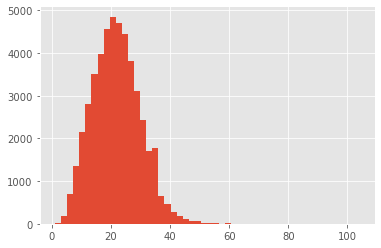

In [71]:
plt.hist([len(s) for s in sentences], bins = 50)
plt.show()

In [73]:
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical

max_len = 50

X = [[word2idx[w[0]] for w in s] for s in sentences]
X = pad_sequences(maxlen=max_len,sequences =X, padding='post', value=num_words-1)

y = [[tag2idx[w[2]] for w in s] for s in sentences]
y = pad_sequences(maxlen=max_len,sequences = y, padding='post', value=tag2idx["0"])
y = [to_categorical(i, num_classes=num_tags) for i in y]

KeyError: '0'

In [75]:
tag2idx[0]

KeyError: 0

In [62]:
for s in sentences:
    for w in s:
        print(word2idx[w[0]])

16257
4928
16566
15706
14988
17308
14921
20221
25778
18652
3941
27143
15987
16261
5750
18652
7444
4928
32381
23209
12774
495
26020
19089
20909
27337
14985
8036
16990
20221
27448
23496
20221
17145
3302
19988
4928
18652
26395
30132
25257
32080
27381
1200
4352
16705
28226
33651
19089
10225
19145
12341
199
10058
5380
27143
18652
12340
13307
20044
25257
13613
30280
25392
15001
6766
17939
20221
15706
32799
20221
5398
27381
9567
32833
2127
27143
21887
27772
15917
19089
11107
32638
32080
30776
5599
11704
30200
567
29159
30933
19089
7994
11294
20279
31432
16875
23866
27305
25257
28562
25257
25705
16261
2101
32833
28935
6766
5271
6324
8727
16261
5032
20221
3726
14089
4928
2408
13512
25799
495
32751
27918
12857
32786
4274
19089
21651
16875
23866
18652
9665
32748
5134
15709
12311
22898
6766
27143
17466
4928
8727
27581
21749
567
18652
17466
21704
27143
30955
25257
12736
13463
25257
18652
32227
16261
9675
19089
7877
23866
715
31576
32365
14104
16261
18652
4325
10152
7078
495
12987
24963
28294
33799


11525
24952
19089
2849
19079
7331
15618
2162
6324
23930
16811
17131
7829
18652
10516
16711
495
14705
18652
20992
27242
25257
22222
14127
23236
18652
5911
29661
19089
13364
7030
30776
6629
4928
15206
2014
14536
20221
25566
7502
20221
29128
30370
20221
22092
21336
24768
19089
11107
24282
31557
33233
4928
16049
29414
23485
23236
17059
16261
23476
15460
18652
3776
21736
23451
19089
23733
27710
2532
26117
29275
3882
26716
20984
30879
23236
24091
27143
4892
26020
20221
4425
257
15817
26671
27143
18652
7331
25487
19089
1551
30776
18637
10385
25257
33475
22769
18652
23733
22898
20221
2849
3257
9180
567
7331
3859
25257
7331
2764
16261
7331
15076
2849
27143
27186
19089
10528
12981
11374
23866
19199
17336
11625
18652
34603
32339
4928
16888
27143
18652
22464
7829
15769
25257
34888
17276
27096
19089
19079
11570
2532
31490
8870
1632
27143
15839
12927
10070
32080
32310
22724
28256
23451
4928
10614
10034
23236
28002
21761
19089
13585
12927
15951
32618
32080
18652
26020
32365
32833
31039
17162
27381
64

5499
30776
17430
19089
19079
1377
25257
22804
33091
21459
25257
1278
18652
17430
16261
26081
20221
29015
31490
11035
18652
28869
4928
18652
10210
11718
18652
17430
12528
30795
1996
468
32786
20221
16999
18652
1377
19089
6723
25257
25929
26607
18652
10210
495
33983
12528
32786
25566
16377
25257
18652
1377
14226
11035
20221
30776
15634
34021
16261
13890
495
33983
10550
10165
34930
24963
19089
26792
24974
14078
1807
29883
11377
33983
23626
27710
27143
6843
16261
2877
18652
16298
26246
22861
3163
17336
25566
13385
16261
24192
19089
19079
17430
25257
22804
495
18652
10210
12927
31075
25257
600
10498
18652
1377
25257
16261
2678
18652
10210
26885
1996
1295
19089
24881
5190
31475
24952
10412
26321
10521
23556
6191
8036
15951
12196
23930
4928
21835
8949
19089
3096
20984
1067
30776
4877
34824
19089
31425
31427
18652
6997
5599
16261
18652
8994
27828
19089
10155
12285
23214
27143
30776
8710
35055
26915
33983
12927
30776
20588
25257
16261
33983
23649
20221
28295
21384
33261
33983
14952
24097
25981


29544
32310
22724
25277
17977
16051
17861
25257
12037
4165
16387
2095
18652
34339
4928
18652
3941
23236
34530
16261
18652
9591
18952
32365
19704
20221
30261
15987
19089
27772
30734
30933
31698
30776
30422
4928
30051
20039
27143
35056
10385
32080
25921
21835
8525
20221
29594
30776
6824
24080
31490
32444
24974
14078
1681
6861
19089
14000
11023
7794
495
33475
17126
2469
20984
11019
17131
27143
15987
25257
8828
33475
28525
20221
7611
30776
17900
31490
18652
3415
27382
4928
28562
23209
19089
14000
23866
27765
9591
32365
13131
3061
696
27143
18652
3776
17116
23451
7030
2849
3352
16618
16261
27710
2849
19107
18652
24052
25257
26262
26594
26262
2089
34290
19089
16193
33235
21761
22898
25221
18681
27143
30656
10130
30132
27143
30776
22910
4928
21196
25796
5476
30656
24768
32370
16261
15001
19089
30656
27337
14985
13310
24470
2812
26915
30933
16261
17313
2909
25816
23101
5380
27143
18652
15857
16261
25410
12704
19089
11107
14985
28256
15001
25221
18681
27143
18652
15771
25257
28880
567
33587
306

26179
9567
25257
33587
3535
16735
20180
27143
27381
25953
14548
4928
18652
20530
19089
3890
3293
18681
21761
22898
26885
30776
32847
4237
19089
19079
1454
3293
18681
33587
22898
29
30776
30933
3732
19089
19079
28143
6766
18652
9665
27143
18652
14790
3963
3293
28038
16261
1454
14127
27143
32870
16261
34698
15987
19089
26931
30132
25257
2244
18681
26885
33235
9401
22898
25257
17694
329
30933
12628
16261
30776
24832
17847
22047
19089
8990
16261
28562
27337
14985
30776
20233
22903
29338
2244
16261
8990
17313
6171
7829
28562
23209
27143
796
27303
25799
28294
32638
88
32817
7418
16261
28256
2244
3316
19089
28734
32833
18637
11377
16646
28562
20264
1588
16261
27381
8990
7418
25221
6537
27143
12341
32365
34889
33243
27143
18652
25799
32365
12198
19137
19089
26931
10385
25257
21736
17313
25221
18681
26915
17606
4928
15001
10743
30776
32833
13475
27143
12340
19089
7877
24282
23866
495
31103
17336
26739
20221
1454
31492
31490
9737
27143
22422
8699
18567
17773
32660
34689
10756
19089
19079
18637
1

33235
2332
22898
26885
30776
32870
4237
19089
11107
14985
24223
11455
25221
6537
27143
18652
34503
27143
30776
20954
7260
28932
14548
4928
6385
21749
30776
5903
27143
796
32870
19089
15571
27143
18652
20530
17861
25257
30776
23195
3293
18681
27381
23774
33610
25257
8828
27381
23774
27930
5974
25257
19028
26684
10216
25257
5974
4928
19776
16261
5971
14580
4666
12774
16646
3293
34503
19089
19079
14127
13579
26262
30267
32365
15818
3169
8896
17342
5499
27143
32870
567
27765
27883
28960
2095
18652
7927
2469
27143
30695
30776
7331
23774
30215
19089
17342
15203
18652
30215
10550
32786
25566
975
7829
88
4929
30422
19089
19079
19835
4928
25210
32365
31857
32369
23300
25257
27803
31596
25257
15027
23236
18652
8827
20221
706
19664
18652
3884
19089
21015
15987
32365
24974
14078
13731
26093
23866
22331
30776
30215
20984
27381
11471
17127
19089
27911
25257
16436
27337
15706
28701
18652
31457
4928
30776
16436
16401
16554
14884
14952
14972
15530
29067
27143
15987
12849
14852
19089
7553
31236
7331
393

32365
32737
13296
29741
23866
10385
25257
20009
28069
24121
24612
495
6766
13497
17336
15706
20221
23825
28243
3907
3776
25487
19089
19079
24375
4425
24121
33401
25017
32817
9102
20221
22585
6569
33021
12774
12975
567
26393
12659
25257
17694
9078
25257
12853
25257
30097
21315
119
19089
19079
10827
4638
5978
28407
9367
12857
25566
13165
31490
19664
20221
329
23451
19089
16193
715
1338
25257
33516
14952
7100
26761
16949
26262
24963
15323
4970
257
18652
17594
19089
2719
148
33261
30280
4638
6766
20221
25566
7330
19089
1551
18733
20221
10827
14189
13918
4638
25257
1398
24282
28294
34145
27381
22144
17556
4425
20372
22267
25487
31490
27097
14884
29594
27381
26393
23174
5823
14390
32365
30097
25646
29813
12774
27381
32817
6341
30097
24558
19089
22806
27765
26159
25252
28294
15027
31490
30776
29332
23236
18652
29231
4928
4276
4928
21755
2038
34698
18652
22806
10886
19089
21651
26159
23866
30132
495
22806
20984
18808
20221
28702
495
24963
17336
32786
29231
502
4276
25257
16261
15027
23236
3014

31208
30776
27509
14797
5275
24113
16490
567
27381
28519
23236
27381
13298
32833
18815
495
6537
27381
13298
7418
27143
18652
31392
18513
22675
19089
7877
12927
14714
32365
5507
13131
5974
32080
18652
10165
4928
20708
27143
14535
19089
7877
15530
18652
18380
28243
9080
19089
13494
3073
3884
567
15527
16261
23214
22447
26671
567
18090
19089
10318
26885
18652
17239
24978
8773
32365
664
27143
2306
15706
10179
17355
31631
4928
27381
13358
29882
31427
19089
7553
14358
4446
27143
26940
31284
6766
1018
31236
29183
34930
5557
27143
18652
2864
28529
26915
24963
12927
16595
16261
19789
19089
28331
1174
7785
19089
19079
25920
32833
11377
24963
2678
30776
22925
4928
23101
18604
9715
19570
27143
796
10409
16898
31576
25257
34095
17116
4928
1996
1888
19089
28734
32833
20433
25257
22178
809
17903
25257
11377
17313
17984
567
4620
22262
7829
19570
15543
4928
2349
23236
17861
19089
19079
20433
11377
88
25920
7418
12927
6537
27143
18652
23650
19089
7877
11377
19570
16261
1996
28462
6766
931
34382
30776
25

34406
27143
15898
19089
28734
33278
20909
34589
11377
18652
7994
13203
11528
29741
12857
17468
26262
30280
18106
26262
24963
29946
25257
8828
11377
24963
12857
32786
25865
20909
2469
19089
3047
7987
22089
27305
25257
88
33673
32080
18652
14276
31857
32369
14085
5338
15566
20221
1338
25210
20221
18652
7994
34820
23748
1753
8699
1636
13203
33401
19089
25210
23654
8699
13203
33401
20984
19422
25257
8828
12395
9973
8337
11231
4928
21092
20221
30162
27381
7900
3293
19089
7877
28352
15206
24223
12311
31490
18652
26050
4928
30776
22934
16261
5016
20221
18652
32142
7435
19089
1551
7529
32076
7829
18652
20909
17042
29741
25257
18652
20909
34589
19056
20221
18652
31820
16261
23866
2849
24963
20984
19383
14884
15706
7900
4276
16261
10550
25566
10540
19089
2849
7877
23866
25210
28294
28906
17466
31490
30776
13203
20658
19089
26239
25257
18652
20909
15818
26557
19182
495
11231
28294
35114
16049
3314
567
18652
1200
16261
17336
13969
13748
567
5576
20221
18390
17147
21749
30776
13955
495
12857
25566


14536
19089
19079
7834
17861
23866
24963
22534
734
26313
2627
5578
16261
9401
26313
2203
27143
25862
20221
12782
8699
13296
27143
30147
16261
16301
19089
19079
12218
20984
18652
9665
27143
30776
22910
4928
29326
27681
31490
18652
32817
14348
19089
26239
16898
28568
25257
22640
31229
35156
7834
7584
12619
22534
32310
22724
734
26313
19302
27143
30776
9167
15206
537
12218
19089
19079
30716
5458
6719
31490
28981
20221
30098
25160
23236
34530
6908
16261
30162
8870
17157
11116
4928
20552
13979
31797
24125
26885
28268
18652
20235
14057
19089
11071
27143
28002
25257
30147
23866
24963
5576
20221
8800
34536
26313
2750
5578
27143
30776
12218
32783
15206
2014
14536
19089
7123
27143
32633
15987
14985
24768
32370
15706
18681
26885
33235
33587
22898
16261
6537
13310
11455
14884
25221
28209
30776
22956
27143
1465
27928
16261
11783
4928
31189
13296
27143
18652
20490
19089
18158
14985
27305
32365
29159
18714
6324
27143
30776
195
26948
19137
4928
6173
25257
26262
20569
20039
20707
2628
20221
13310
32298

27143
32633
13297
19089
13585
7994
2764
12927
24938
27143
15541
20221
9398
11999
32365
7444
12774
32436
25257
32080
13298
23209
32318
18652
26020
27143
30368
4928
12135
15001
19089
12619
1863
26624
27833
23866
11803
34145
8699
3262
7829
10520
21413
11039
4928
19605
31490
15206
7967
30776
7017
25257
30097
15206
34510
31881
14687
19089
19079
20204
27732
11730
23866
24963
21520
20221
15827
34176
9094
16261
18071
18652
32559
7829
6779
19089
19079
5911
4661
28294
2833
5264
30776
34603
13766
27143
23246
19720
27710
16261
27143
25825
4630
16261
15097
19089
16193
8699
10452
27143
18652
26768
8165
25257
18652
32381
2776
29555
1753
26353
4928
18652
32015
32365
10368
19089
19079
5507
10411
4928
18652
24988
8165
21801
18652
20287
32365
33156
13734
19744
27143
33587
22464
1345
16261
18652
16314
2238
13372
12774
18652
13012
19089
19079
31915
10411
20593
18652
530
4928
18652
2776
16261
18652
20287
13083
24462
34930
30776
2478
16261
29427
19764
19752
19089
14846
88
4928
21736
13330
14453
4928
18652
30

8967
12100
22539
9897
19089
1398
17336
21057
20221
18652
8921
23236
16490
19089
28734
5174
7593
30422
11377
24963
17336
2666
25160
4227
27143
10409
32365
14970
20044
15929
4928
30215
17019
19089
19079
5174
17261
23748
11377
10409
28294
26002
18652
30422
31490
30776
24719
4928
8178
32618
12849
24384
19089
19079
30422
32365
21444
25257
35104
32086
25257
11377
1996
33021
12857
32786
34939
26915
34887
18910
18652
30422
21115
16261
7990
32786
9963
20221
302
24612
31490
5519
19089
32140
25257
18652
1338
11377
18652
23419
28020
29911
27143
4363
16261
9302
34406
11336
25257
26262
14718
4742
16261
14527
29641
3260
19232
19089
19079
4257
16032
27581
26885
12349
1390
12295
31490
15672
10475
16870
19089
19079
30422
11377
8699
13913
17336
7485
28045
22898
27143
27772
14970
19089
16870
27337
6766
2609
2273
4928
13131
7593
10846
19806
27143
14970
16261
8036
4775
6908
495
5116
30215
26640
16261
23075
19089
10409
25141
20221
32654
10427
12031
20221
18027
30776
7994
30479
32370
34930
18652
20537
20044
1

18652
23653
28294
21489
20221
31739
18652
26020
31490
29897
10734
10603
4928
8990
11647
19089
16922
5016
25480
30776
33673
32080
2101
24974
14078
16538
31139
18712
17686
14089
16261
26422
9167
28562
15206
32156
28993
27143
22144
11294
19089
31242
17033
20984
21240
26885
18652
8018
9208
26248
27143
14921
25257
160
18652
27650
4928
18652
14551
4928
29793
28895
17338
25257
18652
31187
14884
24938
18652
22464
32365
26823
27394
15531
4260
25257
24490
3896
19089
28331
15099
28294
18652
14555
23236
18652
19735
25257
33365
2849
21551
26252
608
35085
19089
2849
28562
23209
27143
15941
15706
16692
30776
25775
10614
18880
8036
14985
11157
13687
25668
20221
4375
10058
19419
9553
12728
19089
28562
22178
12968
16538
6706
16490
27059
32786
9398
18652
31427
25257
8828
33983
23866
7663
23209
14952
16692
30776
10964
4928
31568
664
27143
18652
20490
19089
19764
1133
26993
12321
12586
3232
28294
15027
23236
17304
9973
20221
31457
16509
3681
26748
11043
25257
15117
30776
34464
20221
7990
28685
23254
32339


31867
7141
18652
26925
15144
25380
16882
16261
22465
16882
25257
18223
32142
19089
11682
32365
1491
25257
33007
25257
20984
23246
30776
22465
16240
31490
18652
3776
28930
4928
8699
13974
6115
19089
19079
22465
16240
23254
18388
1753
23930
4928
18652
4425
931
9627
7829
30776
30086
30097
21315
24062
19089
19079
9514
28133
11377
27765
9591
17336
15938
567
1996
17117
12774
32674
16261
18652
12104
9339
4928
11431
27143
2306
21744
16898
28568
19089
23774
27337
14985
34887
15706
32944
18982
4928
18652
796
20490
4928
6491
25257
32080
34889
15771
567
7260
29543
495
17162
32310
22724
34536
1692
19089
28734
18980
4928
19214
10070
10385
23866
15999
27765
24995
14036
30093
17336
5016
18652
9514
28133
14763
24059
25257
19971
7829
25674
27765
9715
5407
10740
32618
21744
19089
19079
9514
28133
11377
21651
9591
16261
32460
30093
5458
20221
30103
3314
27143
18652
14089
4928
20514
25257
6661
25257
9751
25257
24768
16261
35044
11294
19089
1398
11377
21651
9591
16261
21651
5407
17336
20738
23236
32954
3314

17526
26262
26594
26262
1454
21272
23319
19089
29522
23855
27053
6766
28230
15014
15333
18652
2517
2849
3761
25257
2849
30097
22903
18652
23653
4928
30776
20729
32365
16888
16261
26915
30776
7331
88
20984
27025
7829
30776
33000
4928
24622
19089
19079
715
23653
18652
15582
7330
30776
7800
22749
7286
12927
27143
15541
25257
26915
4379
16538
28331
10269
4680
19089
19079
28562
19397
7396
14085
11377
26259
20984
2505
9584
4928
34290
16261
4619
30776
20676
24834
3293
27143
18652
5911
29661
16261
1454
12395
4822
19089
1551
8699
19788
1338
23236
20042
33231
10070
20221
12551
17861
25257
18652
3958
23866
26259
32365
14916
28202
20221
2162
6324
14127
9402
8163
25257
24249
30097
13203
23994
20984
88
4928
18652
29741
32365
5011
31564
19089
19079
3958
23866
20009
28519
12528
14946
25566
23236
30776
25781
15597
25257
9402
13985
19314
26925
16261
165
32527
29003
30097
28540
21724
19089
1398
8092
495
3113
25257
10759
14127
23254
5558
18885
4928
22898
16261
32339
30669
7365
19089
19079
1338
24282
11377

20530
25257
27173
25257
25221
27974
25257
16261
856
16261
13042
25221
30234
19107
18652
26020
19089
30799
30933
25221
28746
20221
25865
18652
3260
495
28294
12990
19986
19446
19089
19079
4620
15706
14972
33243
31490
27381
10516
4035
31490
7728
25534
27143
12736
13463
32365
8000
16261
20976
12849
19967
19089
19079
11089
20984
24125
26885
25921
11409
12774
602
31490
34521
22362
31888
25257
30776
13955
495
31194
14737
19089
35085
30776
34860
11409
25736
21835
67
27143
27173
27143
18652
5507
34860
17977
19089
19079
2089
4928
28256
905
6908
11377
24963
17336
30134
18652
15952
25257
15929
24963
12528
29289
18652
10329
32365
32491
14674
19089
28734
15311
13991
11377
18445
20984
18197
20221
13639
19664
20221
25277
18678
20221
31103
19089
19079
917
7785
16490
495
8246
27765
19164
24692
20984
30071
20221
23909
18652
12218
15333
30776
31783
20221
28115
25257
18880
15474
6920
19489
19089
19079
12859
12528
7030
21736
10313
25257
28933
10618
18678
16261
18652
3855
19314
4928
17116
3356
19294
21955
1

21835
13714
24343
19089
19079
3260
26885
18652
34155
12927
30776
2706
27294
27143
18652
28634
5766
14799
30734
24931
19089
28734
26352
1338
11377
18652
5911
29661
28294
14972
30308
5259
1753
25210
31490
14790
30776
25487
25257
15702
31490
13687
4928
13203
4276
11330
16261
6743
29423
27143
489
16017
19089
1551
27305
32365
19813
25257
19079
2306
9138
19156
12349
28562
27337
26262
15117
18652
28562
32833
28294
14972
31932
18652
34898
4352
8306
12774
15987
19089
16005
28294
14972
28906
28562
13866
23236
18652
1338
19089
31242
20909
20433
27305
1752
8092
18652
5911
29661
32786
20221
28519
8699
13203
12694
19089
7877
24282
31096
30776
19764
19820
24125
26885
25501
11231
32365
26061
4928
13203
1465
19089
25210
28294
23866
27143
18652
8994
24963
12528
19870
5576
20221
30162
30776
2312
13262
13203
31240
25257
18880
12857
25566
23649
20221
26059
13203
27832
31248
26262
26594
26262
31490
13203
6890
19089
19079
31514
12927
32786
12001
25257
8828
14740
21231
20221
18652
3941
22903
11999
16261
3936


15117
18652
16749
495
23254
7611
9675
23496
20221
28562
2422
13203
30408
12528
27073
18652
8695
20360
28246
19089
9675
28294
32786
10351
18652
13643
25257
18880
968
18652
34829
4928
23930
13203
30408
567
27088
4822
25257
16261
11385
30669
10427
21988
31490
26088
13203
4276
18890
26262
9035
26262
33273
19089
6417
31631
4928
18652
13203
3314
14856
15706
32786
14972
10070
25257
8828
18652
16749
32117
25542
25566
34145
7829
2719
3539
11559
27766
19089
27765
9591
21858
16490
495
4176
4425
25542
17011
20221
25566
9627
20221
19035
18652
18265
9094
27143
2719
19089
28734
16870
22248
11377
18652
3907
23101
18604
16538
6436
12927
30776
9768
4928
18652
3257
31490
4759
14791
27143
18652
26020
19089
30363
16538
17085
19004
4928
18652
13145
4928
27772
3083
5823
1809
29813
27143
13314
3234
18652
18604
4928
18652
16870
19160
8434
567
17390
30776
7712
495
11972
7824
26064
1996
26006
27143
18652
26923
19089
28734
11859
15144
22100
30422
28294
33666
18652
5128
4928
30776
24607
4190
7435
16261
18652
22202

18652
29433
454
33983
14952
19403
2606
22724
21651
11416
27143
715
28568
32365
123
19089
9664
27607
15706
4271
18652
30570
4928
3736
16261
19406
21539
8227
9973
19089
26239
16898
31576
25257
18652
2864
1133
5453
2180
27772
2864
34589
13953
5633
20221
26176
30776
5154
25257
8828
32080
33587
32618
4928
3884
25257
18652
14746
12927
32786
8009
19089
19079
4196
17776
32365
22861
3163
25257
8699
5507
27143
9401
23451
25257
12927
3518
20221
2253
8389
20221
18652
31820
2864
26020
25257
18880
12927
5477
34930
6313
16261
2632
14089
15333
30776
8762
19328
3941
19089
23865
27143
15898
14985
30776
21636
24204
28294
18681
17116
8990
29336
4928
30776
23029
17728
24768
30082
16261
6537
88
1454
27143
796
35082
25799
19089
18158
23866
27305
18652
24204
12545
30776
22029
3776
20221
30776
18815
1264
7829
18652
11730
25257
28562
29665
16261
18005
25257
16261
28781
1996
5415
19089
8365
13965
16261
18652
18815
32365
16554
25221
18681
25257
16261
16646
20232
12927
6537
19089
26931
12341
25257
30776
21636
2420

10127
32080
30776
23101
28519
23236
18652
20530
25257
9494
25257
17355
16898
28568
19089
19079
25398
5338
10385
20221
30847
18652
24868
11721
31490
16646
20601
32618
25257
28243
22567
20601
19089
21651
12446
26016
17132
26291
31490
1996
30215
23236
34521
20601
32080
4620
2678
18652
20530
27143
27381
28573
20221
23957
18652
34589
19089
27765
12446
23866
18652
15618
25221
18265
20221
16793
25862
27143
18652
26020
19089
19079
24868
4311
988
30776
33457
17563
16261
25017
18652
30215
20221
29332
32867
25257
18982
18652
16643
4928
22898
16261
7433
25257
16261
19280
28216
20984
26352
27143
18652
17398
19089
33373
32365
25398
28294
29591
34145
30776
23636
20221
33062
30232
1297
32365
26291
19089
6783
4928
18652
15684
15706
32786
31742
14972
10070
25257
8828
18652
23636
20984
30071
20221
33935
18652
10329
32365
5083
1753
18652
32784
1588
14420
25257
26262
26594
26262
1996
20763
20221
26059
15423
23236
24747
5159
19089
13364
26291
6766
20221
25566
7502
20221
25398
19089
26239
16490
25257
24974
1

8699
489
26006
26885
8735
25257
18880
32817
32370
29231
20221
25584
4227
16261
2184
20107
7593
20221
30754
15898
19089
7877
23866
18652
28562
32833
28294
14972
19806
19107
18652
5895
19089
18742
3073
18652
12667
20221
28562
32370
27143
18652
4672
4928
18652
20992
27242
25257
22222
25257
34530
14127
27143
18652
5911
29661
19089
2306
27143
29326
18365
28294
14972
31816
18652
25118
30215
31490
32786
5904
27381
10427
22634
34930
8699
12037
4928
715
28568
32365
32299
27143
18652
25953
20490
4928
9408
19089
34414
27337
25257
28175
18652
8166
4928
27096
25257
6766
31761
22898
20221
17288
32304
18885
4928
9897
18681
27143
33587
21607
16898
31576
19089
19079
32833
11377
26885
33235
9038
22898
6766
3316
30097
1334
12774
31875
16261
4183
19269
7829
18652
23595
25257
18880
12257
19295
27143
18652
21754
4928
18652
26020
19089
17007
20984
16712
27381
10427
4265
27143
7007
23236
18652
6661
4928
15898
19089
23865
6766
31746
18652
22937
12774
18652
9665
16261
26823
1238
7300
25257
9128
22545
25257
1888

25257
30213
21738
25257
20984
1933
18652
26061
567
24459
18422
27337
19089
7877
28294
23866
11999
17336
32786
4425
567
30776
7302
30215
19089
7994
17934
3336
11064
11377
20009
30422
495
25335
27143
30776
8870
13955
10550
33448
19089
30267
24282
15027
23236
31738
20221
7539
3260
16261
24395
11999
32365
20763
20221
27446
19089
1551
14852
25257
15987
32365
19413
24974
14078
9974
12445
23866
18652
10546
4928
20641
27337
4928
18652
14617
8551
12528
30747
15460
18365
19089
25634
19764
31492
25257
17694
13147
25257
15706
26165
7764
1753
31738
15144
18608
3163
2604
19089
11071
30776
20433
31490
12135
18604
3047
18459
11377
28562
3169
4928
21888
22740
4429
15027
20221
17945
495
18652
9591
18952
17336
19232
20221
25584
21651
18459
16261
1996
23075
19089
29490
14276
11377
26521
3260
7212
12429
27143
33128
20984
32954
88
25487
32080
30776
4703
7078
6371
18885
4928
10057
4928
22898
34930
5392
12319
567
3698
30097
28906
24768
19089
29490
23866
27143
30776
1338
16490
18652
3397
6766
34378
28170
7829


16261
21289
27143
18652
22464
19089
10421
12298
12586
32565
11377
18652
11137
2712
4928
32381
32275
23877
23825
13310
18365
3539
30000
34226
29573
20221
12981
7530
20582
19089
19079
31915
32165
7829
31827
13588
24282
16692
495
18652
17355
25257
19292
30710
4928
30013
18488
28024
17384
19089
2866
33232
26915
6659
4631
20221
18652
7061
20984
16509
19089
32596
21059
5558
7061
57
16261
6766
88
4928
18652
34603
22293
4928
16888
30097
13330
6927
33980
19089
10123
7030
20305
33783
25257
24942
13765
25257
30233
20854
16261
590
32100
19089
11191
7030
6659
28477
32200
16261
22036
7073
19089
14942
30792
27928
669
30132
32080
30776
28562
30215
1338
25403
27381
13231
27143
29930
25257
27157
30258
5750
19089
19079
12958
4928
30776
395
4928
30792
31490
3855
19314
669
22459
6643
28800
2095
88
2189
11958
20221
15206
14430
30776
395
15333
2851
27143
10444
18426
19089
19079
10165
27143
27928
19971
30776
28562
32369
2999
1338
8846
1069
30792
5032
27143
18652
28562
18236
715
31576
7829
10831
7269
25257
300

30933
9398
495
30776
21096
3293
33679
27305
27143
30776
1836
32365
18559
27143
17318
22431
25257
20388
329
22898
19089
19079
34503
31910
31410
16261
19269
18652
15813
20221
9415
19089
17721
4928
18652
27922
12927
7516
19089
25210
11377
24963
17336
18027
5911
21964
13203
11374
20221
18388
31744
5535
12774
30776
32833
13240
20221
20855
22057
11231
20984
22167
23246
13203
4276
19089
16845
14985
18652
3293
12927
32638
28373
30776
17035
26885
18652
21879
8727
18559
28880
4235
1260
25257
17318
22431
32365
22759
17441
19089
18158
15706
32786
23866
11718
18652
28519
12927
26591
19089
28734
31046
30589
4928
30776
28115
1836
32365
7829
28932
9218
27143
8762
18681
88
14288
16261
6537
28256
19089
19079
28562
32833
28294
19182
495
24963
21886
25160
27381
34898
20909
19302
1753
15987
715
28568
19089
28734
32833
20433
22644
23866
28562
32370
30914
18652
27703
27143
23774
7368
31490
88
21676
16261
26815
3857
3539
21473
24963
25160
25257
2095
7812
11087
8000
4928
32870
19089
19079
20433
17349
495
2849


2864
1133
1730
4928
2095
10132
23209
16261
34543
27143
18652
20044
12857
32786
7990
18652
26833
28203
19089
26239
16898
28568
25257
30776
7994
31867
16692
495
3312
27143
14970
15706
14972
11335
27143
30776
7712
495
19918
23853
20221
30707
7212
11349
19089
16870
23209
16261
12598
32370
15706
14972
33243
4620
25257
14884
33320
27381
32299
33587
23451
4029
19089
7685
17398
14985
18652
15001
25257
22234
20221
25566
14453
4928
30776
30422
5823
18652
16319
19019
28466
29813
20840
20221
26259
25257
25221
18197
14127
7212
28562
25257
13298
16261
15527
13476
27143
3575
19089
28734
34603
10427
23419
28020
30422
11377
24963
20984
2849
14273
14986
2849
31490
18652
5119
4928
20909
34978
2509
10921
29849
25257
14884
28294
14981
27381
25862
20221
18163
3539
25210
32365
8383
17823
23832
19089
6303
29529
4367
15027
18652
22808
32107
30776
2849
20849
8525
2849
7829
25210
32365
30215
20221
2849
14050
88
4928
18652
34860
14575
15485
4928
23419
28020
2849
27143
18652
16319
9339
19089
1551
11231
27305
25257

28906
4383
31400
27143
4245
4227
25257
25354
18652
1730
88
4928
10526
16261
27581
20221
23774
32370
19089
19079
23774
30215
715
31576
30852
18652
26020
23236
5011
17469
19089
31242
21557
24832
17847
24142
11377
28562
32370
10743
1996
32870
27382
17355
16490
25257
25303
17116
4928
1996
1888
19089
423
7867
17207
11859
33983
12927
20592
7829
18652
12046
19089
7877
23866
33983
20984
30776
2969
31490
15817
26671
16261
7212
8455
19089
28734
28562
32833
20433
27143
32870
17207
5589
33983
23254
32786
9398
611
28562
32370
2909
21651
7867
32365
27382
19089
21651
7867
34505
18652
28751
31490
15987
32365
14254
25257
30776
34603
20435
6217
31278
15987
32365
25755
24832
34242
19089
13585
30422
20984
31761
24832
34242
20221
15952
7212
18652
7331
23685
27143
3776
28568
32365
15817
15221
19089
1398
11377
11718
18652
27643
20984
34145
25257
24832
34242
19918
25566
32198
11718
15987
20984
6083
34930
7260
25257
26948
16261
24832
17847
21424
19089
8246
16261
3681
27337
15706
10351
23637
23236
30792
25257
2

22100
30422
20984
30879
31490
18652
13572
31457
4928
23733
19473
7306
9349
11241
14884
20984
2095
20221
31436
1996
25721
29133
27143
12894
19089
19079
15487
30422
7
14819
14840
7330
30776
4362
18637
10385
25257
28880
567
18652
15839
12106
1409
15117
7306
9349
11241
28294
14972
24950
4928
31189
23419
28020
19089
11107
14985
33983
20984
32786
19831
20221
19480
16261
28294
14972
11251
8145
20396
7530
31490
30383
12981
16295
19089
19079
18637
11377
495
12849
18652
29001
4928
18652
25487
25257
33983
28294
14972
11251
14373
12774
18652
14276
1849
4928
18652
8490
19491
19089
7306
9349
11241
12927
20211
27143
14535
16261
20984
11009
30776
9872
14407
31490
34118
30361
7952
19089
7877
17336
17104
27330
22567
7891
19089
19079
2764
20984
30071
20221
10964
32310
22724
6353
26915
18652
16841
20984
19714
19089
28468
27337
14985
15001
27143
1980
9302
15706
2013
30776
33504
12125
23409
1465
20221
15527
32370
27143
15898
25257
21169
18652
33504
16261
30776
21887
24690
19089
23865
14985
18652
3293
12927


25257
24963
10652
30776
33338
2238
4928
18652
9862
19055
9339
4928
13812
19089
30084
18652
18540
34663
27143
9937
25257
26981
25951
567
6289
25257
5507
26262
18652
19055
9339
4928
13812
16261
25257
32080
30716
25257
27143
30776
32550
13012
4928
6289
16261
26981
19089
1551
25090
18494
25257
26981
33962
8699
20763
28373
18652
19710
27206
4928
6289
16261
26981
20221
29594
30776
15221
23236
22779
12774
18652
24931
13012
19089
19079
15952
31490
25083
1349
567
6289
33909
27485
28080
21749
18652
21371
20707
7829
18652
17304
21749
5904
26981
20221
19868
25991
8699
22779
23236
30387
6920
18494
19089
25926
12927
22302
18652
4661
4928
29689
25929
22779
12774
18652
20287
27143
15374
19089
19079
30272
17239
907
5652
31490
18652
5507
33587
28920
19089
26498
23866
18652
2628
18714
6324
12341
26885
30776
12506
27143
16249
12276
25257
6921
25799
25257
29784
3525
3676
25221
19806
25104
19089
30232
5460
12927
7057
27143
29551
25257
8828
31840
20221
29689
27143
9937
16261
12927
505
27143
13405
16261
14350

19501
9037
25937
16261
17275
27143
18652
12619
1644
19089
18158
23866
30132
495
18652
10768
25257
10770
20221
23497
18652
5911
29661
3532
25257
25221
33674
18652
27935
26915
24963
17275
715
10385
20180
30341
32365
29825
19089
33414
27607
16261
33587
12429
23475
19089
11107
25221
19310
7829
30776
11638
9037
19089
16845
14985
18652
19501
14117
27935
14952
18652
19203
31490
20601
22898
8828
495
26262
30280
26262
23727
22898
19918
15706
14972
23236
26312
19089
19079
30890
4699
28294
8297
27381
34369
16261
9037
20221
30368
31490
22900
19089
16514
20984
24282
17771
27143
18652
30368
19089
23865
14985
18652
29707
9037
14952
20707
26284
12774
18652
14117
16142
4928
30674
19089
28734
7663
4928
7260
4929
25016
20984
30071
20221
22304
18652
3866
18913
4928
16043
27143
18652
7331
1022
19089
5749
3169
4928
32920
29318
7414
28294
5499
567
1996
15311
17314
25257
972
9172
25257
31490
3884
23236
17158
16261
1454
5159
4928
5630
19198
19089
16193
30776
4362
17042
4265
27143
2306
17861
25257
3169
7414
238

10070
19089
19079
17042
25480
26262
28562
21235
3169
4928
21888
14257
10594
20984
27143
24709
31490
3884
567
20641
3681
27337
23236
5630
3663
25257
24768
16261
20042
5159
19089
23865
14985
18652
8207
14797
31187
12774
9139
32365
32633
33999
26087
25799
4680
3907
16490
16261
10367
28556
31490
18652
27588
6775
4928
6138
7642
19089
8217
26419
26262
30776
23855
4280
20221
27765
9591
31490
12651
6229
715
25487
25257
32080
15477
18652
14729
12927
11559
483
3049
7212
11035
19089
10594
5499
567
3681
28079
1462
22744
17861
25257
16261
20984
30071
20221
15938
567
15818
14078
206
12944
19089
14846
14548
4928
1996
33582
31783
25257
10594
17336
24282
30141
20221
18652
14221
20490
4928
23252
19089
2279
25688
2286
15706
19219
19664
21835
33030
20221
27381
14420
9490
27143
18652
13356
4928
23055
3948
28793
25257
34601
567
23209
15333
10138
17977
19089
19079
33587
9597
27657
9752
25257
567
2286
23666
25216
25257
27143
18652
31082
14583
5287
10385
19089
28734
31187
25257
10723
16261
9041
20588
25221
653

19720
3163
5134
17074
25016
27143
18652
10214
19089
27765
26159
25252
32365
12104
25164
907
16261
8699
17003
25257
18652
22806
22967
1133
25257
6766
2095
12349
16043
11116
4928
18652
905
31305
2089
25257
567
2095
30776
23429
4928
18652
2606
30432
19089
27765
26159
20984
10770
1996
17074
7663
17336
22304
30776
2712
27143
22806
32365
12051
1022
19089
28734
7663
14226
7829
18652
31305
907
25257
18880
5549
3034
567
24709
25257
8758
21037
6945
2189
4928
18652
1022
19089
28734
24719
4928
15066
11409
13729
31490
34996
15865
27025
16043
19089
19079
14575
29725
16043
17336
25566
32186
32071
23236
18652
4094
4928
24719
2606
22267
24088
17595
19089
6417
3163
10928
6766
30071
7829
15168
20140
17113
23653
19089
23865
14985
18652
7078
12927
1499
27143
18652
34809
34304
8443
4928
30754
15898
19089
19079
5911
21964
11959
34235
33401
28294
33666
18652
26645
4928
16646
31327
24963
24750
20221
23759
8727
20221
24442
7799
12774
19552
19089
19079
23598
11377
18652
31327
30866
12927
11019
4042
30132
13555
2

19918
15706
32078
27381
14312
19473
1334
27143
796
15898
31490
12349
32618
19089
23675
31540
25257
30776
16302
31490
35077
32365
1911
10590
13991
25257
33446
27305
27143
35082
25799
567
1996
8132
16261
30776
7308
25257
1744
3592
19089
28734
29338
20433
23866
17861
18652
30422
14952
6376
30776
19764
16302
23236
29241
4928
7596
31490
32381
32370
19089
19079
20433
27059
32786
22077
31540
7829
26327
19089
35077
32365
20933
20221
15898
25257
15498
9270
12534
25257
17207
18652
31827
3735
14085
30132
495
32098
28294
14972
28906
30023
567
18652
1391
28685
20826
19089
31540
25257
8609
25257
28294
14972
19186
380
27143
19397
16301
16261
18652
10392
2298
31490
1911
10590
12849
8762
19089
30656
30933
14985
88
14288
12927
18681
16261
26885
33235
16364
11455
6537
7829
27381
26582
27143
31031
10130
30132
19089
1398
20984
4841
28216
19269
18652
34503
495
3901
7365
27143
30776
11405
4237
24895
4928
24740
30992
25257
2095
7812
6552
8000
4928
4723
25257
27143
796
10130
19089
21509
20826
25257
8650
4928
1

9418
16261
11223
19561
2536
19089
1551
18652
18637
10070
23236
14168
17398
25257
18652
13012
23866
11112
12528
12515
8699
32093
12208
16261
34660
16705
16261
13231
17728
18673
26833
6216
19089
12843
25257
18652
24931
18013
27685
2189
4928
18652
33202
4425
2764
19089
7572
18365
4029
25257
14821
27765
21683
9164
23866
1996
30215
12528
15597
24919
8699
16117
27143
18652
19752
32365
15452
16261
18027
32310
26838
20221
34939
21835
7823
13042
16261
22585
33021
19089
11231
23654
8699
13203
33401
20984
31490
2422
20268
19089
7877
23866
18652
24346
12927
20221
2078
16800
31490
26838
8916
7829
18652
30215
14884
17336
25566
28714
20180
19089
19079
14147
4928
18652
5195
19160
23300
28294
8730
15001
20221
23423
14127
7212
11999
25257
15117
502
3260
2849
8628
1137
15817
19198
19089
2849
19079
21936
6602
31975
17131
18652
29968
27305
15951
17977
32080
13298
24974
14078
10340
23820
9501
1996
32833
30776
13385
27845
7212
10058
6908
27143
18513
19089
21651
23820
21579
1471
12135
5417
27765
3047
18459
49

27143
27381
7353
32469
20221
30368
31490
13687
495
18652
27878
23254
25584
5557
19089
16193
30776
17042
4265
17861
28041
9078
23866
18652
22634
20984
8715
27143
30776
23722
27143
18652
11268
20044
17939
20221
17481
2998
27065
19089
23860
20984
11496
20221
7571
17308
18652
35063
8251
16261
34930
18652
25930
4928
27065
20221
26739
31490
18652
31189
8163
914
26563
20221
4572
5557
19089
28041
11377
32098
25221
34860
1546
567
18652
31803
27305
25257
5771
30776
4190
6104
23236
30776
1047
32476
7739
17336
761
26070
18652
33339
1730
7829
2095
88
33673
19089
28734
13714
4928
32007
9078
7785
25162
6902
26885
18652
31803
13240
25257
567
32030
2860
22903
7019
734
16261
7019
34288
15822
32217
25257
16261
567
18289
16613
18720
21676
16949
19089
29293
14689
16538
268
17336
11989
27381
16298
33581
20221
31130
18652
1894
30070
4928
11951
19079
18906
19089
29250
7829
18652
16437
3477
5040
20221
16275
20837
20514
27143
28562
8921
856
25257
18652
6217
28294
31224
31473
15206
33395
12311
32783
4928
17525
2

12601
27143
18652
22067
4928
1878
19089
19079
30215
23866
16490
7994
23209
17336
7990
7606
20984
18265
20221
25162
18652
11140
19089
25210
30697
18652
14771
19089
19079
10106
21749
14884
7511
10214
18652
19197
32684
495
14617
21651
14611
27143
34521
21749
15323
34930
18652
12601
23236
30132
19089
21651
14611
20984
27143
29638
27143
27772
3083
19089
32381
30933
15706
20211
30776
1636
4375
27143
13297
27143
2570
567
715
25487
32365
22567
27242
34279
22458
27143
17234
27143
18880
9167
12018
22898
4680
19089
7123
10405
18652
31187
26262
11482
1340
21627
29787
18354
19089
11107
23866
8036
25221
2094
23236
27381
18140
19341
12774
13297
26915
8036
13456
11035
34930
1195
26885
30832
25257
30205
4928
14921
19089
21651
29787
18354
20984
4375
31490
18119
45
3397
25668
20221
18652
17234
34279
22458
19089
7877
20984
3487
20221
18163
27143
14921
32365
25263
25152
30477
32365
22808
23236
22644
19089
26931
10385
25257
29598
30933
20211
1996
22529
25257
5279
29787
18354
25257
14884
29048
30776
26223
31

19079
2158
14981
20221
31036
30776
17900
25257
15117
20009
7444
8968
23236
23774
32370
11019
22526
20221
25952
18652
2244
6536
19089
9675
11377
24963
20984
32954
24768
20221
5441
16282
10058
19446
27143
18652
26020
19089
30656
31110
14078
11722
17565
17861
8092
11859
7212
17390
27381
26287
34292
16261
23866
9675
20984
32954
8699
18950
4928
19609
20221
15938
20009
34530
11751
30097
28519
19089
19079
5974
32365
7529
21489
15951
32618
32080
11999
23866
24963
28294
34173
495
18652
31973
30422
495
26972
6324
18652
16
14127
27143
3645
25257
9675
25257
20984
18197
16646
20417
7212
12395
16261
13298
13476
27143
18652
26020
19089
11999
32365
9539
11134
10070
30776
18637
16490
25257
20992
1075
25257
15117
24963
28294
34173
495
25623
6766
18197
30776
10964
4928
14127
34698
9675
25257
16261
19918
25566
16134
23236
7972
6908
4928
3839
16261
27906
19089
9675
20984
30776
10873
1728
31490
13298
12382
25257
4477
15333
30729
12544
502
26262
18652
11990
7331
25487
25257
18880
31194
10385
19089
19079
5911

25257
22222
25257
45
14127
23236
18652
11959
26993
7580
19089
28734
10444
18426
21888
22808
4928
8687
5652
27143
22567
495
18652
33019
32117
25566
17131
8921
19089
34554
32365
15452
6022
13659
27704
4928
32310
22724
9401
28080
27143
18494
21749
28806
25257
32071
23236
10159
7666
4928
13131
17947
16261
9176
30215
27544
19089
19079
33924
30641
25221
20474
7829
5906
15164
32080
18652
14127
23236
18652
11193
10657
25257
16261
7030
11266
12774
5906
16261
24868
20396
32114
14884
25221
23236
18652
18897
19089
19079
10444
18426
12939
13991
16261
5297
4928
18652
9897
4928
18652
14127
14952
35161
31490
18652
31457
4928
18652
31248
19089
19079
20490
14952
23866
24963
4375
20221
25394
18652
23530
4928
4358
5298
25257
16261
32786
7648
18652
22442
7212
424
24683
25257
14884
21744
15799
5821
20221
24774
567
18652
25379
19089
19079
5911
21964
11377
18652
14852
16364
30656
1644
14104
5469
8283
4928
10170
14825
23236
18652
17761
4928
26235
19089
28734
20433
31490
18652
7994
17696
32424
11377
24553
17619

19089
21651
15832
11377
4641
12295
28880
18652
20078
567
15898
19026
25775
25776
31490
25623
19089
19079
27758
5974
24282
26081
20221
33643
19950
20221
2704
18438
14127
34930
15898
19089
19079
9302
30215
28294
15237
30776
33994
5458
20221
29514
16261
12506
19988
4928
18652
13801
20078
19089
21651
15832
20984
27143
26500
25257
27732
3884
567
19764
1133
16261
15527
15988
19089
34554
28294
25503
18652
30383
6890
6264
16261
32298
2184
26736
4928
18652
8994
7829
22127
29601
2179
16261
7829
8479
31834
23236
8006
32298
28749
12774
6246
29789
4928
12774
18445
19089
5970
17861
32365
1314
25257
15527
3169
12968
8343
3948
23349
21108
15027
31490
27381
23423
20221
21988
4928
9302
32365
19950
20221
17481
15001
19089
21108
23866
24963
16461
32786
26059
2151
20221
15706
30776
8921
2849
32101
34155
19089
2849
19079
8990
30215
16261
18652
5911
29661
15706
1744
21579
9302
4928
10142
20221
14700
25160
23236
29338
2244
32071
27143
9302
14884
1560
14127
34930
15898
19089
7123
27143
30955
15706
22769
24770


32142
24919
20221
10944
16261
28294
31171
14816
4928
18652
9583
19089
23887
15001
12918
31392
18652
31820
4222
664
4928
18652
12135
27930
16490
25257
27143
30776
25778
7212
18652
292
32365
7331
7302
30215
19089
12135
34887
14985
2095
8068
15001
12774
18652
24246
33969
28504
2687
6371
21835
7429
34930
18652
18422
27370
16490
27143
31231
25257
18652
31441
664
4928
18652
12135
5417
19089
19079
1943
28472
31490
2095
27381
21676
25257
3539
8036
25221
1185
20221
18641
7829
30776
30933
31367
495
3287
26885
18652
18897
19089
24246
33969
28504
15144
2687
20984
30776
10058
17673
4928
7029
25257
16261
18652
24768
32370
26885
18652
18897
25221
24282
28373
18652
18982
4928
7029
18604
16261
12135
5417
27765
3047
18459
19089
28734
21636
24204
13469
20221
5558
18652
18604
4928
15987
32365
26823
1238
7260
20435
30422
22644
29784
18652
22759
24832
24088
26201
12774
18652
26020
32365
12157
12543
3163
19089
34190
15832
16508
25257
29035
5911
23774
19672
20984
30071
20221
7698
18652
15952
25257
23475
18652

25257
32870
30933
14985
26885
33235
329
22898
25221
18681
26915
28562
16261
23774
32370
17984
567
7260
18560
27143
18652
14232
12276
5903
19089
11071
18652
28562
32833
11377
24963
28294
31698
18652
31441
19835
4928
26259
27143
15987
32365
5884
4227
15333
17355
24720
22920
19089
19079
22464
32365
20758
32541
4928
31170
25257
14516
25257
11377
24963
31727
32310
17059
22724
33567
26313
715
25487
19089
17861
32365
31201
7473
23930
18321
14884
22234
26313
18309
18244
18652
470
10214
19089
888
8297
17313
20221
26235
715
14852
20221
9737
18652
19413
30215
24603
27381
29098
16643
12774
25564
19089
15325
18652
26405
25221
18449
3876
6324
7829
18652
9039
12774
495
7476
7017
18880
8036
22267
14952
27143
18652
6229
4928
29331
6191
31490
18652
9039
7829
448
4928
21835
32224
14952
33371
20221
30857
18652
32015
19089
14516
11377
24963
28294
30082
1383
31490
30776
32648
32462
17059
25257
29784
26313
28294
1383
31490
33396
25257
18880
20984
30776
32648
31490
18652
11730
19089
26313
32365
1383
7030
3231

24929
19089
7106
4928
24007
14884
29544
32310
22724
30776
27503
33243
22267
1454
6766
11980
27143
12295
25107
33852
19089
19079
2864
1133
16261
18652
5911
29661
15706
23866
502
30776
8652
20984
26563
20221
22829
8389
16261
11221
20362
18652
7429
31490
18652
3415
4928
26235
32365
5507
15997
30215
27143
9879
23451
19089
8908
31576
25257
24607
12551
25221
33392
27143
30776
28608
1753
23570
20221
33852
19089
19387
12551
15850
18652
20530
20490
20984
25542
9516
20821
25257
16261
8036
9214
20221
8652
20221
1454
25257
19734
21196
19988
4928
26235
30097
33635
27143
10970
19089
14312
32093
8563
15706
7180
32786
20221
11089
15333
3776
28568
32365
15778
23057
27204
27143
20519
25257
35077
19089
12641
12774
3575
14985
18652
17313
25221
18681
27305
27143
31277
25799
29
27381
24895
13613
30776
26948
23101
12927
18681
27143
9567
33243
19089
19079
8563
16261
18652
14312
30215
10351
30776
12218
30132
495
12121
4425
6825
22903
12157
27671
16261
22567
1601
19089
19079
20519
158
30020
12774
34521
9401
202

4928
16360
19089
8990
34887
14985
3312
25221
24282
18681
25257
8828
19679
32748
23254
32786
25566
32953
19089
18158
27143
15987
14985
26885
33235
7891
22898
25221
18681
27143
30776
22910
4928
14127
30132
25257
195
27143
16261
19107
18652
32633
20490
4928
5884
19089
23774
27337
14985
30776
31046
3293
33679
29
30776
7260
19646
23236
18652
11033
4928
5884
25257
34095
25277
22898
16261
3087
11455
19089
28734
31915
34503
27143
30776
21887
18112
24282
19269
27922
19089
19079
33587
28169
7762
33714
25257
30776
31187
16261
30776
10723
25257
25221
21886
3316
26262
8036
29544
18652
21561
27143
30776
15330
27143
16486
25799
19089
16193
33235
25793
22898
25221
6537
27143
18652
33587
28143
19089
11071
30933
27143
15997
5884
14985
26885
33235
28256
22898
25221
6537
30132
26915
30776
942
2516
27381
6618
23185
26885
30776
30933
3732
19089
5884
28294
14972
18652
18897
4928
30776
10964
4928
4703
14127
12849
28562
4245
23209
19868
26201
12774
18652
20490
715
31576
19089
1551
1454
3260
25257
23774
30933
1

9856
8165
27143
18652
26215
25257
3604
27013
3539
11019
29237
6324
7829
24184
7204
19089
19079
8165
12927
33819
32365
26768
27143
6642
25257
30489
11257
29318
6857
16261
19497
16102
25257
14884
15706
24059
22267
19089
21015
9675
32365
18933
25097
30776
1130
23236
6642
32365
33188
567
2947
2642
5944
19089
6382
25188
12927
20429
31490
9675
19089
19079
9856
20984
11019
5264
23236
18652
2073
1436
4233
27143
5745
4928
32310
22724
10827
24191
19089
7123
14985
495
9136
28154
25221
21829
12774
18652
28809
30132
25257
26823
31490
8497
23182
27143
18652
489
19089
30419
22898
25221
20211
19089
28734
34603
28562
13991
7785
495
18652
19397
7396
14085
28294
20707
19664
15531
4362
12794
17627
27143
32310
22724
8068
4822
19089
19079
2306
9138
10385
11377
18652
17627
19918
2068
23236
5197
31473
7829
18652
3958
25257
8828
17113
22518
6766
23649
20221
28869
25816
25623
19089
19079
13991
32071
8699
1338
23236
1248
567
18434
16261
2180
28562
16261
13131
27337
14884
28525
20221
25566
1606
19089
19079
34978


2095
18652
13881
4928
18652
7003
16261
7471
9973
20221
31739
16094
19089
19079
8652
19971
18365
4928
3884
4252
19764
4822
16261
18652
14276
7354
1173
2095
27381
7593
218
32783
26262
17638
26262
15206
32331
14536
31490
12625
19089
19079
23977
5622
26627
23589
17336
5750
1612
19198
2087
25257
22632
26238
28679
26885
30776
23653
26915
12625
16261
33891
6766
27054
29316
567
5922
5159
19089
19079
22572
3752
7003
16261
7471
16481
20221
10165
25765
27143
17861
32365
2851
19089
30147
11377
24963
20984
2849
34553
2849
2095
974
7404
3663
567
18652
15582
25257
8828
28294
302
30776
22497
29674
495
18652
1037
18583
24395
22806
26262
14548
4928
30147
19089
28734
3681
15818
26557
20433
25257
31229
5687
25257
17861
26165
8986
495
28373
18652
7331
20729
25257
18652
15582
17336
2078
29684
20018
31490
974
3663
19089
21015
33983
23866
18652
15582
32117
31247
22806
26262
27381
2849
14556
14548
4928
30147
19089
2849
4379
16457
715
31576
30173
31492
27187
7404
3663
567
18652
15582
20221
1203
1349
26403
19089

8558
19089
1551
18733
20221
22581
25257
18652
12585
4928
18652
23623
7030
2180
16314
27765
4618
4626
25257
33855
27772
2864
35112
26302
17809
25257
16261
18287
31578
19600
19089
19079
23623
2992
27143
30776
26113
13991
25257
18652
2646
4287
3
25257
30132
26262
18652
15311
18604
12927
3487
20221
30747
30776
5016
20221
18652
21948
20530
19089
15311
23209
6936
6267
4620
27143
6976
31490
13310
23451
27143
18652
18603
25257
8828
18652
33243
28294
27100
27143
29326
23451
567
12656
32370
306
17638
4928
18652
2238
19089
14821
27765
21683
9164
11377
18652
25249
12486
907
17336
29594
30776
34137
27143
13341
25257
18652
5507
24088
34137
20221
25566
15530
27143
11112
12849
27687
19089
32752
16261
34173
4928
18652
1334
25257
17694
11799
25257
6766
29476
23236
18652
14729
32365
31199
19089
21651
9164
23866
18652
7935
32365
15988
17336
15938
20221
29417
30776
7331
7409
3855
31490
18652
26020
19089
7877
17131
18652
31201
32080
1314
22644
567
8246
27765
19164
24692
19089
16005
28294
14972
33370
31355
4

16735
20221
15206
22273
6643
30776
395
19089
33039
14985
30776
1399
32237
22903
5750
16261
2184
26627
30792
27928
14425
26915
5032
34128
21065
30097
5750
2118
19089
19079
2089
11377
18652
24768
2764
22230
18652
31187
2849
20221
25566
25511
2849
16261
21886
11035
19089
12843
2184
31564
6766
3104
6324
4928
3260
27143
13295
25257
7785
495
18445
17336
11180
19734
30792
16898
25487
25257
16261
30776
16282
11089
7829
24406
27020
33021
19089
19079
23300
4928
17438
25507
28991
11377
24963
17336
16632
8699
18434
25528
13004
7829
30776
27877
32310
22724
88
23968
7829
18652
25487
31292
19089
13585
17336
9737
15938
3104
5750
27143
18652
33589
19189
8828
28294
3698
27766
23236
30792
27928
20763
931
19089
32577
27337
14985
32098
20984
29422
30792
23236
18652
4237
16261
17670
15747
27928
23236
31262
16261
18652
24789
28562
16231
19089
8365
22898
15706
14972
19310
32080
30776
14927
21314
23649
7829
12135
4276
24404
27137
19089
11999
11377
30776
4362
13298
14420
16261
12135
9490
17410
27143
420
18652
2

25392
28462
27143
27381
9490
27143
18652
21754
19089
15527
11377
88
4928
18652
2244
18681
12341
29
30529
11225
27143
30418
25799
25257
25107
29456
25257
20984
30776
25816
25392
13742
19089
7877
20984
17939
20221
25566
23224
31490
21196
14127
7212
8990
30215
27337
25257
26262
26594
26262
18652
4362
32370
19089
23865
14985
18652
2244
6766
24282
25816
4928
10511
33705
22826
23236
18652
18489
27143
18652
23722
16261
26088
1190
19025
20221
23950
25392
18982
23236
17113
3312
19089
34111
27922
25221
32076
19089
22948
4276
25257
17694
30776
3237
27159
25257
25221
4446
15333
18652
9490
19089
1551
796
15898
25257
18652
32381
32920
26557
23866
12341
88
4928
8699
17313
12927
18681
7829
30776
21636
34503
19089
34696
32365
24968
12381
28294
17447
4892
5507
24543
12429
32365
11959
21331
496
24164
30152
27143
13361
30375
25257
18652
21948
9339
19089
12381
24593
567
30776
9026
23653
4928
33587
3857
25257
605
28383
19089
31611
33097
4928
33081
12927
31915
25257
6646
4928
88
31915
24919
19089
3351
16507


4928
18652
14057
19089
7395
14985
30293
22507
25221
476
30308
1753
24582
27143
18652
19299
19089
19079
32833
24282
27798
15001
15144
26090
567
10146
9779
31490
30776
31915
33673
25257
26262
18652
15001
31363
782
495
12257
23051
25107
18652
19299
19089
28943
22724
29377
22898
25257
17694
26885
33235
19057
30293
17313
25257
15706
14972
18681
12849
18652
30200
31194
25090
24988
19089
12362
16049
4928
18652
12135
11647
2736
27143
18652
19299
15706
32799
19089
8908
28568
25257
30293
27337
17162
2604
27143
18652
33243
25257
8828
3963
17457
15706
16397
12849
9672
19089
19079
12958
4928
1069
30792
28294
20064
20221
8699
33469
18950
27143
32310
22724
24059
20387
26262
31898
35141
27143
18652
32633
17443
28294
19269
29930
20221
22956
19089
23965
20632
1069
31490
34521
19314
17861
24156
26262
17638
26262
15206
2572
30776
395
20221
15206
21346
19089
13585
20984
18652
33469
12958
18720
395
27143
10444
18426
2851
12849
6920
30326
19089
19079
12958
1468
25480
20726
18652
33777
4928
18445
32365
30792


19089
1398
11377
9622
32365
12291
14952
14972
34034
16261
1231
21518
25221
11019
31745
19089
19079
13991
32365
5526
16692
495
23930
5051
10475
4041
14952
14972
29441
27143
30776
6341
34290
21749
18071
567
12983
8727
25257
12763
16261
25910
19089
21490
32365
13131
5974
20984
27143
15898
23236
27381
6248
5016
20221
15938
567
27765
23301
992
16261
15818
14078
27030
12712
5030
19089
14875
31897
3287
27143
29456
27305
32080
30776
5016
20221
9302
19089
7877
12927
30071
20221
30103
24768
5159
16261
8990
6661
567
21651
992
16261
567
5030
19089
19079
31827
17042
29741
7785
495
8138
22769
1996
8990
17314
20221
4425
23236
9070
3663
567
9302
19089
24974
14078
201
19949
25257
18652
34589
32365
33004
33567
25257
5576
20221
6019
18652
6202
19089
19079
33587
4822
15706
14972
29316
567
6268
15001
6529
28880
21835
19287
20078
19089
21490
23866
31897
32365
5016
12927
32786
28701
11116
4928
23653
15929
4928
5119
31564
19089
27765
992
12927
18652
4775
4928
30776
3293
28519
23236
13341
7967
19089
1551
9302


1075
11455
25668
20221
18652
18119
27103
34406
27143
1195
19089
15528
4928
23774
30933
16888
32919
13395
27143
15987
32365
9430
24768
32370
15706
6140
22981
27143
29326
18365
19089
7106
4928
22900
21749
30280
4928
25360
8846
1084
4928
314
21749
15706
3063
19664
27143
16261
19107
18652
20530
12849
18652
34521
25793
30589
4928
30776
24747
7260
15391
29
32870
19089
16193
33235
27546
22898
15706
12292
27143
9302
32365
20758
20490
25257
25734
25257
20221
25778
33994
27271
10350
18652
813
16658
19089
13127
34079
16261
28730
10417
25257
18652
16566
14988
17308
18652
20490
20221
522
18652
27271
25257
5507
26352
27143
23160
715
20992
19089
28734
7663
4928
13428
16319
6908
18880
10798
27765
598
5112
32365
25584
31490
18652
30199
3941
23236
34530
32931
27305
32365
18149
19089
7106
4928
29159
30933
15693
1220
18652
33437
8828
28906
3260
12927
32076
19089
19079
1338
11377
34203
28294
14981
18652
24612
31490
22144
32114
15929
24963
20154
2849
16130
14633
2849
4928
30776
20332
28562
32751
15659
27143

7774
13321
30776
24908
4928
18652
29418
16261
495
18652
34279
271
16261
669
34930
30776
4461
24807
19089
18158
29545
18652
9897
25221
32078
23774
17313
19089
19079
28562
15452
32908
26885
30776
16324
2189
19788
23549
27143
18652
5507
12349
20387
4928
16898
25487
19089
10385
32365
1338
12774
18652
25047
2999
23866
18652
30806
12927
30776
27877
19734
5823
22149
2189
29813
22724
21485
9567
25257
16261
29443
22724
18652
99
23968
19089
34188
30215
7409
11374
16261
17728
4948
14985
18652
13568
4928
18652
13088
19918
15706
7754
25257
16261
8036
22118
7927
7409
27704
17336
23809
21744
16898
25487
19089
25634
7409
7785
10385
25403
28562
8774
29942
28928
27110
27143
30776
33416
20044
25257
29784
603
3133
19734
12166
19089
12780
10950
12257
8699
5011
18950
12849
20992
25257
8828
5680
26885
30776
21806
24812
18950
19089
12112
32583
27027
18877
31490
14834
2095
18652
27027
5750
495
7171
26823
28562
7409
29942
19089
28734
2577
1338
12774
27381
4869
30422
23866
18652
23549
4928
8774
29942
27143
18652

12293
18652
1347
18488
7212
18652
27607
25257
12293
20009
13687
25257
16261
3982
611
8036
10550
20155
6472
19089
16005
6766
9054
495
32820
761
17336
25566
13469
715
19089
34111
6759
1347
15706
14972
28701
7212
29861
24609
30097
18652
2180
2952
5974
25257
8828
1347
6766
761
20221
7030
30707
7212
18652
26020
32365
2023
16261
868
25257
26262
26594
26262
18652
29551
26355
4928
30754
7347
19089
31242
31568
30422
27143
15987
28294
10070
30776
13670
495
8240
20221
5134
18652
21636
24204
14884
18681
25793
22898
715
31576
26885
30776
28562
32833
26006
27143
18652
23774
20490
4928
5884
19089
19079
14384
20984
29476
23236
18652
25642
4928
5042
12003
34481
13240
19089
1551
24963
25257
30776
14114
31187
4020
30776
25558
4928
18652
28562
10834
16261
1581
5576
31490
18652
28519
19089
3351
14114
31187
25257
10405
26262
18652
24204
25257
9643
27589
19089
19079
14384
9672
3048
28216
8961
20221
25566
18652
26582
495
24027
17308
18652
14957
15330
23236
17861
19089
1398
22293
8501
3027
11718
32786
14394
19

15571
25257
26885
33235
329
23774
30933
25221
18681
16261
32310
22724
8068
11455
6537
16490
27143
30776
21636
31046
30589
23236
32870
32365
8603
30460
19089
11071
27381
23774
7370
16261
1996
16554
25221
4567
25160
27143
18652
32633
20490
4928
5884
19089
28562
13096
496
25257
18457
25257
11377
30776
29326
32165
25403
30776
7331
14316
28911
20221
25566
7812
2189
33211
31490
18652
19862
27143
25237
33587
3445
495
12857
32339
33375
19199
27143
12429
19089
6782
28867
14078
23858
26140
30558
14737
32365
25249
25257
15117
1922
17455
20984
27381
33211
7429
20221
4245
26662
19089
18457
23866
16490
25257
8699
17869
28911
11003
11505
12774
6303
27413
32485
16261
24059
21749
18880
1744
32339
2095
34536
2189
4928
16049
1023
4928
33375
19199
19089
19079
25688
11730
23866
18652
6472
4252
15279
12429
12774
21761
31492
24282
16692
495
17869
11003
33375
1000
495
23254
11625
19058
19089
21178
2433
3445
12181
26262
18370
11089
2095
31710
2189
4928
16049
12429
26885
23930
23653
27143
21835
1692
25257
16261

20018
16261
15027
31738
15144
3049
30776
6631
4928
18652
19325
19089
8419
20984
7012
567
18652
33507
12135
30215
27143
18652
31820
4222
25257
18880
20984
32403
7829
27765
3047
18459
19089
31738
25257
18880
13456
18982
4928
18652
18513
22675
9167
33587
20387
4029
25257
11377
24963
20984
29625
20221
28686
18652
292
32365
19845
16705
19089
15020
30215
19661
16261
24814
4928
18652
28476
4869
6766
1314
12341
20221
30103
33261
20221
9325
18652
7409
33501
4928
18652
6138
7642
8900
19089
21235
24974
14078
16378
29885
17207
11859
11116
4928
18652
1314
27143
21006
18652
30422
17336
20169
20221
31427
30776
5154
20221
18652
10564
19089
19079
22808
32365
1522
26448
22846
32479
11377
18652
7057
2180
18604
21775
18652
25267
4928
35153
27765
31320
26192
27143
12157
20221
10191
11035
31490
21314
4572
4620
27143
32674
19089
7877
11377
20009
15618
32117
15706
27930
9094
19089
17961
11374
14985
28476
470
27143
18652
26020
15706
24156
7829
34536
2189
12849
18652
4703
27588
6775
4928
6138
7642
12927
32076
2

22311
26727
18560
15706
14972
33243
567
4620
27143
10409
32365
14970
20044
19089
19079
33243
28294
32638
23930
8790
22898
3316
16261
16646
33587
12311
23388
19089
28562
34887
26170
30776
4606
13206
27143
18652
13694
15366
30132
27143
27381
8525
20221
9737
18652
12635
32365
27726
19089
3169
4928
18652
28867
32827
4443
28328
30776
31831
17453
13262
12774
18652
18598
15366
22914
25257
18880
13521
18652
4631
4928
18652
6828
9318
19089
7877
23866
18652
17967
20984
3518
20221
9737
8019
32590
18507
20221
12421
13291
10464
19089
4443
23866
18652
13262
20984
11019
10070
26885
30776
4060
495
12528
11329
18652
2776
21888
17751
21749
10444
18426
12276
32365
29824
20216
21749
27143
8068
3857
19089
18158
7701
28024
33627
27143
12454
16261
2439
19089
10472
27059
32786
14985
33261
30280
12460
25221
16692
27143
18652
25683
20044
13613
33587
30933
12628
25221
6537
715
31576
27143
30776
12506
34503
19089
7784
4928
18652
8652
14985
8036
16815
18652
590
12515
17336
22937
26485
26596
16261
7485
11615
28192


24963
20984
1018
6462
25584
20221
18652
26020
32365
6448
26557
19089
12193
11377
32310
22724
12018
22898
15706
4680
4928
6138
7642
33980
12849
30716
19089
34414
32833
19302
6766
17460
11294
5032
20221
19988
4928
18652
26020
8927
16898
31576
7829
2312
18541
25257
17967
16261
4183
19269
7829
33587
23595
19089
20218
17059
16261
28935
22951
8727
25257
13262
25257
16261
20396
5032
12341
20221
4041
23236
18652
21081
29825
4928
18652
22759
7935
4928
11640
19089
27765
31570
14406
11887
32088
27143
23930
4928
18652
32082
12257
14089
25257
16261
33475
26016
30776
29332
23236
9436
29270
25257
18880
28294
14972
5681
31490
23930
4928
18652
4183
19089
18158
16839
26885
33235
9038
22898
6766
14829
3316
30097
1334
19089
14276
7593
33321
16261
30776
10964
4928
31492
15706
26422
10603
4928
12408
27143
7593
25257
16261
18652
5911
21964
11377
24963
20984
17169
30776
13714
4928
11374
20221
32281
567
33482
19950
19089
31242
13298
14420
20433
11377
18652
31187
12927
6268
19089
28734
28562
13991
7785
495
3281

6292
4928
16774
27544
19089
3689
5922
15166
27143
18652
3907
18603
16261
17355
16036
25257
7409
27704
31490
32000
24006
22362
28080
28407
15333
18652
19247
2439
21749
22362
19089
19079
34458
32117
25566
28352
3539
3575
12857
25566
24843
20221
18652
5840
32365
14276
7356
25257
567
18652
4969
20221
25566
23649
31490
10733
28986
19089
19079
16
21749
19262
6220
5922
15594
25097
30776
21911
23236
32000
32365
12442
27704
25257
18880
9526
20221
25363
28080
27143
792
19089
2673
25257
18652
26020
31464
20221
5398
30776
13088
16261
19726
28556
27704
2087
25257
195
17308
1612
8921
34628
16261
17947
25257
16261
13659
27704
33909
22362
28080
27143
15769
19089
18193
27687
25257
10409
28294
14972
19806
567
18652
25861
20221
7333
13094
1632
17694
30776
31464
17223
4928
18652
18044
4060
16261
30776
1390
20110
4928
13131
18044
19089
28734
7331
31287
25257
18652
16870
27786
25257
12927
27225
27143
12157
2278
26885
27381
18385
18044
4060
4928
15206
24279
7310
2572
16870
11324
19089
10409
31194
35
1069
307

33647
22353
567
18652
19764
1133
15929
4928
3575
32365
16397
15033
20221
31247
17618
25257
18880
9623
17304
6686
715
25487
19089
28448
25257
18652
19764
31257
7754
30776
14678
23636
30879
23236
3575
20221
31247
18652
2226
4928
18885
4928
10057
4928
1705
28373
18652
26976
2776
26262
30776
8982
19089
21651
8831
17249
22089
30776
34860
32618
32080
30776
30933
12046
23236
25688
2286
18681
26885
33235
21761
22898
27143
30776
15320
19089
28212
11377
17142
12311
1705
25221
28424
7829
18652
3020
27866
23451
4029
15333
18652
20552
23451
4928
18652
26976
2776
19089
3575
11377
28045
1705
16261
10057
4928
3020
25221
18681
15333
27381
355
32299
19089
7123
27143
15898
14985
25816
29338
15001
15706
32078
17116
8990
7593
33021
27143
18652
25953
14548
4928
18652
26020
19089
28734
26120
30933
1522
12968
34190
4468
33874
23866
22644
18652
17116
7593
33021
25257
8916
7829
18652
14276
23300
31490
13761
25257
25221
32858
27305
27143
25953
19460
25799
19089
7877
23866
13874
27143
18652
24895
6766
5298
27143


18652
23404
31490
18652
31915
23653
27143
329
23451
19089
19079
7994
8758
28294
6353
19239
27143
4196
17776
25257
19806
567
13046
31827
23209
28281
20221
10801
30776
24394
4022
16749
19089
30955
28294
18021
16626
3539
27143
18652
28901
21331
22294
27143
16982
16261
8762
19089
27689
27143
9302
32365
796
31602
24895
15706
11625
30776
74
4928
14877
22903
18652
28562
16261
9302
25257
18880
17612
25360
26262
30776
6631
4928
8699
7054
28468
27337
14985
30776
25816
28562
27703
2819
11089
28294
18681
26885
33235
8068
15001
19089
18158
14985
18652
10183
23254
22956
19089
27305
32365
28519
13456
20026
27143
18652
31602
24895
4928
9302
32365
15984
27772
15917
20044
19089
12341
25257
28468
25392
15001
7330
30776
7331
32765
12508
8036
23866
34166
21835
18604
25257
12929
8885
25257
23475
30776
25816
28562
2819
11089
715
31576
19089
28468
20333
27720
14952
23866
8885
12927
6537
27143
18652
2819
11089
495
18681
26885
33235
7891
25816
15001
16490
19089
19079
5911
29661
28294
31396
14127
9402
5259
12849

32080
18148
33516
19089
7123
20433
17063
29686
11377
18652
17554
17627
23236
2095
7891
12628
14884
21314
13456
21046
33019
12774
23760
7848
19089
7123
27143
15898
14985
8990
16261
15527
32370
15706
18681
9401
29338
4620
27143
33243
27143
18652
26020
32365
26923
19089
7123
14985
18652
33243
18714
6324
26915
8990
16261
15527
32370
2909
18652
4620
15144
5380
27143
27303
25799
32365
24871
19137
19089
1398
20984
18652
31973
24895
13613
25257
23236
17861
25257
8990
16261
15527
32370
18681
24059
29338
2244
19089
3890
30933
33868
12927
24282
18681
19089
15527
13456
1753
24768
4227
12774
30199
7663
32370
16898
31576
27143
329
796
8990
19295
19089
15311
27765
8177
31694
16261
32381
24974
14078
10823
2272
15706
5499
27143
14921
31490
3884
16134
23236
6890
5159
16261
18652
3257
7212
26662
19089
15311
27337
14985
15333
18652
27866
3857
4928
5282
18652
33587
15988
28352
23855
23017
20221
18652
6890
17468
25257
23125
495
15460
28256
23451
30267
17336
11625
27381
10799
4928
8006
32298
16261
30792
1908

25257
30776
15028
4928
14413
34714
19089
19079
1391
21749
7728
20866
15001
21749
6766
11831
15206
8068
12311
27143
24870
12774
34714
28880
567
30776
342
20221
8967
30776
19986
16749
20221
7611
16800
16261
1454
17384
20221
17113
4041
19089
9277
27143
13295
32365
30792
3650
796
20044
15706
33589
6
8036
15706
14972
28517
6324
4928
18652
4969
17131
12774
18652
16918
20496
12774
21835
15109
19089
13298
23418
20816
18652
34290
715
20992
19089
16389
6908
24763
28519
30792
4227
4928
14963
9102
20221
5750
16774
13296
16261
29443
26833
6216
19089
3635
31490
33374
4928
24929
32365
20404
20404
32299
4928
18652
19333
14985
18652
32381
30215
28294
11251
8223
31490
8856
29420
4928
314
16261
1454
21550
19089
16193
30776
17042
4265
27143
10970
17861
25257
18652
1541
15130
30776
23623
12774
18652
32381
15818
16261
17421
31477
10812
18652
6011
19089
19079
23623
9032
18652
32381
30215
14952
28906
28964
9911
20221
18652
24212
18952
27143
24929
26885
18652
23653
19089
19079
3736
24282
23866
9516
17638
23653

30776
195
7260
30992
19089
18757
31482
34461
23866
33983
17994
13310
22898
18681
27143
25730
32080
27381
25267
8525
23236
32820
32098
19089
16922
2329
12927
31208
7829
26871
567
88
4928
32820
32365
28256
23840
21749
1996
9819
29831
13731
19089
12024
18652
7370
9375
25609
25257
32820
17207
18652
22808
33983
20984
32786
15629
4928
13980
19089
7877
9567
23226
6324
2849
33589
25067
15987
25257
33589
25067
18652
17847
24931
19089
2849
23832
27337
14985
18652
6472
17336
23809
17861
19089
28448
22644
25257
88
4928
32820
32365
1541
25257
2180
28562
14082
12968
7613
15986
25257
17662
29443
24768
31490
2952
1541
25257
33587
4928
10819
15706
14972
18681
19089
26931
27305
25257
23774
34887
23866
8036
14952
26149
27381
31568
3197
20221
3293
18652
6472
15333
22644
32365
25609
19089
28562
12104
22861
21151
7948
16376
28294
15237
30776
31957
23236
6890
31355
18880
33983
17126
20984
23224
31490
25805
30792
27928
19089
20792
29671
23024
18803
5403
1347
32080
30776
10723
17162
33983
27243
4892
5464
34930

4928
24059
16372
4928
2517
32105
12213
24125
26885
33147
26671
4252
15987
32365
26948
25257
24832
17847
16261
7260
9794
19089
27911
25257
18652
28562
32833
11377
18652
22900
4928
17116
23774
11573
14453
19806
567
28562
32370
25221
25848
27143
21078
27305
19089
19079
32833
24282
23866
7663
32370
18681
12349
25816
25623
16261
6376
10349
11455
27143
18652
715
33587
32618
27143
4227
27143
15997
16261
32633
15987
19089
6730
27337
14985
7533
18890
23236
23419
20154
4271
12774
21755
25
15706
10405
27702
9897
4928
18652
3941
27143
34696
27143
18652
17355
18603
19089
32948
27143
6730
16261
23883
3315
9341
18652
7533
567
6659
5535
4271
12774
32310
22724
34319
5297
14884
15706
32076
1334
34265
19089
16490
32365
2329
13579
32080
18652
7370
21065
20221
38
21651
8932
16261
1299
1996
12401
26915
33983
3287
32310
22724
88
21676
3907
31490
22808
19089
18849
4928
18652
5535
14226
20221
28556
33952
19089
28734
6730
33202
6719
18652
10928
13358
19089
19079
8219
14276
13119
31490
19603
2029
31505
88
4928
1

495
27160
32117
32786
25566
28424
19089
1551
18652
22528
18880
771
18652
22898
4928
14783
28424
33587
21148
27160
16261
6537
18492
21148
19089
21015
18652
14315
25221
19359
25257
18880
28685
27435
25360
495
10521
18479
27143
16049
21835
15109
12927
30776
31583
8947
27143
33695
30097
5557
19089
16922
7529
21489
88
33673
32080
15311
15818
14078
972
25163
23866
28115
14952
34173
495
22898
6766
11019
4486
27143
15898
16261
9302
567
18652
9737
4928
29338
2244
20221
2162
6324
14127
1493
18445
19089
28456
20984
29443
22724
23073
15929
19383
7990
18803
15706
20221
6279
31475
13714
12196
31490
2657
2956
19089
6843
32365
22018
23832
28294
21582
33202
325
4928
18652
10928
4928
18652
14852
16364
22861
3163
19089
19079
25519
22808
28701
17861
24963
32117
5507
18202
27381
29968
12774
2180
24974
14078
21677
25914
25257
14884
27337
14985
18021
18652
11056
20221
905
18604
21677
28162
19089
19079
10928
32117
25566
34547
27143
33587
30215
34827
3539
18652
32857
12857
25566
33696
19089
30865
27337
14985
2

8828
33475
23866
495
20984
32786
8976
19089
19079
7994
23419
28020
1522
11377
16870
34887
6766
25501
22296
6322
16261
3604
26578
32945
25257
26262
30776
15221
18481
23236
18652
22779
4928
26923
10409
19089
9300
23803
23866
24963
20984
31236
18652
15221
20984
13385
16261
24192
25257
30879
24963
30776
23765
7001
27143
10409
32365
12713
19089
14000
8730
18652
9973
4928
10409
16261
26923
10409
20221
17288
19660
19950
20221
6605
33694
30097
32516
18652
28902
4928
18652
15221
25257
18880
28226
23236
27305
19089
12362
2014
12311
796
16870
6766
18686
20221
15952
27143
18652
15221
25257
18880
17336
18027
33694
20221
7449
30097
34406
11130
567
18652
8000
19089
19079
15952
20984
30071
20221
5477
3083
32365
20758
26020
27143
33587
19089
19079
4060
4928
14558
20984
9401
24236
1612
4252
4358
14884
29977
12774
18652
27096
19089
19079
7994
4641
29741
11377
4093
28294
2095
9918
23774
11647
25257
29784
13513
12311
19143
15706
32799
20221
16799
27143
29326
23451
19089
19079
15221
20984
18652
29792
4928
1

28294
4680
4928
6138
7642
25257
18652
31915
502
16888
27143
26262
30280
32618
19089
19079
32042
11377
18652
24580
4680
22644
32080
11308
18652
4703
27588
6775
4928
6138
7642
19089
19079
24580
12927
7991
12774
18652
31973
17255
26262
30776
13723
10723
14884
4680
4928
6138
7642
23236
27305
19089
7553
14453
4928
18652
10723
32365
17255
14952
24282
14972
1646
567
6138
7642
19089
28734
3281
33202
4928
18652
11959
6448
23300
23866
18652
10723
14952
14972
26840
27143
8296
8828
12927
28230
10367
31490
18652
4703
31472
4928
18652
7642
27143
18652
715
34860
32618
19089
12625
7180
20221
18388
4358
589
27143
3415
31490
30776
4325
24868
30849
12774
18652
19764
1133
16261
14276
7354
1173
19089
7877
23866
33475
3371
27059
32786
28295
12981
27337
495
33475
14841
27143
7012
30023
567
25333
19089
1452
1968
15706
931
4680
12774
6138
7642
12849
24963
12927
5507
5885
27143
32189
28476
27143
34521
19089
34188
11336
1968
25067
27143
7012
30023
567
21211
16261
25333
495
8036
15592
31490
21835
7823
24475
19089

27143
18652
24895
20180
26235
20221
25865
20850
19089
20056
22464
27924
30484
13645
25497
23818
4928
30267
28294
28701
4892
18215
32080
10142
20221
9995
12774
30776
20523
22756
27143
23653
31490
3776
28568
32365
24709
158
19089
19079
20036
34916
23818
14952
14972
30071
20221
25566
30776
10655
12336
8836
26885
18652
2439
12803
158
19089
21015
33475
1514
4358
27204
32080
7799
30776
20523
22756
26885
18652
2439
19764
21331
20552
19089
12024
33983
26170
1996
18033
27143
18652
13131
20264
25257
15826
28378
26262
30776
25298
28415
30714
27143
5269
19089
23818
20707
18652
2180
27924
22464
32648
4928
6097
5976
26885
18652
19764
24499
27143
33273
19089
14000
14952
22275
20221
33739
26885
18652
32381
23057
10546
27143
27719
16898
26834
25257
8828
22165
33475
12927
32786
6992
8976
20221
7990
28685
19089
23818
23866
24963
14952
11625
25162
20221
4892
495
33475
23254
2849
28906
4383
34279
17308
18652
8723
4928
22756
2849
26262
33475
23649
20221
19089
14000
17349
495
24963
12927
23653
20221
18388
18

29
21236
25257
8828
11377
26885
16898
23653
25257
32098
20984
28906
30981
4928
25360
11019
18681
19089
7395
14985
8036
7662
30776
5103
26582
25257
16261
23930
22234
24963
12927
30776
45
28519
19089
11162
6908
6766
11831
4759
10093
31490
18652
12961
20044
19089
11107
15706
26972
6324
13310
14127
16261
32078
13131
30792
33021
27143
29326
20387
19089
11162
6766
25542
27732
12349
10986
25257
33587
30180
16261
30776
9306
19089
28734
23419
28020
30422
11377
16030
4928
10057
4928
12429
16261
5920
27143
18652
25953
14548
4928
18652
12104
9339
4928
18652
11431
15706
14972
29497
7829
6268
6908
23236
1744
9597
4928
18652
14057
19089
18066
6303
29529
4367
11377
30215
17313
16261
23101
32370
15706
28882
23781
13640
23236
30776
3963
29989
12849
33243
18714
6324
27143
33273
19089
21015
18652
30422
11377
28230
30776
32526
15706
14972
27252
31490
18652
30707
19089
6303
29529
4367
11377
30280
32310
25796
4928
30257
15706
14946
23167
6397
27143
18652
11431
19089
11959
30792
27928
28525
7726
30132
32080
1

33231
23236
1996
5557
6766
11406
7516
19089
7877
11377
33983
12927
28230
19831
20221
3415
20221
1996
10614
27143
14149
20221
20946
19664
30776
34860
33019
19089
18108
7226
27298
19089
1551
3415
25257
10081
17336
9547
13760
23236
26823
28562
31674
16261
27027
518
19089
28734
4320
13991
715
28568
34547
26729
15144
33083
4928
2808
32365
19835
23236
30776
3871
32365
18065
19089
26729
13497
25584
4928
18652
22296
16618
30422
7
14819
14840
22644
25257
15117
28216
24963
6719
11994
33489
12857
32786
18388
13321
18652
16618
20221
34234
27271
19089
1398
11377
1184
30776
11876
31490
26729
15144
16888
3048
30776
5401
11783
4928
11349
19089
30293
24768
27337
14985
16799
28294
19714
18652
5507
718
4928
8699
22039
7444
12774
32436
19089
19079
31201
25480
11932
28562
25257
19764
16261
30293
905
31736
31490
27381
23423
20221
16799
32365
3176
32833
15659
27143
32436
19089
28734
24459
30293
24768
33202
17207
358
17042
29741
16049
26223
23209
16261
20333
12628
27143
32436
14952
28328
24919
14829
20221
186

31490
18652
26611
19089
19079
20729
23866
33983
2877
5608
17336
22465
21835
717
19089
1551
7529
29880
26885
18652
25623
25257
16457
23866
25257
2849
5608
5933
5557
25257
18880
33983
24938
25257
32786
16888
19089
2849
16457
17131
1996
3892
29054
1996
18320
21281
27143
17318
12586
32365
30970
19089
26931
18652
33673
4928
18652
14921
23759
16705
22458
25257
18652
21216
20729
33666
18652
14127
26262
2849
11994
29720
7212
11349
19089
2849
25210
32365
34589
11377
11231
17336
10521
35145
8699
13203
28986
25257
8828
17336
19232
3884
25257
31490
931
25257
23236
8699
13203
33401
567
18652
19764
1133
16261
18652
14276
31857
32369
14085
19089
1551
27381
34298
567
30776
31827
13991
25257
26648
714
25257
27765
31482
12322
23866
25210
20984
19405
20221
33138
20009
33353
5154
25257
8828
17336
32786
18910
8699
13203
28986
11606
19089
7877
23866
18652
8827
32117
14433
495
18652
8695
20360
28246
16261
1454
10427
23637
18027
25210
20221
9089
13203
30408
31490
19422
20268
19089
19079
16197
13579
27143
3077

28294
14972
32493
7829
20435
7512
25257
23356
25257
3244
20228
25257
16261
11336
13094
27014
8828
27143
16
31194
19318
7409
1632
19089
13295
32365
2180
32833
31039
3809
20221
5909
18652
15452
13321
12774
8699
3642
23236
18652
14334
30792
18673
25257
18880
16032
27685
28080
4928
13131
18044
5020
16261
2095
34288
28080
4928
32400
2801
19089
3689
18652
26904
4928
27381
25861
11765
16749
27143
35166
16982
25257
13295
13497
30776
26445
12218
12774
18652
5467
34832
16261
30776
15206
24279
14536
17041
12774
18652
25861
25257
1744
31367
23236
7409
1632
19089
13295
28328
6324
4928
8699
25861
33401
27143
13341
8762
25257
32080
10142
20221
15938
27544
16261
18044
4060
13476
25257
3604
24963
2981
31490
22144
35044
22612
12774
18652
5467
34832
19089
1551
28002
30326
25257
21124
17447
5467
34832
9094
31490
30776
408
12218
495
28343
15206
24059
14536
4928
35044
27143
18044
31490
15206
7891
14536
27143
1659
21749
30776
24719
218
32783
15206
734
14536
4928
13295
32365
24719
15206
32156
14536
24578
3504

18652
17618
30215
25257
26262
14548
4928
8699
4727
2035
28608
1753
18652
6083
7935
19089
19079
5507
14453
4928
30776
7994
30479
1730
31490
796
10409
15706
3287
27143
18652
26020
20221
9737
7333
30776
12157
4022
12218
19089
30419
17394
17313
279
34930
18652
15997
30992
4928
22916
30132
25257
88
4928
18652
22759
1443
17627
31490
7593
10846
19806
27143
18652
26923
19089
19079
17313
6766
14548
4928
27381
30369
16841
4928
15422
30479
23209
19089
19079
2764
17336
21489
20954
12774
4363
25257
30147
25257
17375
25257
9675
25257
24929
16261
233
19089
19079
1200
11377
24963
20984
27143
30023
567
26223
34887
20221
13584
18652
15034
4928
18652
1338
19089
19079
14057
27143
796
10409
33185
32310
22724
33587
28920
16261
17162
32310
22724
33587
12311
1692
25257
20954
12774
22177
19552
16261
27096
19089
1398
20984
2577
12774
18652
14057
27143
10409
32365
2408
14970
20044
19089
28943
22724
10110
2864
1133
23209
15706
14972
8297
32098
20221
18878
30776
21789
19089
30955
32365
15817
30933
1522
11377
88
49

15027
23236
25210
20221
31457
25277
29825
20232
15688
23107
27143
30776
28608
23236
18652
28363
6135
6585
19089
18445
32365
4601
30792
30082
33020
28294
13285
88
4928
8699
24459
3520
26262
19835
4928
3933
25257
30776
33416
35065
4928
30279
30792
20280
17232
19089
18158
14985
18652
5945
25221
24282
14453
4928
30776
32571
18332
30422
495
17396
27143
29326
23451
26262
14548
4928
30776
4022
12218
567
18652
30215
19089
33020
23866
10385
24963
28294
18686
8699
6174
4928
3933
16261
1606
8177
9754
26262
11730
1522
19089
8908
27305
25257
18652
17669
10084
525
27995
19664
18652
17232
15028
26885
30776
30215
23190
31490
2095
10411
4928
28216
18321
23866
24963
12927
32783
19089
1551
17104
25257
33020
22534
10084
715
31576
19089
3226
28568
25257
33020
16261
16646
4601
6890
30082
25257
26123
25257
6766
30071
20221
6252
19089
19079
15311
30215
21775
18652
2055
4928
17232
34433
20221
9995
28216
24963
11377
6766
32310
22724
15206
24223
14536
27143
24919
14068
7829
18652
11730
19089
7784
4928
18652
1549

5823
23042
29813
12528
25566
8297
2685
2864
1133
23209
19089
21015
18652
10347
24282
8092
495
15792
11358
10550
25566
19734
14458
31490
21835
17398
12659
22724
31490
21835
17574
19089
19079
20729
32365
31514
25480
26262
18652
28550
30208
31490
8699
19788
11959
21104
18812
25257
25090
32485
19089
19079
15582
28294
33589
14952
30776
34354
13240
27143
13310
33838
19089
1398
28294
9035
24938
30776
17042
4910
23236
18652
8354
14384
34829
13240
16261
30776
33334
2208
13240
30640
19089
28562
12551
15706
34145
30776
11721
20221
5594
18652
10964
4928
28562
23209
27143
30341
20221
30451
19089
19079
30215
4928
30890
27765
22281
19953
29763
18652
25584
27143
8699
25952
7212
18652
25688
9751
16261
19105
27937
4620
19089
21015
23419
28020
6908
30558
18652
13231
25257
15117
32310
28562
23209
23254
33436
18652
3260
27143
18652
27772
32817
26020
19089
19079
28562
2719
24282
5338
20221
13231
18652
10964
4928
32817
2422
12224
27143
30341
12774
33192
20221
4911
19089
19079
5911
29661
20984
1018
15206
6967

21424
4928
15987
19089
10681
6766
11831
30776
31051
27143
23930
14089
16261
27381
10427
22634
34930
18885
4928
20289
14017
19089
13051
15952
10928
5134
495
7260
11409
17447
27491
16043
27143
18652
27938
25398
19089
22030
10928
6766
30071
3776
28568
19089
28562
3169
4928
21888
22740
4429
28294
5499
18652
24546
16261
18652
8942
4928
17485
15311
19473
7971
31399
19089
19079
18385
6793
6766
11019
5681
23236
2661
13391
567
7985
30097
22898
11019
10547
567
28311
5916
19089
28562
27337
14985
18652
1314
13456
20026
26885
4429
32365
16174
27143
28115
25257
13613
33475
3287
12341
31490
3884
567
15311
27337
19089
19079
1314
11972
24546
12774
28397
14260
16261
31399
32365
31592
8942
19089
12024
19494
27143
18652
15311
20530
25257
4429
17207
11859
495
18652
7145
4928
33714
27143
18445
20984
30776
24747
7764
31490
18652
5911
29661
19089
31399
12927
21886
3316
27143
18652
17943
4928
4892
28115
21275
34290
14763
15063
19089
16845
14985
4892
16888
12927
761
25004
20221
4892
30000
23236
23419
28020
1394

27382
22644
12774
32870
19089
23774
2244
32078
18652
33714
25257
28880
567
21835
19257
5027
31482
14767
25257
27143
32870
23236
22567
13170
19089
19079
15001
21065
25257
27143
30776
13670
25257
20221
5558
18652
10986
7829
13341
7967
18839
24693
26201
8699
23209
12774
15987
19089
13585
8456
7754
27187
468
23236
21835
7145
19089
27478
27765
11927
34391
23866
495
18652
34934
3260
27143
15987
14952
17131
24963
8479
14691
20221
16793
30023
567
18652
1391
19089
19079
15992
3901
29157
27143
24693
25257
567
16566
11559
20221
18652
12291
4928
3692
25257
30879
31490
18652
7444
4928
27478
23209
12774
15987
19089
19079
14420
11377
24963
19386
30776
31187
14884
12927
13983
30776
2320
21041
12774
27381
24895
23649
20221
2628
782
26885
11999
9035
19089
26239
25257
2101
24974
14078
16538
31139
14952
23866
21212
32365
20661
12927
17634
20221
31098
15929
4928
8507
1546
19089
6730
30933
15706
20211
30776
2180
6730
6219
30933
33868
25816
4928
8982
27143
18652
13405
2226
4928
28454
28932
27607
16261
6502
1

21651
992
24282
33666
18652
32076
27840
4928
33587
8990
12890
27143
28562
1195
19089
7877
15027
31490
33705
7525
31490
4358
14884
14162
934
25257
8828
17349
18652
21943
4928
30776
34860
32117
32786
7636
23236
18652
5911
29661
26262
30776
10145
19089
21651
992
13846
495
26885
33235
734
2189
4928
18652
26020
32365
7238
23051
15706
14972
20816
16261
15027
23236
10427
29505
20221
14290
19664
8699
7823
19950
29789
4928
12878
18652
3592
19089
19079
5911
21964
11377
421
1943
27143
10409
32365
2408
14970
20044
15706
1854
16261
6537
12349
14453
4928
27381
2864
1133
13714
19089
28734
7994
19671
23866
30132
25257
33587
4928
4358
6537
25221
8894
31282
19089
19079
23429
13416
12927
30776
16870
5027
19089
19079
19671
23866
88
4928
18652
31282
12927
21886
27143
18652
25843
15333
18652
28519
17861
8000
4928
18652
30992
4928
30670
19089
19079
4060
20984
25542
17638
23977
22724
30280
1454
31492
25257
8828
20984
21806
29236
31490
23733
603
19089
14000
23866
18652
1454
33587
25221
28230
28671
34084
16261


4928
20310
28080
19089
19079
33482
12927
27733
34378
20221
9118
8465
1383
16261
32736
21749
8479
25107
18652
643
31676
19089
7294
5750
25257
11483
25257
20984
1887
32310
17228
16554
4928
18090
32365
7409
26220
19089
16188
16261
13335
19950
28314
27143
16
16261
792
16261
31515
9222
27225
27143
7117
23152
34560
32365
31915
19189
31396
18090
32365
31214
3135
20221
10059
28080
27143
15769
19089
19079
8029
21520
18652
3135
20221
1468
20221
2095
27946
28080
27143
27186
25257
25638
18652
17304
32365
30387
28080
11322
19089
23656
25257
18880
5477
20180
12774
8699
2180
13275
25257
12968
2000
25257
329
23451
4029
25257
9035
3809
20221
22304
5922
26446
12774
8563
19089
28734
6422
23921
34145
27143
792
19524
13854
18652
23359
30215
20221
8084
31675
4928
28906
32310
22724
24331
28080
4928
13659
18720
23031
26262
4928
24078
19089
7553
15233
4928
22162
22920
34930
31005
35165
20180
29054
18652
26487
4928
34363
7829
30232
27254
16211
27143
31117
19089
264
4928
18652
5174
20534
23037
1753
18652
3776
13

18652
20078
18681
30776
28468
7418
16261
6537
12349
11455
27143
18652
31973
13801
20078
24895
19089
28468
32833
27337
14985
8036
6766
25542
4841
2095
14884
12927
23224
31490
18652
13648
12774
18652
8990
34011
4928
18652
20078
19089
26931
22644
25257
30776
28468
20433
23866
33983
20984
22668
18652
15499
27059
32786
21489
12774
32817
26090
25257
8828
20984
13219
31490
30776
28562
17554
15929
7663
32370
6766
23224
31490
24768
28880
18652
8990
20078
19089
19079
5911
29661
16261
30267
15706
33677
30234
21835
7404
27370
27143
20650
25257
13295
25257
12633
30776
24768
17468
19089
28734
8921
6229
33868
25257
7128
21408
25257
26885
18652
28562
3849
27143
21124
17207
5589
10385
495
18652
28562
33111
27143
20650
28294
14972
7012
15929
4928
27381
24768
17468
25257
18880
12927
11019
16855
7829
28562
16261
8855
27337
19089
19079
33868
12528
32786
5310
23236
26915
18652
33111
12528
7468
25257
16261
14952
28906
28069
34173
23236
18652
24768
14746
19089
32381
27337
14985
8036
24282
15706
30234
21835
89

34646
25257
29784
30776
31915
25257
11046
6138
14952
18652
3618
9304
26433
19089
8246
2180
18819
17417
28979
17207
30890
3477
17861
495
33983
16261
26885
33235
28256
1454
2180
20641
12628
5403
8606
11718
8036
13969
24919
20221
31103
19089
19079
30422
28294
14972
27143
30341
12849
3907
715
25487
19089
21651
28979
12927
1606
2952
5974
15333
18652
19193
33589
2042
18880
33677
23605
27765
24692
19089
8246
8774
18604
1261
32131
25257
14884
28378
26262
34589
15333
18652
2042
25257
28294
14972
5978
26390
7829
30341
19089
2279
30933
15706
31698
33587
27607
27143
2570
567
18652
29326
24613
4928
9167
15206
34536
12311
12774
30776
15446
16345
27143
88
4928
18652
20758
15446
14600
27143
12713
19089
18158
14985
18652
27607
25221
31698
29
18652
210
20490
4928
5311
17983
30132
25257
32080
30933
35114
21835
12125
23345
567
7433
495
25221
34638
27143
32536
12341
12774
30776
31046
28989
19089
23865
14985
8036
24282
16692
30776
12143
4928
18652
1778
4969
34642
27143
88
4928
18652
7433
19089
7123
14985
12

19089
28734
24931
4928
24868
16735
34930
27766
26885
10342
6867
502
30370
26262
8664
25257
31729
16261
18652
5467
22067
4928
4801
20221
25991
22826
19089
1551
18652
796
20490
4928
17073
25257
27337
2666
18652
21498
25869
16705
32080
30776
21497
33679
27143
88
7435
3907
17861
19089
34111
27922
25221
32076
19089
24974
14078
15127
3948
34798
17861
28701
30776
10964
4928
15618
20221
5966
28216
30280
31827
14985
6766
18652
22759
22293
4928
18652
12108
21749
14876
13655
25257
11336
856
16261
32671
19089
14821
24931
17398
14985
2180
27765
2681
9164
17336
18163
26885
30776
23855
31321
4928
25398
12341
31490
18652
5507
23653
12849
18494
25257
26915
33983
19140
25564
20221
1996
35178
22529
25257
21683
19089
19079
7785
23866
30132
495
18652
14821
17239
6141
17336
23127
13310
5159
10990
20221
18652
10427
14746
25257
8828
27059
32786
18993
19089
19079
5448
9164
23866
715
31576
495
33983
12528
29166
31490
502
30776
31321
20221
30103
1996
31564
495
30776
13203
3941
5476
18652
5911
29661
16261
25210
1

7642
28294
4680
24706
22632
18652
10964
4928
27840
12774
18652
27096
27143
17375
20221
9879
19089
19079
12981
32042
23866
18652
20919
24580
4680
26885
30776
30625
33203
3907
17861
25257
20726
11019
14394
567
18652
9602
25688
3889
16261
11019
30852
23236
30776
4754
19089
33373
32365
22759
20435
25016
14985
8036
6766
19405
20221
29594
3884
567
10008
23236
30695
30776
33503
5745
7212
30232
1297
25257
31473
18652
4620
19870
34095
3312
19089
19079
24580
12927
26840
715
31576
19089
23865
14985
8650
4928
4892
17255
14453
12927
16692
20221
15706
18652
4703
31472
4928
6138
7642
19089
19079
32189
30215
16261
18652
11959
6448
23300
14985
33395
1968
25257
17694
13310
2661
25257
15706
14565
18652
27588
31472
4928
6057
7642
19089
14281
4928
25360
15706
931
4680
4680
19089
17375
28294
18652
20758
10964
4928
23419
6138
7642
1023
25107
4928
16301
19089
2101
24974
14078
16538
31139
11377
18652
18608
34095
4928
10427
7593
19561
7898
6792
27143
15987
20984
5401
16261
5274
19089
21651
31139
24282
17207
186

4928
18652
45
30422
32365
32545
2572
18604
25257
2159
26955
25257
31168
28562
6719
31490
28686
27143
18652
28932
22464
19089
30293
23209
15706
11801
18652
20154
4928
24223
22900
12774
30776
21755
7928
27143
27381
25953
30992
29
18652
2180
664
4928
26223
20333
27143
32436
19089
23865
12341
23866
18652
22900
25221
16692
27143
18652
29376
11225
30992
4928
27637
19089
11107
14985
18652
22900
25257
88
4928
18880
12927
508
27143
30776
30293
32833
30579
25257
15706
14972
20617
31490
23451
19089
19079
26223
664
12927
16489
31490
18652
10034
16261
314
4928
30293
12890
15333
8699
9167
3176
15659
27143
32436
19089
23983
34887
15706
4446
18652
33943
22900
4928
7891
27607
25257
17694
23930
17939
20221
25566
17313
25257
27143
18652
796
24931
4928
24884
19089
12709
7829
18652
17847
28466
25257
16799
5507
15323
23209
34930
32436
27143
491
20221
20169
20221
16793
25862
88
25487
32080
18652
8900
4928
18652
26020
32365
15343
31821
19328
3941
19089
21718
12927
6371
20221
13372
8699
23209
9567
16898
25487


27014
25257
30992
18197
16261
31744
11734
19089
19079
29736
27440
33092
33543
17336
19026
25519
4190
18612
19089
30656
32142
9078
14985
8036
5458
20221
29231
30776
28930
4928
18652
27669
2320
31490
21835
28354
1730
18880
8036
8986
20221
18071
7829
16
19089
7553
30293
17313
25221
18681
27143
33243
25257
26262
18652
14420
25141
8699
20417
7212
16319
15001
25485
19664
1493
30776
12135
4641
19299
19089
25642
27337
14985
18652
17313
25221
18681
30132
1493
18652
30505
5241
4641
19299
27143
32633
32436
19089
16005
15706
14972
9167
32014
11510
21820
34698
29771
16898
25487
19089
28943
22724
27491
22898
21749
17694
29485
17313
16261
26885
33235
8068
3312
21749
15706
14972
18681
12849
33243
22903
30293
23209
16261
18652
10058
30422
7029
23430
18714
6324
26885
18652
19299
32310
22724
12349
18365
4029
19089
15665
4928
10057
4928
12135
11647
31464
20221
29878
18652
24895
25257
8828
10057
32310
34406
1493
19089
1551
25004
17042
25257
18652
18066
28020
30422
6303
29529
4367
28294
21579
18652
30293
14

7823
13262
20228
19089
19079
22915
4928
13262
27143
11999
16261
18652
12135
27738
28294
14226
20221
5536
12958
24165
31490
16049
4041
19089
7994
17934
33985
11776
20984
1184
20221
29594
27381
10427
15891
23236
6220
7064
28686
7829
17355
14852
19089
19079
21444
12341
7180
20221
2467
18652
33437
26885
18652
7994
664
27143
18652
21081
28562
24931
4928
10444
18426
19089
21651
33985
11377
31827
27765
6361
28956
25257
14884
29048
18652
15138
17304
29433
25257
28294
7180
20221
18652
33437
19089
19079
7994
1522
11377
24963
20984
31236
20221
4425
17288
20221
28686
18652
6220
5922
16705
19089
1551
20992
25257
27765
28956
17207
18652
7994
12968
6141
18652
10427
29505
28294
30776
20435
16261
13853
8223
20221
2068
17288
19089
21651
28956
15027
31490
18652
21417
4928
6220
17157
20221
9202
16261
12421
18652
5922
16705
19089
28562
2344
11374
6766
8048
30776
32310
18071
34292
4928
18262
22937
20221
18652
796
5911
29661
19089
19079
31201
25480
19734
22724
30776
31576
32080
28562
3169
4928
21888
25234
44

23236
6920
19489
16261
12927
27942
20221
30776
5467
32833
33203
715
31576
31490
30710
19089
20056
28468
24974
14078
27050
27192
20984
30879
23236
18652
28562
20221
35145
1349
20221
27765
598
5112
19089
31976
27381
13135
23236
27067
4928
18960
25257
21651
27192
23866
9302
12927
2005
17308
30776
24747
24768
16261
20435
15594
16261
495
27765
5112
10550
25566
21228
12774
18652
15817
30215
19089
21651
27192
24282
23866
18652
30215
28294
9627
22020
20221
22698
24768
32080
18652
14852
7967
25267
4928
2180
27758
5974
18974
32211
19089
7877
30558
1996
7823
24768
34332
25257
15117
33983
14952
32786
14972
7502
30776
12772
16261
20720
18815
19089
21651
27192
28294
21579
27765
5112
4928
11264
20805
4227
495
15706
32638
18652
26020
2849
22183
27143
6659
19089
2849
19079
2180
28468
27758
5974
28294
14972
10981
31490
1996
9302
28932
24675
24088
11116
4928
18652
34521
24059
19720
31888
19089
21651
27192
28294
14972
31008
12774
16203
19089
7877
12927
23605
7829
27765
5112
27143
2042
27143
5928
19089
899

16261
33108
17728
17947
19089
19079
30638
15452
14565
22149
28080
27143
792
3487
20221
18652
6220
5922
15594
16261
20221
18652
2221
30806
27143
22464
30792
27928
16261
400
11908
19089
29348
27995
19664
20221
30776
29281
28080
4060
27143
15769
25257
14915
20221
30638
30215
4462
19089
3890
23653
10269
14952
20221
13969
20221
30776
24080
26885
9835
24712
19089
10269
10550
18803
15706
14972
32098
19089
10269
34892
32786
30776
4925
14288
19089
19079
5911
21964
15144
8727
29741
11377
18652
23650
20221
17481
18652
10043
31472
4928
6057
7642
27143
30955
20984
10142
19089
9715
31069
25257
18652
19835
4928
18652
7994
32365
34235
16261
5284
23300
25257
11377
18652
2298
22454
22203
20984
27682
2849
27381
11334
23650
2849
28281
20221
18982
18652
27588
31472
4928
18652
20446
19089
31069
11377
33983
20984
14986
495
18652
25519
6292
4928
13644
4241
27143
30955
23254
9737
18652
20446
8431
34930
30776
31472
495
23254
25566
7754
4252
30732
25257
10316
30776
33980
19281
495
23254
5558
10603
19089
31976
18

18652
31827
17042
29741
495
30776
30222
18714
6324
22903
1856
25257
14884
6766
28932
25257
16261
6558
25257
7728
34131
12774
18652
26923
19089
21651
18459
4928
18652
7029
24088
28294
7502
18652
10058
30422
31738
28243
18652
23423
4928
18652
31576
20221
8311
20221
18652
1302
5458
30097
33983
17336
18164
18652
15221
19089
8866
26423
9672
20707
18652
30036
23236
2628
19089
19079
20433
23866
25862
28294
14972
26532
19089
28932
29157
715
26834
27143
32633
13295
25221
18652
6572
31742
12849
27271
4928
18652
813
16658
2992
27143
30776
7250
13991
715
25487
19089
30151
2678
34131
16261
18037
25160
24770
19089
13295
20984
20954
28932
27143
18652
14799
16261
8866
27143
18652
26923
19089
24196
3260
27143
88
14548
4928
18652
26020
24763
22205
16335
2727
19089
28562
32833
8721
14985
17116
32817
17313
15706
14972
6537
7829
27381
31568
32365
23195
3293
495
12257
21835
2675
18815
27143
21081
15898
19089
19079
23209
25221
2678
26262
8036
31840
12774
2336
16646
3293
29
17503
30992
25257
27143
33756
25799

4641
12295
16261
29353
9794
23236
15839
32365
20078
6766
20221
15938
567
17113
27337
16261
34169
27143
3551
20221
4710
31490
16282
6138
7642
24287
19089
11346
7642
28294
18681
26885
33235
23009
22898
27143
2298
16301
16261
3575
12849
30716
19089
19764
1133
15988
6766
1314
26885
30267
32365
22420
23832
28129
29
14921
20221
33138
23075
495
17336
9737
18652
20012
33739
27143
18652
22464
15452
16261
12218
567
32373
26891
7829
19742
19089
32381
24974
14078
10823
2272
25257
29035
26020
29048
18652
15138
17304
29433
25257
12760
15988
20221
4274
4201
23236
33261
18652
765
17336
12218
567
502
5159
26262
13385
9751
19089
7877
24282
2877
18652
12222
24674
15891
17336
9737
26162
18652
29251
1753
18652
18913
32365
16298
7039
31214
31490
18652
19247
29001
27143
2278
19089
16488
3884
27137
27143
6920
32080
30776
28608
22903
30267
16261
13147
23236
17304
27544
19089
33415
4928
16490
32365
1314
25257
21651
2272
17207
18652
19764
31257
27143
2900
495
31005
20984
27682
4731
12774
502
8288
34748
26262
301

19091
12927
18652
33129
32250
158
13645
27143
16982
25257
29784
23796
17447
18652
12429
32365
18731
30676
12336
26885
18652
31973
27204
19089
28734
17239
34820
23748
20433
17207
18652
10444
18426
12939
495
25257
27143
18652
23423
25257
18652
34589
22165
32786
20221
9737
22999
11409
31490
23774
3736
19089
11107
25221
10428
26002
7829
18652
6304
22464
15253
18065
25257
8090
715
25487
32080
18652
7003
3464
7356
14981
20221
10191
25360
19089
24630
27765
19530
20650
20984
12014
495
1996
26020
17336
7611
30776
24192
18140
6472
20221
25831
2180
17399
27765
32163
12682
19089
27765
20650
23866
27143
716
495
21651
12682
17336
25566
11311
3487
13955
27143
28470
567
18652
11622
4928
30993
32365
16515
16705
19089
10081
20984
21092
21651
12682
32365
18140
28685
33983
12857
5403
1347
495
7030
23356
16261
23419
28020
13940
19089
7877
32799
10081
27143
16982
25257
32080
9401
23451
27143
3736
25257
16261
29544
18652
8994
21736
23451
27143
1996
30456
15144
27680
21490
19089
21651
12682
3287
27143
30993
2

25257
27337
26885
18652
1314
25257
17694
10409
32365
27765
25051
6792
19690
25257
22769
8604
20221
4710
31490
30776
7331
8582
4928
3884
21744
16898
28568
19089
21888
3477
30930
18652
24080
25067
27143
31492
502
26262
13295
25257
27772
3083
25257
4196
17776
16261
18652
12104
9339
4928
11431
19089
8365
19986
1586
4928
3884
15706
3809
20221
19870
18652
3260
27143
14970
25257
18880
28294
32638
26885
33235
15517
22898
3316
16261
17142
12311
11455
10475
19089
7994
17934
3336
11064
8730
18652
34820
23748
30132
20221
2068
17288
20221
19870
28216
33983
15027
2849
28069
16888
16261
7799
2849
27143
14970
19089
21471
1753
27381
3163
2455
16261
8373
31490
29094
5974
15706
1992
22644
32365
30071
31201
4928
3710
4928
30776
7331
30215
27143
32436
19089
31242
33202
27143
21578
23866
3884
25221
28373
7429
20221
3593
18652
20346
25257
18880
2496
20221
26070
19720
31888
33339
31490
25090
19089
32436
28294
14972
27187
30776
30215
12849
21755
29157
2812
32080
18652
25267
4928
2180
24974
14078
12832
19423
19

16261
18652
12135
10058
30422
31738
19089
13298
27337
27059
32786
1338
20009
27922
30097
22937
12774
18652
2320
19089
34111
88
28294
17162
8223
31490
22644
32365
15992
19089
31738
28294
8092
24963
17336
18388
3049
7212
28548
14884
16560
18652
24113
19089
26931
27305
25257
11999
1990
30776
20078
8020
567
18513
20221
18027
2095
34288
34708
4928
9436
13216
34930
18652
12135
292
19089
11999
30234
18652
4859
32080
27381
16319
19019
2320
28519
715
31576
19089
19079
30422
23866
18652
28519
12927
15100
31490
11999
32365
34095
4928
88
4928
8699
31463
27143
18652
31820
4222
19089
19079
31820
4222
20984
32786
11972
27143
30776
21789
16749
22903
11999
16261
31738
15988
27143
18652
18513
22675
19089
34591
25257
13298
30933
14985
8036
15706
20211
21736
14453
4928
18652
16319
19019
10058
30422
14884
8036
23866
25221
18197
20221
2162
6324
30776
3293
28519
27143
19050
23236
16490
19089
23354
16261
4322
4928
18652
3941
27143
15987
15706
30770
20180
7212
22267
1454
26885
33567
6077
25107
27765
9591
32365

24088
10550
32786
25566
5298
27143
26671
15929
24963
17336
10214
20221
18652
2038
4928
18652
24832
29505
19089
17394
33714
10671
30776
25778
27143
18652
20530
25257
27173
25257
20221
5750
27381
23423
20221
30215
3778
19089
28943
22724
9830
33714
14988
17308
18652
20490
17861
25257
11400
1084
30879
31490
16618
4928
18652
22296
16261
25160
567
8558
19089
7123
27059
32786
3593
19664
18652
18149
30097
26059
20009
32945
25257
26262
27143
19986
29157
19089
33373
32365
30232
1297
6993
18652
30215
23236
34521
24279
25257
26002
19328
25367
16261
10127
24868
14674
19089
19079
7356
4928
17394
24396
5823
273
29813
11377
26885
33235
21761
33714
15706
14972
31698
12849
9672
19089
19079
19835
4928
18652
6217
11377
8699
14453
6766
2005
20221
25952
28243
18071
22296
16618
20984
26532
27143
18652
26020
19089
30232
1297
23866
33983
17131
18652
25564
9852
27143
25862
20221
6701
8479
21196
2744
4620
19089
7994
20107
1522
31432
16875
11377
33983
19918
19660
7593
20221
18652
2408
14970
20044
4928
10409
11718

25799
19089
26498
17042
29741
1595
29095
33202
6949
6778
15117
18652
16542
12927
15702
31490
18652
14575
12476
27143
25862
20221
24841
24963
26915
33475
26347
1753
16261
35061
24963
17355
12341
19089
18158
25221
27172
7533
18890
17861
20221
9398
18652
25665
19089
7877
23866
3830
6766
12181
31490
21835
11336
11197
19089
28912
6766
4252
18652
22464
32365
26823
11615
28192
25257
567
28230
2095
9830
2736
27143
22840
16261
5969
27143
18652
23515
19089
19079
24709
18770
28294
28256
3830
19089
35049
5576
10385
20221
2804
8238
15999
11647
14884
25221
20211
9567
16898
31576
26885
30776
4641
19299
25107
18652
20530
25257
27848
19089
18158
14985
18652
11647
16692
21835
7429
3532
34930
18652
3130
26554
17261
4289
19089
11107
6766
4252
18652
4911
11647
14229
19664
31490
24168
24239
27143
18652
19299
567
30776
19936
25778
19089
19079
11647
14952
14981
20221
19870
18652
14015
7212
30776
5911
32482
33401
495
16032
11647
567
30776
13385
31783
16261
15206
7812
20221
2634
27143
32674
19089
34188
11647
14

10409
32365
30215
344
30776
17638
23977
11235
4928
15422
28329
27840
19089
19079
19835
4928
18652
14276
1849
4928
18652
8490
19491
28294
5499
567
27765
9591
20221
30103
31564
2095
934
15530
26885
28562
12694
27143
15987
16261
29526
4428
25257
11112
19089
8490
19491
27337
27143
8944
14985
18652
22644
3884
22903
11866
27765
4324
2027
16261
21651
9591
27143
2306
26311
23236
18652
20107
29741
32365
31564
16492
28562
33009
25257
11866
11294
4227
16261
6268
380
33980
19089
28734
9514
28133
20433
17861
23866
18652
34589
32365
1314
567
21651
2027
26311
23236
30776
4773
25838
4928
5159
25257
8828
33983
27059
32786
7611
31631
19089
19079
20433
23866
495
26915
18652
11866
28294
31564
25257
18652
9591
18952
14459
19089
21651
2027
24282
5499
22644
567
3169
4928
21888
22740
4429
25257
16261
33983
20984
33339
20221
15938
567
32920
3169
29318
7414
21744
14737
19089
19079
11866
28294
14972
26885
10815
567
18652
9591
18952
1753
18652
13979
4928
12890
12849
18652
22222
30199
3941
27143
15898
19089
19079


28562
18637
11377
18652
3732
31840
2628
16261
15027
27143
489
25584
8828
18652
26611
32799
19089
28943
22898
27143
6083
10130
6766
11019
19831
20221
29231
18652
21736
8020
2314
3073
7829
9675
16261
9302
23236
18652
32833
16763
4928
33418
32080
18652
14763
7078
19089
26239
25257
18652
32554
25221
23649
195
31490
14474
23994
31490
20598
11294
19089
19079
8020
2314
15706
14972
3073
20221
3312
28685
8036
12857
8641
18652
23145
4928
34265
23236
18652
1454
34011
19089
26931
16490
25257
24223
22898
31373
18652
16763
4928
33418
25257
27143
18652
7816
18673
4928
30656
10130
19089
30656
27337
14985
8068
16735
20221
18652
28468
34011
25257
29784
21736
22898
31840
27382
20221
18652
30656
34011
19089
13364
8020
20221
18652
28468
34011
11972
17116
4041
4928
28468
10130
14884
14952
14972
4516
27143
30656
10130
19089
19079
28573
20221
29292
28995
26679
5297
7829
21240
18652
5275
20078
20984
476
26262
27381
13700
4928
18652
14790
33612
4022
13955
22903
9302
16261
9675
19089
25210
28294
31008
33714
1277

25257
12181
26262
18652
2849
13203
27862
19089
2849
28734
33416
28562
27323
31867
28294
34145
12213
20221
28686
18652
32817
12981
7530
16705
19089
31827
27765
22517
8696
28294
19714
1996
28376
5016
20221
30147
567
30776
15495
4928
29882
11340
27143
18652
14922
20490
4928
25532
19089
21651
8696
11887
27381
32108
12355
24557
32310
22724
10110
23451
4029
31490
27381
25588
4928
30147
32365
30373
35155
19089
7877
26165
30776
10159
25815
31490
3681
12713
16261
18652
19950
4928
69
19089
21651
8696
9567
30586
20221
18652
15997
3681
20490
4928
35050
20221
15873
18652
4563
7445
31490
30776
7331
34126
27707
7913
19089
19079
26395
20984
30776
4362
438
567
3681
30082
16484
25257
16261
20984
30071
20221
3392
7654
11970
27143
792
19089
1551
24709
16490
25257
18652
31827
34589
25722
1753
18652
26904
4928
21761
34318
22903
31827
16261
3681
13042
19089
19079
18730
12927
30147
32365
19704
20221
8800
21406
14516
2492
10756
25257
32783
2095
15206
9401
14536
19089
21651
8696
24282
5499
567
3681
27765
4370
2

26059
18652
31973
34486
15333
1996
3884
567
28468
27337
19089
9302
25257
30776
33416
28562
17003
27143
18652
3941
7212
26662
25257
28294
8297
2095
13782
23209
20221
8699
13307
21424
20221
26400
6324
13131
15001
16261
21835
17113
7824
19089
28468
27337
14985
495
6005
15001
25257
17694
27330
27097
14952
14972
18681
27143
18652
24895
12849
715
2178
19089
2335
27143
15987
15706
33320
7331
14127
16490
23236
30933
16261
28562
23209
25257
34095
26885
33235
1075
22898
19089
1551
18652
6572
34503
25257
1089
14985
30776
21636
24204
25257
508
27143
30776
30933
30579
25257
15894
34930
18652
12601
4928
18652
13343
30933
664
16261
28781
1996
18815
19089
19079
4325
26582
27143
32820
15598
32365
748
18681
26885
33235
7891
22898
25257
6537
22459
25257
16261
20707
30776
21921
11970
23236
2628
19089
27772
4928
18652
20530
25257
27143
30763
25257
27381
26582
29
30776
30933
18277
18681
33587
20146
16261
26885
33235
88
2422
19089
4313
18652
16397
3260
7212
23774
30933
25257
9167
10110
7331
3143
25257
17694


19089
21509
20826
25257
27242
31492
15706
34073
18652
27643
19089
15527
17355
16197
4352
19302
17336
3732
18652
6902
1753
2089
14453
16108
16261
18652
11639
26915
27765
9591
14373
18652
33587
31492
21744
16898
31576
19089
31242
2089
18637
30132
25257
11377
15527
11668
12144
8308
16261
33418
19302
25257
23162
15027
9481
25257
17336
18878
7368
1753
18652
33587
31492
12774
10385
20221
27305
26885
18652
17652
4928
21835
9973
19089
18457
26201
18652
10873
25688
715
25487
32080
30776
32165
25403
24963
34941
18652
11103
4928
17276
1546
27143
770
5295
19089
18445
11377
24963
33271
567
18652
5911
29661
495
25210
32117
25566
19554
12774
28106
13203
4276
25257
8828
28115
17612
28906
448
20221
8589
11231
20221
18652
5911
21964
34820
23748
31490
16282
29633
19089
21651
9591
20984
30308
20221
18652
28346
20530
25257
27648
25257
10385
31490
3884
23236
12341
567
18652
14502
4928
33875
25257
16108
16261
31771
19089
7877
9672
34160
20221
18652
11639
25257
13613
33983
17336
15938
567
28737
27337
16261
16

27143
30267
19089
14799
5121
28294
31008
20078
4859
567
27772
5121
31490
30776
31915
6028
33673
12341
25257
32404
18885
4928
22898
27143
18652
14799
19089
26912
13001
20078
25599
23236
10385
25257
29044
32310
22724
33192
22898
14884
4425
26885
30776
4362
31674
25461
26885
13342
12774
33754
27772
19089
35056
32365
4783
26557
11377
21736
22898
25221
19831
20221
15646
25257
17694
17116
27097
16261
30776
21898
19089
19079
28562
5466
11553
28294
31378
18652
29231
4928
11323
4227
7212
25816
25623
15333
30776
13765
20221
30776
28932
28020
30422
19089
26239
16898
31576
25257
14799
5121
24020
20180
32833
32833
10410
20221
18652
27772
20221
25778
19788
32833
17170
11019
7701
26609
7829
18652
5911
29661
16261
27772
5121
19089
14799
5121
29626
18891
18652
5911
29661
16261
27772
5121
4928
31087
19292
6245
26915
8036
2162
6324
18652
4362
32833
30404
19089
19079
19021
7030
30776
28562
19302
7834
25257
33103
28562
23209
16261
32310
22724
10430
27772
30734
17313
19089
19079
30404
6766
30071
20221
8435


30729
20524
9567
27143
18652
31576
32080
13298
17313
18681
13310
15001
19089
11999
28294
21065
20221
29231
16049
18265
26627
20221
19660
18652
14127
19089
11999
32365
4081
24974
14078
25048
3638
11377
20909
27765
3047
7987
25257
14884
23866
11999
10550
25566
28732
20180
18652
25558
25257
32117
8641
495
25210
12857
24282
25566
20816
19089
21651
3638
17207
18652
358
30262
14085
495
11999
12528
9581
24462
28373
20009
14925
19089
7877
23866
25210
20984
32786
15951
30776
11751
20221
11999
25257
8828
30776
21459
20221
18652
10145
22464
19089
13298
30933
14985
18652
13967
10385
31194
26915
18652
12135
32581
30776
13056
12774
27381
13298
20232
25107
30776
30729
17188
27143
18652
10412
12276
32365
8866
23968
19089
7877
8092
4928
30776
22464
32398
11056
11718
25210
12669
30776
13203
2149
25257
15117
23930
3535
23254
10165
34930
18652
8335
4928
25623
19089
21651
3638
24282
23866
25210
32365
1298
20984
3604
30776
30413
4928
18652
22464
19089
7877
15027
23236
18652
18652
5911
21964
34820
23748
2022

18652
6144
2261
4928
17375
16261
13310
24582
27143
2306
25257
17694
18652
15189
17826
25257
27394
26732
16735
4812
27143
30776
7712
20221
18730
18652
11751
4928
20021
12515
19089
30147
32507
31490
18652
14695
23653
25257
25293
18652
27552
26885
24709
32365
11346
32365
20631
3378
16261
18652
20473
31781
19089
1551
18652
24630
20530
4928
716
27552
25221
3063
20180
26885
30776
10964
4928
24582
25257
17694
18652
17732
28129
13613
27765
5593
4012
34922
30776
32719
7829
29866
31490
28562
4081
27765
9715
27549
19089
10944
31444
16931
14985
32098
20984
28906
30579
7429
20221
11721
33261
17638
6890
12927
29852
33980
19089
19079
6202
12927
5507
32931
27143
32250
27143
2278
19089
28734
4703
26011
7300
495
4175
34698
18652
5911
29661
16898
31576
28294
32638
32310
22724
22898
27702
3316
16261
28294
20816
9167
15206
24279
14536
32783
4928
18276
32365
11180
4869
19089
19079
24225
26011
17380
4928
28827
25257
15074
16261
10418
5913
28294
32638
32310
22724
28045
22898
27187
25564
12774
18652
14221
2856

18652
8894
19661
28215
24243
22724
30776
5458
6140
7829
18652
2517
525
4928
11022
4822
4928
28948
25257
18090
25257
9675
16261
21490
19089
13585
5458
12528
7611
3083
15951
33587
13656
16043
23236
18652
10735
19089
19079
10581
7994
18065
8758
28294
21736
13330
14453
21749
30776
13979
495
29329
1094
25564
31490
18652
5911
29661
25257
30267
25257
13147
25257
18445
16261
30147
19089
19079
8894
19661
15144
1314
12927
15530
27143
35137
4928
18652
2864
1133
15891
22644
16261
17861
27143
21506
19089
32444
24974
14078
1681
6861
11377
33983
17336
24603
11116
567
5576
20221
18636
21490
32365
2863
20264
25257
20726
3104
33030
12774
23930
14453
4928
1996
25249
24088
19089
2317
32310
22724
15206
30387
3065
27143
18507
16261
492
34433
25257
21490
9138
20984
18652
22464
32365
3866
15446
25257
16261
8699
12649
20984
18652
22759
27626
4928
18652
27758
5974
32365
33994
7409
28686
33401
19089
14846
30776
7331
31321
4928
31257
3073
10385
25257
21651
6861
17207
18652
12551
33983
13975
20221
5477
18652
2863


19089
19079
32042
17861
23866
15311
24931
10846
17336
931
33138
18652
5040
2122
32080
715
31576
32365
30930
17859
31587
8633
25257
14884
28294
4271
8223
31490
15800
45
14127
27143
18445
19089
19079
32042
23866
18652
30930
20230
18652
7952
4928
26662
16261
17131
28964
33231
7212
15311
24091
19089
22018
28149
24637
24609
30552
7330
18652
18164
12341
15333
30776
26968
27143
11231
19089
28115
27223
18652
34298
20221
28562
27337
19089
28734
28562
21888
2999
33202
23866
2306
10299
21651
8633
30776
45
21749
8828
26387
14952
18652
6422
20763
20221
30930
18652
17593
19089
21651
8633
28294
4271
8223
31490
715
25487
32365
3170
34460
27143
18652
30992
4928
25969
18880
18681
32310
22724
17914
22898
19089
1551
18652
34298
25257
33983
23866
33983
12927
18197
32310
14127
19089
15311
32370
16261
9793
27143
6976
15706
14972
26885
3941
31490
26823
4928
18652
8994
27503
19089
14117
27337
14985
23209
15706
14972
16723
20221
33379
24768
26885
30792
21848
27143
30776
8652
20221
33680
29157
495
15706
26584
30

25118
27765
18201
30
19089
21651
30
3287
27143
24709
30132
25257
30776
33673
32080
30147
5096
25584
31490
1996
8551
32365
20479
14966
23236
30361
20039
19089
19079
3681
16261
25118
9973
14985
21651
30
32365
5016
12927
23243
33589
3539
18652
25090
21761
32299
27143
18742
32365
25953
20490
4928
9408
19089
27765
30
20984
27682
24225
10427
21988
1753
18652
15992
25257
18880
33983
17670
23236
28932
9218
19089
21015
33983
28294
16692
25584
27143
30147
25257
18880
29715
16319
9280
27143
18652
20044
23254
8166
20221
8699
7823
292
19089
19079
10964
4928
22898
14884
4680
27143
9408
20984
27143
28608
19089
7123
14985
8036
6766
32786
2191
11718
18652
34503
12927
30776
21636
28519
19089
19079
25118
30215
11377
1072
25221
18681
8828
28020
6908
14985
30280
32310
22898
4680
19089
19079
5911
21964
8727
29741
4462
495
22903
10430
16261
23729
19008
6766
27143
17466
4928
18408
11294
27581
29054
18652
30656
1644
14104
19089
28734
11959
34235
32424
18637
30132
23866
19950
20221
15890
7593
20221
88
4928
1865

19062
24772
28294
6993
28562
31564
1753
1996
26020
32365
5458
20221
8800
18429
34499
27481
19089
21651
24772
23866
17861
31103
20984
27925
18652
27481
20221
33643
8699
15817
2952
25257
16261
495
18652
214
10550
32786
7764
2306
19089
16922
26501
25221
27143
22395
20221
29326
7529
7829
5345
17665
25257
3898
3169
4928
21888
31490
12395
19716
26680
25257
10307
7764
495
18652
4276
23254
24152
19664
27143
18652
8335
4928
13325
6908
19089
12266
22903
18652
5911
29661
16261
31103
15706
14972
13660
27143
29326
23451
19089
2306
28294
30558
8246
27765
19164
24692
15144
24486
23075
16261
1996
26020
32365
7012
7702
567
11112
19089
27765
24692
28294
21579
18652
5911
29661
4928
2103
24643
20221
23957
11035
25257
17694
30776
8762
2042
18880
12918
26704
11035
12774
25564
19089
27772
2864
27765
13953
5633
20984
1314
567
4196
17776
32365
23101
15988
20221
30103
18652
9665
4022
18925
19089
18861
2087
6766
24812
20221
5488
13131
17947
19089
15665
4928
10057
4928
22898
567
23227
11831
495
27765
30875
31605


23408
6766
14997
33206
19089
1836
32365
28701
22644
495
8699
6220
470
8561
8087
2189
27143
14763
19089
1836
32365
470
18236
32310
22724
21736
2189
27143
18652
5911
29661
25257
9167
9401
2189
27143
31005
16261
32310
22724
27242
2189
27143
18652
31691
25257
10392
2298
16261
3083
19089
6673
28294
10070
30776
7331
10361
27686
29625
20221
15592
19425
2095
31744
5159
19089
26456
2849
3534
31425
25257
2849
18652
19144
16461
18803
3579
8589
20221
18223
18652
32015
25257
29789
22331
20221
21147
4928
6284
16261
18223
22267
1454
19089
17587
7829
6673
16261
34972
3374
25257
2849
3534
31425
2849
12257
18652
4237
25090
32485
19089
19079
5507
88
12311
28969
6766
13385
25257
16261
33007
17336
9072
24223
6643
18720
33360
20221
18652
19672
21551
13017
29665
19089
6673
17336
1215
18652
27686
2178
28806
26885
18652
14921
16599
4928
6896
10944
25257
30776
6220
17836
23472
6202
19089
25634
3048
17336
18388
20026
27143
10444
3594
6191
20326
6191
17437
25257
30147
6191
23055
6432
28793
25257
28948
6191
32250


27930
19089
21235
18921
2808
3623
27528
23866
10385
18652
30954
18604
14952
5177
8730
12551
20221
13899
18652
17998
19089
27528
11377
26885
33235
10740
4928
18652
17998
19918
15706
14972
31096
11718
21651
30552
14952
32786
11555
19089
31257
34145
24059
17998
25097
13748
7829
27765
7987
31490
1996
33266
27930
25257
17694
26965
29264
25257
30776
2952
5974
25257
21579
4928
16117
27143
30776
7733
30589
27143
20618
19089
8851
24282
34145
25210
32365
5507
20508
27930
1588
1936
30864
10586
12849
18652
2082
16319
13392
19089
21651
7987
12927
19476
27143
30776
33994
15952
27143
6920
19089
2344
4322
14985
18652
3163
12927
32120
25257
16261
24963
20707
20180
32618
4928
17441
20512
19089
28734
2849
29056
29435
2849
33401
15333
18652
17355
18603
20664
18652
26020
20221
64
8699
15452
34930
88
4928
18652
26823
9176
27143
19397
31005
25257
8828
14714
25542
22561
18652
22307
32373
4928
25519
13655
25257
9804
16261
7385
20228
25257
16261
30776
11336
25605
16406
19089
16257
4928
5654
25221
20211
31490
28

10398
9229
13728
495
27928
17336
13969
1612
26262
18652
35093
25867
1114
18481
19089
28562
12551
6766
11405
15702
31490
23000
25257
8828
23930
16815
24963
19918
25566
9516
3698
25257
9516
3907
20221
9737
23930
30180
19089
5589
32365
34593
21664
7785
19089
15839
32365
32833
4107
28294
9098
23134
19473
16261
33416
905
11235
7306
9349
11241
16261
1454
14802
20435
32748
27143
30776
21755
31457
4928
12890
19089
19079
32713
1805
30881
29793
25257
30776
1588
4928
18652
17239
28466
31490
1563
32403
7829
26117
29275
3882
26716
25257
28294
29544
18652
715
20601
23451
27143
12894
19089
23160
20984
30776
31081
31384
4928
8727
16261
6890
16261
3153
30776
19307
32237
4928
1659
24530
25257
8828
8968
23236
28749
4928
31377
23994
31490
18652
8465
18673
19089
28448
9098
25221
12349
25819
20195
4928
31257
498
6410
29275
25257
16775
20344
25257
16261
32998
6125
16261
33587
1454
25819
14453
25257
26117
22979
16261
11585
4951
19089
19079
4107
28701
16490
1534
495
24963
12528
31457
29947
22898
14884
19918
15

11123
12506
25257
16261
6766
27732
6324
3698
26894
20009
11455
17336
940
19089
19079
3676
15706
14972
10568
27143
18652
18098
12506
26885
27360
27143
24823
25799
12849
27305
19089
21888
17398
14985
495
28685
20826
13627
15706
14972
27713
20221
31427
18652
74
4928
18652
17967
19089
3681
30933
15706
20211
27242
22898
31490
21835
15861
27143
18652
3542
25257
17694
18652
12506
32365
24170
25257
2500
25257
26312
25400
16261
1522
9068
19089
19079
30215
24282
28294
26002
18652
33045
4928
18652
30370
4928
27360
16261
21979
31490
10142
20221
31147
11123
12506
16145
19089
30147
28294
18652
26823
11525
12460
27143
18652
22464
19089
28943
22724
31525
3676
15706
14972
18681
27143
18652
5507
10411
4928
16898
25487
28203
19089
2849
10269
15706
30776
8223
16261
24963
32365
26358
495
10269
27059
18038
25257
16261
11718
10269
23254
17800
24478
20221
12296
3151
14288
495
28294
18021
30776
33484
88
12774
20701
25867
25257
10269
12528
25257
2849
33475
23866
19089
32231
24812
6292
4928
13655
18236
25765
567

25257
30776
6759
2046
22353
31840
18652
14089
4928
32785
31052
7829
18652
32381
25257
25196
18652
19788
33245
18652
26020
13497
25257
16261
27716
9675
32365
3200
27143
2952
16261
13131
3663
19089
28734
4641
17468
4928
1753
18429
30188
27143
33373
20154
719
6191
27866
28080
4928
18652
11647
6766
21414
27143
28256
5911
21964
31477
4928
18652
8991
12321
31490
27310
5823
17749
29813
12295
19089
1551
22567
30326
25257
30232
7703
6603
9595
26458
18652
30215
32365
15959
23685
21749
18880
12528
18547
24747
8870
1632
21749
16261
26422
20221
29594
30776
15817
15221
31490
8699
9094
19089
1551
14852
18494
25257
18652
30232
27960
18652
8488
20221
1996
8942
25257
7703
24838
19454
9595
25257
27143
25862
20221
7611
11035
29322
26262
19835
4928
24931
3539
18652
8870
34810
19089
1551
17355
2278
25257
9675
16261
32785
27471
21835
13643
20221
18027
32785
4759
10093
27143
26088
8699
13131
3061
25257
454
28173
25141
20221
22746
3061
15423
27143
16898
24895
567
10444
8692
19089
1551
2178
2278
25257
28256
196

19089
31242
10427
23419
28020
30422
20984
31761
25210
20221
19870
31020
22898
28373
18652
17317
4928
24059
19089
6303
29529
4367
11377
25210
10939
32310
9857
22724
20009
1454
26020
27143
18652
22464
19089
21318
12927
34275
27143
491
16261
22779
33587
23451
21744
19089
1398
11377
25210
28294
26972
6324
1075
502
21450
12849
2439
19089
1398
11377
23930
26309
25221
7502
16888
25769
31490
30707
8036
28170
26915
8036
25221
20601
19089
31242
33202
567
18652
28020
30422
11377
25210
17011
20221
19870
17169
2661
20221
18652
29245
16261
25067
19664
20221
8699
10427
12288
7829
26108
18652
8776
16888
33342
19089
6303
29529
4367
11377
18652
28230
1454
31492
12181
20221
15706
18508
26309
12849
2439
6766
10409
25257
18880
18508
33587
26309
16261
30147
16261
9302
25257
18880
22267
18508
88
19089
30207
2401
4807
3477
28294
30930
28216
24963
11377
20984
30776
7331
13670
4928
32078
28562
19473
34894
5986
25351
31490
16618
31490
20508
23774
12890
19089
19079
28417
20984
769
12157
13170
25257
8846
5986
508


18652
28827
669
17308
20221
18652
32751
25257
16261
27059
32786
21405
24963
26885
16049
19089
11959
15988
16712
30776
4265
23236
18201
32365
6220
15861
6766
30879
23236
28932
23347
16261
32008
20221
7990
32310
20221
522
26662
16261
8699
8743
19089
19079
33437
27143
28918
4928
4929
16261
20435
15988
20984
34300
14569
20221
22698
16308
22903
18652
31820
16261
28932
4822
19089
23774
27765
27883
28960
17207
18652
33437
495
11718
26662
20984
32786
28191
24963
18309
18027
16319
30311
20221
8166
19089
7877
23866
16319
15988
32117
25991
495
45
6908
6766
28230
28281
20221
31279
21835
6758
16261
7990
22020
8828
2078
2038
19089
8990
27765
23301
992
8092
495
34464
20221
12416
1382
26662
27143
1996
26020
23254
15706
33523
18935
25257
16261
33931
32310
14127
20221
21489
19089
21015
33983
8819
8036
17336
32786
19870
11035
12774
33423
18652
26020
16261
28069
28994
18652
8870
17157
19089
24607
13874
27143
18652
8000
4928
18652
26020
14985
34793
15706
10070
33587
32971
10986
14884
25221
32078
32310
2272

7424
25257
30130
16261
15728
6844
19089
25210
28294
8092
495
24963
17336
26059
28216
24963
6719
2849
27672
15423
2849
16492
8699
13203
33401
11718
31005
23360
18652
16319
9339
20221
18652
5911
21964
34820
23748
31490
29633
19089
19079
16197
27305
7829
27381
20909
15818
26557
20433
23301
3623
24715
25480
15951
32618
3539
18652
28171
4928
8654
3884
567
13147
25257
18090
16261
30267
19089
7877
17207
33714
495
31797
16898
31576
27143
8944
17336
372
611
11231
12857
4274
27381
16749
567
31005
19089
13585
1392
19664
30776
21022
4928
33175
19089
25210
28294
34568
18652
6837
27143
18652
31797
7829
17086
20221
23809
34729
17147
25257
30776
14290
27143
8699
13203
33401
495
23254
18027
24963
20221
10959
13203
31240
1465
30097
27832
13203
31248
19089
11231
11377
8699
13203
33401
20984
23272
31490
19422
20268
19089
19079
5911
29661
11377
24963
20984
3518
20221
13531
30776
15531
4276
33401
19089
16193
33235
11338
22898
25221
18681
16261
32310
22724
23727
16377
26915
30776
34279
11767
567
1155
25761
2

33587
8990
17313
16261
3087
2095
9401
11455
19089
28562
1917
16538
10131
4928
18652
210
24931
4928
9610
25257
30776
14802
11047
11235
27143
18652
23127
1753
18652
3941
27143
15987
25257
11377
33983
17336
12558
32080
4819
1996
19189
27143
792
19089
7877
28294
30558
24692
15144
1349
20221
11112
32365
2681
9164
25257
15117
18793
9214
7591
25257
32786
18652
3988
4928
21835
26020
19089
19079
24204
13175
18652
31046
34930
30776
15527
18815
8828
18652
5415
27059
32786
13969
20180
600
19089
19079
31046
12596
20180
16261
9672
33679
25257
7972
30776
30422
4928
8990
17313
12
20221
32625
20221
35077
31490
32833
20161
19089
19079
29338
17162
8223
31490
18652
28519
19089
19079
8994
4318
20387
27143
15898
15706
14972
1269
7829
30776
14710
22956
27143
10058
14127
25257
160
18652
4758
19247
12849
18652
29338
12927
14617
12774
25564
7829
28562
23209
27143
22222
19089
19079
20435
18604
4928
31738
11377
18652
12135
10058
30422
20984
19405
20221
6252
16049
6268
32394
20221
31472
27381
14420
495
17336
9581


19079
12958
20984
5594
28216
6843
14952
14972
25535
19089
6843
32365
2180
24974
14078
16719
27188
715
31576
28701
5576
31490
22808
3049
20221
482
18652
16749
19089
14000
23866
33475
12528
26176
1347
4928
1645
4928
15817
3704
16261
23369
3964
19089
19079
19835
4928
18652
14276
31857
32369
14085
11377
25210
8961
20221
15706
26002
8699
17407
28986
25257
26262
24963
14952
26081
19089
31072
11673
17207
11859
34188
33714
18163
20221
15706
14972
19386
31490
7781
16261
4742
15929
4928
21835
24643
20221
1338
23236
22057
4928
33202
23356
19089
22644
25257
26885
1200
664
27143
28918
25257
33983
21649
2849
26743
17638
15496
28294
21489
20221
30776
19660
2849
26885
25210
32365
13203
3315
25257
8828
495
18652
7994
29741
17336
17466
30776
34860
32618
20221
13584
11231
32365
25645
19089
21651
11673
11377
18652
1200
10550
15706
30776
31829
31414
2095
25210
32365
17407
4425
7829
16490
19089
19079
25518
13955
12857
25566
23649
20221
11180
14829
13203
1465
31490
19422
20268
5823
502
26262
28704
20221
1862

18652
8990
20078
19089
28468
28867
14078
4455
25188
34731
11377
18652
19835
4928
18652
14617
29338
32365
34142
16261
10398
23748
25257
25795
16658
684
25257
12927
20211
715
31576
16261
20984
11019
3985
19089
7877
27059
32786
18993
19089
19079
5911
29661
28294
21579
25210
4928
22167
28281
20221
9089
13203
4276
19089
1551
16646
26061
25257
28932
22047
16658
6356
25188
21579
4928
31087
34530
24733
16261
1996
8942
25257
16658
6792
6356
25257
15706
3287
27143
9302
32080
11019
10544
12774
18652
5911
29661
19089
28468
27337
14985
18652
33587
25221
31698
25929
21835
11166
27143
18652
20490
4928
4784
16261
6766
11019
24687
7829
34887
19089
11107
6766
14548
4928
30776
30422
4928
21736
27607
20211
27143
6920
26262
14548
4928
27381
16164
22634
34930
18119
34530
28986
5476
18652
16319
29505
27143
18860
25257
18276
19089
28734
20433
31490
30955
32365
4699
11377
21736
4928
8699
251
15706
32638
30776
26042
24895
27143
18652
5887
16856
11116
4928
3884
30132
567
5729
19089
25705
15818
14078
16537
11242


5392
19299
27143
28468
10130
19089
23865
14985
18652
3260
2812
10385
26262
23930
12018
22898
14988
17308
18652
12291
4928
19898
19089
7123
16509
21835
7429
25257
9672
31194
10372
18652
28804
567
27194
25257
12852
31495
16261
15200
19089
7572
22898
25221
32076
16377
19089
7123
17131
30776
10964
4928
32945
19089
23865
14985
20598
31530
14952
14972
22769
20221
18641
18652
24674
12295
20707
19664
29751
18652
20490
15929
18652
12694
18191
12983
4275
16261
26891
30776
8921
12981
11103
19089
14276
33321
14985
18652
22558
19254
7078
18681
26885
33235
6151
2299
16261
17131
23930
12349
12311
23388
19089
19079
2180
25400
4928
18652
1238
26903
23887
14866
1849
28294
18602
30558
27765
9591
32365
12037
4928
18652
3941
27143
15987
19089
2101
24974
14078
16538
31139
11377
1996
30215
28294
13497
34173
2095
30776
2056
34530
11751
7212
18652
26020
19089
28943
22724
3325
22898
25221
18681
27143
30656
10130
19089
32000
32365
18572
23893
2331
28294
28701
1996
18952
17336
13958
7404
3663
567
11112
19089
2165

9402
27381
15421
4928
8486
19089
16099
12218
20984
11019
476
26262
16646
23909
4928
18652
8479
7012
1349
22903
10444
8692
16261
2306
32080
28920
4928
14454
15333
18652
10401
9208
7637
19089
34091
24282
17336
2162
31645
17525
12774
19764
25484
17627
19089
15839
32365
19900
18604
25257
26117
29275
3882
26716
25257
20984
34783
26885
4892
27382
27143
15267
32080
11019
14394
26885
30776
33203
31490
30776
24713
11509
19089
28734
20433
31490
4892
24088
25257
18652
17239
28466
31490
1563
25257
10420
11859
33475
12927
4271
20221
18652
33203
10385
25257
8828
20984
931
24919
26885
27382
19089
7877
23866
33475
12927
7799
12774
18346
32602
19089
19079
23733
32833
19182
495
18652
19900
18604
28294
14972
28980
19089
1398
28294
16346
4892
20221
4892
27382
31490
17638
4928
18652
8994
33587
28920
19089
26931
10385
25257
18652
32833
14147
19182
495
26117
29275
3882
26716
32365
10614
10034
12927
13165
27143
25090
31490
16646
25487
19089
29529
33321
15706
30558
18652
15618
25257
15117
8036
783
19328
25367


20221
18652
5156
10614
4928
25398
16490
16261
20984
30071
20221
9421
24963
495
18652
30215
17336
32786
19350
20009
11703
20221
715
25487
32365
12218
19089
19079
28562
28133
4928
11949
34145
18652
11703
27143
21553
2422
13203
16749
27143
2178
19089
19079
28562
26903
20984
30071
20221
15952
23236
24963
3776
28568
19089
15987
32365
25398
20984
3487
20221
29594
30776
23855
31321
27305
20221
20169
20221
26162
20435
11325
4414
18652
12017
4928
30776
26120
31888
19325
19089
21891
18921
3047
579
11377
30776
23855
31321
20984
5931
20221
23127
18652
11721
15929
18652
24139
16735
34930
22547
16827
30132
19089
15987
32365
30215
14952
22275
20221
29594
26120
31888
27143
14763
25257
8828
11726
22903
23774
32394
2095
14107
32773
16555
18652
15952
19918
25566
1992
28243
3776
25487
19089
23774
26948
12551
15706
31096
13938
20221
7017
26120
10735
16043
27143
6173
24144
4252
18652
20044
32365
7728
6908
19089
23774
2023
16261
21835
7824
8758
29594
18652
2712
27143
6173
32365
24139
19089
7106
4928
23774
20

23209
20221
25257
2849
11983
20608
18652
14509
2849
4928
3312
19089
9667
23209
27143
14970
6766
32786
19478
20221
25394
3312
19089
21651
23538
24282
23866
18652
10427
29505
28294
25097
28906
7516
12031
23236
18652
16870
30215
20221
19870
28216
33983
15027
8699
2849
19508
7712
19089
2849
19079
5911
21964
16261
2408
31492
25257
17694
18652
5911
29661
25257
15706
21579
10409
4928
2103
17847
11573
14884
15706
6841
30776
7712
4928
18889
16261
30257
19089
10409
30697
18652
14771
19089
23865
31490
18652
28026
14921
158
15706
28701
18652
28679
16261
19182
18652
5070
31490
18652
23057
3378
16261
28762
14729
19089
19079
23057
29350
5417
5823
2394
29813
23866
17861
18652
13782
21749
21967
23057
3378
17336
13865
2095
15206
14336
12311
16261
17336
25566
24557
7829
30776
3559
17694
5132
11249
25257
17985
4250
16261
14257
26570
19089
19079
12958
29329
18652
13865
4928
3690
18652
15763
20221
30776
7643
21967
8973
28147
32080
18652
158
19089
27911
25257
18652
28929
7580
16261
15109
12118
495
17336
2556

13341
19089
7877
23866
34606
11043
17336
22951
31490
18652
5507
23653
27143
30776
25487
34930
18652
18513
22675
19089
30147
17131
21007
12311
21140
31996
30776
28568
4029
16261
21899
24191
15706
22534
14790
7344
12311
4928
25360
19089
23057
34246
7580
19835
17078
25050
23866
17861
495
21140
20221
18652
21240
17541
25257
4658
16261
23658
25456
15706
14972
18652
18932
357
19089
5071
12857
214
21140
20221
18652
21240
16261
5723
401
26262
26594
26262
16049
13170
24366
15333
18652
5507
718
25257
18880
18100
6920
734
19089
25537
17336
25566
14272
22903
2178
16261
35166
25257
567
30776
25391
33791
13955
32285
31490
32289
21059
19089
19079
31915
13362
4928
13652
470
17336
30020
12774
14763
17308
14852
19089
23057
2403
4928
22999
31492
16261
27738
6766
26088
25321
470
19089
30955
32365
6448
26557
11377
30776
10723
12774
28030
28294
4680
4928
6138
7642
21749
18652
31915
19182
16888
12774
18652
20446
23236
18652
25705
28006
7935
19089
18158
14985
18652
10723
4680
17861
16261
14952
14972
27143
300

3170
12927
29852
12774
18652
31973
7145
27143
16646
14548
4928
18652
20490
19089
27689
7829
2244
27143
15987
15706
3876
30280
22599
12774
32870
25257
37
18652
32695
30215
32365
19950
20221
19035
25584
4252
17847
31492
19089
19079
13131
5974
4928
18652
14617
29338
8551
27143
15898
28294
22165
20221
30020
31490
30776
21967
27143
20992
32365
19720
31888
19089
19079
3163
16711
11377
7633
18757
26209
28294
28273
25981
20221
30020
31490
30776
21967
12774
18652
2180
29338
14489
4928
35082
27143
796
15898
19089
21651
26209
12927
23701
7829
30280
26262
30776
3826
3222
27143
18652
14617
8551
19089
7877
15274
20221
28562
23209
32080
18652
10165
4928
18652
29338
27143
3907
22222
19089
5970
24059
20387
27143
1195
25257
33983
12927
10070
7829
18652
28562
32833
27143
14763
25257
30716
19089
8908
25487
25257
8990
27765
23301
992
4159
27381
17140
27329
20221
21533
29338
28462
25257
26154
25360
20221
13966
18652
20435
13955
19089
21015
33983
23866
1996
31036
20984
32786
31490
4358
10805
15001
14884
6766

21212
30776
2849
32137
26187
2849
16261
23866
1996
7529
259
14460
8197
8626
26262
2849
17742
2849
23254
19726
26912
13321
12774
3855
13203
31797
19089
28867
26557
20433
18293
33568
11377
18652
7928
12927
4446
27143
3928
16261
30776
13714
28294
14972
16723
32098
20221
6691
19089
14799
5121
32365
33202
25453
17042
29741
1595
30776
15818
26557
20433
16490
26262
15117
18652
28562
11929
34589
20984
30776
22050
25257
6794
3347
14884
774
24562
19988
4928
18652
22464
27143
6659
19089
9514
28133
20433
12177
9435
11377
502
9209
19214
28230
28069
1756
18652
26020
12774
18652
10427
29505
19089
1551
27381
34298
27305
23236
18652
28562
19650
30262
26686
25257
21651
21212
15027
27765
8197
88
4928
18652
22464
32365
26823
17742
15988
25257
14884
31505
30776
30933
24931
16261
28294
88
4928
18652
26823
26579
30306
5292
27143
18652
22464
19089
19079
5911
29661
28294
14972
21092
7404
12031
20221
27448
18652
14799
20221
3415
20221
329
24088
3884
19089
12135
27720
14985
27381
13298
6118
26608
31363
30776
281

18119
1349
20221
33567
20435
17673
31738
19089
19079
23828
16261
33146
25257
8715
27143
27381
19107
18652
796
30992
4928
24488
25257
25221
30234
10385
19089
26065
14985
18652
15804
8566
25221
11671
31248
495
23254
10451
3260
7212
18652
30215
19089
21651
18459
28294
9035
14975
30776
14966
23236
31738
27143
18652
31820
4222
19089
8908
25487
25257
31738
23107
18982
4928
18652
18513
22675
32080
19515
7029
32370
1257
20221
18652
12135
34589
19089
12641
12774
34554
14985
27765
22051
14592
28294
31363
1024
24974
14078
21637
25374
19089
30262
29741
7785
16606
24459
26792
27337
26262
15117
34554
32365
20933
20221
3575
25257
337
12497
25257
17336
7390
18652
27758
5974
19089
31242
33202
18637
20984
30071
21744
22644
19089
1398
23866
18652
10750
12927
17228
27143
30776
20044
13613
11638
16032
30776
8002
74
4928
8727
19089
12504
22873
16261
33742
8475
4928
33875
6766
20840
31490
31915
567
33395
2314
19089
21651
25374
25257
30776
11259
32921
16261
2180
698
25257
10652
27758
5974
3907
715
25487
25257

7685
30933
27337
14985
30132
32365
28519
27143
33956
25257
29
18652
20490
4928
4197
25257
18681
26885
33235
25277
20146
16261
13310
3312
19089
4197
20984
18652
20530
4928
9302
32365
14799
31820
20812
22264
16261
18652
23954
20221
18652
13307
14089
22821
15898
19089
28468
27765
2437
24609
24201
16261
24974
14078
18293
19311
17758
33666
18652
28519
19089
25405
34887
10385
3063
1753
20221
7994
6108
30776
15531
3010
23236
12968
31717
25257
17694
30776
10964
4928
17656
8036
9567
14952
16381
19089
1551
30776
18637
25257
27765
24201
23866
18652
11917
4928
2849
502
30776
1415
34971
2849
12528
25566
18488
20221
19845
19089
19079
20044
28294
1065
30776
22568
4928
10058
14127
7829
28468
25392
28462
16261
1454
16319
6908
19089
27689
24282
15706
14972
26972
6324
27143
1454
19988
4928
9302
25257
17694
18652
20530
25257
34203
25257
16261
18652
8781
14729
25257
25734
19089
19079
19835
4928
18652
5911
21964
2661
32365
29741
25257
30097
19935
25257
11377
26885
33235
13435
2661
4680
27143
856
20816
7829


19079
19835
4928
18652
13359
16261
28884
22869
29741
25257
3898
3169
4928
6180
34820
1066
16384
25257
17131
18652
6721
27143
27381
34298
26352
17861
27143
19079
10444
18426
12939
13991
19089
14000
11377
18652
29741
25736
6759
32737
1347
27143
2278
7212
9671
18056
16478
4928
30707
27143
18652
5911
29661
25257
9341
20221
25774
1023
27143
18494
19089
16384
11377
18652
8652
20221
706
18652
27328
4928
2267
32442
20984
24125
26885
9396
28562
4154
29493
18652
28679
4928
15956
18056
19089
14000
11377
10551
27097
7030
18056
14884
25221
483
4041
8828
18021
21835
483
13979
32080
21835
4329
19089
23983
30933
15706
31543
30776
15997
21540
27143
18652
20490
4928
4307
32080
7089
6324
20039
11831
495
18652
24931
24435
18698
19089
7395
23866
23359
30933
20277
19664
33490
16261
9177
1753
21709
32638
7829
21483
14884
33320
18652
29157
21736
20387
4029
19089
19387
13131
12382
24282
31840
20221
18652
10873
4266
28298
23236
17861
19089
10681
25257
11483
25257
34406
27143
18982
4928
30280
1454
19988
4928
186

4822
12857
13526
15267
20221
4435
11035
3415
20221
15839
25257
18880
33983
715
11887
27143
2439
19089
19079
30543
31328
20984
5879
31490
26671
22903
15839
32365
32833
31039
16261
19900
32370
4435
7829
26117
29275
3882
26716
19089
17979
24463
27871
25257
29275
15091
25257
28057
25257
23866
24963
22534
8553
12311
4558
25257
30097
2095
24059
28080
25257
4928
8699
7476
5896
12774
27381
33478
26858
31490
15206
30897
30776
7017
25257
30097
15206
9332
12311
19089
19079
8652
27681
17979
20090
10754
13595
32365
16277
20221
8068
28080
12774
3101
28080
16261
19918
9737
25865
8475
7505
12774
3604
30776
30020
26885
18652
33534
7764
19089
21651
7505
27054
20984
21092
20221
23957
21651
13595
26262
25400
4928
32757
27833
25257
27381
17979
20751
19089
19079
3049
19971
7829
88
33673
27381
17979
31201
495
24963
17336
14466
27381
17947
698
20221
33959
4511
2849
20221
13010
26858
25966
25257
2849
17694
18652
16282
2055
4928
18652
11730
19089
1551
10444
18426
10330
30099
29746
2851
9232
25257
17979
4558
182

14985
1390
32224
4928
33694
3063
6324
20726
10418
35141
16261
18652
11751
4928
23101
14127
19089
11569
18681
88
27338
16261
6537
33587
11455
10385
25257
8828
28906
3260
12927
32076
18449
8888
31194
19089
28943
22724
32024
22898
25221
26783
20221
1502
16092
14737
27143
33587
12704
22821
18652
24908
4928
10130
12561
7829
9302
19089
5418
31490
33045
16261
30992
10735
14453
27143
1454
12704
17336
18388
20026
15333
18652
3776
33587
18365
19089
11162
14884
9214
20221
15108
9675
6324
4928
10130
15027
31490
30776
30134
4928
18652
3163
25257
18880
8036
20072
20984
27381
8525
7829
10444
8692
20221
5134
495
10130
20984
30776
25591
14548
4928
9675
19089
28734
28562
6118
28294
20286
3907
10385
27143
25953
15898
25257
34095
16049
9401
32817
17313
23236
26312
19089
28562
32833
27337
14985
18652
16291
3907
10385
23037
15333
4245
4227
27143
33756
25799
19089
1398
23866
17113
34887
15706
14972
23504
20221
31408
4041
12774
29128
14089
16261
20707
19664
24868
12319
26594
27143
35137
19089
19079
28222
8954

23236
18652
17468
19089
21651
18893
23866
17861
25257
495
7249
18652
16841
23254
7773
18652
23209
16261
25097
25360
27143
21459
19089
7123
14985
8036
15706
20211
26885
33235
8068
19389
27143
2570
567
18652
4742
19089
7075
28294
25890
23209
27143
35082
26262
14548
4928
30776
15527
1730
16261
12927
5689
33339
20221
5060
25360
6324
32080
30776
14002
23653
19089
21015
32833
27337
14985
18652
23209
15144
3415
761
17336
25566
1992
19089
35140
18652
8994
31576
25257
33587
32007
17313
15706
4680
27143
25599
30365
16261
16646
12927
2678
567
27381
30307
19089
25901
32007
23209
16261
88
19122
15706
4680
27143
15898
12849
22222
19089
16257
4928
8990
15386
15706
15530
16646
25778
7212
18652
9129
4928
30776
7250
33083
8846
18652
813
16658
5428
30776
12469
9563
19089
19079
9665
14015
13579
27305
27143
18652
25953
20490
4928
2353
19089
19079
20039
32667
10417
7212
23160
16261
18652
11639
16261
28191
27381
16298
28737
3970
495
31224
1558
18652
22320
19089
11107
24282
15027
31490
7250
16261
28737
23209


18652
11525
27588
6775
4928
18652
20446
19089
21651
22425
12927
1606
8894
34589
715
31576
32080
10409
32365
3584
20221
19835
18652
23040
765
3809
15929
4928
31564
1753
8699
23419
28020
32648
19089
19079
19986
20432
4928
6138
7642
27840
27143
32633
4153
12927
18652
20758
4928
8699
13352
12849
18652
6220
8900
31194
25257
16261
34568
31564
2095
31001
25658
4928
18652
20446
19089
30955
28294
19182
9228
27840
12774
6138
7642
25257
11095
9139
31490
18652
22464
32365
5011
10964
4928
8629
19089
2631
27928
18236
24967
15206
27702
30776
395
10385
25257
9118
12774
30776
7391
25487
24812
26262
26921
675
20221
5896
19664
23236
308
30792
19089
2631
27928
23236
18652
10444
18426
10954
30099
18236
20221
15206
28891
25257
19664
12774
2095
15206
29725
23236
16490
19089
3496
14942
25257
18880
7578
27143
14921
16261
27928
18278
4928
18652
22464
32365
1069
25257
18236
20221
15206
24205
19089
23355
7850
31490
1069
30792
6766
25160
14790
18278
12849
30776
2178
25519
4928
32310
22724
15206
11271
19089
33495
5

3736
26262
19835
4928
18652
2849
20877
31490
34750
2849
24088
19089
11416
12927
19554
12774
16203
31490
34589
27143
16982
15929
4928
16387
2095
1996
34752
19089
9664
18445
16261
18652
5911
29661
10974
18652
10392
2298
30460
25558
4022
5458
28880
567
18652
19764
1133
16261
5911
21964
19089
7877
32638
4196
17776
27143
8762
31490
28735
29638
27143
13147
19089
19079
30215
4928
4196
17776
18891
11416
4928
2103
4620
14884
18982
18652
32633
10411
4928
18652
26020
19089
34111
25756
28294
14972
20707
31490
18652
22861
3163
25257
8828
24963
20984
30071
20221
25566
15530
3539
18652
23423
4928
14763
19089
19079
18065
4928
30776
9041
2279
31187
28294
3287
27143
28948
329
32618
32080
33983
12927
4567
25160
7829
14921
30933
14884
11779
11035
31490
30776
34530
1636
19089
19079
20154
4928
13892
26186
3948
2062
3287
16490
26885
27381
8603
27143
1996
27382
24931
4928
20526
10910
19089
19079
2279
11992
32399
9672
279
1996
21410
20221
29712
3658
25257
13613
10198
20989
20221
32378
21835
31134
19089
19079
3

18652
7059
12524
17336
7611
30776
30709
27068
4928
18652
2849
34654
25257
26061
25257
33535
16261
13676
4928
18652
26020
32365
20435
27710
19089
2849
19079
12524
23866
27337
22118
18652
10964
4928
11970
20984
30071
20221
4274
1753
8155
7829
18652
16
23057
27204
19089
24227
21946
20221
20030
489
6010
27143
24747
3681
30370
19089
19079
30215
28294
8730
22898
20221
29231
8921
8622
25257
8828
27337
14985
24963
14946
17336
32786
7990
17638
20221
9737
30383
25599
31241
19089
19079
29370
11377
24963
28294
30776
26594
23243
1815
20221
22698
18652
19304
4928
32833
7433
27143
15987
19089
1551
30776
958
16490
25257
22178
12968
10481
2582
23866
18652
32833
14952
8976
16918
16261
12927
15563
22144
19304
23236
32833
7433
27054
27143
15987
16261
7347
19089
7877
21858
25257
11483
25257
18652
31396
19304
12528
32786
25394
23209
12774
13985
6618
26925
28781
12774
31314
18652
7433
19089
12968
2582
15203
495
32954
18652
19304
23236
7433
20984
15951
88
14548
4928
18652
25642
32365
3447
20221
25394
23209
19

19089
19079
23539
30215
20984
5540
28562
1917
7948
16376
25257
88
33673
32080
18652
1373
25275
30776
5016
20221
1996
3907
4749
32365
4035
19089
28734
30215
20433
27143
10970
16490
23866
16376
32365
34486
4928
23539
26647
5134
18652
1373
20984
2849
11406
16363
9376
19089
2849
1551
24748
20221
19222
33609
25257
16376
5191
30558
23539
27337
31490
8673
27143
679
16261
20435
8825
32071
23236
12579
19089
7877
23866
7959
30215
20984
5931
20221
30381
24929
32365
7409
27704
19089
23539
27765
13223
23894
26422
20221
23423
11576
23356
26915
33983
13579
20221
25564
27143
8762
25257
8828
22057
4928
679
19232
20221
19856
18652
30215
19089
16376
20984
30776
12104
907
1373
31278
18652
33786
28562
24931
4928
23839
19089
7877
11887
18652
20976
2864
19752
15333
30776
27509
15495
4928
3083
25257
16261
12927
13902
7829
30280
28603
26262
30776
27680
8942
19089
16376
32365
4749
12927
22522
16261
23214
26262
27381
25942
27143
24929
19089
19079
5911
29661
28294
22769
11999
20221
6691
27381
15992
27143
18880
30

15586
12055
17959
32365
10190
31490
34589
25257
16261
8036
15706
21579
18652
23131
907
4928
3917
20221
27073
3575
32365
5041
25862
19089
15020
24974
14078
7835
14302
5632
28294
23866
33983
20984
28170
20221
3575
32365
5041
16705
19089
21651
5632
24282
15027
31490
17355
19720
31888
1753
18652
20435
20505
19089
32083
26338
10702
5235
23866
24963
13165
8699
15206
31756
31036
31490
32221
27871
7476
5896
28243
27398
20140
132
17412
19262
19089
25634
45
14127
27143
18652
26020
15706
14972
5681
23236
16319
25623
19089
19079
31036
25257
26471
26885
2095
15206
22031
12311
31490
18652
22181
28080
4928
32221
495
32083
26338
16461
18803
27054
7823
25257
14952
14972
20707
20221
5529
17412
9835
19089
32083
26338
25257
18880
8726
2095
22386
12311
4928
32221
32365
27685
12311
7476
4558
24303
25257
23866
495
2095
16668
4558
15706
14972
13817
28373
8699
31036
19089
32221
32365
33587
10516
3124
15706
31096
18652
31036
26262
3244
19089
1551
29746
2851
23236
18652
10444
18426
10330
30099
25257
32221
4558
3

25257
20221
8671
11035
20221
586
4892
5557
25257
31194
20221
29481
6191
8828
33475
29852
11035
22020
8828
18652
34562
4928
34095
4892
25257
31490
33475
4680
4928
18652
27686
19089
16193
88
25642
26006
25257
18652
19788
31783
20221
18652
12852
25838
14952
14972
27973
31490
18652
31915
25487
27143
30776
27304
25257
8828
18652
29479
13114
13647
9856
12927
25542
23236
26262
23243
19089
3890
7418
10969
25257
2849
21910
24963
17683
28548
11719
495
18652
25642
16461
18803
34128
20221
7530
33261
26594
25447
12857
22505
25257
8828
8036
6766
16130
14871
27143
33261
21879
25447
12857
30020
22955
2849
10269
22346
9891
13551
3477
1753
18652
1454
33673
19089
30084
10269
3063
24963
23236
10269
20623
18652
16240
12927
16965
25257
8828
10269
25097
24963
24919
9180
567
14384
28417
16261
931
24963
16443
34458
19089
19079
22756
3371
6371
1996
7444
12774
18652
15612
33764
21331
27143
17437
27143
28002
19089
28734
20641
27772
30734
33202
11377
33983
2877
32098
17336
25566
30776
3593
16898
25487
27143
18652


30776
1314
22903
30656
24974
14078
8030
19030
16261
14676
17370
30232
17941
27143
10444
8692
19089
7877
23866
18652
23209
6766
3604
2469
7212
18652
25392
16261
17336
29889
27143
21835
1730
19089
19079
34589
8096
6248
27143
15898
10385
31490
27381
14790
17116
21676
5016
25257
32618
3539
18652
9514
28133
20984
20707
20221
31457
30776
17638
29933
18202
4928
18652
8479
32644
3941
19089
2139
35141
6371
18652
9514
28133
20221
4396
5576
31490
18652
34589
20221
15938
16375
567
8990
27765
23301
992
27143
29456
19089
7877
29789
15530
30776
18454
8655
567
21651
992
12774
18652
489
26006
19089
28562
19005
3169
1719
12661
28294
3287
27143
30147
31490
30776
28376
5016
30071
20221
7030
27381
29968
31490
30147
20221
706
19664
1632
20221
8699
15452
19089
23865
14985
12661
3287
3907
17861
27143
18652
25953
20490
4928
13669
27143
21264
25799
19089
16005
33983
5499
567
26120
12486
907
18604
24477
16716
19089
19079
33587
5499
6086
26915
12661
12927
1522
4928
18652
17947
15446
6050
75
19089
19079
28562
1857

11112
25257
15117
33983
23254
25566
22718
30097
18681
19089
19079
9514
28133
11377
27765
9591
17336
17849
8766
27765
28331
22502
3776
30132
31490
3884
23236
30776
25838
4928
5159
25257
17694
26061
25257
19176
16261
18652
14057
27143
10409
19089
28734
9514
28133
20433
11377
27765
9591
16331
13748
20221
1933
11353
32365
17736
16011
27143
18652
34589
32365
24868
5458
31490
19176
11294
5823
12573
29813
25257
26262
26594
26262
28562
26061
27581
31490
18652
18210
5823
18652
2864
29348
16261
14977
28681
29813
19089
7877
23866
18652
33587
17336
24282
17968
2095
11353
32365
10370
257
27710
16261
26671
16261
18652
31236
13766
4928
12429
27143
25825
25043
5159
19089
19079
20433
23866
27765
9591
17336
31247
11353
32365
28982
20221
8389
27143
18652
6144
27542
20044
16261
8699
30479
28982
20221
10409
19089
25705
12981
27337
14985
17113
18890
5134
27381
29172
20588
27143
22038
28294
4680
4928
6138
7642
19089
19079
34164
4680
715
31576
19089
28734
11959
6448
23300
5823
12193
29813
15522
27143
22640
31

12349
7331
22890
20311
2819
27362
15706
14972
19857
2095
21648
11087
21754
4928
28115
25257
27143
18652
22506
20044
29
12065
19089
28734
5507
27074
4928
18652
31731
6883
25221
8297
27143
18652
24895
715
25487
19089
19060
14985
18652
2819
28294
27381
33211
25838
4928
15422
11087
16261
12857
2162
30776
32310
22724
7376
5238
19089
15311
32833
9393
15706
14972
1595
26262
15117
18652
31731
21023
6883
6766
24125
26885
8771
28562
2819
2351
5576
27143
15997
31005
19089
18445
10798
28562
5576
31490
9401
2819
29528
27143
14714
16261
11661
24114
27143
18652
21948
9339
19089
2306
11377
18652
2819
2351
17336
25394
18652
5911
29661
16261
8699
19764
7824
12774
29391
2819
14127
12774
25210
19089
7106
4928
21483
20989
27143
18652
20490
32365
18368
19614
16490
32080
7542
12774
30776
28550
25257
13613
8036
15530
30776
1314
19089
21015
28115
23654
18652
28562
16841
17336
19548
15997
16261
25953
31005
16261
10214
20221
30776
7331
32398
11056
19089
11949
12774
18885
4928
30792
9102
19107
18652
22464
6766
29

13216
25257
18880
23254
2764
27202
20221
23977
16145
16261
9547
16800
19089
7106
4928
23774
868
15706
20989
23236
18652
12291
4928
32870
32365
14232
12276
19137
20221
31130
18652
16888
14407
14483
25160
20221
23605
23774
18604
32820
15598
19089
12847
4928
18652
7260
22067
7254
25257
27071
22507
16261
20707
2628
20221
9312
4928
32820
19089
19079
19137
20984
5766
7829
18652
7260
24248
11573
25257
18880
8849
9568
30776
33705
17563
10127
23236
18652
23077
4928
18652
23774
20530
19089
25634
19988
4928
18652
23774
20530
25221
8849
18788
26262
18652
17563
20154
27143
20026
19089
11071
28069
20221
18652
8000
25257
27143
5884
25257
30776
31046
3293
28279
30776
28562
32833
18277
19089
1398
20984
24125
26885
29044
24287
4928
12514
33243
1753
18652
32820
15921
19089
13211
25257
27337
14985
1943
15012
567
30933
27143
32633
32870
32365
5579
19137
25257
18880
20984
975
7829
24832
5963
19089
7572
23774
24832
34296
15706
30558
18652
16888
14407
23236
32820
21749
30776
24832
21749
16261
8092
24963
23254

18302
20221
8457
21135
8727
20221
22698
12981
16261
23618
9751
6216
19089
7857
28427
27765
14257
24434
3073
18652
4265
27143
22655
19089
19079
31827
17042
29741
7785
21651
24434
31378
1996
34460
4928
9036
25752
20221
25566
7502
20221
29828
21959
26262
30776
7429
4928
3218
8727
20221
18652
22898
19089
28379
14127
15706
31396
27143
33852
12849
30215
23209
18961
567
29864
32370
6936
29098
32370
27143
22567
16261
13341
25257
34095
32310
22724
9038
22898
19089
24738
10846
32101
18652
3061
31490
4343
28427
32365
23618
13004
16261
17390
7516
8727
6264
19089
19112
32381
25883
22846
27527
20984
20221
13969
23236
6472
27143
33081
22644
23236
1347
4928
11236
18652
31347
22539
15333
11959
9208
4127
19089
27527
28294
14972
27143
1195
12849
28002
26915
33983
12927
20211
31490
21314
11236
18652
22539
26885
32867
27143
33081
27143
14535
19089
7877
22561
19664
20221
9401
23451
27143
12894
31490
1996
8921
26564
25257
18880
20984
1190
27143
33081
19089
19079
11939
27527
28294
19369
30776
10964
4928
33994

23409
30776
31803
27814
20221
7739
18880
17336
10726
33587
5976
34930
18652
27878
32365
10368
20221
18388
8251
5535
19089
26225
7452
31184
26885
9167
15206
6967
14536
25257
30776
15135
495
33474
14002
4928
8699
4775
19089
19079
14575
15206
15542
12311
20984
30071
20221
25566
34568
567
1285
12774
18652
5911
29661
30097
18445
19089
28734
5103
17549
4928
34167
3913
28294
11680
15311
292
12774
30147
32080
20562
10464
12774
30776
18997
26582
715
28568
19089
18445
32365
307
9742
14078
25257
972
22011
25257
11377
18652
17549
31373
18652
20078
10385
25257
8828
18385
18890
5134
6010
6292
27143
18652
21955
9318
23977
22724
29107
19089
1398
20984
4841
611
18652
23185
12927
30776
24695
3293
30097
30776
27159
19089
19079
34503
23236
28002
21761
9593
7812
8283
4928
7187
16261
1454
23350
34930
18652
18300
9318
25257
18880
5307
8994
18652
3681
20490
4928
11148
34930
18445
19089
11148
4041
25221
27187
16203
13262
26262
18652
34167
17549
7754
19089
18445
32365
21840
2298
31749
9229
11377
15009
13262
173

31490
18652
12981
15594
19089
19079
34589
24282
8730
17113
34887
20221
33138
13648
32277
34065
20264
15988
19089
32948
6766
2720
18652
29326
27840
4928
18885
4928
4241
19089
1398
20984
32786
31742
12181
611
8036
27753
20221
18652
27588
6775
4928
18652
7642
25257
18880
12857
25566
8166
20221
30732
19089
28448
22644
25257
18445
13001
28476
28749
12774
6843
19089
19079
4461
32056
4928
18652
31497
9318
27143
18652
15997
28562
15706
25904
17308
16646
15605
25257
17086
20221
13206
32310
1408
16261
21479
19089
19079
149
27636
18714
17355
16898
10385
24720
29
18652
20490
4928
15271
25257
27143
18652
24931
4928
19082
25257
2095
34536
11087
21754
4928
17318
8832
19089
19079
6625
11377
18448
17082
12927
26778
20221
30776
17113
33203
32080
18652
28519
16261
3231
7614
19089
23865
14985
24963
17336
2849
26213
25650
2849
18652
30992
19089
1398
20984
18652
9665
4928
17606
4928
30538
20221
3160
20221
17481
18652
31869
31497
1753
18652
8994
9401
32618
25257
27835
24582
16261
5103
14089
4928
21479
19089


14674
28243
17449
25257
26915
33573
24609
10663
12927
6371
7829
8921
12031
20221
18027
27132
31888
25257
18880
15079
27143
30776
8870
30215
27143
9080
19089
27081
25201
18488
18652
30215
20221
30776
11333
16261
27143
12454
14226
20221
30776
2042
7829
25527
13731
5163
19089
1551
5928
25257
5163
12927
18681
27143
30776
16411
2042
7829
32833
12628
14884
26532
8870
14674
16261
15530
31888
495
18488
33413
16317
20221
25564
27143
14852
4928
495
25487
19089
23865
14985
350
10899
12927
22550
17861
28373
18652
26208
19755
28681
19089
16317
12927
10055
27143
2439
16261
27143
792
26079
30776
6422
23921
495
12528
18027
11035
20221
30847
1996
19189
26262
34589
19089
1551
34521
15769
25257
30776
32833
2042
23605
16317
25257
600
26002
18652
23685
16261
34663
18652
27930
25257
16261
26081
495
31888
12528
25566
15530
29054
30776
21392
19247
4928
8507
21939
19089
31284
20984
88
4928
18652
22598
31492
27143
18652
22464
567
15389
30215
13296
16261
11956
23088
20221
9089
8699
1939
26006
19089
19079
8849
25

33931
7927
27704
19089
6642
32365
13131
5974
11377
21490
28294
7180
20221
13385
33587
16052
21483
11019
15530
33674
30776
32444
19141
27935
27143
10186
32056
19089
30147
32365
15997
30215
28294
21489
28373
21988
27143
29326
20387
31490
21747
495
30034
18982
1753
18652
14493
19089
15818
14078
1057
15538
17207
6642
32365
15817
4190
17355
30132
495
21490
28294
32786
31742
14483
18652
27607
24919
20221
21835
7823
31327
19089
15538
17349
495
2101
30933
6766
2720
611
32098
14952
14972
20009
1537
29942
19089
32444
9152
23107
18652
27607
21749
27381
2101
16261
30776
9306
21749
17861
26915
8036
11892
30776
27935
34518
20221
21490
32365
21257
31490
167
7566
19089
19079
32444
25484
4677
11377
18652
27607
2678
21835
27935
567
14435
4928
17233
32080
3532
32081
24963
19089
31242
2101
22808
7330
30776
25249
9567
17861
495
16776
32444
19141
27143
27381
24895
29
1931
495
6642
28294
27633
30776
4070
7018
19089
21490
16461
32786
31247
18652
7018
16261
28294
23866
24963
17336
9101
20009
502
1698
19089
190

18199
30082
6983
8852
27143
18652
18603
20221
6612
18652
27772
32817
26020
32365
30930
18612
19089
21015
18652
12859
12927
27973
7829
21651
12863
32365
23426
25257
24491
30318
25257
32080
22057
4928
13345
16993
19089
28734
27643
10070
22644
7829
30776
23359
7370
18891
21651
12863
4928
26640
495
28145
18652
3704
4928
18652
24931
19089
34716
24282
6766
2720
611
27337
27143
21651
12863
32365
30215
13497
26099
12774
6983
8852
19089
26179
21744
25257
27143
18652
31973
25799
25257
30776
16554
4928
30776
12125
16261
30776
10403
20588
25221
16377
27143
30776
28024
15992
19089
12863
32365
14578
28191
18652
1347
26262
14527
29641
19089
19079
22233
2180
34589
25257
931
30776
31994
25257
20984
27054
23236
6472
31490
21314
11019
5298
27143
18652
1190
2055
4928
4276
20221
16514
16261
34696
22903
17449
16261
13405
19089
7877
22561
19664
20221
7891
23451
27143
12894
11718
16478
19089
23865
27143
29945
14985
18890
15706
19182
18652
15659
4928
18652
4703
27588
6138
7642
20446
23236
33587
28476
25752
190

19089
1398
11377
12736
13463
25257
18652
28963
16261
888
6766
13219
31490
9737
20221
27448
21835
26126
20221
16799
16261
4093
19089
11071
10057
32310
30293
6766
13113
8000
12774
796
32436
26262
11999
33098
23236
567
8699
32833
3049
19089
13298
20396
27337
14985
30776
30293
10723
6537
27143
12341
32365
33243
20984
31034
30710
27143
30776
32633
13298
33203
19089
16257
4928
12429
14988
27143
18652
12104
9339
4928
11431
27305
20221
5750
27381
23423
20221
21755
19575
16261
26521
3260
19089
11431
32365
5507
30581
34776
5407
14226
18652
27309
17308
18652
25953
30992
4928
5053
19089
19079
5911
21964
28294
28352
31396
23017
20221
18652
10564
4928
26521
3260
27143
11431
12849
4620
29497
26885
33235
9830
22898
25257
17694
23930
27607
25257
15333
27381
28519
23236
27381
25953
18112
27143
35166
19089
28734
21744
7994
1338
21858
495
7994
19239
27143
18652
24895
27059
22020
20221
19870
18652
19575
19089
19079
7994
11377
2095
27530
19575
6766
32076
27143
11431
22267
25487
19089
9664
23101
6908
16261
3

20707
19664
26090
27143
18652
19981
2434
30776
28737
19299
19089
34591
25257
18652
28562
32833
23866
30776
7663
7418
12927
18681
29054
30776
2320
16261
30569
28519
3907
16490
7829
15001
23236
30776
7663
12601
27143
210
15898
19089
19079
7418
25257
29035
33354
12927
32786
10070
25257
4680
3539
33983
23254
25566
19747
26243
12774
18652
26006
27143
3928
25799
19089
27911
25257
15527
9393
14884
6766
14676
15898
18712
20537
14089
4928
796
15898
10385
16261
8819
8036
6766
19405
20221
18388
23236
15029
29338
19089
15527
30479
23209
17336
18388
1753
24768
5083
12774
18652
30199
7663
27143
18652
796
19295
26885
18652
23423
4928
2178
19089
19079
26557
4928
10398
16261
21104
7330
30776
23623
35172
18652
7435
25566
2666
25160
15929
24963
25729
30776
29332
10127
7829
30232
1297
19089
31103
20984
1184
23930
11336
5297
27143
18652
25953
28562
20490
4928
30962
5010
18831
30792
25257
29054
19664
23236
8699
31036
20221
22898
27143
13310
1454
9794
19089
28562
22694
25257
26561
1929
14884
21113
18652
1221

1657
7829
27305
19089
19079
7300
32365
5810
6022
16949
6766
29
7812
11087
18720
21676
16261
6766
30071
20221
33643
10385
19089
5343
20984
30071
20221
3603
26262
17638
26262
3395
13200
4928
5913
34698
7321
25257
1657
25257
29275
21344
16261
14583
19089
31005
32365
20641
24768
6217
20984
1314
27143
18652
4247
20530
31376
22644
20221
30103
6843
32365
23298
10007
26647
16261
19950
20221
4245
10427
26662
19089
28562
3169
4928
21888
18156
35009
20984
16712
18652
19193
1314
4928
18652
23300
31490
34820
16261
30204
27143
31005
25257
28880
567
15311
15818
14078
972
25163
16261
24459
27337
4928
13654
32365
27485
1588
3328
19089
2856
3203
25257
18652
13131
5974
4928
17322
25257
20984
30071
20221
11165
1632
15460
18652
6217
495
12528
12782
8699
20738
12774
23419
28020
20221
24768
16261
7409
5159
19089
19079
1314
20984
11559
20026
28373
19481
24768
15618
19089
28734
7331
32165
11377
30147
32365
15452
17336
34323
18652
5911
29661
7829
8347
25257
16261
5594
7829
16278
19089
21651
11064
24282
23866
33

12927
18681
27143
30776
23195
3293
34503
19089
16193
33235
28256
22898
15706
14972
18681
27143
2577
31568
3293
14127
34698
15987
25257
12341
19089
23774
34887
14985
21736
22898
25221
18681
26915
30776
23195
3293
33679
29
18652
664
4928
88
4928
15987
32365
22759
24832
17847
20435
25016
27143
17813
25257
32331
11087
8000
4928
32870
19089
16193
33235
33587
20146
25221
18681
27143
30776
3293
28519
27143
32870
19089
16257
4928
22898
27143
18652
23041
20530
15706
33685
27143
25584
4928
22861
27338
14063
26986
19089
19079
9665
3260
25480
26262
10409
28701
5576
20221
7012
8699
32870
16401
27143
27381
28573
20221
22304
18652
31457
4928
21736
16870
10986
25257
17694
88
4928
8699
20641
22599
27143
15987
19089
15395
27143
15987
23866
18652
16870
25257
14884
25221
32078
27143
32870
715
31576
25257
17336
25566
18681
12341
18839
32803
5239
18652
7404
1730
19089
7925
12551
15706
34145
18652
26661
4928
21835
26020
32365
32833
1730
27143
15987
19089
11107
5338
3907
16490
20221
19726
17313
27143
18652
92

32365
20435
4457
19089
4332
4928
24931
16261
30215
27337
12774
26885
33235
22459
2864
31492
6836
18652
21240
4928
18652
15891
12341
27143
16715
32365
20530
25257
11524
19089
14155
25221
30071
20221
5966
18652
25519
13655
2087
4252
7911
28373
17317
734
19089
19079
14057
27143
10409
32365
2408
14970
20044
16261
18652
28639
4022
13955
27143
4196
17776
25221
24282
761
20221
20641
18652
19382
19089
19079
1338
3048
495
8377
27143
1390
30370
25257
567
31728
1753
88
12311
25257
25221
19664
7829
12507
2189
19089
13147
28294
13046
17313
27143
4196
17776
25257
2685
30776
1243
5911
21964
30479
2764
19089
28060
14985
30776
10964
4928
1454
5159
3302
20221
7911
6766
761
20221
25566
30893
23236
18652
19361
4928
18652
15891
19089
29832
25360
6766
31827
5576
20221
30034
32737
12213
19089
28734
28562
29303
31373
18652
32856
20078
12774
27772
5121
34930
14799
5121
17861
25257
31490
3884
23236
26912
32365
22726
15684
4928
8699
13203
28986
19089
19079
13714
25257
14226
7829
16412
8197
21749
18652
20641
2856

20435
3855
27143
25332
25257
18652
28562
28294
26165
8986
16898
31576
495
9302
32365
8288
30215
17336
19232
20221
25566
30776
28040
27143
18652
25952
7212
21196
9218
19089
15839
32365
32833
31039
28701
5576
16490
20221
29594
30776
34262
23190
27143
14763
25257
20726
10427
6719
20221
30134
18652
2055
19089
23865
14985
6728
25257
27915
25257
16261
20573
30722
17336
25566
4252
18652
5131
23236
2055
26885
18652
23190
19089
21651
6001
28294
14972
28373
33370
10427
12031
20221
2253
21651
18310
25257
12849
33983
12927
26704
12774
25564
27143
30776
6920
13170
2042
19089
15839
32365
715
34262
23190
12927
15530
27143
6920
25257
15951
88
28568
32080
180
30756
4175
34698
18652
26020
32365
26923
25257
14566
32310
22724
19401
22898
3316
30097
1334
19089
15839
20984
88
4928
18652
22759
23596
4928
6728
16261
1454
30722
25257
26262
26594
26262
18652
74
4928
19664
20221
27866
2189
4928
18652
22464
32365
836
19089
1179
16037
6766
30776
24747
10275
6147
31490
15839
32365
32833
30215
19089
27201
9102
16261

23236
30147
11377
24709
25141
20221
17620
22668
16515
16261
13325
19845
1632
495
15706
29391
20221
22698
23419
28020
19089
21015
24963
11377
25043
589
6766
2849
2754
7829
7331
33009
16261
30215
23075
11496
20221
25394
18652
12486
907
32365
14674
19089
2849
19079
16711
11377
30147
25141
20221
5431
25257
14162
16261
11716
4929
32976
14884
33702
21835
1542
25107
21415
4929
19585
25257
27143
31903
18652
28932
5481
25755
19089
19079
1338
6719
23236
27765
9591
16261
2719
20221
2209
3681
27337
32786
20221
29231
18652
6220
3941
7212
26662
26262
30776
14721
20221
20714
25949
15144
28020
19089
34716
27143
18652
11639
15706
25736
7331
1347
7212
30776
16338
16319
8859
14884
12927
16478
4928
34095
22859
23871
24690
27269
19089
19079
13298
32833
11377
19302
31363
26885
12349
12135
1943
14884
25221
15460
5976
4928
18652
24768
29514
8627
18652
18513
22675
12774
11999
19089
31482
22972
25257
7967
25257
16261
7891
1454
23215
2992
27143
30776
28737
22808
17861
20221
5403
1347
4928
6686
27143
30776
45
166

25566
23649
20221
30162
30776
7331
25484
29248
27143
7075
495
17336
20738
23236
7654
30776
28911
20221
9737
25952
34243
25257
18652
20446
495
22293
19176
19089
19079
5911
21964
4462
7012
20221
12349
12311
22898
4680
12774
19176
27143
18494
19089
11451
23742
11377
24202
28799
25257
18652
25400
4928
33007
25257
20984
18652
22464
32365
6880
31187
25257
567
30776
19393
21485
26885
15206
2328
14536
19089
30267
28294
26002
30776
23243
13231
27143
7593
20221
888
1753
3870
3260
495
28294
32638
26885
33235
10349
22898
3316
19089
19079
33902
28960
28294
14972
34589
12849
30326
19089
30267
32365
14276
6725
14078
31104
14853
11377
15206
22459
12311
27143
7593
28294
14972
25097
23236
29594
29784
30267
17676
20221
22749
33261
18652
14746
27143
888
24449
19089
21651
14853
25257
14884
20984
14676
888
25257
11377
33983
26165
30267
32365
7764
2095
18652
3260
20221
24974
14078
22438
34053
19089
8908
31576
25257
29864
24768
32370
3073
2628
23236
20039
14884
23866
18652
25249
24088
14528
19720
31888
715
28

31736
20221
14290
9345
12774
28865
32365
15138
14147
15929
4928
15839
32365
23419
28020
32648
19089
3551
32365
13131
5974
28165
33810
17207
11859
16490
25257
23733
27337
15706
19954
11035
8036
6766
16207
4928
18652
22464
32365
31564
16261
495
15839
17336
32786
25566
27381
24581
20221
28865
28447
19089
19079
33381
33202
11377
33983
20984
30077
18652
17079
14746
17336
25566
8009
27143
30776
11406
21673
7429
19089
27772
28271
6766
931
32789
18652
32618
20221
21835
26020
32365
14922
5507
18180
27143
32142
25257
20707
20221
1560
33674
30776
15311
9024
2320
23236
22362
13341
19089
19079
1730
20984
6900
4928
17270
6467
24963
17336
25566
18652
5507
23653
30776
27772
30734
10723
28294
32403
34930
15862
25257
16261
24963
17336
24282
25566
18652
5507
23653
495
2849
13067
2849
21749
495
12393
25257
16268
8987
11790
495
3930
27772
5121
21749
17336
25566
28378
26885
18652
1837
32719
17035
19089
5589
35056
34624
23305
18085
32403
20221
18652
31528
9343
13613
13067
12927
17536
30776
12991
17214
19089


15706
17662
495
18652
30215
26070
18652
33339
12157
734
123
7829
26885
33235
329
20387
15929
4928
4727
3260
19089
15987
32365
2712
868
15706
23854
31096
4358
31736
19089
7572
20435
32394
15706
15027
31490
30776
30134
4928
18652
31888
25257
16261
24562
6908
15706
26165
7764
495
16815
4928
3260
12528
13082
19143
12774
8888
19089
21015
30776
20433
31490
24974
14078
9974
12445
11377
18652
23774
18604
20984
32786
30077
495
4414
18652
31888
12528
13231
16011
19089
27911
25257
31568
14127
19232
27143
15987
19089
28562
32833
27337
14985
33587
17313
25221
6537
27305
26915
30776
31046
3293
23168
19664
3776
20221
21835
18277
23236
30776
30460
34603
20221
18652
32870
8603
19089
27765
9591
11377
28562
16261
23774
32370
15706
22951
19845
20221
18652
26823
4375
45
27143
15987
21749
19419
9553
12728
19089
21651
9591
23866
26885
18652
9514
28133
495
20091
17336
10521
18889
1752
25257
16261
495
1996
16888
20984
30776
27351
11393
20221
26259
19089
21015
16646
13472
23254
25566
17349
13016
25257
3539
1865

15206
31968
14536
25257
30776
18451
28080
13231
1753
792
19089
19079
1918
30215
5576
20221
30034
18982
1753
18652
21240
4928
7331
22195
16261
33643
24079
4928
17113
19411
4227
27143
27186
16261
28294
27225
15618
20221
5909
18652
15452
19089
19079
33823
25186
7406
28267
5823
7423
29813
22903
1918
16261
4771
30147
495
13579
34930
27766
23236
24279
12157
2439
32349
20969
518
22350
23496
20221
18652
4771
6191
2009
25257
30147
20984
1918
32365
31915
20758
13216
19324
4237
25257
26253
22640
31229
25257
16261
19971
7829
18652
5911
29661
19089
1918
32365
31287
25257
18652
34641
25257
20984
15693
20840
20221
18652
22640
31229
16231
25257
18880
20984
24282
17759
14119
27143
18652
292
19089
5729
25257
30776
14683
26020
25257
28294
6052
24462
12849
18652
33040
12774
30776
25046
4928
31377
23994
34930
27381
8288
10774
15452
19089
14074
18434
24974
14078
1531
25257
5729
20984
3917
20221
7551
10693
13979
7829
31292
16261
20221
8652
24243
19664
18652
18526
16145
31225
7829
23799
21974
27143
16319
7064

11959
21331
26215
7212
34696
25257
29054
27381
349
3915
567
18652
26044
32080
18652
11910
15144
19932
10750
20221
28948
27143
9921
23236
27305
19089
25607
19835
4928
31790
25629
5520
23866
17861
25257
18652
13136
31975
31490
30191
32365
22464
15253
18065
34034
18652
20263
32357
15929
4928
30609
7785
12774
18652
26044
19089
19104
26044
25629
497
4928
18090
14952
6
495
4405
21529
11035
15333
30776
346
495
33185
13310
3857
19089
497
15027
24223
31435
7212
6642
8828
15951
25277
23236
18866
13645
28948
19089
28734
13742
4928
28737
23209
27143
796
15898
11377
32370
12774
18652
11639
15706
18681
17606
4928
25816
29338
28462
27143
29326
20387
19089
4405
18784
1996
18044
567
497
26262
2849
4263
4928
18652
7001
2760
19089
2849
6642
20984
3604
8699
5507
11959
21331
13135
27143
18289
23451
16261
17011
26885
33235
30776
34234
7212
34696
16490
27143
9536
20221
35137
20221
18652
31915
8582
19089
12736
13463
32365
34589
28294
21858
33475
14952
22769
5911
21964
17934
3336
11064
32786
20221
5016
30776
6

25566
27245
20221
15706
21651
7414
18641
3736
931
19089
4384
27337
27143
15987
14985
8036
7990
32786
15706
18652
3964
20221
1802
18652
19752
32365
12157
31888
25257
26262
17662
7829
34603
23774
20435
6908
19089
16193
33235
20601
20954
24832
16261
26948
20435
6908
22769
18652
14107
16711
10385
20221
26070
18652
12157
734
123
7829
19664
20221
329
20387
15929
4928
4727
3260
27143
18652
26020
19089
21015
18652
16711
32365
25400
25257
30780
15598
1784
25257
23866
12341
25257
495
20009
26070
12528
15706
20221
25566
30893
4252
24562
6908
25257
17694
18652
23774
19413
30215
25257
25398
16261
18652
5911
21964
19089
21651
31959
11887
32633
15987
23236
12341
25257
16261
17336
24282
5016
4093
3539
33754
27382
17355
16898
31576
19089
27911
25257
30776
28562
7418
12927
18681
12341
25257
7829
30776
23195
3293
29
18652
30992
4928
18894
25257
27866
11087
8000
4928
32870
19089
19079
28562
32833
24282
11377
13310
23774
2244
25221
18681
29784
20942
30776
30933
7435
16261
1454
13476
27143
18652
30992
4928


30422
19089
19387
34296
15027
18652
14059
27381
8525
20221
1756
4322
4928
15311
27765
8177
31694
25257
29035
27601
29594
30776
2712
27143
18652
23977
10614
4928
25398
25257
18652
21888
17542
19089
21015
8249
25257
14884
20984
23866
20221
15706
7012
1349
20221
21651
31694
25257
6993
29420
495
18652
34652
20984
11019
28866
7829
18652
15490
19089
18445
17336
29594
19720
31888
3776
25487
16261
22861
31888
27143
16
19089
28253
18652
387
1667
28294
27654
14972
14691
25257
567
18652
5911
29661
2609
33110
26262
27381
34058
4928
28216
12857
25566
9627
567
18652
9737
4928
2478
30408
19089
4664
18164
17627
27143
9675
6766
28281
20221
7990
18652
31973
7829
9402
30408
20221
21395
18652
10075
19089
5589
32365
8584
7216
28294
18652
14555
19089
1551
30776
33416
11163
31490
18652
14597
24499
25257
23883
14926
7905
10446
24903
28294
21295
21948
7905
31432
15509
25257
32
25257
32
20221
4274
18652
22294
4928
18652
14537
15115
27143
1789
8794
25257
18652
11639
19089
28562
32833
27337
14985
21651
6283
12927

29813
19089
31103
24401
9751
3663
567
30341
10385
25257
16261
21651
24692
23866
8036
12528
34406
26002
28243
30341
31017
19089
21651
24692
24282
23866
27305
18652
5911
29661
20984
28281
20221
1487
27772
18960
7829
4572
30341
27143
18652
28608
19089
19079
17255
4928
30776
2180
28562
23359
4260
1334
27143
25210
12849
22567
11377
20909
34887
15706
16509
30776
28562
17652
31490
21472
22599
20221
5016
1996
715
12181
32469
19089
20056
19055
16270
4928
28777
4260
9391
9316
12927
715
476
27143
18652
20909
28006
4928
30474
20786
29784
23236
30776
8774
31783
19089
16922
6321
25257
5387
9316
25257
17207
18652
2306
9138
495
33475
20984
4321
14871
27143
28808
4892
34637
32365
1334
1183
23320
19089
14000
27059
32786
19026
28069
31631
19089
19079
20909
30215
28294
11251
20009
24492
4928
18652
1334
31187
25257
8828
18652
28562
21888
2999
11377
24963
4303
495
6011
4176
20221
29545
19089
19079
13298
4699
28294
21775
30776
28703
31327
23409
20107
7593
20221
18652
18513
22675
20221
17104
24919
19089
27772

931
22724
24963
27059
3539
18652
30199
26355
19089
21015
18321
25817
6324
495
27928
25221
28928
30746
3539
20091
16888
25257
26262
5736
21762
20221
15747
30792
29930
27143
18652
5911
29661
16261
20964
24239
1753
25210
32365
13203
33401
19089
19079
26948
3281
30215
23866
18652
7331
2942
6766
31490
18652
33831
25051
16261
6649
32533
25257
18652
33775
8821
25257
18652
15120
8821
25257
18652
14860
16261
25615
32533
25257
16261
30776
765
27143
21945
25799
19089
15020
34887
14985
33587
2908
15706
19070
18652
26020
32365
23429
20758
20490
25257
9767
19089
11107
14985
18652
2908
25257
22179
16324
16261
16496
23236
18652
33716
15597
25257
25221
1499
7141
18652
4213
16856
29
18652
15020
29825
19089
7572
1454
15020
30370
16261
7003
29510
25221
27039
7829
18652
18424
19089
16193
33235
734
22898
25221
16377
19089
34111
27351
34290
22937
12927
32076
25257
8828
13310
10614
19074
27137
25257
16261
2360
3073
27143
34290
13220
19089
3575
11769
23236
13310
17879
9095
9419
16261
20984
2609
12257
7829
2908

5963
16261
34131
19089
28734
4699
20433
23866
18652
21736
27607
25221
31698
3907
30132
20180
18652
7935
32365
32633
29825
25257
27381
24895
28373
25280
28901
23101
18982
25257
16261
25221
14483
1753
20221
30933
19089
18158
27143
30656
10130
14985
33587
25816
16319
15001
15706
14972
18681
16261
20601
22898
6537
27143
33587
2577
25796
19089
30656
14420
27337
14985
18652
15001
25221
21886
16261
18681
32080
8036
31373
34930
30656
10130
12774
18652
28468
34011
4928
18652
26042
20044
19089
11107
14985
88
30656
24768
33868
12927
6537
27143
18652
33243
19089
1551
18652
30992
4928
5374
25257
26923
4928
16122
25257
25816
15001
1748
30776
27159
26885
30776
30933
3732
25257
3087
20601
22898
19089
16389
6267
6908
27143
30656
10130
19232
21835
14127
7212
30215
13476
25257
15117
8036
32781
18652
4727
4022
13955
22903
9675
16261
9302
19089
26679
15001
15706
14972
33243
12849
14535
31490
10130
32365
22779
30097
8699
14059
567
9302
19089
19079
28300
28294
17162
16030
4928
21148
4928
1692
19089
8365
1222

34848
23866
25257
2849
18094
25257
33261
12857
19383
16990
18652
8005
20221
25566
25775
11718
19383
2107
30776
34848
34930
18652
18144
22955
15144
19079
18890
16303
18652
29001
4928
30776
26809
20909
32833
5013
495
17336
24282
7030
30404
27143
18652
9765
29826
16261
16856
4928
30449
19089
28734
9799
31087
32490
18652
7927
11630
4928
30776
10016
25257
12927
20721
7829
18652
18540
20221
30020
30776
11056
25257
30776
1377
20221
13969
20221
18652
20174
16261
25566
18652
7370
19089
11107
33883
20180
26594
9180
25257
18652
5876
26885
18652
20641
4928
4892
706
25257
18652
10016
25257
14884
14952
28906
1454
22553
22724
3604
1996
21054
13612
18627
25257
2005
11406
9379
19089
5970
8291
28880
31490
23930
23653
33983
4446
18652
15564
7829
18652
5098
25257
7991
34022
25257
16261
22804
30776
26894
20221
22304
27243
23236
26262
21879
26262
33983
23254
25257
19494
26885
18652
20174
17977
26902
25257
7799
12774
29084
19871
16261
27531
18652
2604
19089
2849
26519
28685
25257
2849
23866
18652
1377
6191
2

4928
18652
18494
22861
11056
19089
27765
17817
1377
20984
32786
26783
20221
30020
31490
24090
15929
23983
19325
25017
15951
88
21036
19189
19089
28248
9865
31888
27337
15706
19868
26016
34978
25298
26134
30522
30654
18652
26020
32365
13795
19089
17861
32365
31201
13579
32310
22724
30776
28568
32080
18652
3163
19089
30654
17447
18652
18684
15952
7829
30776
11406
10911
20634
25257
16261
30776
28608
1753
18652
10928
6371
30776
2519
2199
19089
5970
18365
4928
20047
25257
30654
15144
22759
33567
21749
28178
14465
4928
18652
1877
15144
1570
907
21749
11670
12416
23236
10385
19089
21651
30654
23626
13385
9751
567
18652
5911
29661
19089
26239
16898
31576
25257
8246
4081
27765
19062
24772
23866
1996
26020
20984
27925
18652
4276
20221
33643
8699
15817
24768
16261
495
18652
214
10550
32786
7764
2306
19089
28248
3923
25257
11483
25257
20984
18652
28230
26020
15460
18652
19397
32817
34861
26993
28267
25257
30097
18804
25257
495
28294
32786
31742
34073
18652
16749
19089
18804
24282
5081
3159
34754
2

27204
19089
5467
13077
33758
17964
23866
2272
16261
14921
3584
1522
15866
8115
2849
31373
1753
18652
28470
2849
7829
31816
1454
3584
11409
19089
28737
24974
14078
31432
12586
12385
11377
30776
2849
28906
2849
15952
27143
3776
31576
32365
15221
23236
18652
19764
26119
12528
22937
18652
26020
32365
17930
26262
30776
13645
4928
19764
21280
19089
5467
27337
25221
24282
31224
11535
495
18652
32381
27758
5974
5499
5177
567
13207
14453
27143
1996
16174
13334
27143
31098
27143
27381
28573
20221
14653
25360
20221
15952
31490
14921
19089
13207
34589
22517
23480
28294
27054
23866
8650
4928
18652
30370
18714
12485
11496
20221
7286
6324
23356
27143
18652
29016
13955
19089
1551
1996
15076
25257
2849
16005
20984
22020
18038
567
31087
30776
8655
567
30776
24747
24142
12774
30776
3584
20490
19089
2849
23480
24282
17131
24963
25162
495
33983
17612
28906
448
20221
8652
18652
27204
12774
14921
27143
18652
7459
4928
45
22458
32098
19089
21255
31631
31490
18652
10245
21240
401
26885
18652
24709
158
16898
35

495
30776
34191
567
15810
28562
16261
23041
34752
10550
25566
19831
20221
30020
31490
34589
19089
1551
30776
25249
26352
16490
25257
18652
22808
31096
30776
27806
12774
33128
32365
7438
30865
13992
25257
18880
15638
7212
5904
34191
13104
12289
20221
30020
31490
34589
15929
33983
15530
28562
34752
19089
19079
26312
12927
7556
30776
22808
19704
27143
14763
20221
18027
21651
12289
20221
30020
19089
7877
23866
18652
30071
2038
4928
30776
13203
17219
6207
10385
12528
25566
16646
14290
25257
8828
23866
24963
20984
31236
20221
2703
495
18652
20174
20984
30776
6900
25257
13330
25257
16261
32006
21950
4928
18652
30734
24209
19089
8908
31576
25257
24974
14078
8645
3680
17207
5589
495
32080
18652
31888
25257
33983
12528
25584
30776
6422
23921
5904
2361
567
15810
34752
20221
15952
16261
30020
31490
16049
27370
19089
19079
5507
22861
16261
23091
31888
27143
33128
12849
2180
27765
31053
14611
12927
14617
27143
30776
26613
17355
715
25487
6766
33339
31490
12157
22362
567
16282
25132
88
31576
21744
19

18652
643
16
23404
19089
32007
24974
14078
1057
18893
28294
3287
27143
35082
25257
15898
25257
31490
27381
6248
5016
20221
32007
23209
5864
32098
19089
19079
25249
10385
27143
18652
21081
24931
4928
10444
18426
21775
30776
15446
27732
18707
14821
34433
20221
32378
15685
20221
18652
5297
4928
31139
13535
16261
20246
7225
25257
1744
30180
19089
21651
18893
3287
26885
35082
489
26006
27305
27143
30776
32007
32833
19302
19089
24396
8346
567
11035
14952
20221
8311
32786
20221
3593
17042
4928
18652
31783
28243
1996
5016
12927
20066
19089
7877
23866
18652
31783
20984
30776
7429
20221
5134
18652
32007
23209
21835
30215
16261
21835
26020
20984
26253
25360
19089
21651
18893
23866
7075
32365
1730
27143
15898
20984
8699
26823
17228
10427
15867
27143
28920
19089
7877
20984
30071
20221
31436
22644
14676
23209
23236
18652
26006
16261
9395
567
25360
27143
18652
14957
12694
19089
7075
28294
2095
25890
14453
4928
8699
32833
27143
15898
19089
25901
32007
17313
16261
30776
19122
15706
4680
32098
12849
173

27143
29326
32618
28294
34712
20221
26885
33235
17116
27840
19089
28562
15997
22576
6766
30071
20221
14979
16646
27143
30776
33589
22910
4928
19198
4060
24165
21744
16898
31576
19089
19079
27840
25221
5681
23236
35096
8657
27143
18652
13957
3328
4928
27772
11304
25257
21906
16261
24296
19089
16967
20018
16261
25519
16949
27143
18652
20044
15706
6371
18652
18656
4928
856
16261
30215
24582
25257
16261
15706
32638
30280
22898
27187
19443
19089
27901
15706
14972
2666
25160
15929
4928
9405
20018
16261
11336
13474
25257
18282
25761
28281
20221
27448
27382
32080
715
31576
32365
593
1155
20221
19835
20221
12319
25257
6094
16261
24770
19089
16099
20984
18652
1114
32365
5507
24747
17514
20221
12257
18652
20044
19089
1551
16646
27216
16888
25257
30776
14288
12927
18681
26915
30776
13750
27995
19664
30776
31046
16261
24365
24963
27143
18652
796
24931
4928
31511
19089
35049
32365
34603
905
24088
28294
27223
18652
30215
32365
5576
31490
12865
15206
15293
12311
4928
28562
1285
19089
19079
17239
12104

992
20221
30098
25160
23236
22668
3477
17852
495
24963
11377
20984
3352
25509
16261
999
8716
27143
18652
26020
19089
19079
19764
1133
5576
20221
22343
29633
23236
26262
17638
26262
15206
2014
14536
32783
4928
28562
13216
32080
18652
11959
26993
23300
5652
495
2306
28294
32786
22980
1190
31515
16560
31490
28562
30417
19089
28734
7628
31867
7330
18652
25249
22644
19089
1398
344
2306
12349
20387
20221
29092
8699
34351
34930
25645
567
13643
23637
30097
5403
20579
32069
19089
2306
14952
11539
18652
22787
19325
25257
8828
18652
7628
11377
30776
28835
19325
20984
25542
270
19089
21490
20984
30879
23236
18652
5911
29661
20221
18388
11229
15618
20221
25865
20009
28069
19976
11043
30673
13001
21958
8262
495
23254
32339
2849
11618
2849
27096
19089
32905
14078
17488
194
17131
18652
5750
27305
15333
30776
1314
567
30776
24459
32817
33202
14884
20984
14676
21490
19089
19079
13991
34547
35143
9312
4928
18652
20479
25422
19089
14257
10594
25257
18652
21888
2999
32365
31915
28138
33202
30839
2158
4928


19219
19664
14127
7212
8990
16261
30199
7663
23209
26262
24225
26011
35141
20018
15706
2772
19089
31242
13298
23419
28020
30422
11377
18652
31820
4222
20984
27682
30776
27351
13262
33112
8849
26262
30776
28902
4928
28216
24963
6719
2849
22348
2849
13298
23075
19089
19079
28020
30422
25257
8424
21579
11999
17861
4928
32671
27143
18652
4670
4928
4362
13262
16918
22903
30729
14696
16261
28981
19089
1398
8092
495
30776
13262
33112
12528
15706
7516
7876
23236
18652
15452
16261
12981
4928
16030
4928
10057
4928
28981
19089
19079
30422
23866
11999
24282
13854
18652
12135
5417
32365
13881
20221
10726
7331
21848
19089
1398
23866
18652
33501
4928
13310
23451
4928
22278
17336
26059
30776
13262
33112
30746
15521
27143
29218
20387
19089
19079
13298
13262
11730
25257
17596
25257
11251
18652
22057
19089
1398
23866
24963
28294
31473
32310
13262
20221
18652
31820
4222
22724
20984
7943
28373
18652
9080
29324
4218
4022
22353
19089
19079
5911
29661
34777
495
18652
23774
34887
17336
26059
18652
20552
19704


16261
16538
7488
19089
23865
27143
4196
17776
14985
26885
33235
17116
22898
15706
14972
18681
7829
30776
30422
4928
6268
27607
20942
30776
32833
30933
18380
27143
18652
26020
32365
22759
20490
19089
19079
28519
23037
12341
27143
30427
25257
30776
22067
4928
15433
19089
358
17042
29741
19156
27381
421
32833
20146
15117
18652
17116
27607
25221
16049
33617
19089
19079
25781
30205
2864
19752
28294
14972
23157
7829
3260
12849
30776
8762
19328
3941
495
2377
5477
18652
26020
27143
33587
19089
3351
21636
31046
24204
28294
20306
26885
27381
14028
20221
32870
32365
26579
3813
32846
31676
25257
30776
33673
32080
25277
19143
25221
18681
27143
27381
28519
26885
18652
31973
13475
19089
5367
27337
14985
26885
33235
33587
22898
25221
18681
27143
17861
32365
28519
25257
16261
30776
21921
11455
25221
6537
19089
27911
25257
20221
18652
8000
25257
27143
5884
25257
18652
28562
32833
11377
329
22900
25221
16692
17861
25257
16049
18681
1255
567
30776
12772
20221
18652
19835
19089
22644
25257
33203
27337
2386

23866
495
3575
32117
19232
20221
7333
1632
19089
3575
28294
31742
20221
23909
30776
33647
14856
495
24963
7180
20221
27143
14852
19089
19079
14856
29329
17618
25257
8828
16461
32786
1835
21006
20221
16339
31247
18652
7003
31653
30215
23236
18652
6083
7935
19089
19079
19764
1133
28294
18690
495
15020
12081
29360
5476
18652
6083
7935
25257
18880
31533
18652
17304
715
25090
25257
23254
9737
21006
26915
24963
28226
17304
6686
3884
27143
14763
19089
28734
24459
33381
5974
11377
18652
5911
29661
28294
16762
10237
30776
15531
38
27143
3551
31490
34530
19389
28240
23649
18652
26020
26262
30776
30537
25817
31490
502
19389
19089
18066
26387
30262
16261
19079
2306
9138
15706
32076
495
15531
28562
19397
7396
14085
28177
15706
21814
12849
22567
8762
26915
18652
5507
12927
24938
27143
3551
19089
10890
25993
23866
10385
32365
25609
33185
19734
22724
88
21676
15929
32786
16049
4928
18652
24931
32365
1089
25403
19664
27143
22808
19089
26387
23866
17861
18652
33381
38
12927
29031
29054
18652
28869
27143

32299
9167
30776
8165
4029
19089
19079
30422
17336
24282
5016
18652
7928
4928
31305
24088
18604
19628
26756
3467
27143
11
19089
19079
10058
30422
495
17162
8223
31490
18652
28519
23866
24963
12927
26972
6324
7829
30776
21636
24204
19089
19079
31305
24088
20984
476
26262
11213
20221
24709
22724
22806
32365
25249
12104
25164
24088
19089
12641
14985
18652
31783
20984
24125
26885
14614
15284
1753
30147
32365
7331
16151
19325
25257
18880
988
30147
29231
2764
23236
22806
11718
24963
13863
22779
19089
18115
32057
18732
21184
7829
26375
21423
5749
25642
35000
26416
21423
28378
27143
32870
31490
20601
20387
567
18652
9427
26164
10441
4928
18652
10406
14889
25492
19089
16922
35065
23214
23236
9396
12421
15987
32365
20228
25257
17694
856
16261
21141
18302
25257
29784
33243
2244
16261
25623
19089
16922
35065
24282
7511
34279
7331
23774
17313
19089
19079
29054
6766
9312
33983
13456
15333
1996
33635
27143
15987
19089
7932
33587
23451
25257
18652
7454
26248
4928
32817
27431
27143
10444
18426
12276
31

22779
19089
19079
20490
28294
14972
32437
7829
29157
12849
29378
26016
22779
715
31576
19089
20509
2497
33138
18652
18329
292
30776
14922
17276
4928
6289
19089
27911
25257
18652
19764
1133
32365
23855
23896
27143
29378
28294
19182
18652
5851
4928
1996
32114
12774
20757
19089
18445
11377
30776
6775
4928
6138
7642
20446
16692
10806
154
27143
25565
20984
18652
4703
27588
6775
495
12857
25566
2433
20221
30732
19089
12586
12200
25257
18652
19835
4928
18652
17304
32365
30479
1730
27143
29378
25257
23866
12341
495
18652
24153
12927
30542
19089
10385
25257
25405
27765
26650
29175
15027
31490
27381
23423
20221
3260
32080
26423
12055
20221
29378
32365
15684
4928
22779
16490
2678
18652
28562
16261
1454
19940
27143
9329
19089
19079
16566
25221
7763
7829
28562
25584
31490
29378
32365
22779
15684
19089
3169
4928
21888
22740
4429
11377
18652
5911
29661
20984
20149
15496
16282
20221
9737
31492
19107
18652
22464
34865
20009
4928
21835
24091
1334
27143
18652
4672
4928
18148
33516
19089
1551
30776
18637


9318
20490
4928
26018
25257
23236
18652
30460
20221
18652
26223
20078
19089
22644
32365
30589
12927
32786
18652
5507
23653
18347
28294
14972
19386
27143
15987
19089
3226
31576
25257
23930
8372
23774
32370
17336
22875
20180
32870
25257
2117
19664
18885
4928
14601
16261
26088
22920
27143
30776
3584
20221
14966
23236
2244
14884
15706
18681
32310
22724
4911
22898
27143
18652
715
28568
19089
6642
32365
5507
10723
27758
5974
12927
34477
27143
1752
17861
25257
19734
22724
12349
20387
32080
33475
23605
4892
27760
19089
24046
17858
13456
3736
16898
23653
26885
18652
19835
4928
30776
25755
30215
32080
33475
18021
4892
2712
27143
5129
35166
2332
16261
1845
9180
30776
24394
7663
715
31576
25257
567
33587
10516
12551
19089
27122
11282
10487
907
21037
27330
16043
27143
18652
29647
28133
30097
11949
25257
25239
30776
3151
34299
25257
33979
30097
16888
23254
29092
25160
4892
30215
19089
10890
17858
32365
7331
27930
24282
13456
18652
30570
4928
3736
17861
19089
26931
12341
25257
33475
1606
2180
18604
3

30776
26406
25257
18652
9068
13133
29721
16261
23866
25257
2849
16099
18309
34084
30776
3698
32310
22724
10269
22234
19089
2849
28734
19082
22616
7754
13321
16261
32638
1075
10031
20221
1996
12349
31056
19089
19079
13457
32638
27143
18652
17336
23866
495
18652
24653
20588
12927
20221
27448
5074
25257
18652
31915
24653
12676
25257
16261
18652
18228
9
19089
19079
12349
31056
25257
29585
18652
17081
4928
3565
1075
10031
34930
25043
28204
25257
31194
20221
15250
19089
10848
23126
7662
2095
18652
3915
25257
12080
19664
1996
32495
16261
15894
6324
20221
22936
18652
8262
19089
7877
17349
1996
32495
20221
18652
1075
25257
3604
24059
19089
19079
24653
10490
33883
5074
25257
30097
25277
25257
18652
31915
24653
33883
12676
25257
30097
329
25257
16261
18652
18228
8942
33883
9
25257
30097
33587
19089
32521
19664
19262
25257
9835
16261
2572
7310
1075
19089
19079
23126
25257
31087
20662
18652
3915
25257
12080
19664
1996
32495
16261
15894
27382
19089
16257
4928
19151
12774
13297
25257
33891
16261
3507

14985
10740
30215
23209
15706
14972
18681
7829
30776
15109
12506
26582
27143
18652
8000
4928
18652
26020
19089
23865
14985
25816
25280
4620
28781
18652
15109
12506
16490
25257
26262
30776
12736
17506
4699
18277
7754
17308
18652
32633
19137
4928
30808
19089
19079
34503
20816
30776
4699
24343
25257
34095
26885
33235
10740
15688
19089
27151
4928
12736
17506
23209
15706
4680
27143
14127
5681
23236
25280
4620
27143
29326
18365
19089
19079
3260
28294
16589
13660
30776
21789
7180
7829
18652
33587
9597
27143
8762
19089
19079
4620
15706
21065
20221
23809
21835
6268
3257
18839
18652
30215
344
25360
30776
2577
25280
4035
27143
18652
8000
16261
20976
4928
18652
26020
19089
20056
11403
28331
8565
16261
1996
6321
197
15706
14636
9167
15206
2572
12311
20221
18652
14104
11294
19950
19089
19079
1464
23866
27143
30776
18637
8036
25221
27181
18652
4969
20221
18652
14276
4676
1849
20287
25257
27381
10516
32381
12840
495
10314
27143
30955
32365
13512
25799
19089
28734
20433
31490
18652
12840
17207
18652
32

25564
9852
7829
14453
4928
18652
15817
24139
19089
25210
16261
16799
14985
8036
17336
31472
30776
11130
5745
20221
15303
32373
16261
33231
12774
1454
31492
19089
26223
24974
14078
29851
34367
25257
14884
20984
27143
11231
30132
25257
23866
18652
1314
4928
18652
33587
7824
25480
26885
30776
11406
31236
16261
21482
23653
25257
26915
1744
31492
6766
27682
15800
32373
19089
25210
32365
11929
34589
25257
2808
3623
8398
25257
17207
11859
495
11231
20984
19405
20221
9737
16799
23236
16049
28809
20221
15303
33231
19089
25210
28294
14972
28373
33370
28562
16261
19764
12031
20221
35145
8699
13203
28986
25257
29784
2306
28294
21579
16799
4928
11019
30776
4679
31490
6928
2244
19089
17861
25257
2306
11784
8699
20933
20221
16799
31490
6222
25257
30776
33673
32080
32436
32365
2180
27758
5974
25257
12832
19423
25257
12927
18681
27143
30776
21578
31046
30589
19089
31242
17304
20870
2764
20433
11377
24870
28294
14972
28352
31490
18652
31457
4928
30776
546
8163
33504
25257
15530
31490
9167
33587
20387
78

8699
8166
19089
19079
17042
13579
26262
25705
27337
23866
30776
10723
14884
4680
27143
14763
14952
6138
7642
25257
3218
18652
10964
4928
27840
27143
495
26020
20221
21736
19089
28734
34164
25004
20221
18652
10723
20984
11019
14394
27143
30776
22038
33203
32080
10851
28556
31490
18652
27096
25257
3218
18652
10964
4928
25705
1023
20221
25277
19089
19079
30981
4928
18652
33587
1023
12341
13579
30776
33673
32080
30147
25257
9139
16261
21490
32076
1687
24287
4928
6138
7642
27143
28476
19089
28734
25405
22808
28294
16692
9879
2180
6219
11573
14453
5821
4928
18652
17449
4742
4928
32310
22724
12018
3312
25107
18652
23883
20490
4928
3304
19089
19079
17239
4384
13992
23866
30132
495
18652
905
29420
25221
32786
6171
7829
20009
13687
19089
19079
23855
22808
27143
9329
22644
25570
18652
23215
17694
88
10723
20221
12894
11307
2860
12774
21736
20221
8068
23451
19089
1551
28002
17449
25257
20248
23209
14229
19664
18652
26529
9897
12774
3304
33203
25257
13613
8036
35160
5851
20221
5119
25257
16261
1345

13307
20044
25257
30776
25816
22925
31490
26259
16261
25392
28462
19089
18158
14985
18652
5507
28519
18681
26885
33235
28256
22898
19089
1398
12927
19971
7829
30776
27703
11089
495
32638
26885
33235
17116
22898
3316
19089
19079
23429
11089
18681
17116
15001
26915
24963
20306
21835
18815
29
24800
25257
18652
22759
30992
27143
14799
15917
19089
19079
19446
21489
30776
33673
32080
30776
2819
28519
27143
18652
31973
24895
18681
26885
33235
21736
22898
19089
14799
15917
25257
8715
29
18652
8990
20078
25257
20984
30776
21585
4775
4928
28562
2819
19446
15929
26259
16261
25392
15988
6766
17939
32071
32098
19089
12926
31827
27765
22517
8696
28294
19954
21490
495
5844
31005
32365
29413
23236
4276
20221
30147
17336
32786
28902
27143
27381
13231
27143
4276
470
19089
9282
26885
30776
4362
17042
4265
27143
20326
32080
30776
1314
27305
567
24974
14078
1681
6861
25257
21651
8696
23866
33983
17207
18652
32444
18604
495
28906
3302
30408
12528
25566
27942
20221
24709
19089
19079
19835
4928
32674
32365
17

31738
15444
3260
16261
28757
11999
32365
20763
20221
27446
19089
6161
22599
14985
8036
24282
9214
31738
20221
26059
4358
11703
19089
11107
14985
8036
17336
19726
7404
24811
21057
567
12135
5417
27765
3047
18459
25257
14884
20984
32786
30776
1588
4928
31738
19089
25624
5823
2306
29813
1551
1744
18652
26181
16261
17152
25257
35171
14323
24490
3896
20984
3514
26262
30776
23731
14884
33025
34458
8727
25257
11244
25257
16261
25257
4928
6578
25257
1996
21035
2849
19070
25257
32786
11057
2849
5644
19089
21015
25257
26262
5589
5526
21389
20246
7785
25257
18652
19397
7396
14085
18013
27381
6602
31664
14884
31505
30776
11406
32647
18559
13613
28230
4358
567
8145
24768
33512
12857
28655
18652
34458
14957
19089
30955
32365
6448
26557
11377
30776
19582
31187
28294
4680
4928
6138
7642
25257
18652
9665
13416
27143
18652
26020
31135
7829
18652
20446
19089
19079
32042
23866
12341
495
18652
23419
16888
10183
12774
18652
20446
931
15273
26885
8307
19089
13211
25257
11959
6448
23300
27337
15706
28230
2035

32178
32098
20984
30776
23765
33112
4928
28947
32492
31490
32817
17313
27143
15987
16261
15898
19089
1551
1996
24088
32365
18320
4190
5966
12341
25257
1917
14116
34963
4928
23839
23866
18652
11783
4928
19304
27143
18652
15581
20984
32786
30776
8262
4928
5187
25257
8828
30776
11783
4928
14147
19089
7877
23866
12551
15706
31473
18652
9591
18952
567
16049
18652
2952
27544
24963
28294
27715
25257
8828
495
26823
7433
16261
30280
17313
11783
12983
13843
19089
21651
34963
32365
26501
224
20221
3104
21988
4928
21651
7414
7829
14453
4928
2719
31490
1996
12037
4928
18652
3941
19089
19079
9514
28133
28294
31378
18652
2952
2158
25257
567
30776
20433
15117
21651
7414
20984
20149
30776
20817
26833
19089
31242
33202
27143
796
10409
11377
25920
17313
25221
23224
31490
30776
29326
28519
27143
18652
20044
495
32638
26885
33235
88
14288
3316
19089
19079
19707
12927
17131
7829
18652
11929
34589
4928
30397
796
10409
25257
16433
26636
19089
7877
23866
25920
32370
32117
18641
18652
20044
19089
26636
23866
27

5587
25160
2244
20984
23570
11116
19089
11107
24282
32076
16646
19679
21749
30776
28562
2921
14884
12927
18681
16490
19089
5418
28294
19406
27143
31103
32365
27323
31888
25257
11932
6719
31490
30776
30134
7829
4322
4928
27765
19164
24692
19089
2559
905
6908
6766
32786
11559
14548
27143
18652
15952
25257
15117
18652
26020
32365
14107
10735
20984
17493
27143
23651
4928
18652
34589
19089
19079
30134
6689
24963
761
495
24377
11409
17336
22304
18278
4928
18652
16043
27143
18652
17239
6141
19089
1551
18733
25257
13295
25141
20221
29322
29437
7728
16261
4929
24239
19089
19060
14985
567
502
30776
2712
25257
24377
12551
23254
16409
9619
4928
18652
23685
25257
502
26262
18652
29631
495
19802
22861
19189
13854
19089
21651
24692
28294
23866
18652
30134
20984
30776
32695
2849
5669
2849
7212
1996
30215
19089
19079
28562
21888
2999
28294
19496
11251
18652
9350
19089
19079
8246
30215
28294
8297
10057
4928
17313
19107
18652
26020
20221
16793
25862
15333
18652
15952
19089
25661
28143
16377
12349
22898
2

17292
13448
8326
1508
20862
25257
14884
12927
28373
10614
10034
12774
14535
20221
13405
16261
16982
20221
8762
25257
12927
10551
27143
25090
30716
16261
14350
27942
20221
10614
10034
19089
4006
10890
10539
25257
21651
24632
28294
30776
17930
26262
30776
21965
4125
9719
25257
16261
28294
28378
20601
23451
26262
30776
7370
23236
18652
28562
12749
10659
23832
4928
26567
19089
19079
25250
20984
761
20221
20707
20180
27381
33370
20435
3257
19089
18169
34145
7829
18652
26903
25257
21651
24632
12528
7390
24802
1981
15489
18812
18353
25257
30776
3826
14884
28294
2609
14972
18652
20515
15952
27143
1023
20241
567
21892
16261
1454
33287
5159
19089
23865
27143
9302
14985
30776
25816
21636
3293
34503
29
18652
27382
4928
30776
24142
28294
18681
26885
33235
17116
22898
19089
19079
30589
12399
16490
27143
18652
2494
30992
4928
33956
25257
7012
20221
30776
10614
34518
20221
30021
628
21749
19835
4928
18652
34249
17239
907
19089
23865
14985
628
12927
32786
34084
27143
18652
28519
19089
1551
16646
26061


30933
12628
25257
3087
26885
33235
33587
20146
16261
17116
3312
19089
16389
6267
6908
27143
30656
10130
19232
14127
7212
30215
13476
25257
15117
8036
32781
18652
4727
4022
13955
22903
9675
16261
9302
19089
26679
15001
15706
14972
33243
12849
14535
31490
10130
32365
22779
30097
8699
14059
567
9302
19089
19079
28300
28294
17162
16030
4928
21148
4928
1692
19089
19358
27809
5823
2439
29813
16261
19756
5823
30326
29813
16589
28279
18652
23618
18673
21749
4321
12405
16261
22231
9923
21749
18880
14952
14972
30776
33416
16554
4928
7409
27704
19089
28734
34603
12135
13991
11377
24974
14078
18757
9335
17336
18698
3776
31576
19089
19079
9834
13991
30132
23866
21651
9335
17336
10232
32080
33754
12774
20396
27080
27143
5467
19089
16005
28294
14972
28906
33202
30981
4928
18652
1338
19089
26931
27305
25257
12135
12551
5338
15566
20221
2209
12135
5417
27765
3047
18459
20221
2628
1996
18422
31490
10142
20221
19870
33711
33243
27143
18652
18513
22675
19089
19079
12551
17662
495
21651
18459
30774
30776
7

33587
32618
4928
3884
23236
18652
17468
27143
29275
24805
25257
18276
9567
16898
31576
19089
28734
18637
16490
23236
18652
32042
32365
31199
23866
3681
27337
6766
21151
3855
3884
17336
18647
27381
16749
19089
19079
32867
26311
23236
28562
13854
23236
3681
28749
23272
20221
25394
32817
8196
23730
12774
25931
4731
19089
3681
518
19282
18652
4237
16898
25487
32080
6220
9751
17025
23034
19089
28562
26748
23730
995
8036
15706
18021
33103
16800
20221
3251
3681
28749
19089
21015
32817
4932
15250
495
2221
13854
23236
25931
28749
23254
13865
28562
603
15206
9835
14536
27143
1612
8196
25049
28407
19089
13585
16443
6324
20221
2095
15206
8068
30776
14288
27143
18652
5911
29661
19089
34111
32329
25221
32076
15333
3884
27143
20556
27305
24125
26885
28268
30776
29251
25237
19764
1133
6686
31797
567
3575
19089
17304
13131
19661
25257
1314
27143
24868
31321
27143
20556
25257
6766
30071
20221
15938
1752
22644
24706
18652
31973
33673
18652
24053
31797
567
3575
25221
16199
20221
30747
19089
21509
20221
53

19664
23236
18652
23195
26262
27381
23774
30933
3732
7754
7829
29
18652
30992
4928
6852
19089
27911
25257
30776
12877
4928
15987
32365
21235
24974
14078
26965
19463
12927
18681
16261
12349
11455
6537
26915
1943
1854
21835
18277
26923
4928
32870
19089
23774
30933
14985
21651
19463
12927
32786
27143
18652
18277
19089
15571
25257
18652
28562
32833
11377
17116
28562
17313
25221
18681
7829
30776
23195
3293
27143
15543
32870
3907
12341
19089
11071
18652
32833
7785
34095
27242
2244
15333
30776
23650
29
18652
2494
30992
4928
26018
19089
7395
27143
26235
32365
20530
14985
26885
33235
27242
22898
15706
14972
18681
16261
20601
11455
6537
27143
33243
22903
33567
11573
6908
19089
19079
33243
18714
6324
27143
18652
9540
24895
4928
33852
27305
26915
1943
25668
20221
27381
2089
4928
24007
25257
18652
19672
31490
4655
4928
25298
16261
2599
26295
25257
3073
2628
23236
30776
18815
34518
20221
32370
1257
20221
18652
26020
32365
16319
34086
19089
2849
10269
15706
14972
3694
28378
6191
32178
27059
10269
519

21775
28562
32370
20221
18641
18652
33598
489
26006
15460
329
20387
32080
27765
9357
10351
18652
19704
34930
19325
19089
19079
9862
907
5823
32418
29813
28294
25257
27143
27766
25257
22917
31257
12849
24963
19738
27143
20992
792
16261
28294
15027
31490
19610
34930
18119
14107
4288
27143
18652
6920
792
31888
19089
32363
31533
15527
27143
13341
792
16261
20984
30776
29391
27338
31490
17304
10205
19089
2220
32363
32365
15452
25141
20221
6055
25257
18652
26020
20984
25542
88
4928
18652
22598
27143
31005
25257
34485
7829
30776
1390
24674
15452
16261
27381
3244
6890
16261
8622
20228
19089
19079
21732
4928
25180
16261
17401
21749
31490
15233
28373
18652
26722
4928
18652
15020
26976
2776
21749
31075
21835
10093
27143
15931
6191
8036
25221
5275
25668
27143
25012
16261
19868
11130
27143
13895
28373
18652
7331
26327
4928
24693
19089
19079
26020
9623
17191
4928
8699
22779
27143
10023
19089
1398
31533
18652
18859
8815
27143
11959
9208
10269
16261
22771
7331
27738
21749
26823
1339
32102
21749
29054


1996
27772
32817
31783
25257
21651
5363
20984
33339
20221
32625
20221
30993
30132
20221
15938
567
27765
19530
20650
19089
21503
10846
1338
32310
22724
27702
22898
15706
14972
18681
27143
31875
27143
9302
18488
23236
7829
2312
22762
18541
495
31194
9567
16898
28568
19089
19079
8490
19491
11377
23729
22898
15706
14972
33799
27143
18652
13568
12257
14089
27143
18652
25799
4928
31591
19089
19079
28468
30215
16261
11294
33321
6766
19619
8727
16261
5032
20221
9737
4358
10475
7829
18652
17967
19089
21015
32098
6766
31564
495
3383
35141
20018
23254
3000
4358
11294
19950
19089
3551
32365
32833
13285
30215
10385
28701
30776
19820
20221
5912
29185
19325
27143
27242
4928
22459
19295
19089
19079
27337
10405
18652
9897
26262
30776
17113
18604
4928
18652
24246
33969
28504
2687
16261
33587
14453
4928
16319
19019
19089
21015
18652
30215
33793
20221
20026
7331
5895
23236
12349
19295
495
20078
27811
19089
20056
19835
4928
18652
32833
30215
25257
10169
9265
25257
17207
11859
495
29185
19325
17336
34406
27

4928
18652
7994
17554
34930
18652
15987
32560
33401
11377
32820
15598
3532
21326
32310
4969
12774
30792
6869
22724
12774
23356
27143
18652
7994
33401
19089
10385
25257
9170
5297
20617
21835
3316
27143
17728
25257
26887
5576
31490
30776
21755
24080
16402
15929
4928
29715
24963
12528
25566
2678
19089
19079
2766
32842
7435
31194
8699
7331
17852
22644
19089
19079
1522
4928
2285
17207
30776
17042
4265
715
31576
495
18652
7435
32365
3415
20984
30776
2604
31490
8246
22898
14884
9214
8699
11330
19089
21651
24692
14981
20221
14688
2285
32365
18512
20221
30930
23236
30776
8921
30396
31490
21314
2103
30776
3809
2042
7212
11035
27143
8762
19089
25634
15817
17728
2153
24282
12055
21651
24692
25257
8828
21835
21988
4928
18652
30215
20984
931
27458
16261
8036
15706
27778
21835
28048
19089
19079
5911
29661
11377
8699
11294
28935
6766
931
10497
16626
26262
17638
7593
20221
33416
4670
17627
27143
839
14089
4928
9302
19089
19079
28562
3849
27143
34203
23866
27305
16898
20984
20221
8457
26885
33235
30776


19089
19079
33202
30734
19397
30262
14085
7785
30132
495
30776
13131
25913
29741
23696
18652
14799
28271
567
4969
25257
6400
16261
9896
19089
7572
27097
25221
24282
20211
19089
19079
17042
1338
11377
18652
22518
14952
26891
26262
30385
16261
23649
10728
25257
16261
6220
25019
18302
20221
18388
9312
16261
34234
9727
4928
33416
32833
12694
19089
14799
5121
11377
18652
20753
24282
25221
22769
20221
33118
34173
23236
32833
16261
24931
8867
16261
8166
18652
15042
4928
16618
16261
27710
19089
1398
27059
32786
12219
18652
13131
26020
30097
18652
14323
29741
19089
20056
28562
19055
17363
20090
28331
26274
11377
18652
6869
31194
3539
18652
3392
4928
18652
32560
33401
25257
16261
12927
12181
20221
18652
5911
21964
34820
23748
19089
21015
21651
23501
32365
21888
4928
27457
7663
20984
25542
11116
27143
28256
4928
15987
32365
24059
19295
21749
9341
20221
21736
19295
15530
7829
21651
12445
32365
16920
2089
19089
16099
20984
18652
5507
23653
27143
29326
23451
495
14799
5121
28294
28701
18652
10034
49

27143
15987
28462
15706
32799
17736
27239
7212
25360
27143
20830
25799
16261
32870
20221
1454
32633
19295
19089
1551
27381
34298
567
18652
28562
16400
24701
3477
7435
25257
21651
26274
23866
32098
20984
30776
21022
4928
21809
2095
33261
17638
4969
32820
21326
12774
18652
32560
33401
24462
19089
14846
30147
32365
30215
16443
20221
18982
32648
25519
22257
25257
18652
26020
32365
11336
6766
29316
20221
25097
8727
23236
18652
17035
19089
7553
15001
16261
30776
30933
33868
25221
18681
19089
13281
32833
32370
6766
33243
2685
8990
23209
27143
21835
28573
20221
26938
29338
2244
33243
7212
18652
32695
29456
30215
19089
27689
7829
18652
29338
25257
17694
27381
32954
10964
4928
21636
22458
25257
15706
20209
16898
25487
19089
19079
8859
30422
12927
6371
12774
25564
14790
21736
23451
4029
27143
27381
2127
14226
7829
18652
5911
29661
19089
1961
4928
30180
23254
12196
21835
7371
16898
25487
16261
27143
792
26262
13569
34698
18652
5911
29661
6766
29483
26885
18652
5011
4060
27143
28920
19089
16193
186

14981
20221
19026
2056
4462
25257
8828
23866
1390
14402
495
15706
14972
32076
27143
18652
17398
25221
12774
6869
16261
32786
12774
23088
17634
12774
18652
33401
19089
19079
20588
25257
4928
23774
6294
25257
11377
33983
16735
20221
18652
9235
26020
20221
17620
1996
19198
27143
17042
30000
25257
6655
27143
30776
25519
3170
5478
13989
19089
18513
32365
31738
30933
6766
2720
18652
15992
19089
28562
27027
27544
20209
27143
12157
25257
20826
32310
22724
4948
14952
30071
19089
28734
1338
12774
18652
25047
2999
17861
25403
27544
19664
20310
2189
25257
18652
27046
19035
27143
32310
22724
30776
25487
25257
16261
32310
22724
5594
28216
18321
30071
19089
32948
6279
27027
27544
15693
15929
27027
5750
7171
2095
18278
4928
18652
28562
15452
25257
18880
20984
18652
22464
32365
3866
19089
19060
22118
18652
27544
22568
17336
30381
18652
28562
15997
15446
20221
19232
8699
7712
4928
30011
22632
19198
2087
20221
2324
20180
22257
19089
30336
17336
27448
16646
34292
4928
18652
28562
15452
23236
30132
26915
1

4928
21736
31820
4222
32088
11999
20984
20221
27845
1753
20221
12135
24768
18982
28373
27381
16749
18652
33587
9597
30643
715
28568
19089
19079
6187
25423
12927
19831
20221
7400
27143
18494
32080
11019
27727
31490
23451
16261
669
7829
9401
28080
27143
18652
5507
19262
20387
4928
2278
19089
4313
25043
26640
25257
18652
6187
15452
28294
33814
20221
16793
8699
33126
16261
27143
16
9871
12774
8727
16261
30792
12958
25396
25257
30776
13131
18044
33112
25257
25519
22257
25257
1390
28072
4346
25257
16261
18652
6220
13088
19089
1551
2178
16
18652
30215
6904
23236
30776
643
34583
9990
32783
2534
5749
15206
34288
12311
25257
34603
20221
30776
21889
4928
6187
17041
5622
25257
8828
27143
14763
15769
18652
17304
34145
30776
15206
25363
12311
6629
26262
14548
4928
30776
20332
2530
33401
31490
6187
19089
1551
22395
20221
6187
17736
7536
4928
15263
29975
16261
30263
23075
25257
18652
25861
23639
6187
20221
30776
28481
13165
13968
29248
5823
10662
29813
4928
15206
27671
12311
27143
14852
792
19089
1551

18604
24282
23866
495
13281
23209
11559
1753
24768
27143
796
14548
4928
18652
26020
32117
32786
29231
19292
9656
27187
30215
11868
19089
31005
32365
20641
23419
28020
11528
28294
30995
8699
22634
34930
18652
18119
15531
10427
12894
5040
30020
7829
18652
28562
19397
7396
14085
19089
19079
23748
4928
31005
23866
24963
20984
2720
611
19764
27964
25221
23649
7829
3958
19302
15432
12890
20221
15531
22202
17627
19089
33373
32365
28256
24747
20435
25016
9035
4159
20221
17968
20221
18652
10008
2095
30695
30776
33503
5745
12055
20221
30232
1297
23236
18652
14925
495
18652
4620
23423
21196
14127
24125
26885
3312
19089
19079
23748
20984
27054
2720
18652
13726
4928
18119
3958
4154
27143
19764
4822
19089
34591
25257
33081
30132
23866
27381
19302
25816
4928
15432
3958
45
24704
279
5771
8699
7368
27143
30716
19089
33081
32365
11992
32399
34248
498
12968
24846
32762
17207
16507
4190
495
32833
10756
19906
20221
13518
18652
20661
495
13456
20180
12774
18090
8828
16692
22020
18038
16261
19831
24963
20221

12172
19089
25188
24282
1401
20221
18652
2180
24170
4928
30776
28057
23073
13714
33261
18240
25257
18652
10873
5840
4928
18652
14797
32381
20280
25257
28118
12774
23073
19089
21651
16690
12927
6371
20221
14290
25160
12774
18652
2712
18604
32365
18380
28373
28133
12485
25257
8828
16860
1996
27323
21967
19089
23774
27337
14985
30776
31046
3293
27143
15997
32870
28294
18681
26885
33235
9879
22898
16261
6537
26885
33235
22386
11455
19089
11107
14985
30776
10723
16261
30776
34164
6766
4252
18652
3316
12774
10385
32365
34503
27143
30776
32847
4237
19089
1551
1454
3654
25257
18652
28562
32833
11377
7663
32370
18681
21736
15001
16261
31698
9879
19389
15333
4227
7212
26259
27143
15987
19089
23865
14985
18652
12046
27143
23638
19386
10761
23912
567
30776
5040
5298
27143
15800
33904
567
7663
32370
19089
19079
32833
11377
7663
32370
24282
7701
4227
29
15208
3225
25257
20818
16261
32870
19089
24630
34887
15706
20211
18652
6321
16261
17116
2661
4928
2180
26651
21170
26344
23236
31515
5126
1347
19089

15747
30792
27928
33108
30107
19089
19764
5896
4237
12996
15323
19664
14066
4928
30776
2189
30097
32310
19089
27920
14985
30280
5736
6766
14986
495
18652
6220
4237
20548
495
31194
715
31576
19918
23809
19089
26239
27143
16301
25257
24747
24907
669
14790
88
2189
27143
3645
16261
22640
31229
25257
29784
20326
12927
25160
25150
26885
18652
7012
19089
30147
32365
33202
26498
17042
29741
11377
27381
16952
31187
27143
32633
30147
28294
13644
26885
33235
24059
22898
567
18652
20446
7829
19496
16792
6659
3539
30600
33983
14952
18652
27096
19089
8365
4928
18652
6659
4961
15706
4680
19089
26498
11377
18652
31187
17131
20601
6659
3684
27143
10060
25799
32365
13577
20490
22903
12157
4928
30716
16261
6920
4928
2439
19089
19079
1338
11377
1996
6659
12927
7991
10521
10367
31490
18652
4703
20446
19089
19079
11929
25400
4928
33373
32365
18422
25257
18652
19252
10735
4928
19661
25257
27156
33738
25257
20984
12014
20221
6136
567
11553
31888
27143
13341
35106
4928
611
905
25016
10591
19089
30147
32365
249

25257
8828
17336
32786
4381
11409
12774
31738
20221
25566
23236
19050
16092
19089
17102
1209
13285
14548
4928
17219
16705
23236
14276
12553
17948
19089
19079
28562
32142
29741
28041
11377
33587
1209
12774
18652
12623
16545
15706
19714
30776
10478
20221
15059
14548
4928
30776
17219
16705
23236
18652
14276
12553
17948
19089
25667
16176
18791
16261
18403
18824
13285
30776
6380
14936
23236
18652
24044
25488
19089
19079
22864
30132
33185
15951
1753
34818
17977
19089
18824
25257
30776
32971
25257
1514
30776
19986
10478
3487
20221
27381
2177
11509
19089
26931
22644
25257
33587
1209
13285
30776
19764
15097
15522
567
9737
12774
26308
1493
18652
32142
7435
19089
19079
5911
21964
9208
14912
9027
28294
22550
25417
16261
33587
1454
588
21749
27809
14240
16261
3867
9901
21749
567
20149
22020
29784
17313
3909
26885
33235
32156
7728
2497
27143
22477
19089
25735
20707
19664
16002
16261
1922
9419
12456
18652
4862
15522
20221
18652
32142
7435
3539
19764
18180
2961
4696
4928
13147
12918
22306
1493
18652
5

19089
23774
27337
14985
21736
22898
25257
17694
17116
2661
25257
25221
18681
16490
27143
14127
27143
32870
19089
18158
14985
30776
3293
7058
20221
30776
30215
19561
32365
31046
33679
25257
34095
17116
2661
1493
24963
16261
20388
18652
19561
16261
1996
6321
19089
27911
25257
421
1943
18681
27381
23774
14420
33868
16261
16377
26885
1996
6321
27143
32633
32870
19089
19079
35103
3735
11377
18652
33868
23214
567
27362
495
19026
13843
20221
23774
30215
27337
19089
34591
25257
27337
27143
32870
14985
30776
30933
33868
12927
9653
18681
32080
19300
26557
24768
13965
3073
2628
23236
30776
2273
18815
19089
31242
16749
28294
14972
30643
27143
16514
20221
23423
30776
11089
495
14952
2666
25160
30792
32736
12774
18652
26020
32365
33587
20758
20725
21424
16261
14952
12987
21196
29157
19089
19079
4265
25480
26262
18652
12108
27143
13147
15706
6371
7331
5519
23236
33261
5963
6766
27174
27143
19764
253
19089
19079
22353
12927
30643
16490
22903
18652
20039
16261
30792
9102
32080
17116
32618
4928
3884
190

20221
24063
18652
25824
4928
18652
4564
19089
18158
27143
32633
14269
15706
20211
30776
6906
6730
6219
3941
30707
1636
19089
28734
20433
31490
29119
32365
1121
32365
31477
11377
14453
4928
18652
21888
28777
16261
29665
14085
16261
6730
6219
30933
5313
15241
28479
30132
27143
18652
32633
30992
4928
6696
19089
7877
24282
30558
13310
23774
30215
27337
16261
18652
28562
27927
20221
15987
19089
28479
12927
30776
13742
4928
30776
23855
35065
4928
6730
6219
32370
15333
18652
11597
14057
4928
18652
18603
19089
7877
20984
25816
4928
737
34351
16261
33647
4928
3941
27143
18652
6696
20044
23236
13310
29226
15333
9937
16261
18652
29054
25487
19089
19079
20433
23866
28479
12927
20211
23236
18652
25862
4928
18652
26020
32365
15997
1121
32365
31477
16261
20984
11019
15530
27143
30776
22808
22202
29248
27143
16748
19089
23774
27337
6766
25542
32789
2606
16261
1904
10928
12774
12341
32365
15221
25257
567
30233
10928
27164
18652
15959
23685
17336
25566
34145
19089
15987
32365
32185
4384
13119
11377
2496

18652
9649
26885
8699
5507
1314
18652
29054
28568
19089
19079
705
6141
27025
18652
26020
32365
5507
34589
27143
2178
19089
19079
10008
25257
14884
13497
30776
26773
4928
2606
27143
18652
705
6141
3163
25257
3479
30776
7663
30215
27143
35166
16
25257
8828
26419
27143
25090
792
32080
18652
34589
14216
30776
19704
20221
2628
18652
1522
4928
18652
14420
34910
19089
19079
12486
907
4928
14620
10710
16261
18652
10501
2719
24088
9672
3479
30776
7331
7663
30215
567
13310
29736
25016
19089
19079
27758
5974
32365
33979
27143
6920
15769
10308
27143
28256
20387
4928
20435
4581
28243
2447
32742
3057
12927
27025
26262
28835
27143
34521
27186
19089
27765
17905
1165
23866
22644
27143
18652
20530
25257
21124
25257
495
18652
13203
19203
12528
25566
5533
31490
19422
20268
20221
33643
18652
19752
32365
16002
16705
19089
16922
32032
10306
6766
20221
8435
18652
2886
4928
30776
7331
23685
7829
18652
3907
25090
27186
8456
16261
20221
3982
18652
3855
4928
18652
2180
2744
2217
19089
10736
30776
28737
2959
27143

21988
12774
18652
25249
7663
25257
18880
27174
11035
26262
27381
13319
18604
19089
3890
4928
13310
20435
25016
27143
18652
25799
25257
18652
19672
31490
18652
8999
4928
29378
25257
28294
8244
495
27765
16327
1223
27951
30776
2180
33416
1588
4928
18652
7728
6988
12539
16643
25257
18652
29378
19160
25642
25257
12128
18146
31490
18652
18380
19089
19079
24088
11377
24963
17126
18146
12528
25566
7694
20221
18652
23035
4928
27381
10516
29378
19089
19079
11802
27758
5974
12927
30776
33416
11235
27143
18652
5911
32929
3884
23236
18652
3855
4928
18652
25405
25799
19089
29378
28294
14972
28373
7994
18952
12849
5928
25257
26915
15527
3758
15894
6324
25405
24768
32370
32080
3260
7212
7728
27118
19089
19079
20044
32365
7728
6988
2712
20984
32032
31490
22779
12774
6289
21749
30776
5750
495
2497
8357
32781
19089
28468
30933
14985
8036
15706
20211
21736
22898
27143
25734
31490
21314
8491
14127
23236
24768
32370
16261
30215
24582
27143
18652
19752
32365
9436
20530
19089
25734
32365
30933
1522
25257
709

23866
25257
2849
33958
34023
20221
8870
34331
19089
2849
19079
33587
9597
15706
14972
1933
30695
30776
2517
2849
13694
31588
2849
4928
21835
33587
25016
32080
16762
34011
23254
27448
8976
2103
27143
25398
20221
31472
30776
30215
19089
7877
24282
11887
18652
16489
3210
20786
12894
25257
13613
16973
18604
16261
2180
27765
18648
21160
25257
24282
30776
34978
25298
26134
25257
29544
23451
27143
22840
19089
21639
20984
18652
5507
18425
25338
20221
25566
27025
34589
19089
7877
28294
26422
20221
29288
23236
33243
32671
16261
22357
27143
1996
11336
27772
32817
4035
19089
30132
25257
21639
5499
567
27772
2864
27765
13953
5633
16261
23866
18652
1314
2731
20435
1349
22903
21835
31492
19089
21639
20984
8346
3776
20221
28948
25257
13613
33983
17336
15938
567
27765
32909
4421
11420
8831
17249
23236
10385
19089
15020
30698
15706
5338
27305
20221
31256
21835
5507
7331
34589
27143
32310
22724
8068
23451
19089
19079
22467
17658
4737
28221
25257
14884
26016
18652
15020
9339
4928
26940
17618
27381
10516
2

3884
6766
24125
26885
34851
611
30097
32786
20221
15938
1752
27143
12157
19089
19079
8827
6766
21092
13792
495
11231
17336
19660
4425
23236
8699
13203
1465
33401
25257
18880
18652
5911
29661
6610
20984
22167
24125
26885
23246
27381
7900
3293
19089
25210
30697
18652
1347
25257
16261
11377
8699
33401
20984
24125
26885
23246
19443
19089
28468
27337
14985
24059
22898
25221
18681
16261
11338
11455
16377
26915
30776
12125
23409
3913
33679
22644
27143
18652
796
20490
4928
33948
19089
7572
21887
8566
25221
20816
7829
18652
34503
25257
18880
34887
7190
26262
27381
4625
19269
7829
30776
19881
4928
3913
27143
18652
12125
32365
34839
14936
19089
1551
9302
32365
1980
25257
32833
27337
23866
17116
17313
25221
18681
7829
15001
14884
2678
27381
14420
18277
27143
18652
1044
13307
20044
19089
28734
30215
33202
23866
12349
15001
25221
18681
27143
18652
13967
19089
1551
1996
1338
7330
22644
25257
7994
17934
33985
11776
23866
33983
20984
14986
495
30776
25704
4928
4358
18681
25221
3312
19089
27305
25257
7


20221
19726
30776
24812
15337
19089
19079
5911
21964
11377
18652
25104
13262
373
495
16472
23930
17142
12311
28981
27143
18652
18513
22675
20984
2849
27143
21459
4928
9415
2849
29054
23451
4928
10862
16261
1624
12774
6268
14057
19089
7994
17696
32424
13588
23866
10862
25257
29901
13262
17250
25257
21141
16261
23618
6453
26262
26594
26262
10170
20396
14825
27143
18513
29724
20984
24415
20221
18652
14746
19089
11107
23866
6010
6292
27143
18652
13262
6766
931
28685
8173
495
18513
28163
6766
931
26885
11103
31490
19616
20357
19089
28734
1338
26352
22644
23866
495
4041
17466
27381
9117
13262
2184
20221
7611
18652
373
30776
26894
20221
23077
19089
25240
23866
18839
18652
32325
20984
27823
931
25257
18652
22937
23254
18388
15233
20221
23981
19089
10318
21485
10639
19950
23254
18388
8068
23451
16261
13865
23930
15206
17142
14536
19089
2549
32365
27765
15056
27454
28294
31096
30776
18164
12774
888
32365
30215
20221
30747
3884
23236
30776
20078
28608
495
3901
30776
31737
3941
27143
33273
19089
1

1092
20984
23649
7829
18652
32833
20221
19869
7260
2244
6171
7829
25210
19089
1551
1454
17042
25257
7347
32365
33202
17042
29741
7785
18652
26020
28294
1606
2180
32833
1522
4928
34910
24609
1978
26262
8699
5507
20933
20221
32870
12849
18652
17449
29826
9208
19089
19079
5911
29661
28294
14972
31761
31620
17847
3328
20221
1203
8654
7404
18467
20221
18652
17878
30215
27143
32870
19089
34306
20264
22903
5467
16261
32870
20984
32786
30071
20221
3392
31490
26885
33235
13310
18365
19089
23865
14985
30776
13967
18714
6324
22903
24768
32370
16261
18652
28521
17239
1133
4620
15333
18652
2917
28519
16490
23236
33587
22600
16261
7891
2492
9809
28880
18652
28269
26228
22903
3077
16261
15267
19089
7347
32365
19704
25480
15164
32080
18652
5911
17847
11578
16261
4093
1606
21835
7823
10588
20221
15987
19089
20408
24282
28294
28701
5576
20221
30774
27381
31328
19089
23983
10945
6766
30879
23236
21835
10294
32817
17117
20221
13966
25360
27143
26151
30776
15237
1956
28880
18652
22066
20078
19089
10694
753

16261
18652
27619
1133
27143
12074
19089
2317
18652
2334
4928
18652
10401
9208
25257
33587
32971
3328
25221
3479
27143
34134
6467
18652
2408
19055
9339
4928
18090
5823
29007
29813
16261
18652
25953
32971
12104
9339
5823
2109
29813
19089
19079
8870
29007
30119
24462
27143
33416
12395
7409
16261
24768
33321
25257
18652
30651
25257
18880
10652
18652
17304
25257
16261
15527
25257
29784
18652
12486
2109
12927
23236
18652
5745
28470
4928
18652
21265
33652
22849
19089
19079
30806
4928
18652
21194
16261
18652
23423
4928
18652
10401
9208
19831
31490
32971
3034
27143
29551
19089
18193
9672
25257
18090
28294
12331
16733
23088
20221
29092
16561
3774
16261
34024
19664
20221
12395
18460
19089
1551
12157
5928
25257
18090
16261
9401
1454
17304
31492
27225
30776
7476
19764
18044
31287
25257
18652
20913
19089
1551
12157
27186
25257
18090
28838
30776
33558
21967
23236
18652
30543
34820
23748
31490
18652
27186
21749
7891
19189
19089
17328
28294
17131
17228
7409
1632
12849
8699
512
12774
18652
21948
9339
2

18652
5911
29661
4928
28281
20221
884
1996
30215
25257
30776
14771
2306
28294
11251
19089
25210
28294
31096
30776
17652
12774
19764
4822
20221
12918
26070
21835
25154
4928
13938
23272
20221
26162
30776
28608
1753
11231
32365
13203
33401
19089
25210
32365
13203
26330
23866
12341
495
18652
19764
1133
14952
27715
25858
22644
32365
8456
28243
18652
29054
27305
25257
8828
25210
27839
20009
26070
19089
7877
24282
26165
7764
495
18652
13938
25257
30776
218
4928
7409
16261
20435
22487
25257
12528
32786
15938
25210
32365
31189
26545
19089
19079
8827
9214
25210
20221
8311
20221
30776
13330
28494
4928
8699
17147
25518
33401
25257
18880
12857
25566
23649
31490
1744
16575
19443
25257
8828
27143
22668
33593
12857
1465
13203
4276
19089
25210
11377
8699
13203
33401
20984
31490
19422
20268
25257
8828
18652
5911
29661
18891
11231
4928
28281
22167
20221
9089
13203
4276
19089
34103
27337
14985
18652
30868
3083
27204
6766
34934
26262
23243
27143
953
20726
30776
21636
3293
28519
29
18652
20530
23236
30132
1

32858
10890
31196
25107
30776
32870
19646
23236
34521
2014
19089
1551
30776
18637
22644
25257
18445
32365
13131
32042
23866
18652
1338
25403
495
28562
27337
6766
21092
27381
8245
11074
13766
27143
18652
20044
19089
14000
21744
2992
27143
30776
14384
29968
31490
14312
23209
20221
18641
15987
19089
28734
29326
34414
32833
1338
11377
32196
10857
28932
15001
27143
18652
26020
15706
14595
35022
19950
16261
10351
23236
23930
7812
29326
28932
13774
12849
2178
19089
19079
1338
11377
18652
19419
19599
34530
30422
28294
31533
32370
567
18652
8784
3489
8434
25257
30776
30422
4928
13673
34131
14884
15706
34193
20221
18201
19089
4627
27337
14985
19419
19599
28294
26081
18652
29326
13774
19664
20221
15206
17047
22267
20221
2536
20882
4227
27143
33559
20490
23236
18652
796
7935
4928
28974
19089
34414
24768
32370
25257
13172
7829
28562
20333
25257
15706
14972
21475
28932
2244
27143
28974
16261
1454
796
29510
19089
19419
19599
28294
14972
5681
31490
30776
22910
4928
20993
16261
1454
4703
14127
25257
17

2628
23236
30166
19089
16193
33235
9401
22898
25221
6537
27143
18652
28519
25257
17694
30776
34164
19089
8963
28042
25086
15951
34698
18652
20078
12774
18652
28562
20490
4928
16084
25257
28057
19089
28943
22724
31250
22898
15706
14972
18681
27143
18652
715
12349
23451
27143
18652
23983
20490
13613
18652
28042
16261
18966
25688
16902
23650
567
23983
30933
16261
32833
32370
495
6766
28281
20221
19870
21835
1190
4227
19089
1398
12927
32786
600
25162
611
18652
9665
3260
12927
25004
20221
18652
25688
3941
19089
7395
14985
13310
22898
25221
16377
27143
18652
33243
19089
27765
9591
28294
30173
24814
12774
27242
31492
20221
30776
4265
23236
6220
18057
25257
20221
25566
15530
27143
2306
20992
34080
19089
19079
9514
28133
11377
3169
4928
21888
22740
4429
17336
2467
18652
1314
19089
16768
6766
30071
20221
30103
30776
7331
3447
31490
6220
18057
31490
28026
25257
26915
18652
18123
16749
17090
19089
1551
1996
5962
23623
25257
21651
9591
23866
33983
2877
18652
30422
17336
8311
20221
20707
7331
10427


23236
18652
14384
31199
9466
19089
18158
23866
15819
30097
20342
31248
17336
34406
24984
19089
26931
27305
25257
34887
27143
4363
24282
33677
16509
33334
19089
9882
4928
27271
4928
18652
813
16658
27143
7250
34827
30776
34860
23451
4029
3901
21196
29157
27143
24234
31492
19089
26246
12551
15706
20707
17861
31490
30776
17046
15952
23236
16719
27188
32365
25250
26262
27758
29805
19089
30330
17680
4620
27143
30341
15706
18681
26885
33235
30776
21921
9067
5395
27143
18652
2494
14548
4928
18652
26020
19089
28734
17113
33202
11377
14453
4928
18652
17823
23887
25020
4928
30341
25257
30097
17828
25257
18681
27242
27607
16261
88
10723
15333
27381
28519
30132
29
23563
19652
19089
19079
17828
5706
23236
9067
25257
18880
20984
23649
20221
26059
1909
25257
31490
17638
4928
8699
1285
19089
1398
2609
23571
15236
14884
17854
20221
13732
30097
13639
21835
5216
20221
32709
13394
19089
19079
17828
16261
30776
29736
17680
23101
30422
6766
33392
27143
30776
7044
3941
7212
18652
30215
16261
28874
13394
495


25257
4928
8833
17580
26262
14548
4928
30776
3584
31490
10856
22779
19089
19079
17159
29208
11377
495
33983
12760
10093
25257
8828
32786
22779
25257
31490
18652
20044
19089
3681
23618
34887
15706
32076
27381
8900
4928
6138
7642
4252
28476
27143
11608
19089
7574
17336
6308
18652
32250
20552
23236
12341
7212
18445
32365
6959
5252
25257
14884
228
8426
19536
4928
35077
25257
21357
25257
23770
25257
21357
19089
30147
32365
33202
26498
30262
14085
11377
18652
8900
23037
27143
11608
32365
24471
23427
25257
18880
11769
2095
27702
11087
25107
18652
20530
25257
8875
19089
26498
11377
18652
8900
25257
4928
18652
4703
27588
6775
4928
18652
20446
25257
14952
14972
25816
12849
12157
24223
25257
16261
12927
19182
17861
19089
19079
26557
4928
32905
11377
19950
6766
20066
20221
17481
18652
8900
19089
3890
21148
4241
15706
4680
12774
18652
20446
25257
32310
22724
3325
11455
15706
14972
25766
20221
25865
24963
12774
3352
19089
34111
23419
20438
15706
14972
32076
19089
11346
7642
20154
14691
31490
30732
2

27704
19089
33122
17947
7829
1744
17113
16261
13131
5736
20984
24282
4572
21965
27704
19089
2220
18652
15452
23332
20221
9141
28080
27704
27143
792
12774
18652
9835
30748
27704
4060
20351
27143
2278
16261
16
25257
7829
15769
27704
31840
20221
30776
9835
28080
4060
19089
31976
18652
13088
25257
30955
20006
26823
4928
8699
3281
8039
19089
19079
30215
17131
7409
30666
28373
18652
5507
18952
4928
27765
19557
25257
23659
17228
1632
27143
18652
5922
18673
25257
17694
31515
16261
33647
1632
25257
18652
29231
4928
19005
25049
25257
16261
20530
4237
26061
16261
24079
19089
25661
6908
4928
17540
20039
25221
32076
29176
28880
18652
26246
29825
19089
30955
32365
8649
33240
27143
29326
23451
28294
28525
1372
15929
4928
8479
9176
13659
27704
16261
285
30263
33509
25257
34603
33587
4928
18652
12349
34603
17041
10846
20221
22092
17041
32447
31490
30955
32365
25889
35044
20221
88
12211
25638
17947
21337
19089
30955
25542
14356
567
22357
16261
13655
25257
3244
20228
25257
23356
25257
30776
25461
34176
2

27305
21755
25257
32436
32365
27765
25035
27864
15027
23236
18652
26020
32365
22898
20221
25566
11130
19089
19079
28562
21888
2999
28294
33666
18652
22458
27143
21578
25257
15117
34887
32117
10034
4358
23224
19089
1398
24282
302
18652
18652
28562
18164
31490
26223
32370
20221
18641
32436
600
19089
28590
5295
27143
30147
17336
28906
4383
25566
3294
25572
20221
27381
18753
31199
27143
22640
31229
26915
8036
21057
18652
10873
14493
30368
14854
19089
31242
24868
5458
20984
27143
27766
20221
25865
4325
25599
14563
23236
10444
18426
32365
12291
19089
15382
25257
8036
17336
31427
30776
11512
567
30776
9911
8036
12857
14046
23236
20221
13969
20221
18652
22640
31229
13240
31490
18753
10742
19089
28590
17336
19232
20221
31036
20837
16261
1454
28061
13296
23236
18652
22759
30147
13240
19089
19079
32817
14493
496
31194
15555
5295
20221
22640
31229
27143
12157
20221
25778
3681
3778
16261
27381
8525
20221
13436
34930
18652
26745
11266
4928
23419
28020
21483
19089
21015
30776
27397
7829
28590
32365
1

20221
5912
24225
5895
23236
18652
17398
25097
27143
20026
15333
28002
32365
24931
4928
24868
19089
19079
32381
17313
6766
476
12726
31698
9041
23774
20039
567
27194
16261
3132
25360
19089
10398
14078
5980
8500
27225
12213
10385
495
12528
25162
18652
7429
31490
25067
17398
8157
19089
19079
11721
12528
24282
25865
27337
26885
18652
9302
34221
12106
15663
5417
12774
21202
25160
17042
24811
25257
21569
32492
25257
30097
20041
16261
16131
33714
19089
8500
23866
18652
7331
6322
12528
20026
30776
2849
2312
8223
2849
23236
33714
16261
1454
14453
4928
18652
17398
19089
28468
27765
598
5112
5507
15323
20221
26332
18652
17398
26915
33983
26016
30776
24931
4928
24868
23236
28002
30387
19089
7877
22827
18652
24931
4928
24868
15951
1753
30776
28568
21744
8828
32638
5895
23236
18652
17398
27143
20026
19089
19079
20909
30215
28294
22827
8699
29332
23236
18652
19650
30262
26686
25257
18880
12927
10127
31490
29129
27765
3047
7987
15929
4928
30776
3700
32147
19089
23865
14985
21651
7987
22769
18652
15549

26020
32365
23209
12774
15987
20984
30776
20641
29182
19089
21651
3307
15203
18652
15344
4928
32036
18652
7444
567
6843
32365
7663
10605
16261
17913
18652
23209
27187
7799
20009
22606
19089
19079
2566
17042
29741
19156
11035
26262
15117
16490
18652
32833
28294
19714
8699
1730
25257
16261
931
24963
20984
23653
31490
18652
22599
16261
9182
20221
7990
21835
26833
19089
32920
14078
33981
11652
23866
16490
16090
4928
6843
32365
32310
22724
5969
23209
27143
15987
23254
25566
12132
7829
13341
19089
6843
32365
13131
5974
25257
26650
15258
25257
23866
715
31576
495
9182
25257
30385
16261
22599
17336
7390
18652
19239
19089
28734
8855
30792
33021
15144
13012
11377
24963
28294
26002
30776
34094
11089
24125
26885
18282
18652
30215
20221
23977
18652
12958
4928
10618
19089
23865
12774
13295
32365
17239
1133
4928
17438
16261
23579
24390
22644
23866
8036
15027
20180
18652
11089
32080
18652
30215
7180
20221
5966
21835
31736
19089
1133
27337
14985
8036
6766
27181
18652
30215
33587
18365
20221
21489
19664

32618
20221
3982
26915
18652
8163
28294
14972
23996
19089
19079
21498
13955
17336
18388
32310
22724
33587
23451
20221
18071
19089
18158
9214
20221
31327
18652
23996
8163
20221
30776
10444
3594
30710
26395
3539
24963
20984
5469
34930
18652
30350
9318
19089
32948
14985
30776
3151
1468
4928
1543
23236
18652
16076
12857
5558
30776
14288
27143
19734
22724
7891
28383
19089
33373
32365
14420
28294
8297
32310
28935
16261
6268
998
28880
34876
27305
27143
27381
28573
20221
3593
30776
2744
32679
19089
15223
12927
22033
1752
23236
18652
31915
33673
4928
18652
34094
32679
19089
19079
12193
11377
24963
17336
20707
19664
30776
16705
4928
14892
20221
32001
18652
25688
20221
4358
14884
17466
24963
26823
19089
19079
10008
6766
28209
30232
1297
32365
19704
20221
27107
18652
30215
25257
34629
30776
24931
4928
24868
16261
18910
19328
25367
25257
26262
26594
26262
34677
18652
17398
28373
32833
18982
19089
19079
4620
14985
8036
17336
19232
28243
18652
32717
10133
1996
26640
25257
18880
15706
3752
29157
12774

30215
32365
11783
4928
864
31490
23419
28020
16261
18652
14674
4928
19325
25257
26262
26594
26262
8699
34464
20221
5983
22357
19089
1551
28115
25257
15311
34887
15706
5681
25118
20039
31490
18652
3260
19089
19079
19835
4928
18652
17542
21888
1849
31490
14276
26680
25257
15554
16429
25257
13728
495
18652
9313
32299
23254
15112
30776
11484
4928
17580
34698
30776
33523
24895
4928
19397
16301
19089
2920
25760
14802
28562
1917
10204
6507
14985
1996
18608
34460
17861
12927
19269
7829
19871
19089
6507
25257
14884
28294
7061
19199
25257
27137
15333
27381
14858
6137
27143
8967
4928
27765
7948
16376
26885
18652
14065
34290
19089
7877
12927
4271
20221
30776
21887
33203
25257
13613
33983
3231
18890
19089
11999
16261
23930
12135
10058
6908
14985
8036
6766
18808
20221
20608
30776
21789
25257
11718
22668
20018
6766
5499
19089
2920
14985
18652
11228
17473
3240
20984
12776
25257
28527
567
5607
25257
16261
15695
26594
19089
7877
17336
34406
27143
18652
33203
34582
31490
28885
19089
21651
16376
17207
137

26885
25921
12514
3260
19089
26239
16490
25257
23774
24974
14078
7480
32738
23866
33983
22275
23774
32370
12528
25566
22526
20221
18388
8223
31490
24768
31490
26823
4928
18652
26020
7829
18652
23423
4928
18652
25487
19089
7877
23866
18652
25799
4928
33632
19336
17336
25566
14483
1753
20221
23774
32370
3776
28568
19089
19079
28562
2310
20984
16197
23476
20221
33635
13321
12774
18652
29825
4928
26235
32080
30776
22910
4928
8824
14127
32098
19089
2970
31674
13004
669
1075
2189
27143
6920
25257
9341
20221
715
25487
19089
19079
28562
22419
21044
31477
27143
20408
11377
495
25257
454
23476
34518
20221
30199
20805
7663
6766
13395
27143
18652
24895
25257
8036
12857
32786
18878
12296
31327
495
30186
18652
20976
29825
4928
26235
19089
19079
3736
20984
31761
26737
23476
20221
33635
26885
33235
12018
2739
6552
5823
1720
11087
29813
20180
26235
19089
25973
15706
2678
26885
33235
10740
23476
27143
18652
24895
16898
25487
19089
26931
12341
25257
34793
13469
25257
8828
3809
25257
20221
22480
30776
903

26915
21835
18815
12927
12257
7829
30776
23195
3293
27143
25953
33756
25799
25257
22821
9302
19089
19079
32833
27059
32786
7611
18652
31011
4928
18652
17313
18681
19089
30199
7663
32370
27143
15898
33320
27381
2127
30132
5476
2095
15422
8990
16261
7663
23209
19089
11569
15706
2909
30776
33203
27143
18652
32633
23774
20490
4928
6173
25257
26028
30776
6537
31187
14884
12927
31698
31490
8491
20221
5558
30776
7370
5298
27143
32820
15598
32365
6472
19089
28734
30933
33202
11377
12349
30933
13965
25221
18681
16261
329
11455
25221
6537
27143
18652
17355
24720
28519
30132
19089
15571
25257
27381
32817
7418
12927
18681
17861
29
18652
2408
30992
4928
17872
26915
1996
18815
12257
30776
12506
19089
27911
25257
27143
14921
25257
32381
15818
3169
8896
17342
23866
30267
12857
32786
15938
18652
31736
4928
1391
27732
30776
32381
4022
17379
16261
12349
1454
27906
29067
27143
15987
19089
21651
17342
23866
28906
30215
23254
15938
21835
31736
19089
19079
1391
15706
21065
20221
5558
18652
10986
18839
23774


30776
32870
10614
34582
19089
23865
19869
18652
15992
26262
27381
9324
25257
15117
2849
4325
14402
4928
5415
2849
25221
28781
26262
30933
2909
18652
34290
19089
7123
14952
9567
13497
27381
25593
30276
495
18652
10614
12927
30776
25816
26006
31490
13131
15001
19089
23865
14985
13310
21887
1408
24282
27137
25257
16261
8036
16815
30776
10964
4928
4041
18309
25566
10568
28373
18652
2525
19089
17861
25257
26885
33235
1601
23774
30933
16261
15817
13965
25221
18681
27143
30776
22910
4928
31568
14127
27143
18652
2517
24832
33
20044
8000
4928
32870
21749
27143
16261
29
18652
32088
4928
13343
25257
20818
25257
8410
16261
21078
19089
26829
28562
32833
27337
27143
15987
14985
8036
16990
27381
27952
4928
14127
16261
25267
24643
11116
4928
18652
12157
12543
31888
19089
31827
30191
7119
32087
19015
28294
28701
495
33983
17336
12558
12774
18652
5840
32080
16898
22547
32365
11959
21331
23404
27143
18090
19089
19015
17207
31827
3477
25257
25002
33394
25257
17861
495
33983
28294
17131
30776
2849
6760
284

27143
18652
32356
13307
20044
25257
22821
1044
25257
13613
28468
23209
15706
14972
33243
25392
16261
26259
15001
31490
20387
19089
18158
14985
18652
24768
32370
6376
30776
25816
5415
9085
16261
28468
25392
13742
25257
12181
26262
8444
30097
17348
25257
15333
18652
20233
14737
19089
11107
14985
18652
13742
7511
4710
21636
3293
23994
16261
7794
24733
567
2244
34698
18652
20078
27143
15898
19089
18158
27143
33373
14985
88
33610
28294
14972
18681
16261
17116
6537
7829
30776
3293
495
33679
26262
8036
25221
7089
30776
187
20707
7829
25816
2744
4620
19089
18158
14985
18652
34503
20306
22644
23236
18652
30590
26228
25257
2095
4911
11087
30205
4928
18652
20530
25257
27173
19089
19079
26582
25480
23236
18652
31915
33673
4928
30776
8578
11089
15027
7829
2744
4620
20221
28307
30132
32365
17113
31888
20221
25566
15530
34698
18652
26020
19089
19079
4620
15706
21065
20221
16999
28548
14884
25335
27143
18652
6905
31888
19089
28943
22724
4911
11409
15706
27054
24156
6324
19089
19079
4620
16261
905
2501

9214
20221
19232
31034
2824
225
27581
4928
15206
19031
30776
28568
19089
13605
31490
18652
9639
15706
30558
18652
12518
25257
15117
2824
20984
32786
27181
18652
5297
8976
23653
20221
31427
7331
15956
19089
28734
24784
15311
31790
33543
28294
22305
34930
30776
28562
33543
27143
15862
25257
17390
30776
16282
11103
20221
18652
14276
12553
17948
19089
28562
27337
14985
16898
20984
18652
5507
23653
33587
10145
28507
24543
20286
34930
22267
1454
27143
32142
19089
11107
12637
17861
2095
6712
11087
24967
25565
25257
17390
30776
5103
26582
567
30280
16372
4928
6018
19089
5911
21964
17934
3336
11064
11377
24963
20984
11406
1582
495
24768
4227
27143
15987
12528
25566
27942
12774
30199
23209
20221
7994
19239
19089
19079
28562
32142
29741
25257
28041
25257
23866
18652
20165
33543
19988
2078
30776
25781
11103
20221
18652
14276
12553
17948
25257
18880
34160
26885
30776
23977
15862
22724
13613
18652
19265
13456
20026
19089
21015
28041
11377
24963
17336
25566
18365
3539
18652
6900
19254
4928
18652
1926

22861
31888
19089
29659
18604
16088
20744
14226
18652
7847
34930
18652
20490
4928
29275
11494
3948
15856
8881
23236
27305
639
30776
12846
20221
18652
3573
4928
10057
4928
27601
19089
19079
4620
5458
20221
5016
12296
23983
24931
20221
30162
25584
31490
18652
26020
32365
18425
22898
16261
18652
11336
11116
4928
18652
2178
15952
19089
26239
16898
31576
25257
32485
12890
25221
18681
26885
8835
12894
26915
33567
2286
15012
31490
18982
4928
33587
20340
11003
19089
19079
12613
16072
23101
18604
21749
14884
931
12760
20221
25566
15027
2849
28973
9562
2849
21749
11377
18652
4620
17336
5398
10569
6077
16261
29288
23236
34290
1349
567
13699
33021
19089
19079
15495
31194
23236
18652
3569
30070
4928
18652
22280
32365
20479
32299
11831
4759
28020
31490
32770
25257
16261
10093
31490
18652
2482
20044
19089
9302
28294
1990
30776
3005
23765
20221
15432
5032
20221
15527
16261
30199
32370
27143
30754
15898
19089
7685
27337
14985
28468
24768
32370
19450
30776
18277
4928
2095
734
8727
22600
16261
30792
1238

16049
14127
1493
16261
25107
4928
17375
19089
7877
28294
14841
12975
31490
23451
19089
28734
24459
3681
33202
11377
18652
18434
28608
567
18066
14493
496
28590
10550
32786
25566
2849
9614
2849
26262
30776
23909
4928
24709
32365
7702
567
2306
19089
1078
26498
17042
29741
11377
4081
15818
14078
7877
12564
17131
18652
26501
16490
27143
24709
19089
11112
32365
14168
17398
11377
18652
5507
1314
13456
20026
32080
21651
24692
3287
10385
21561
19089
28590
28701
715
31576
495
19918
23423
8699
4227
27143
30147
3487
20221
3778
31564
25257
16261
30776
21810
28519
19347
18652
17678
26745
11266
4928
3681
23419
28020
21483
19089
30147
11377
24963
16461
32786
8910
21810
14127
25257
8828
17349
495
16049
13131
9102
25257
17694
28590
25257
32117
26457
567
16049
17113
34351
25257
31085
16261
33647
25257
17694
30215
21037
1753
18652
14493
19089
28562
3169
4928
21888
15963
27233
17336
6351
18652
18652
16376
18952
32365
23075
22447
14493
16618
15333
30776
13765
16490
27143
2306
19089
16193
33235
8068
22898
1

18652
24402
1730
25257
18652
12623
4825
22951
16261
13285
30776
7331
17315
25257
9343
32492
25257
16261
13262
18570
16705
3518
20221
18027
18652
32142
7435
20221
5594
8699
4825
19203
19089
19079
28562
16231
28525
27143
25966
9341
20221
1454
24747
32166
17861
19089
16193
88
25817
25257
18652
16231
22534
30776
27877
32310
22724
10067
21261
16261
24963
13456
15951
1753
15206
32967
20221
8800
30776
20913
19089
19079
1468
19971
7785
495
27772
5121
5576
20221
12304
32310
4928
8699
8290
12774
12408
20221
1454
32166
19089
7877
12927
16478
27143
18652
11639
329
23451
4029
31490
1190
25688
33835
25257
16261
25570
20221
27242
23451
27143
12894
19089
27772
5121
28294
18652
22464
32365
25997
20758
31287
8290
25257
16261
8036
15706
10443
14972
15530
8849
27143
7491
21974
19089
19387
18321
14985
8036
6766
5228
15997
29518
27143
31005
16261
18652
10392
2298
20221
22749
11718
8036
18388
28024
3049
25257
18880
12528
28069
29493
5750
31490
18652
16231
16261
7773
8699
25966
19089
3572
13588
14985
30776
39

12774
2320
15397
30914
25257
25743
16261
20816
33587
3924
13476
26885
30776
25838
4928
2095
8068
11087
19089
19079
2819
20984
88
4928
21736
11019
14930
7829
9675
32365
14168
32920
7566
16261
6725
23300
19089
19079
5507
20876
15792
13703
20221
14332
26262
30776
8888
1588
4928
18652
6611
2719
28294
4680
19089
15690
13145
11377
32265
14257
10166
4680
26885
18652
17317
4928
20639
32080
7799
12774
21884
16261
20487
17276
34464
19089
27765
9591
28294
15027
23236
2719
20221
26059
1996
31515
9222
13330
25257
15117
8036
17336
19726
18652
15452
23236
32583
20221
28517
18652
3135
27143
10411
7829
792
19089
7877
12473
2136
27143
18652
28133
4928
11949
15333
18652
33040
3539
9317
25160
26915
4379
16538
28331
4127
7330
30776
32463
30395
9200
12774
27732
8921
3736
19089
5970
14566
2719
25257
10166
16397
20221
2532
23419
28020
16261
20107
22293
19089
7877
24282
13466
23544
23236
10427
23419
28020
25257
19325
25257
483
32313
16261
12475
16261
30215
26885
15690
19089
19079
28562
21888
2999
28294
7330
30

7829
13131
13733
14884
14952
20989
27143
18652
20490
4928
8379
31490
18652
14858
4928
7331
24630
27765
15866
11834
19089
1398
12927
88
4928
18652
27046
14317
20221
11089
30993
12849
27381
7914
7078
27143
3907
34521
18681
2095
15293
22898
19089
28562
3169
4928
21888
22740
4429
28294
8092
30147
32786
20221
29231
25591
24768
31564
26262
27381
10089
20221
30098
25160
23236
19453
19089
16193
30776
4362
17042
4265
567
10444
24081
24974
14078
20345
15986
27143
19237
12341
25257
4429
23866
30147
10550
33957
32786
15951
18652
158
25257
8828
27381
11773
4928
5255
16261
33637
19089
34528
4429
28240
18652
27758
5974
26165
20009
31564
2095
18652
5119
4928
28562
30097
10444
24081
11550
19089
10528
20333
18321
8555
16261
31547
23866
10385
495
30776
5481
6267
30422
25257
18652
22564
16319
907
25257
28294
17162
17041
31490
13310
14127
25257
17694
18652
25090
27398
17437
24343
30589
495
18681
33587
22898
19089
27911
25257
11999
19182
5576
20221
30162
24566
7331
7371
27143
3404
20668
25257
18652
20758
30

10385
32080
1314
567
32381
24974
14078
1769
7778
26885
14921
32365
34472
28129
19089
21651
7778
26422
20221
4425
31490
26671
22903
30147
16261
18652
22898
4928
11608
19089
30147
12341
30558
18652
1314
25257
15117
30267
20984
11288
27143
30147
32365
11471
6229
19089
29771
32365
18572
15718
33390
28294
8819
20221
30098
25160
23236
21196
34971
26915
33983
22781
3736
27143
14852
19089
19079
10856
18604
16490
17207
32381
12551
21835
26020
20984
32786
20149
8976
20221
25584
8098
33983
11377
5403
2849
15549
8982
2849
26885
18652
8335
4928
18652
3681
19089
27772
30734
24931
32084
24687
17343
20237
15266
27058
21215
10385
2095
1996
16282
18474
4928
24931
23088
19089
27058
16261
1996
25484
13714
14952
13497
32310
22724
15206
8238
12311
27143
24931
1285
16261
17728
3684
31490
25484
1753
18652
8994
27503
19089
19079
25965
25480
33587
32618
32080
6108
23866
27058
14952
17131
24536
29420
2095
17390
33307
8206
15741
19089
27058
28294
27054
14972
24687
7829
30776
35056
17239
13145
31867
25257
18880
95

21651
26450
28294
14972
26885
18652
2279
20933
32365
11140
12849
1996
24101
23236
30132
19089
26239
25257
28948
23866
24963
12927
12
31490
18652
20763
24768
20018
20221
32625
21651
26450
6324
4928
16514
19089
33628
20039
15706
25032
25107
18652
11140
20221
5750
33983
5403
19845
19089
28734
26448
28294
15027
31490
18652
23605
34589
32365
10034
31490
18652
27840
4928
33587
22898
18681
15333
29326
21196
29157
19089
16514
32365
20435
15594
31194
27143
14852
25257
26915
12551
6993
7967
4928
18652
27671
22018
23832
21665
32080
21651
26450
21579
25360
4928
25601
7212
11035
19089
28943
22724
27702
14453
4928
11999
32365
20787
29505
15706
10351
30776
27806
20221
30134
13757
26885
30776
33776
20787
27143
18652
32633
31820
4222
5349
4928
10340
19089
30147
32365
24931
17398
1338
18652
31744
17509
4928
18652
8365
9146
22914
23906
19918
2764
17116
12311
32310
22898
20221
13171
12774
18652
24895
19089
10385
32365
7785
14985
4041
29
18652
24064
17336
25566
26890
20221
8652
20221
18652
11033
4928
18652

17336
15706
25257
15929
34860
16800
17336
23423
19664
11019
28343
19089
2849
1398
32365
30776
27912
8652
25257
2849
23866
13101
17180
31896
4928
30388
11847
10702
7244
19089
17069
20221
14253
32365
4462
25257
28230
27702
28080
20221
32331
28080
4928
18652
26491
26783
29336
17336
18388
28621
4928
18652
5458
19089
14253
28069
21485
495
2095
27702
28080
4928
18652
29336
14884
18641
31490
17355
18215
19918
25566
30782
19089
14846
30776
28902
25257
14253
17336
761
34092
28230
2095
12363
20221
23815
4928
8699
32310
22724
27348
16800
21580
19089
1551
29746
2851
23236
18652
10444
18426
10330
30099
9232
25257
14253
4558
18236
13755
6643
20221
15206
33294
27095
19089
31242
14253
20433
23866
33983
14952
2849
7662
22020
2849
20221
29767
18652
17355
18215
218
12927
13233
7829
26858
12031
30097
30776
29391
31048
31490
18652
11730
25257
18880
7189
28294
14972
18652
4775
4928
10699
31355
19089
19079
11730
9567
16898
25487
25821
30776
28247
5458
20221
32768
20180
16475
26617
19089
19079
20433
23866
249

8994
19089
32381
24974
14078
10823
2272
11377
24963
20984
30776
2849
18071
20025
2849
31490
25623
20221
20169
20221
24370
21835
26640
19089
21651
2272
12927
13439
20221
30776
13670
1768
16490
4928
26259
32365
31915
27143
5083
25257
2159
26955
25257
14884
23866
30267
16261
18652
5911
29661
12528
5403
32310
27840
18839
8036
5060
6324
4928
15987
19089
19079
27758
5974
22550
495
4358
23224
31490
18652
14384
25584
18652
34095
4928
18825
22898
27143
15987
25257
15898
16261
13962
495
22898
9214
20221
25067
28373
18652
12485
4928
27710
19089
19079
26955
14384
1768
23236
18652
17847
33543
4910
4807
19089
3681
27765
4370
21522
17336
29594
3884
567
18652
15988
4928
18445
25257
30267
16261
13147
3776
28568
15333
4184
27143
28115
4928
18652
23423
4928
18652
7503
11959
9208
19089
31242
33202
31201
27143
24709
12341
25257
11377
24963
20984
32786
12181
611
21651
4370
17336
15938
567
27765
9591
25257
14884
17336
25566
4252
1994
4928
15988
16712
401
160
18652
23423
4928
18652
19764
718
4928
18652
3941
1

20044
19089
1398
24282
31096
30776
11951
18652
25682
22296
31457
495
21579
16870
23209
4928
30589
30776
13240
29
30776
4641
19299
27143
18652
30992
4928
22627
9567
16898
28568
19089
26223
27765
11844
18009
20984
27143
25210
12341
20221
15938
567
27765
3047
7987
16261
20641
27337
19089
25210
32365
4601
17398
1338
18652
15988
6766
30071
20221
30103
7512
27143
15987
25257
18652
15594
27143
32436
16261
14569
20221
33643
5630
1349
19089
1078
17042
29741
16260
11377
18652
26223
34589
20984
24282
33339
20221
15938
567
25210
32365
22018
28149
24637
24609
30552
15333
18652
19193
5016
19089
16799
16261
25210
6766
7012
3281
7824
19089
2306
18891
18652
33587
31492
4928
516
15284
27143
15987
7829
5904
2244
20221
23497
15987
16261
9672
7509
25360
19089
16799
20984
30776
30082
34508
4928
25210
32365
13203
33401
25257
18880
18652
5911
29661
11377
20984
24125
26885
34290
7900
4276
19089
25210
11377
18652
33401
20984
3291
31490
19422
20268
19089
7994
3169
12968
3336
11064
11377
18652
14746
22903
888
162

11019
15530
19089
28734
20641
8246
33202
11377
1996
26020
17336
25952
25688
33835
27187
18652
9737
4928
18652
5911
29661
19089
15818
14078
6361
10670
23866
17861
495
31103
20984
30776
25889
19752
495
16461
32786
17466
28216
33983
7190
26262
2849
4969
12774
18652
1787
19089
2849
10670
32365
7529
21489
32080
18652
31457
4928
27765
9591
32365
31214
25257
27143
18880
30776
17652
31490
7593
31490
17050
19950
27143
31103
12927
28343
19089
8246
27765
19164
24692
32218
1349
567
18652
28562
26198
22869
5938
27143
30326
25257
27531
22518
25221
5298
27143
25913
19089
18158
25882
18652
5141
25221
18681
27143
26152
31490
27381
34977
25267
4928
32820
19089
19079
27772
32817
26020
20984
30776
24747
21336
3005
31490
1909
5994
31490
18652
5911
29661
30097
31005
19089
3681
27765
4370
21522
28294
10351
13310
23637
15333
1996
5016
20221
13297
20221
22698
3663
16261
9751
22903
18652
33587
31492
19089
21651
4370
16261
29598
24974
14078
19062
11480
32385
5363
10351
30776
27643
22644
3604
13297
30776
29937
28

20552
10928
12774
18890
23236
18652
11477
17336
25566
19405
27143
12349
20221
21736
32618
19089
19196
11477
27096
14127
18652
15997
34028
16705
4928
21383
16261
12857
25566
4709
20221
30732
11718
33719
20921
20984
10251
19089
9675
11377
24963
28294
19322
3398
33587
27801
6883
19089
32920
27720
14985
18652
3540
6883
25221
31363
22644
12774
30776
9856
25838
27143
10465
27143
25953
21293
24931
19089
19079
2819
28294
30776
25838
4928
2095
4639
11087
16261
12857
2162
30776
7944
22356
19089
19060
14985
22644
32365
9856
20984
23701
11748
16261
1582
20221
24636
24239
567
33004
33567
9302
19089
19079
5911
21964
9027
27143
19079
10680
28294
10070
8699
29788
7212
2180
29378
24974
14078
4360
33450
25257
26907
11035
567
32156
334
4928
3941
30707
16261
30707
7212
11349
19089
19079
29788
25257
19516
16490
25257
1347
21651
33450
16261
33587
1454
2180
29378
7728
6988
19757
15988
567
18889
25257
30257
25257
27328
16261
1454
3397
19089
13585
20984
9167
5594
28216
3681
15988
20707
26262
30776
20174
31490


28562
3941
23236
26662
19089
8990
27765
23301
992
33666
30776
29326
25688
12046
7829
28562
16261
15311
32370
26262
30776
6631
4928
8990
7054
19089
28562
16261
15311
27337
14985
8036
23107
30776
25651
29723
4928
15953
12774
17116
34231
3315
9567
16898
31576
27143
626
25799
25257
29
18652
20078
567
9302
19089
21651
992
12927
21299
25257
15117
27143
30776
18637
12341
495
33983
12927
32786
6086
9376
4928
18652
9490
19089
28562
16261
15311
27337
15706
1744
23866
495
8990
32370
25221
5298
27143
18652
12046
19089
28943
22724
10430
22898
15706
14972
18681
12849
9672
19089
15311
13131
5974
972
25163
17207
10698
17042
29741
12341
495
18445
12927
28764
567
18652
9490
16261
5576
20221
19232
20221
13732
27143
18652
25952
7212
25688
33835
19089
18445
28294
14972
14633
4928
4572
15527
32833
4227
27143
15898
8828
28294
15027
23236
15527
20221
7990
32310
20221
4245
18652
8990
15953
9751
19089
19079
23774
25398
28294
1752
3809
20221
13899
30776
19325
495
12528
29500
3776
25487
32365
15817
31888
19089
23

27685
12311
13628
20984
26565
16538
25257
14884
17336
19232
1996
27702
10788
1815
17308
16
19089
7263
4260
16538
16469
11377
18652
7331
16903
1815
31123
21734
31490
30776
2555
23429
8142
19089
7877
12528
32786
13866
23236
14884
24963
19918
25566
25257
454
22215
13845
15706
11278
33234
26262
30776
761
27338
19089
31103
28294
7180
20221
26070
8699
23243
28494
4928
23930
28562
8306
20221
18027
3884
567
18652
33799
5800
19089
1551
30776
18637
25257
18652
8246
22197
32042
23866
18652
5895
25257
20707
20221
18388
27766
23236
30132
25257
17336
931
25566
31531
28243
22567
734
19089
8908
31576
25257
25210
23866
24963
14952
30643
27381
31674
15597
27143
17147
25518
19089
1398
17349
495
27337
5499
10385
567
24814
12774
13310
28562
5800
25257
16261
23866
32310
3884
6766
30071
27143
29218
32618
19089
28562
27337
15706
23866
18652
28494
4928
8306
12528
24015
30776
14713
22197
12218
22903
18652
4822
19089
11107
26165
8986
495
3884
17336
9737
26162
18652
28608
19089
8246
27337
28701
18652
29332
715
31

29510
15144
15452
15333
18652
33639
16261
17355
26768
15233
19089
1551
20196
25257
18652
5749
34638
18652
7250
24908
25257
18880
14952
14972
27143
7409
30806
12849
18652
26562
4928
7052
27143
18936
19089
1551
18086
25257
32833
12416
6371
30147
20221
8375
22806
20221
21490
19089
22806
3427
20221
3681
18982
32080
11959
9208
4127
19089
3689
18652
12486
2604
23236
18652
4771
27143
34134
25257
2572
12311
29840
32799
20221
22806
16261
29031
30776
30215
9402
18652
23148
23685
32262
19664
31490
16049
4928
30147
19089
35140
18652
3776
21736
28920
25257
18652
25249
34887
30011
30447
16261
22885
18652
17113
9197
15460
18652
15253
12208
19089
1551
16982
25257
22806
3231
8699
5507
19422
30537
4928
25564
12774
18652
31305
20221
18652
12104
25164
907
19089
19079
21701
20896
22801
30776
11484
4928
28024
21810
14127
715
28568
495
32912
23496
20221
13310
14518
28562
34354
11340
25257
17694
18652
9514
28133
13240
19089
33536
16898
19247
25257
18652
7935
6520
16261
10652
88
4928
2298
16301
32365
7409
2849

30215
28294
16692
28906
13687
18652
9591
18952
27715
11868
20221
32625
34530
19389
17308
30267
30097
8699
7368
19089
19079
5911
21964
3941
30707
24264
28294
29381
2180
29378
24974
14078
4360
33450
20221
12026
27143
20435
28986
15333
1996
33800
31457
19089
22895
26885
18652
24264
27143
19079
10680
25257
27143
30776
5477
19704
30132
25257
19831
21651
33450
20221
13966
27143
502
28986
11718
7994
26399
27143
29378
13899
1996
16011
23236
30776
31300
29989
19089
19079
28519
27143
18652
21806
18788
30992
4928
33362
24282
16377
33587
23774
2661
19089
21651
33450
25257
30776
2180
29378
6988
12539
18604
25257
26419
1996
18380
16261
15274
20221
19079
10680
24264
27143
22567
32080
18652
22808
7464
11035
23236
32156
334
4928
3941
30707
15333
18652
29378
14057
4928
18652
3907
18603
19089
21651
33450
28294
3411
1996
26640
25221
5583
567
10427
19325
19089
25405
34296
15706
33666
30132
32365
19704
19089
11107
17662
495
6219
23215
23236
33800
31457
25566
5978
28024
5878
19089
19079
358
17042
29741
11377

10385
27143
18652
2408
1500
19137
26262
24768
32370
25221
28281
20221
25162
17474
20707
19664
7829
18652
4620
19089
19079
18637
11377
18652
4620
25257
14884
25221
33533
27143
18652
24895
25257
20707
20180
3535
19347
18652
24768
32370
25257
14884
22608
567
2312
9752
19089
19079
10008
6766
33243
20221
884
33373
32365
6422
9649
16261
7390
24963
567
30776
24379
24931
19089
1551
27381
15321
26061
25257
17394
34887
10070
30776
19473
15530
27143
22202
7829
24768
32370
31490
14790
2332
20387
19089
19079
7356
4928
17394
24396
11377
16830
5901
12927
10070
16490
13555
23236
18652
22018
23832
32365
25862
19089
28734
30543
1338
23236
23419
28020
13940
27143
4196
17776
28294
14972
26352
27143
18652
15487
13991
19160
25257
13310
32618
32080
24963
12927
16103
20221
4846
17598
19089
19079
1338
30706
300
4928
16888
32919
25257
21755
21450
25257
314
16261
19575
27143
18652
26020
1753
18652
8994
33587
23451
19089
5589
31820
3083
5526
8417
19567
25257
32071
27143
15433
25257
3033
567
20249
20221
3083
16302

28332
27143
15987
19089
11071
3575
32365
13131
32042
28294
32432
495
21736
15020
24768
13965
16261
33587
23774
7083
25221
18681
27143
27381
9324
10385
29
5884
19089
31242
9567
32042
18637
27059
32786
2396
33261
30280
25221
18681
25257
8828
23930
17042
7785
14952
23866
17116
13965
25221
18681
19089
13298
23418
15706
24156
6541
16197
18513
4041
20221
33635
25162
4928
18652
20078
25257
32080
12135
15001
31363
26885
33235
9401
30569
9779
26885
11999
19089
19079
6541
8092
4041
32786
20221
21489
15460
9830
5976
4928
18652
20078
29514
25257
16261
20221
5398
16117
567
4276
24404
28880
18652
27822
20078
19089
19079
13298
14420
11377
23930
4928
18652
30569
9779
8096
27143
11999
29
18652
23273
29232
8020
567
18652
18513
22675
19089
9386
32365
14674
12774
33978
20221
17449
20984
23701
4252
18652
26823
12931
27143
3083
19089
16005
25221
28906
7785
4928
6888
30097
22937
19089
19079
26061
25480
88
25487
32080
11999
26972
6324
30776
19197
2127
7212
31738
15001
27143
18513
19089
11999
11377
18652
9490


16261
21519
4620
19089
7553
8894
19239
12774
13295
16261
33587
2422
12224
25221
18681
12341
27143
27381
9324
18652
8894
5681
23236
18652
22759
14970
23101
30422
25257
18652
10409
19160
25642
19089
28734
23429
12312
4680
27305
12774
19469
19089
15527
16261
8990
27337
14985
32310
22724
27866
2244
15706
14972
18681
15333
2312
33243
27143
796
15898
19089
28734
28562
32833
18637
23866
18652
7418
32365
18815
12927
12257
7829
27381
13985
6618
23185
29784
23236
3732
27305
19089
19079
27337
14985
26885
33235
14640
2244
25221
18681
12341
26262
7663
32370
34662
27381
28519
23236
30776
15527
25488
27143
210
3928
25799
19089
2559
15527
23209
25221
16377
27143
18652
33243
19089
19079
13281
14276
34820
2768
32399
11377
23209
15027
27143
3758
495
7511
228
24919
18652
20417
19089
1551
30776
2577
15992
25257
27381
8990
33202
11377
15527
16261
8990
32370
18681
1075
2244
15333
27381
9490
27143
27303
25799
12341
19089
28734
26120
30215
20433
11377
18652
33243
18652
29588
19137
33185
2095
7891
17977
19089
2

15452
19089
19079
8173
17042
12927
4077
7829
30776
2577
1338
12774
30776
8774
30422
25257
13534
10702
4920
32365
16899
1583
8274
25257
18880
23866
28562
27382
27928
669
19107
27242
2189
12774
30776
25487
4029
27143
18652
19752
32365
20758
30370
19089
5084
27382
7497
26059
24963
14691
31490
603
20221
19797
4969
567
18652
25966
4928
21835
7371
26262
68
19089
19079
10564
12857
28069
7927
27027
27544
19089
29991
20984
8213
16261
26594
19089
19079
14713
30163
11377
33983
2849
18236
12774
18652
3316
2849
715
31576
25257
32080
3182
9653
18110
1996
1146
19089
31242
7063
23236
18652
11137
14493
13240
29476
495
29991
14952
27753
20221
30776
17276
28519
19089
19079
34887
14985
18652
34503
23037
12341
29
30776
24768
18380
27143
30776
32847
8774
19137
27143
18652
17276
4928
16122
19089
29204
24733
4928
18652
34565
11512
25221
32733
34094
3539
1454
14453
4928
18652
3182
29505
33905
18652
32712
19089
29991
25257
29035
16209
26327
20984
22846
17735
25257
11377
33983
32365
32786
11535
26885
18652
32147

6890
11730
26123
28294
7180
20221
9737
25210
28069
9089
8699
30792
16261
8006
32298
23051
25257
8828
26823
28332
6766
8758
23236
29594
15929
4928
29633
19089
26931
22644
25257
29220
21579
10409
4928
4572
18652
3710
4928
30776
7331
31568
30422
12055
20221
18652
13646
30215
19089
30147
11377
24963
17336
1752
18164
23236
18652
19764
1133
20221
5912
8699
32398
470
29413
15333
16298
3884
567
32971
7117
34513
34728
16261
17304
27337
19089
21651
34728
17336
25566
27143
30147
3776
31576
31490
3884
567
27765
4370
21522
16261
24974
14078
1462
22744
19089
28338
25257
21651
1462
17336
30141
20221
18652
11639
20221
6019
30132
32365
30147
21749
19764
1133
15891
19089
3681
13131
32042
19671
6949
17076
11377
24709
10550
32786
25566
30071
20221
26059
20009
26446
23236
23419
28020
20221
15706
18652
29413
22827
19089
19079
19764
1133
10127
18652
29413
27143
14535
32080
30147
32365
21196
14966
23236
19900
20512
27143
24709
32365
11508
30970
19089
27765
9591
28294
23100
18652
19382
31490
1996
31915
19189
2

21002
29532
518
25257
17336
25566
30234
1753
18652
3776
25487
30097
28685
25257
30776
20433
23866
19089
16194
13936
8699
34590
16393
2263
20221
1612
28679
4928
31909
27143
18652
4745
8727
8774
26262
26594
26262
32904
18226
25257
18880
7943
1612
406
27544
19089
21551
18652
25487
25257
4745
8727
26622
12927
28237
25257
18652
11730
23866
19089
2619
9954
1417
2686
1612
13395
16634
23236
26622
24165
25257
8828
24282
29544
32310
23236
5104
19089
19079
13329
5397
8774
21474
12774
1612
23898
23236
16096
16261
23236
31396
12956
470
25257
24963
17349
19089
16194
23866
8699
10328
7460
35065
12927
34084
7829
34934
7409
1546
27143
27772
18960
19089
16194
4558
30234
9232
26885
15206
6099
25257
20180
15206
24279
25257
27143
10444
18426
10330
30099
29746
2851
19089
19079
7935
21749
4446
7829
5270
25659
27143
4714
21749
12927
20662
7829
18652
29598
17355
27143
18652
9427
8165
19089
19079
27680
4705
32770
25257
14884
14952
30296
7704
31490
15233
25257
25221
30011
28833
16261
30782
7829
2864
18097
19089


19089
19079
5911
21964
11377
33243
22903
6268
15001
16261
30215
23209
28294
3876
9167
13046
22898
12774
21835
7371
27143
11431
32365
25953
29753
25799
19089
28734
20433
31490
18652
7994
30479
1730
27143
18652
20044
25257
10463
20457
25257
23866
18652
10475
22898
15706
4271
17614
27143
30776
28550
16261
3170
27143
18652
30992
4928
13592
25257
29
18652
26120
20530
20929
19089
19079
20433
23866
18652
15001
16261
30215
23209
31400
27143
801
33243
16898
31576
19089
1398
12927
4841
11718
32098
25221
20009
6888
19089
19079
33202
16888
12774
33516
10183
931
15273
26885
9167
33192
25257
567
25063
27143
10444
31729
19089
7877
11377
18652
28462
6766
7991
1257
20221
23101
18604
12586
16004
19089
11598
6766
20066
22903
16004
16261
18652
30215
1753
33261
20221
2834
1996
32370
19089
11431
32365
30215
20984
29316
20221
12421
29054
30776
19328
3941
27143
18880
23930
17116
12311
22898
4680
25257
20954
12774
21289
16261
27096
19089
19079
5911
21964
28294
2095
13435
23209
27143
18652
2919
20221
32281
1865

21098
19089
27765
9591
17336
32001
30776
13765
17861
17227
18652
18952
32365
696
31490
15987
27143
18652
29218
25487
19089
1551
30776
13765
20221
30776
33437
4928
3941
33374
27143
2306
25257
21651
9591
17336
30103
18652
4727
13955
4928
13083
15987
32365
15452
25257
974
27710
16261
20161
23774
24768
32370
19089
9514
28133
20433
12177
16581
11377
18652
34589
17336
17968
2095
33261
18652
18952
28294
2849
2356
12774
29322
2849
27143
16049
4928
25043
14089
19089
7877
24282
11377
21651
9591
17336
18164
23236
18652
10427
29505
20221
6481
8699
5922
7936
20221
15987
19089
19079
34589
9501
30776
22910
4928
24748
3907
715
25487
24125
26885
22829
8921
18877
27143
1996
12037
4928
15987
25257
18880
28294
24649
3487
20221
18652
4727
3260
16261
7512
27143
18652
26020
19089
21651
16581
21495
495
18494
17336
25566
2849
30776
23653
4928
32310
10851
16261
164
19089
2849
19079
8246
30215
28294
4271
1753
18652
2034
15446
25257
18652
30794
5922
1548
18652
30215
28294
23107
27143
18652
715
25487
19089
8246
19

26239
16898
31576
25257
34887
28701
27381
8900
4928
6138
7642
27143
18652
26020
32365
8000
19089
1551
32133
18652
30326
16577
25257
18652
20583
31867
23866
18652
26626
21651
30085
28294
31490
734
23451
2849
17762
18652
10079
4928
18652
8870
16643
27143
16799
19089
2849
9139
5576
20221
30747
30776
4325
7331
28476
34348
7712
27143
18652
29218
31576
19089
27911
25257
27337
27143
15839
14985
13727
16261
20118
19918
15706
26972
18652
27588
20446
20221
30776
28476
19000
27143
18652
30235
4928
15267
14562
27381
8900
19089
28943
22724
34220
22898
15706
4680
12774
6138
7642
33980
12849
18652
8900
31194
27143
3907
30716
19089
32971
7117
23152
24072
11377
18652
14746
20984
2849
7516
2849
26262
6138
7642
8526
18652
32971
4771
31490
18652
5507
23653
19089
18158
27305
16692
18652
4703
27588
6775
27143
33587
23515
4241
27143
18652
8000
19089
16253
7331
1023
25221
24282
4446
23236
18652
19649
7935
4928
13247
19089
27911
25257
31827
32905
14078
15127
2650
20984
31761
603
20221
19726
9395
29658
25257
26

7654
4822
19089
28734
27323
17554
11377
16030
4928
10603
4928
12408
4928
28562
14609
23088
6766
11696
11019
28352
20221
8990
24007
25257
8921
27337
16261
30746
18652
25392
20221
8457
25775
12017
4928
28562
2184
4292
27143
15898
19089
32577
30792
13004
28294
14972
7012
20221
28949
6480
25257
16261
1286
18652
21496
32365
28735
16145
17025
19089
31660
27143
10409
32365
14970
20044
14985
8036
17984
567
30215
32370
30132
25257
32618
3539
30776
33339
7331
8582
4928
4022
3884
19089
19079
10409
19160
25642
17673
4928
30780
10158
902
23866
8699
23209
2678
18652
18918
21269
19137
27143
18652
16627
6278
8443
19089
28734
20433
23866
32098
25221
6888
23236
1744
9597
19089
7877
27059
32786
7611
2056
32748
19089
19079
4362
4431
1133
30479
1730
19182
32098
12927
33243
27143
18652
24895
19089
19079
4620
14985
9567
16898
31576
25257
16870
23418
27798
20774
14089
27143
16627
6278
16261
27143
16627
3453
25257
29
18652
20078
567
29220
19089
25298
3884
22903
32803
16261
14970
23101
6908
6766
3487
20221
2380

4329
20155
8828
5652
33983
10550
15706
14972
27829
23236
18652
8982
14771
19089
19079
4430
23866
24963
12927
15809
20221
5134
495
33983
14952
24492
4928
18652
2849
32059
1817
2849
4928
18652
2226
32365
11917
19089
19079
24264
4430
28517
1996
14407
30132
25257
12774
24059
23451
27143
12894
20221
20601
23451
19089
26931
30132
25257
30776
31046
3293
34503
27143
18652
31973
20490
18681
27242
20909
17823
13443
19089
19079
2226
12399
32080
6219
23209
6376
26110
25257
18880
18652
7994
14952
26016
30776
25775
24895
19089
1551
2439
25257
6730
6219
34887
21858
18652
27840
26262
30776
2226
31490
18652
5507
23653
19089
5911
21964
27337
14985
23930
18425
6908
27143
30341
5403
25052
15929
4928
4727
20435
33243
495
28294
6371
25360
20221
29878
21835
28650
7371
19089
31389
22903
18652
30890
14420
16261
10085
12774
18652
17823
23887
25020
4928
30341
25257
17828
25257
27143
18652
8994
31576
28294
19269
18652
19776
4928
27381
21485
24566
18425
18089
22898
27143
88
15543
25799
19089
28060
14985
495
11718


20211
9401
32310
15333
30776
22910
4928
22920
34698
15898
19089
17828
15001
15706
14972
33243
30776
7044
14057
567
16219
13394
27143
18652
20044
25257
567
22267
34011
28281
20221
18982
25688
6869
9621
20221
19397
18960
19089
28562
32920
3169
29318
7414
28294
32638
2306
23236
30776
31783
33339
20221
18388
11035
20221
13310
22454
16261
19764
4822
19089
16922
5507
19870
20984
30147
25257
13613
33983
20984
33339
20221
15938
567
1996
17314
12968
13179
18675
16261
3681
27765
4370
21522
19089
11598
6766
30071
20221
20738
23236
32833
3663
22903
18652
33587
4822
19089
12266
15706
14972
13660
27143
29326
23451
1753
18652
22806
17468
25257
30147
32365
15648
32833
19881
16261
18652
22222
19265
22903
30776
28562
4352
20661
16261
30776
3681
34689
15302
19089
21651
7414
20984
33339
20221
15495
18652
664
4928
30147
32365
7503
19722
28415
25257
18880
21037
18652
26020
32365
31362
6883
19089
3681
27337
11251
30776
17652
20221
5016
18652
15817
32833
5083
14729
19089
19079
32920
3169
20984
24282
33339
202

15997
3493
25799
4680
12774
6138
7642
715
31576
19089
25705
27337
24282
32076
495
30776
10723
28294
4680
12774
6138
7642
19089
11107
23866
30776
31915
10723
25816
4928
31087
18652
20446
20984
27143
23765
14925
26885
30776
22038
33203
19089
28734
29326
13231
27143
3260
27143
31591
28294
14972
5681
23236
17113
21527
25257
14884
9214
30776
24489
7017
4928
18652
10275
12774
18652
20044
32365
24965
16261
30792
16918
19089
6246
23236
10385
10652
18652
9665
26020
20221
1338
27381
8900
4928
18652
20446
4252
9103
19089
6448
27337
23866
11556
18890
10179
18652
4703
27588
6775
4252
23515
4241
16692
3316
29
18652
19342
16856
19089
19079
5507
1023
27143
3083
25221
5885
9567
16898
31576
23236
28476
25752
27143
13295
19089
15818
9973
16261
7593
6217
15706
26081
20221
9737
13295
17481
18652
20446
25257
18880
28294
18681
9167
27866
22898
33980
12849
30716
19089
19079
19764
31257
28294
8730
19764
1133
3328
20221
16793
21835
14790
18452
32398
29413
23236
30147
27143
22033
4928
28216
12551
18164
24709
323

16646
5333
28040
25257
18652
1133
4928
8866
20628
25257
23866
8699
15988
6766
10931
30776
7444
12774
18652
18422
19089
19079
14828
3884
7030
18652
33587
3686
25257
18652
5911
29661
25257
30147
25257
21490
16261
18445
19089
21651
30647
20984
29316
20221
19726
1996
30215
9180
25257
16261
20984
27164
30776
18422
32510
16261
18202
4928
18652
30215
32365
33401
19089
31588
25016
16735
25160
20221
12416
27143
27242
4928
21761
3281
31888
19089
22034
25257
18652
7663
5766
10740
4928
18652
21424
19089
19079
28468
32833
11377
8699
23209
18681
734
15001
27143
18652
26020
32365
1980
12341
25257
27143
27381
9490
495
24282
18681
329
17313
19089
9664
32751
32370
16261
28935
13456
14548
27143
18652
9490
27143
18652
12340
13307
20044
29
18652
8990
20078
19089
4627
27337
14985
24768
32370
6376
329
2244
32080
18652
33243
16261
24282
13456
18982
4928
31236
31598
19107
18652
3323
24895
25257
30776
10058
14489
27143
18652
20044
19089
9302
32365
32833
33320
27381
2127
27143
12340
27143
22567
20221
7700
6324
2

15258
31075
5685
2606
27143
18652
2805
24139
10385
19089
26125
21744
25257
1920
12551
5338
20221
23957
28867
14078
31239
33443
21749
14884
14952
27197
23475
30776
19720
8525
20221
27107
11035
16490
19089
8851
9672
1606
25942
18978
7630
18652
7331
29094
5974
19089
21651
15258
21744
15027
18652
15952
17366
16261
23866
18652
25332
4928
1996
4564
17336
25566
8009
7829
6843
32365
22018
23832
19089
19079
33587
6993
27337
25221
23930
4928
21651
28162
32365
27313
27601
19089
11112
26885
24236
5788
18652
5749
29413
25257
27143
20026
12849
26441
25257
26262
18652
74
11718
8699
15166
19089
19079
26246
34589
20984
27143
30776
25564
3257
567
24974
14078
21677
25914
19089
21651
28162
17447
6843
32365
2439
22861
3163
32080
6843
32365
22018
23832
2516
6324
27381
9567
2604
7829
21651
25914
15929
4928
28216
24963
23866
12927
4325
4288
19089
5613
3331
28294
30776
31514
31490
28562
32453
33714
6467
1468
3316
19089
9282
20221
6783
20076
25257
18652
1950
13378
11377
33983
22087
31706
31490
10426
1996
22330


30776
482
12774
13298
12551
14884
15706
27234
2095
18652
5458
20221
33935
13298
14696
12774
18513
19089
19387
16364
4928
18652
32571
33048
24088
32365
11338
25398
5823
24187
29813
14453
15706
10351
30776
27806
30879
31490
30776
15221
23236
18652
18513
4039
19089
16099
25487
25257
18652
12958
4928
30792
28294
3179
25257
27143
29326
18365
420
30776
7331
25519
4928
15206
16984
30776
395
19089
16099
28294
3901
29157
27143
30280
31492
25257
17694
30267
25257
13613
12125
7083
9035
16509
8657
27143
13310
30370
20221
25778
18652
12958
4928
1465
19089
21551
23930
25257
18652
25519
13865
4928
1465
28294
3752
32310
17636
19089
28734
3104
10964
4928
13037
6766
3604
21835
7823
24691
567
12282
33249
30792
19089
1398
32365
28230
308
25257
8828
19191
9516
19089
1611
27267
7182
28294
28525
7829
20601
28080
12849
5928
25257
8828
18686
30776
22692
21034
27143
792
21749
9401
19089
32480
15015
11887
30776
6578
29
10421
25257
12470
20221
22749
33261
24963
20984
9627
19089
27772
30734
27765
28151
960
16261
1

18652
18434
14460
1103
463
4454
25257
12927
16339
27633
26262
1996
4749
32365
23426
27143
5509
25257
21079
30776
3104
20435
16261
19038
13766
28243
18652
5448
1103
32365
16888
27143
7733
19089
17232
28294
20721
18652
2055
27143
28562
34086
19089
12641
12774
26235
14985
33587
22898
25221
18681
16261
329
11455
6537
26915
30776
3293
33679
27143
18652
20530
25257
33852
27143
28216
27337
29545
19918
15706
14972
27381
8525
20221
28519
27381
2864
1133
29303
19089
7395
14985
18652
34503
16735
20180
17355
16490
23236
30776
30460
29
13613
18652
8894
29303
12927
33339
20221
179
19089
19079
27337
14985
18652
6618
23185
14952
14972
7058
20221
30776
12846
18880
14952
14972
28620
7829
18652
34011
4928
18652
30460
19089
19079
8894
13714
28294
14972
27143
26235
20221
14707
24768
31490
30776
3281
30479
2764
19089
26235
32365
7331
30215
14952
22769
31490
8894
19239
20221
9581
27337
26262
8036
30747
23570
27382
12774
21835
18434
26006
27143
24929
21744
16898
28568
19089
19079
7712
4928
7948
16376
11377
18

7331
8921
13691
123
4303
27765
9591
32365
9094
5622
29190
20221
27381
3891
24812
19089
35085
30146
2189
4928
4358
1486
27143
18652
2306
35095
30262
123
23866
8036
13899
4928
18652
34589
32365
16241
26833
16903
19089
13585
11235
20984
25160
12774
9228
2189
27143
18652
35095
123
715
28568
25257
16261
25160
12774
8609
2189
18652
31576
4928
21651
9591
32365
31915
14858
27143
12157
19089
19079
123
4928
4911
30180
12927
4271
10385
16261
12341
25257
32080
2180
20641
9514
28133
20240
7195
25124
12927
7464
23236
13325
1347
25004
20221
18652
22634
34930
14884
16103
18652
25665
4928
30776
15531
3958
23260
19089
19079
123
16692
495
27485
2189
4928
30180
29545
18652
25124
22442
18575
2432
5858
1546
27143
18652
9514
28133
19089
21015
30776
25920
8991
23832
30376
25257
16538
8933
28037
25257
23866
1996
22202
12927
1190
15929
18652
8991
23832
14952
26002
18652
32833
6472
19089
19079
27707
4869
20154
18652
20758
3151
4869
16261
25257
9180
567
8699
14914
25257
11266
31490
26262
17638
26262
8068
28080
49

30215
31194
27143
14535
19089
7553
23451
21744
25257
13385
31888
10308
27143
2180
24974
14078
15370
3820
26262
34589
25257
160
18652
5507
17736
30537
4928
25564
27143
3083
12774
30776
19421
20221
30776
27710
19089
9893
25360
25257
33983
23866
25257
2849
31855
30776
6084
19383
12528
15592
11718
10269
25221
20221
7990
26262
19383
6766
20149
21391
2849
9489
12927
31840
20221
25564
7829
31888
15530
27143
12454
16261
22222
25257
5771
23930
13345
25221
18119
19089
9489
19219
25160
26885
18652
23423
4928
1996
31915
19189
27143
18494
16261
12927
17410
7829
20246
23594
6560
25257
30776
20435
34344
16261
10516
19089
23594
28294
34977
20221
8206
23356
16261
28294
8357
30360
34174
29945
32365
7409
27704
19089
32047
28294
17131
18652
34810
12774
30776
9903
23243
20221
30776
4237
15452
25257
567
30776
18720
27267
7182
9167
18278
495
4928
18652
28700
22106
19089
19079
17728
18673
11266
31490
32310
22724
34288
28080
4928
13659
19089
15818
6174
4928
16261
17947
27143
30384
34495
6766
30669
25257
567
24

25781
29804
23909
18880
19375
6467
2849
20329
25634
11878
19089
2849
19387
24832
6908
15706
8730
30776
30134
27143
18652
5403
4928
32390
3260
19089
15987
32365
8039
24282
33759
21835
864
31490
15987
32365
7054
16261
2035
12188
25257
16261
26422
32786
20221
11737
27143
15987
32365
11471
6229
19089
30084
18652
24186
19738
9567
25257
4093
32365
13131
5974
23866
18652
3163
20984
30776
2849
15877
8642
2849
31490
19143
20221
27448
21835
26020
23236
18652
20763
32583
19089
9302
32365
25249
25016
6766
26402
18652
3855
4928
18652
7663
26262
30776
8456
21327
31490
18652
17790
4928
23605
4430
19089
19800
7012
20221
18652
9302
28932
28466
5823
21183
29813
14985
24088
15988
17336
15938
22644
20221
24063
611
20221
33635
27143
18652
7663
567
18652
9302
14254
32365
907
19089
20056
24974
14078
27050
27192
25257
18652
19835
4928
18652
9302
28932
28466
5823
21183
29813
25257
28294
18690
1996
24088
23254
13966
18652
905
11718
18652
21778
16461
32786
8311
7829
22644
20221
2253
4430
31363
7829
2180
27765
59

27381
32299
7212
10409
32365
15997
30215
27143
17355
30716
19089
5
13645
20618
28294
21295
30341
25257
22164
25257
29784
13295
30148
6843
25257
30528
25257
20221
4274
18652
19097
4928
18652
11959
25481
30191
5823
23438
29813
10880
27143
18652
11639
19089
1551
20652
25257
19187
6352
32365
20174
27143
22756
23653
9501
18652
19266
18865
18652
22304
32080
1996
13714
13579
24919
12774
30776
30528
3135
19089
30341
32365
2302
16369
14952
3073
18652
26789
27143
18652
32724
32981
19089
20618
32365
9758
700
20840
18652
26215
329
3857
21744
19089
20618
22781
23236
13297
25257
18880
26041
30776
15831
22304
1753
3575
19089
27911
27143
11720
25257
13295
21295
6843
25257
30528
25257
23236
3028
14944
32365
25758
20174
19089
1551
18652
20552
10740
25257
13295
22561
18652
2467
26020
25257
18880
228
30993
25257
15831
19089
10074
4822
26885
32867
4928
18652
34937
4822
23236
10385
16261
18652
14276
7354
1173
16261
11959
4222
12341
16261
27305
3809
20221
8311
23236
30776
3447
31490
14614
18652
2312
32025
49

28734
20583
27143
24793
16692
11035
32786
5821
715
25487
23236
10740
334
25257
17694
5669
20221
18889
22898
25321
19089
19079
20583
17633
23236
25277
1454
1347
19089
31455
14952
14972
21579
4928
9396
20221
7064
18652
28986
4928
16319
19019
25257
30776
10058
30422
5681
31490
45
14127
27143
11999
19089
7685
27337
14985
2718
7300
12961
20306
18652
20044
22644
25257
7972
18652
29510
4928
16465
16261
1911
17235
18652
32082
19089
19079
13145
4928
27772
24793
31363
32179
12774
1996
1366
26262
30776
21315
15097
33811
32080
33983
12927
7464
27143
30716
25257
15117
33983
23649
1996
15196
1366
31490
697
25257
31723
20268
19089
7877
28294
14972
27143
38
12849
18652
29788
19089
28734
21636
24204
34994
26262
30776
7418
28294
10283
25981
19664
27143
5745
4928
30933
664
27143
15898
32365
796
27303
25799
25257
34095
25981
16261
17116
20146
19089
28734
30933
1522
27143
27303
11377
18652
24204
508
27143
27381
8990
14420
30579
28781
1996
5415
32080
30933
35114
11035
26262
33983
13469
20221
23497
18652
743

17375
32365
31761
25257
32080
11999
8092
12382
27143
18652
13894
11543
20221
600
18641
15929
4928
30776
45
3197
20221
27052
3839
19089
27765
7948
16376
6719
23236
2719
20221
19026
7331
22487
20221
30381
30180
20221
26059
7371
32310
18271
19089
34820
27337
14985
11999
8092
495
18652
15448
23254
25566
23649
27143
18652
26477
3197
19089
19079
35103
3735
1595
30776
31738
33202
14884
23866
18513
15988
29107
11999
23254
1560
7331
3758
23236
18652
15448
19089
11999
16261
17375
17145
21835
24528
567
18652
18513
22675
27143
2278
20221
25865
31738
15001
12774
17536
4276
19089
21015
18652
10763
24282
15706
23332
19950
20221
12421
18513
16261
19554
28981
12774
35121
31189
19249
19089
20371
15706
729
18652
32679
7829
3218
27143
13216
17308
18652
15448
19089
23865
27143
31284
1338
30776
7331
8900
4928
18652
4703
27588
6775
4928
6138
7642
19089
2344
27337
10385
23866
18890
15706
19182
18652
15659
4928
27588
27143
18652
18112
4928
13885
19648
25257
27143
796
31284
19089
16257
4928
4241
25221
28424
320

1285
2455
7754
7829
2719
16898
31576
495
12528
6744
18652
7444
4928
28562
23209
12774
15987
19089
1551
18652
12104
907
32365
18320
4190
5966
12341
25257
2180
33602
11553
581
18172
23866
33983
30295
16461
32786
23651
27323
16117
27143
13131
16261
32833
3061
19089
7877
23866
16049
8828
30776
4176
30646
4928
21406
15001
4375
31490
23419
28020
23365
12528
25566
22526
20221
19686
18652
20435
13955
19089
21015
33983
23866
21651
9591
28294
19831
18652
5911
29661
20221
10046
8699
22649
25257
4969
16261
6659
27143
18652
15987
3941
19089
18172
23866
18652
482
931
20984
32786
33261
20221
22304
27143
15987
25257
8828
33261
20221
9995
12774
18652
32712
4928
29838
15987
27143
18652
5507
20026
19089
27765
9591
28294
26081
20221
1094
18652
1285
2455
25257
18880
2698
18652
28562
20221
30747
17913
23209
12774
15987
7829
14763
24279
19089
19352
32030
15706
18681
1994
4928
22898
29751
25953
16261
15997
31005
27143
18652
8994
31576
25257
26262
8006
32298
6264
12921
18652
4192
19966
27143
13310
31492
19089


19079
1464
12927
8916
26885
24793
14276
13145
19089
19079
7370
27143
18652
22442
21775
25360
15530
27187
12401
16261
33339
16646
28449
31490
12157
4318
19089
27765
9591
28294
13165
1996
13383
20221
5963
15331
27511
27143
18960
16261
19107
18652
22464
19089
5970
13310
18365
4928
14790
5170
30141
25257
27765
9591
20984
27544
18652
1155
26885
1996
15163
27143
21654
25257
28057
20221
31436
30776
34860
18788
32618
567
1996
17255
19089
1551
30776
9514
28133
18637
10070
10385
25257
21651
9591
23866
27511
20984
18652
19117
23653
4928
18652
28932
25487
16261
27381
31236
1155
19089
7877
23866
27511
32327
18652
19314
4928
5608
32365
468
25257
27143
18652
31472
4928
18652
620
25257
20221
18652
7806
16658
19089
19079
34589
24282
23866
18652
1155
20984
27381
8642
20221
5926
567
5607
16261
17255
16261
20221
5134
8611
31490
5608
32365
17183
17308
16443
4928
12840
19089
21651
9591
23866
27511
16261
18652
16298
1155
10397
6766
21673
24236
20221
2703
7476
7497
495
8665
16049
22898
9180
19089
7877
17349
4

1551
14852
5928
25257
30776
32833
2042
21749
18652
5507
24543
27143
24037
24856
32365
12713
21749
4327
18652
30215
19089
14904
18604
14257
22272
14836
9223
31888
15530
27143
3907
16982
16261
26016
25981
18652
32857
19089
5894
25778
6371
11035
20221
14290
9345
16261
18488
30875
34566
34930
25564
19089
4846
19453
16261
31562
14453
4928
18652
32833
33320
30776
3809
2042
8525
27143
20992
8762
19089
29659
32370
17162
18652
32633
10411
4928
18652
26020
25257
16261
27143
12157
30716
25221
5978
14722
26090
27143
30776
28447
30215
28373
18652
24877
4928
18652
8470
25298
29556
19089
27765
34566
16261
23101
32370
28114
7536
4928
18652
4022
22353
27143
14852
30716
32080
30776
17996
29251
25257
8828
5159
495
3901
18652
19328
3941
25257
502
26262
15109
28686
16261
28809
31490
34752
25257
5680
719
19089
1551
22567
2278
27765
34566
16261
2180
10444
32399
23101
18604
7734
35021
10351
18652
9807
27081
28267
19089
14846
30776
28902
4928
18652
16749
25257
35021
31533
34566
32365
30215
26262
24974
14078
16

30589
495
18681
21736
3839
27143
20489
12230
33587
18365
4029
19089
30656
30933
14985
8036
15706
20211
30776
33416
1636
27143
18652
2178
34279
22458
495
18681
9167
12018
22898
16261
6537
32310
22724
30451
11455
27143
3645
25257
4802
12181
26262
16380
19089
7123
14985
8036
20211
2437
25188
25257
14884
23649
18652
2815
12501
25257
27143
18652
30656
20490
4928
870
27143
32454
24931
17861
19089
11107
14985
33983
20984
88
4928
18652
16931
4928
18652
28519
19089
7877
20984
18652
9427
14288
20221
25566
20211
27143
2570
567
18652
3645
28038
25257
16261
12927
33339
20221
18163
27143
22808
30132
19089
16221
5930
8567
25257
30776
24607
15817
25257
12927
21886
7829
33587
421
1943
22644
21561
27143
18652
16142
30992
4928
6889
27143
26235
32365
26155
2349
20044
19089
30656
24974
14078
8030
19030
11377
12341
32365
22458
27143
10444
8692
6766
25668
20221
13131
11926
19089
31976
30776
18454
8655
22644
567
9302
32365
27765
598
5112
25257
33983
8730
21651
5112
20221
2068
7212
26662
29880
26885
9675
19089

19473
30896
3375
17336
25566
10070
15460
32618
19089
19079
7785
1759
495
20909
27337
15706
19714
21835
17554
34930
4892
22442
19089
3375
32365
17255
27143
18652
28562
847
17398
20221
4892
22202
715
31576
19089
20909
27337
9672
19182
18652
31213
19473
20984
11019
15530
27143
11231
32365
5092
7455
12894
25257
15117
495
33475
23214
3532
27143
18652
26020
32080
4892
22296
19291
14952
14972
3611
19089
28562
3169
4928
21888
15963
27233
16490
15027
23236
25210
20221
31457
3375
25257
14884
28294
14972
27143
12894
31490
18652
8994
28568
19089
27233
17349
495
18652
5911
29661
20984
19806
17308
21472
27337
20221
17652
34173
23236
18652
19473
19089
19079
31827
25398
28294
4647
6324
30776
2455
495
12528
15706
19831
5551
20221
6055
30405
10717
28398
19089
8851
13573
31096
18652
2455
17861
19073
20221
16984
19089
10681
7212
18652
2455
25257
23930
5428
5657
32829
1067
10984
34987
25257
28755
26915
18652
10928
25221
28701
19089
31827
24974
14078
27392
2914
11377
33983
5576
20221
24956
30776
7331
2455
2

3736
28243
31888
21744
16898
25487
19089
21651
20010
12927
27025
20221
10214
33048
715
28568
25257
32080
21651
23820
32638
18652
24088
19089
19079
27758
5974
28294
30770
10159
905
12774
32571
33048
14453
1753
1996
19704
20221
13372
12774
18652
18513
22675
715
25487
19089
18090
28294
15530
20387
4928
31797
567
11231
25257
2685
30267
16261
13147
19089
16978
3539
18652
24088
14147
3163
25257
21651
20010
14952
26422
16049
33048
19661
12528
18641
18652
23820
30215
26262
17288
26262
16282
19089
21651
23820
28294
3479
30776
7331
24088
25257
10578
25257
20221
16579
18652
31888
23236
22567
13170
19089
19079
5911
21964
11377
19239
15706
33320
30776
24747
32833
9490
27143
25953
11431
25257
13613
29543
18681
25277
19239
715
28568
19089
7994
27337
23866
10385
26885
33235
15293
19239
6766
5298
27143
18652
9490
27143
11431
32365
27270
21081
29753
20044
19089
28734
7994
32833
74
17207
358
17042
29741
18652
23209
6766
28281
20221
21541
18652
29543
25257
17939
20221
25566
7728
34105
28462
25257
14884
67

32365
7529
23236
11999
17349
20221
12395
29715
2095
28216
8036
29545
20984
25210
32365
28428
20221
9089
13203
4276
19089
19079
31187
14884
29850
18652
22464
32365
20758
15452
31490
18652
8994
24059
23451
14737
20148
1753
1996
715
1314
4928
18652
31975
495
19802
18652
33416
28562
19198
4060
19089
12112
16261
34296
14985
22006
19055
17363
20090
17953
32251
20984
22464
32365
26823
21557
7409
11235
19089
32251
12927
5507
12913
20221
19835
18652
28562
15997
15446
27143
21628
7829
27765
25407
7099
19089
1961
4928
5963
34698
27772
16301
15706
34722
18652
19788
24997
22793
16319
1155
25257
160
18652
23423
4928
18652
19936
27511
19089
18193
9672
33983
28294
24557
30776
17930
31490
6120
33243
22257
16261
9396
18652
28562
15452
35141
5896
4237
22163
25257
34530
14127
16261
13088
19089
20509
4948
14985
32251
16261
1996
27589
17336
14946
15592
28562
19198
2087
1752
17861
26262
8036
29
18652
23423
4928
30776
7712
4928
33662
2087
20221
25952
22257
19089
20056
9514
28133
7409
24648
30074
10595
20984
2

12315
19089
2631
16261
32298
761
15706
17131
14666
18652
5011
2962
7182
26020
21749
11116
4928
32861
21749
16261
18652
26020
567
18652
33469
13655
19089
27437
30792
8290
4928
24223
14536
7269
10550
24616
16397
13004
26885
18434
6292
31490
31045
23451
19089
14666
32365
34166
8290
4928
8006
32298
33781
24223
3065
6306
5976
25257
2095
9879
28080
4928
18652
22464
24719
16261
23429
20758
27143
18652
22464
19089
14666
32365
17736
25424
22464
11100
3584
17336
761
19329
26236
20228
28332
502
26262
14666
32365
8413
16705
16261
18652
14880
2206
19089
21611
18652
21967
4928
22162
15523
16261
21744
30776
24747
8000
19764
25564
25257
23160
28294
21657
34930
30776
2478
25257
29427
19752
495
20984
17771
27143
18652
11553
20435
16261
7409
21280
4928
31005
19089
1398
31533
15527
27143
34134
16261
18652
21528
5823
931
18652
17304
29813
27143
3242
19089
13211
25257
18652
26020
28294
14703
6324
4928
22668
11926
4928
18652
19764
1133
32365
24247
28246
25257
17694
18652
19764
25186
16261
7354
1133
5823
1003

29661
16261
1454
2408
4822
27143
30776
3584
20221
19035
15527
6686
19089
28468
27337
14985
11338
22898
25221
18681
16261
26885
33235
11338
11455
6537
27143
34889
12514
15771
27143
30776
3726
2494
30992
19089
28734
22238
17563
20984
27143
20026
27143
10322
25257
27143
18652
30397
15982
20044
25257
32080
24470
2812
10385
22903
24832
16261
7260
5963
19089
19079
32339
4928
18652
3260
28294
32786
14972
6536
19182
19089
21015
4041
15706
23866
18652
34562
31194
26915
88
30422
15530
30776
14015
31168
18652
1454
22053
19089
31242
33202
27143
18652
13307
20044
25257
19236
2808
34431
25257
12341
17207
11859
495
14420
28935
6766
28746
18652
24895
19089
18158
14985
17313
15706
14972
7502
18126
1383
19089
19079
30992
4928
10322
20984
8715
2095
21648
11087
15543
4928
4197
25257
18652
20530
4928
14799
31820
20812
25799
19089
16257
4928
22898
15706
14972
18681
27143
12514
3260
22903
24905
16261
868
27143
9302
12849
18652
3865
19089
33414
10702
10269
5576
20221
8800
19664
18652
14575
4558
4928
32415
782

7642
1023
19107
18652
22464
25257
567
13601
27840
19089
9302
32365
24974
14078
6441
15832
28468
24974
14078
11377
9302
12760
18652
19422
5349
4928
8699
28608
567
9675
1753
10130
8828
17336
10521
19350
18652
32416
16763
4928
33418
26262
30776
13330
20078
19089
19079
28608
1753
18652
26687
20044
20984
26885
18652
17276
4928
28920
4928
15284
22903
27772
16301
32365
11849
12320
19089
9282
20221
10945
4928
19380
10130
27143
19898
16490
25257
21651
15832
23866
9302
28294
27654
25516
495
9371
567
9675
10550
25566
8009
17308
2849
28224
16261
20175
2849
5519
19089
21015
33983
23866
9302
12857
32786
8311
20221
20009
19820
495
12995
26885
3690
18652
21480
16763
4928
33418
34930
30776
13330
20078
19089
7877
24282
23866
18652
4727
4022
13955
22903
18652
33587
12320
20984
21638
16261
8036
17336
15706
20221
5134
30389
16261
31216
20221
19232
18652
5519
19089
19079
18287
10576
4928
33334
25257
16261
32485
1454
16130
11412
10761
16261
5297
27143
18652
5911
29661
15706
7180
20221
7611
26823
4928
21835
1

27143
18652
28038
25257
8828
17113
7139
14985
18652
16888
10183
20984
9167
27866
19089
19079
30096
17518
15027
23236
1968
20221
9737
31427
4358
23224
31490
18652
14127
19089
17375
32365
27765
1738
30196
28294
15027
31490
27381
17847
15891
3776
28568
27143
10786
29791
20221
30103
26662
16261
1454
31564
19089
19079
12193
11377
8006
18053
25257
31744
12515
25257
31751
16261
8163
34490
24282
13462
24747
32373
19089
16257
4928
32833
32114
12774
13310
31492
15706
14972
8297
20221
10068
14089
4928
18652
30656
1644
14104
19089
7552
8921
16261
17728
7593
7936
931
20641
15206
27398
14536
25257
8828
4358
28982
7990
32786
7030
18652
13865
4928
18652
32833
32114
495
11294
33021
14985
6766
32812
5931
20221
32001
7593
20221
3726
14089
19089
19079
5911
8149
28573
29329
23643
28562
32370
25257
23643
30656
23209
16261
23815
2101
32833
32114
19089
9302
16261
13297
22267
5458
20221
24057
23930
15293
32833
32114
19089
21490
21520
20221
151
2095
9038
23209
19089
28991
26262
20826
13321
26262
26750
25257
180

19089
27911
25257
6843
28294
26016
30776
24931
4928
24868
20221
9737
4245
30776
6138
7642
8900
27143
20414
19089
28943
22724
24998
4241
15706
14972
23107
12774
18489
27143
18652
33799
24895
19089
28448
17861
25257
27765
9591
5499
567
18652
11592
4928
18652
11959
6448
23300
5823
12193
29813
20221
30103
18652
6220
3447
7212
30776
16282
6138
7642
19281
19089
21651
9591
15027
18652
3447
30776
16764
14111
28573
19089
26239
25257
15839
23866
24963
20984
23236
18652
17469
31490
6138
7642
16261
17336
13732
567
10427
33321
27143
18798
24287
4928
18652
27096
19089
19079
10427
22296
16618
11528
30422
25257
7
14819
14840
25257
20984
23516
28216
24963
6719
30776
2849
20021
4928
3260
2849
7212
18652
17398
27143
15898
19089
31103
32365
30215
28294
26081
7331
15618
20221
4245
18652
26020
32365
22257
4060
25257
18880
20984
18652
5011
27143
18652
20044
19089
19300
14078
16444
434
23866
30132
495
1996
26020
32365
22257
4060
4928
21593
2189
20984
2849
30664
19089
2849
7877
26081
7331
27112
15618
8828
2705

31096
30341
32365
29326
12046
7212
30776
23101
19299
27143
16514
25257
15117
18652
18438
33267
12927
30776
25162
6631
4928
18652
4040
12836
19089
1551
30776
23636
32080
30776
1314
4928
13131
19661
16261
10588
495
31194
22644
25257
18652
4040
24282
13456
9990
4928
30341
32365
17504
31490
18652
33267
16261
8699
30795
20221
32786
2162
6324
16646
12046
19089
31103
16261
16514
33575
20221
18652
22567
24279
33267
7829
11559
7404
3049
7212
30341
16261
17169
23209
20221
18652
20078
567
30341
19089
19079
15988
4928
16049
12349
31492
15706
12849
23866
8036
15706
20662
18652
15594
19089
19079
12046
18681
32310
22724
8068
4620
567
18652
17823
23887
25020
4928
30341
25257
17694
30776
20641
23101
18604
19089
28734
15582
29303
20984
1314
567
27337
27143
25210
16898
31576
20221
30103
14569
4928
28994
3452
1349
19089
19079
5016
25257
14226
7829
21176
2325
4301
25257
20984
14548
4928
27381
4727
8525
7829
18652
15582
20221
4274
6324
20221
18652
8849
28932
16319
9339
19089
4379
16457
5499
715
25487
567
30

2058
20942
18652
5911
29661
10385
27143
5215
15333
30776
24931
5016
7829
18652
20909
18604
19089
1551
30776
13765
20221
31103
32365
17239
6141
25257
21651
24692
26016
495
25210
28294
12296
20763
20221
9089
7900
6890
25257
16261
26081
20221
32781
20009
28562
19950
20221
19870
25210
19089
2306
18891
25210
4928
22167
23246
13203
4276
19089
1551
21651
12322
32365
13765
20221
18652
12551
25257
33983
28191
26662
29784
23516
28216
33983
15027
2849
30707
4928
33877
25257
2849
3579
12633
18652
28562
19419
1268
12894
20029
27143
15987
16261
4727
33009
26885
18652
28562
20870
26006
27143
29526
25257
11112
19089
26931
1454
5159
25257
18652
14502
4928
33587
30792
7654
31492
10351
30776
10964
4928
3314
23637
10990
20221
30792
25257
14068
25257
20208
16261
24647
19089
19079
1522
7370
25257
9017
30780
2451
25257
5652
715
30132
495
32820
32365
1516
12927
17713
23236
6286
25004
20221
18652
15992
19089
23774
24768
27337
14985
27381
33074
12846
23168
19664
27143
32870
16490
25257
34095
26885
33235
17116
2

31490
10557
20221
19350
30776
482
20221
8016
19089
581
6660
5823
32156
29813
25257
4928
327
25257
5235
15392
25257
20984
10562
12774
18652
24550
25160
16261
16346
20221
30776
14299
26262
30776
28902
4928
30776
10165
12774
30776
943
487
27143
14535
19089
19079
8991
23832
27143
8725
7662
15333
18652
31576
495
21651
6660
20984
3590
24228
16837
25257
18652
31187
14884
1264
18652
943
27143
18880
18652
4625
23037
25257
31490
9943
19089
7877
29420
495
21651
16837
12927
28625
31490
5904
11035
20221
20316
23236
30776
30387
3994
25519
487
29784
20701
19089
30685
17398
20984
30000
495
30776
14821
4495
28294
675
27566
26885
18652
30685
16401
27143
23505
19089
7553
7331
3937
31036
21673
17042
20221
4358
567
25519
6659
12031
19089
19079
18932
14548
20984
18652
32200
6766
27054
31996
19089
5589
32365
26340
23449
28294
32310
19089
28562
23359
6108
6766
26088
30776
13325
17554
34930
18652
27636
10985
495
14226
20221
30669
17967
27143
10444
31729
32080
18148
33516
19089
19079
3736
4928
28562
14082
20857

20078
19089
27341
12927
16478
23236
25090
27671
23236
1347
4928
29029
25257
4288
16261
31515
5126
10990
20221
1996
8774
28986
27143
18652
18603
19089
25210
32365
13131
5974
28294
31531
30776
5016
20221
17370
1420
25257
18880
12927
20221
25566
14548
4928
30776
15495
4928
29826
29661
24125
26885
33437
25584
31490
25210
32365
33994
13203
33401
19089
23354
4928
27341
14985
18652
24931
32365
483
3049
7212
11035
16261
18652
17232
30792
30082
12927
30776
26874
30510
31490
18652
22860
32365
1450
34930
26647
27143
905
20221
27765
8177
31694
19089
15311
27337
11860
16898
16261
14985
33983
20984
30776
7476
13325
19089
28734
2180
6219
18604
4928
18652
20248
25642
28294
15274
20221
18652
7994
3941
30707
24264
27143
19079
10680
19089
12968
2847
25569
20984
18652
25997
7009
6219
1636
20221
17104
25981
27143
16898
25487
31490
18119
30707
15333
18652
18603
11597
1345
19089
19079
14276
21030
9027
31490
18652
2180
13812
17131
8921
22644
10740
334
4928
30707
7212
11349
16261
21736
334
4928
3941
30707
7212

28115
27305
31490
3884
23236
32298
5032
19089
22690
27765
30315
24663
25257
29035
26020
20984
24282
30776
34603
26367
4928
8006
32298
20221
6843
25257
17336
24282
25566
27143
28115
27305
19089
1398
20984
27381
15980
23653
31490
18652
5297
4928
13310
12395
10986
11019
15530
27143
15987
21749
8036
6766
31538
17042
23236
18652
7145
4928
21835
33484
7581
19089
26931
16490
25257
18652
16319
25642
27143
15987
23866
24963
18681
32817
24768
10587
25407
8803
19089
19079
30422
26081
20221
31457
15039
4928
1996
18889
25257
8828
32098
28294
14972
28906
13687
20221
35015
8699
6011
19089
27911
25257
18652
5297
4928
16646
32817
25257
30776
9306
16261
33587
250
19232
20221
16815
31490
21835
33484
7581
25257
26262
30776
12341
8456
31490
21835
13980
3691
11213
19089
12641
14985
21651
19972
13579
20221
18652
23017
4928
28562
34887
27143
2570
567
18119
24643
20221
20707
19664
27381
26259
20161
19299
27143
18652
2408
5911
29661
13310
23451
4029
19089
10848
169
15706
21065
20221
5558
25360
18839
16049
23774

603
6071
31490
10947
31490
18652
19788
25689
1114
19089
30927
32748
25221
32786
25160
31490
16049
28562
4932
19089
5907
23760
31225
11978
32076
470
31490
18652
28568
4928
28002
25221
19664
34945
2189
12774
715
25487
19089
19060
12293
23760
31288
26885
16898
23653
4928
25487
31490
14834
2095
18652
16241
33156
4928
18652
5749
15452
19089
7123
27143
33805
25257
3575
15706
20211
17116
27607
25816
4928
31087
24733
20221
26259
19089
7123
14985
8036
17131
18652
32945
27143
30776
24812
7182
24895
4928
18652
20490
16261
16692
25781
32398
16261
6286
23236
30351
27143
18652
27607
32365
7371
19089
7123
14985
18652
27607
19918
15706
14972
18197
3293
14127
19089
34820
27720
14985
18652
27607
25221
5507
7868
15465
10417
16261
27584
23227
27143
25584
4928
26259
27143
15987
1522
19419
9553
12728
25257
15164
32080
28562
32370
18681
11035
27143
6920
19089
19079
14276
31857
32369
14085
11377
25210
28294
3809
20221
15938
30776
5911
21964
34820
23748
8456
31490
27897
17147
25518
19089
28734
20641
7994
33202

18652
20588
25257
12774
18652
15997
25799
4928
2669
25257
5507
25403
29573
23236
10385
32080
29218
34930
30023
567
3316
4241
19089
7877
12927
4271
20221
30776
33203
23236
12341
16261
20984
27143
15640
14925
19089
19079
6057
20446
9367
30186
12774
6138
20221
6138
16261
7189
20221
30732
19089
21015
11374
16815
30776
27405
4928
18652
20446
23254
30747
3352
12774
88
23419
20221
16646
16261
3392
30776
19281
495
23254
5558
10603
19089
19079
11959
6448
23300
11377
18652
27588
6775
4928
18652
20446
28294
18681
1920
22898
12849
24963
19698
27143
16301
27143
30716
19089
31276
15706
22769
31490
9167
15206
3908
5823
9038
3412
29813
19089
28734
30422
4928
2095
21406
27772
28271
28294
3287
27143
18652
14799
30734
20530
4928
26912
20221
18388
14548
27143
30776
10411
24825
11056
24125
26885
2385
26671
22903
18652
33587
3686
19089
19079
27772
30734
33115
3287
30132
16261
17336
13966
14799
30734
33115
31490
16490
32365
17271
11056
17308
26912
19089
16099
4172
26609
32931
10411
24825
20984
11019
15530
20

26016
12349
20387
4928
29185
19325
23236
12341
19089
7994
17934
3336
11064
28294
22769
18652
34820
23748
20221
8652
27110
20221
9737
23423
3260
27143
10409
32365
2408
14970
20044
19089
21651
11064
5499
567
10735
14453
22644
32080
7331
7785
495
22898
6766
11019
18681
16261
29497
25257
16261
18489
19232
20221
25566
18037
27143
14970
19089
7877
11377
10735
14453
26081
20221
18547
30776
7331
23636
23236
14970
16898
31576
25257
18880
17336
7030
15618
31490
27732
10776
4358
21579
4928
30707
19089
34820
23748
14453
6766
24282
10931
17169
19239
30097
10511
29633
23236
10409
32365
30215
19089
21651
11064
11377
7994
14453
10550
24919
27381
2864
1133
13714
1341
30776
21789
22903
12598
32370
16261
14970
4620
19089
1398
20984
4841
14884
12927
26253
18652
28519
567
24747
12135
10058
6908
15117
8036
14952
22020
20221
7990
567
24963
19089
17069
20221
18652
1338
25257
10081
11237
23930
734
2189
4928
18652
22464
32365
1909
19089
18366
25257
18652
20641
7994
20107
33202
25257
31432
16875
25257
11377
2010

32365
20552
8582
4928
23091
8888
19089
6694
10928
10385
1759
18652
17239
12104
907
17447
26885
33235
23727
16043
27143
18652
5507
33587
1586
16261
26885
33235
17116
16043
16490
19089
1398
17336
15706
2095
31584
11409
8227
27143
3776
31576
32365
3864
19089
13585
3864
17336
25566
15530
27143
12704
13613
28906
27338
17447
32310
22724
27702
2189
4928
18652
15952
19089
17375
32365
22759
905
30422
25257
18652
28932
31641
25257
17447
27330
16043
27143
18652
5507
33587
30844
25257
8828
8650
23236
16490
19089
13211
25257
22459
4928
18652
11409
24963
29386
11758
20221
33739
27143
18652
3864
19089
21651
32150
11085
26159
25252
25257
18652
18434
34589
25257
26262
161
13077
27143
33273
19089
31641
27337
8337
34887
4928
9958
18652
15952
19089
11107
25817
20221
30669
7785
4928
30933
17019
26885
28736
17627
27143
905
17962
25257
16261
20221
18652
10034
4928
18885
4928
31641
27601
19089
31242
905
18604
27143
33015
28294
14972
10070
32080
11019
31698
28281
20221
23497
30776
20435
24281
27143
32449
19089

23438
7769
16339
28226
10385
25257
567
30776
15602
22903
27772
3083
16261
29771
27143
30939
19089
23774
34887
15706
9098
32310
12890
28373
30776
15817
26671
5458
28701
715
31576
7829
24974
14078
7480
32738
19089
7572
27771
934
25221
10070
16490
12774
18652
5728
19419
1268
12894
25257
30205
4928
32870
25257
16261
1454
12694
34698
18652
26020
19089
28562
27337
14985
32310
12890
17336
25566
9098
10385
19089
19079
17159
29208
27973
33587
16298
13131
24495
20221
370
20396
18890
25257
32080
12117
11632
15333
29326
30178
19089
19387
4911
12890
25221
10070
715
31576
19089
21651
23501
28294
26081
20221
13385
28847
12890
7829
18652
23423
4928
18652
28568
20221
14301
2849
26671
16261
15817
5519
19089
2849
18158
14985
4358
11019
9098
6766
32786
5298
27143
21196
30707
30097
14952
14972
31698
7829
32712
19089
10444
6952
23185
17336
15706
34481
15123
25257
13882
3198
25257
13881
20221
30020
23236
13255
25564
25257
11377
14470
14078
35070
9675
28294
24938
30776
35138
31490
30776
15206
22459
14278
1829

27765
8177
31694
16261
17304
15988
19089
34111
22144
34173
28294
14972
7502
7829
14829
30215
19089
3461
25257
10418
5913
25257
34567
16949
16261
32648
24812
32030
27143
31005
6766
27531
1692
16261
3604
31490
227
30141
34698
18652
18210
19089
14846
30280
26262
24223
27840
15706
14972
32076
19089
18158
14985
30280
4928
18652
9897
6766
23388
22898
14884
4680
26262
30776
28902
4928
25450
20221
18652
12931
26011
11926
19089
19792
30365
23236
22734
8657
15706
19269
30280
27922
16261
30234
34876
19089
19079
16661
24263
34135
27876
567
28918
12927
30234
10385
32080
30776
2717
20100
495
18681
30776
20588
19089
1551
17328
25257
18652
24058
26228
12927
30234
32080
30776
15345
4625
18681
26885
33235
88
14288
16261
16377
8068
11455
19089
19079
21607
32912
6971
25257
30460
16261
489
23759
34698
18652
20044
19089
21246
13158
25221
32076
10385
27143
33081
16261
28774
19089
10444
19250
32365
477
34698
31005
6766
11019
24589
20221
18388
15618
20221
25394
28431
7212
18652
29084
35141
20018
19089
19079
17

14970
6766
32786
28490
19089
23865
27143
15898
14985
3113
21636
13542
2678
18652
24435
32365
12601
27143
18652
796
8990
20490
4928
35082
12341
25257
34095
21736
20146
19089
16720
33202
26965
628
992
25257
14884
20984
18652
34589
32365
22529
25257
11377
12349
21636
13542
25221
5298
27143
18652
28519
19089
16005
6766
7785
495
26885
33235
88
4928
18652
13542
28781
1996
5415
25107
18652
12601
25257
29784
18652
11455
19918
15706
14972
1493
18652
12601
19089
19079
25392
28294
17162
8223
31490
18652
28519
19089
26239
16898
28568
25257
17116
21636
13542
20306
30776
26120
10735
3736
27143
35082
25257
34095
21761
22898
19089
25392
15001
24282
17162
8223
31490
495
28519
19089
30147
32365
20933
20221
18652
5911
21964
27143
8944
11377
18652
5911
29661
10550
2849
2666
19664
2849
2095
1996
26020
32365
32833
27544
19089
26524
15722
12927
28073
16490
20221
30776
24694
13304
19089
19079
13304
14952
22769
11035
2095
28562
32920
3169
29318
7414
32365
9769
495
17638
4928
30147
32365
32833
27544
20984
11317

19089
21651
2272
22089
27143
18652
28133
4928
28633
30132
25257
15117
495
18652
30215
32365
27328
16705
28294
14972
10142
31490
23451
19089
30147
10032
18722
470
4928
32833
32492
21749
30776
3061
495
28294
12921
28562
31564
2095
24709
32365
32833
19881
16261
28216
2306
11377
20984
30776
11783
4928
22337
27143
8699
2952
23075
19089
20056
23041
18604
13892
33758
14611
11377
33983
17336
32786
6308
30776
13766
27143
1996
26020
32365
26647
18449
33983
28455
27382
19089
19079
2180
34589
16261
19118
17207
10427
17042
10846
27143
13314
25257
27772
3083
30132
25257
495
33983
12760
20221
3415
20221
33128
20221
24962
19089
21651
14611
28294
14972
2736
27143
29638
27143
27772
3083
12849
33983
12927
6371
6324
4928
3736
27143
34521
2439
32080
27381
6268
32299
19089
21651
14611
11377
18652
25756
4928
1996
3415
8968
25929
31797
22903
23041
18572
14063
26986
25257
18652
5911
21964
16261
1454
14871
25016
19089
21651
26986
25257
30776
2180
6003
4928
21651
14611
25257
12927
26016
18652
32857
4928
33128
32

27381
23774
22808
11377
18652
6472
4928
30776
19473
14884
2516
1996
5815
26885
28562
27765
31578
9591
28294
14972
31531
19089
15855
21547
12927
33339
20221
13969
23236
6472
30132
31490
18652
14852
9879
15992
27143
32870
19089
7877
28294
14972
22550
567
13038
30776
13131
18604
25257
16261
22561
19664
20221
20601
23451
27143
38
11718
16478
19089
19079
23774
3477
19473
2516
1996
5815
26885
21651
9591
26262
18652
11802
28562
34589
14525
3776
20221
23774
24974
14078
7480
32738
26885
30776
17042
4265
19089
21651
9591
14897
1996
19835
16261
13573
1514
11019
12257
19089
21651
23501
32365
3736
11377
240
28294
10769
20221
8497
18652
5815
23236
18652
1383
4928
30776
10058
12181
31490
3052
22898
19089
19079
10058
14884
21314
12191
18652
15992
28294
32786
14972
10405
19089
19079
19473
32365
17255
11377
33983
12927
23696
34930
34118
18652
22896
23623
19089
15987
18508
12349
16478
15625
16490
21749
18652
5507
23653
18652
30215
28294
26972
6324
18652
16888
33342
12849
32820
15598
12927
27143
25564
190

25257
32265
3025
26338
25257
3287
27143
10444
18426
3907
10385
19089
16922
5576
15706
24938
27381
10427
14087
16261
3752
34603
20435
16261
4929
32748
20221
17468
19214
23516
18652
5576
19089
26829
28562
27337
14952
8092
18652
12455
495
18652
2464
22434
23254
14443
29098
3260
16261
25097
28562
17313
15144
1692
27143
21459
19089
19079
28562
18358
9751
3135
18236
20221
27381
3891
25519
27143
28002
26262
30792
28749
3179
19089
2904
7867
4928
18652
34861
25164
23774
907
12927
18681
29784
10981
27143
19634
25257
18652
20530
4928
2408
20830
25799
19089
19079
22913
22903
28216
30180
22534
12975
16261
18652
13216
16261
13296
8036
31727
20221
13131
4822
31498
20221
30776
32648
15206
23989
14536
19089
19079
22568
7473
4948
14884
30071
28928
30792
27928
20221
5983
18652
9751
3135
19089
30132
32365
1338
12774
18652
28562
25047
2999
11377
9751
31675
567
32577
25257
30147
25257
7075
25257
18652
19764
1133
25257
16261
29771
25221
26885
32648
6292
19089
19387
18321
14985
28002
32365
5103
9751
3135
1116

10928
12774
15987
32365
26120
31888
5134
24974
14078
7480
32738
32365
7824
15706
2731
21835
30155
34698
18652
26020
19089
24681
6171
7829
18652
3826
7260
27758
5974
975
27143
18652
20530
25257
32870
25257
16261
25221
22135
1753
1454
32310
12514
7260
12320
34698
796
15987
19089
19079
10928
10070
16490
24282
25403
495
24832
17847
13307
15988
14884
18236
19664
7212
2244
17447
18652
26823
16043
27143
18652
2408
25799
4928
20830
19089
1398
27059
32786
11054
33261
18652
14384
12927
21326
25257
8828
24963
23866
18652
8846
14952
14972
29381
7829
13298
32833
14838
19089
19079
13307
9393
17447
10740
6324
4928
19489
26120
10735
16043
27143
715
28568
32365
31888
19089
19079
15952
27143
9879
4928
15987
32365
24059
19295
12927
476
26262
30776
15221
23236
21651
23501
32365
14147
11116
4928
15817
19720
31888
21744
16898
25487
19089
28206
20984
20221
18388
20026
21744
27143
18652
12349
26948
19295
4928
32633
15987
25257
26262
26594
26262
18652
26042
18261
20044
4928
6173
19089
25705
12981
27337
14985
2

4928
1996
34298
27143
35137
4928
27305
1534
32365
30930
19089
17069
20221
26100
25257
21651
2551
23866
33983
23254
32786
13969
34930
34332
2095
18652
33231
19089
7877
17207
18652
5040
495
33983
16261
1996
6321
15706
30893
4892
24768
567
13310
10846
19089
21651
2551
23866
495
3539
10890
34517
32365
25665
12927
26352
7829
30776
13991
687
25257
11406
34860
22898
25107
18652
20333
29505
17994
33475
23214
31490
18652
15998
19089
21651
2551
28294
23866
1996
6321
12927
9657
20221
31232
11035
32080
33983
30558
18652
9591
18952
32365
79
31490
18652
3941
27143
15987
19089
28562
32920
3169
29318
7414
20984
20221
30141
20221
9675
16898
31576
20221
30103
32398
470
20221
10444
8692
16261
9302
19089
26931
24963
25257
31582
28100
11377
33983
20984
23224
31490
18652
20992
293
25257
22222
25257
14127
23236
18652
5911
29661
25257
16261
495
18652
8990
22898
14952
22020
20221
7990
567
25360
19089
21651
7414
20984
30071
20221
30103
31527
3663
26915
33983
14539
567
24974
14078
8030
19030
23236
16490
27143
10

27143
30776
7044
19328
3941
495
24282
2955
32571
13394
19089
28734
23983
19122
5499
567
21651
31986
715
25487
20221
24603
31490
27381
6873
21789
19089
29771
28294
4159
20221
18878
31797
22903
18652
30422
16261
30341
32365
30215
19089
19079
28562
32833
11377
8990
30933
18681
30776
24459
10058
13742
16898
31576
27143
18652
15997
25799
4928
33293
19089
28734
32833
18637
11377
34190
1882
12927
18681
30132
29784
30933
25221
26088
30776
30368
4928
1996
11140
19089
19079
18637
11377
1882
12927
18652
20641
10058
13742
27143
33293
32365
25077
19137
25257
34603
30776
20340
4928
8068
20221
734
28462
14884
24285
16261
26972
6324
14127
23236
23209
16261
30215
27337
19089
7877
23866
33983
16461
32786
22749
32178
18652
29633
6766
29044
18652
14799
30734
30215
12774
11442
2770
3884
19089
19079
18637
11377
1882
2678
8990
30933
567
3544
2628
26262
8036
11680
1996
11140
19089
19079
32833
11377
8990
30933
4446
27702
27789
26924
23801
27143
18652
12601
19089
18158
29545
18652
23801
25221
4271
12774
5141
27

27928
28373
18982
19089
16193
33235
329
22898
25257
17694
30776
5911
21964
12312
25257
25221
18681
26262
3260
2812
27143
18652
20530
26262
26594
26262
18652
20490
4928
11227
29394
1753
18652
13865
4928
8727
19089
33128
20984
18652
22598
26020
27143
18652
12395
19716
16261
28294
30776
12713
4928
20435
4246
19089
26246
34887
15706
10127
30776
18213
23236
12704
4928
20414
33799
7829
18652
26020
32365
5507
8900
4928
6138
7642
19089
23865
21775
18652
14509
4928
16049
28476
27143
21736
33799
18489
32080
27337
19182
18652
35068
4928
3316
4241
13644
567
27381
27783
6775
4928
6138
7642
19089
18158
6766
931
17169
5535
20221
30267
16261
35077
20221
3982
611
24963
20984
18652
4703
27588
6775
495
28294
18681
9167
34536
22898
27143
16301
12849
30716
19089
1551
30955
25257
27337
23866
18652
11959
6448
23300
28294
19182
18652
26020
32365
31537
23419
16888
12774
6138
7642
19089
19079
27337
23866
12341
18890
7701
26885
30776
15522
27143
22640
31229
5134
495
30776
13898
10723
14884
4680
9567
16898
31576


30776
20641
16174
27143
18652
20530
25257
29456
19089
19079
34887
14985
27381
22991
10964
4928
15001
25221
5298
27143
18652
20417
3907
12341
27143
796
27303
25799
495
3901
27381
11704
18044
4928
2628
19089
34820
32370
33320
30776
12599
31490
18652
26611
19089
19079
29338
28294
17162
8223
31490
18652
28519
19089
28448
3907
12341
25257
30776
2320
12927
31363
26885
30776
29456
16174
13613
27097
2609
33635
25257
8828
28906
88
12927
34084
19089
27303
25799
28294
476
23930
4928
18652
17168
33243
27143
29326
20387
19089
8908
31576
25257
21406
32381
23209
3287
27143
18652
25799
20221
31472
14548
4928
30776
15527
30479
1730
19089
19079
16376
18952
11377
24963
5576
20221
13899
32310
22724
15206
9835
14536
27143
32398
470
20221
22806
19089
14000
24282
5499
567
32189
27710
21483
30132
19089
19079
29370
32365
32920
30204
34820
14085
11377
24963
28294
31954
2719
4928
16282
470
495
7030
32331
20103
16694
28935
16261
6462
16261
1454
25004
5187
25584
25257
32783
27381
21485
15206
32116
14536
19089
1907

18652
2344
4928
15898
17336
17466
20221
25503
30776
10964
4928
32373
25257
17694
24812
10275
30726
25257
10080
26833
21417
25257
25519
6292
4928
23356
25257
34170
30215
19203
25257
16261
11336
8921
20228
19089
19079
31201
25480
12349
32618
32080
27765
1738
30196
23866
17375
10550
2078
30776
13203
33401
31490
19422
5813
19089
11999
28294
30776
31438
26393
4237
15452
19089
1398
8968
23236
28749
4928
1069
30792
25257
9199
25257
31377
23994
25257
16261
32833
32492
19089
4313
12077
8006
16918
25257
11999
28294
1761
14930
8699
23618
16261
31674
753
1753
18652
8994
8068
23451
19089
15054
3934
25257
22113
32492
25257
16261
23618
518
5823
13148
16261
17877
29813
6766
18652
34603
32736
19089
11999
21759
30421
16390
9751
31675
25257
18880
6766
30826
7829
1390
30537
1659
12774
12975
16261
7829
13131
28161
19089
33067
10411
4928
18652
30215
32365
24578
35044
20984
18363
20221
18652
5749
25257
8699
24747
74
4928
7409
16261
32833
7593
19089
11999
32365
13659
25257
32080
11308
7726
27143
22222
16261
8

23930
4928
18652
22900
14952
18652
23623
2849
20102
2849
34859
23236
21835
15491
25257
30776
761
31711
20221
18652
1238
16886
25688
6869
33319
19089
19079
18174
31427
20984
26885
33235
18652
31915
502
35068
16898
28568
19089
1551
25090
25257
23983
30933
20211
6445
32365
13077
1715
20005
23236
29241
4928
1184
34173
16261
13843
20221
18652
16886
25257
26262
26594
26262
18652
4064
17538
21496
19089
11231
30697
24963
20984
28281
20221
30162
30776
13203
2149
19089
20005
32365
12104
17823
907
28191
18652
1347
19089
27765
9591
17336
15938
567
1996
30890
17314
25257
22281
19953
25257
32080
21651
9591
31123
18652
16301
12619
25186
30204
25257
20890
25257
15891
21744
16898
28568
19089
9514
28133
20433
12177
16581
23866
10385
18652
34589
17336
12918
15938
567
27765
19953
27143
18652
30890
28006
30992
4928
23768
23236
28002
25793
19089
21651
9591
17336
25566
30308
24919
12774
18652
19193
1314
4928
20890
15988
495
28226
28002
2332
27143
716
25257
30993
19089
1398
17336
25566
1996
5507
31783
12975
1

22898
19918
15706
14972
18681
7829
30776
4325
7382
28880
30776
33416
32633
30460
19089
28867
14078
8395
1199
23866
17861
495
13627
15706
27054
25848
31968
22900
12774
18652
19658
6194
25257
8828
8036
16815
495
32310
22724
11338
11455
25542
10568
15706
27054
4680
19089
7106
4928
22898
15706
14972
19310
25257
8828
18652
120
25592
179
25257
26262
26594
26262
30776
21887
14927
25257
34406
16509
19089
7685
27337
23866
32618
4928
2312
28827
14226
20221
10320
495
20617
14548
4928
18652
25592
179
495
754
29456
20221
18652
32633
20490
9576
19089
27765
23301
992
28294
10070
30776
18637
10307
12735
31490
18652
9897
16261
21775
8990
8921
16443
27337
20221
32281
18652
1650
28573
19089
31103
32365
17239
6141
28294
34145
7331
4362
438
34318
567
13131
30792
9102
25257
20387
32080
18652
9102
25221
6371
20221
7611
19664
21835
2712
6837
20221
30215
18982
19089
17375
11377
24963
28294
20211
32310
22724
9401
25816
25623
14884
24963
29420
25221
20161
20221
3370
19019
30097
14156
3941
19089
31242
29094
32042

30543
32560
33401
27143
15987
19089
16099
32510
22781
18652
10964
4928
19661
27143
18652
7802
27930
20221
34288
19089
1398
28294
33395
19661
25257
28256
30839
19661
16261
30146
5333
19661
19089
28734
21636
28519
27143
14221
15898
16490
18681
329
30933
12628
16261
27381
30656
24647
33625
25257
16261
6537
30776
21921
11455
19089
29832
4358
6537
25221
27242
8990
30933
16261
16646
30656
19089
19079
28519
19386
30776
18277
23409
30776
30422
4928
30656
12853
27143
10783
25799
19089
19079
1338
25480
26262
27765
9591
32678
30776
5016
20221
18652
10392
2298
24125
25257
27143
14548
25257
26885
8368
25584
31490
31396
12031
23236
25210
19089
8990
30933
27059
32786
14985
14884
12927
26253
18652
28519
25257
8828
25392
4620
15706
2609
14972
5681
31490
502
14127
19089
28734
15029
25392
16643
16261
1454
8990
23101
32370
15706
19219
19664
21835
14127
7212
8990
25257
28562
16261
15527
32370
1753
18652
8994
25487
19089
26931
30132
25257
28562
32833
27337
27143
15898
23866
30776
7418
16261
1996
8990
8132
2

9102
16261
15334
20221
25499
34351
495
25865
28562
29518
12774
34729
26943
31490
22668
20909
4276
9102
19089
16193
2095
18652
31973
23653
17861
25257
18652
28562
19005
10127
29633
23236
329
20909
9102
16261
88
3681
14288
27143
2570
567
18652
31973
22442
19089
25210
16461
32786
31247
11999
19089
19079
13131
5974
4928
29220
28294
15027
23236
11412
4822
20221
9737
11336
31492
29493
22357
16261
35137
16774
16261
7409
2469
19089
1551
7529
26885
18652
5911
21964
11959
18735
25257
27858
26965
24282
10181
31490
24192
9751
34351
16261
24719
35044
11294
31490
2864
4822
19089
7877
26422
4727
3314
567
30754
2864
31492
495
5403
18652
11751
4928
26662
19089
7877
24282
17131
27381
31165
3892
31490
10427
27581
27143
3254
18652
14057
27143
10409
32365
2408
14970
20044
19089
35140
18652
715
33587
23451
25257
26885
33235
27850
16870
11647
12774
14970
15706
32799
34698
18652
20078
34930
29220
19089
21651
26965
23866
29220
28294
7511
19950
20221
332
18652
15594
16261
28294
4271
23236
18652
11647
567
20817


30625
20221
30103
30695
30776
12135
28447
30215
19089
11107
24282
6766
1933
31797
31490
18652
31457
4928
27381
13298
7418
32078
7829
31738
15001
19089
32189
8604
6766
20221
32625
20221
11999
31490
3884
27143
18652
29218
32618
19089
11999
32365
32920
5974
11377
13298
23209
17336
13372
12774
12135
30370
31490
14993
17977
15333
12157
32365
12135
22861
3163
19089
8908
28568
25257
18652
30215
6993
33587
27930
19661
16261
12913
17116
7331
19661
16261
17116
7331
30839
19661
19089
32920
14078
12629
25513
11377
23209
17336
25566
11760
12774
30370
27143
18652
12135
27738
12774
18652
33673
3539
18652
15952
17308
18652
33673
32080
20221
9737
8457
18652
3163
28215
24341
19089
26239
25257
13298
24974
14078
10340
23820
23866
20009
3884
567
12135
15988
33590
23236
611
8036
12857
19870
10058
14127
502
26262
18652
5103
26582
27143
18513
27305
495
18681
21736
13298
17313
16261
6537
21736
11455
19089
21651
23820
23866
22644
11999
12760
20221
8652
257
4022
25257
8828
17612
28906
16343
16643
7829
18652
1213

567
2244
16261
14453
4928
18652
14617
30215
25257
8828
26259
27143
15987
31096
20009
1014
4928
5519
19089
1398
11377
18652
5507
30422
4928
11647
12927
33339
20221
32625
27382
16490
19089
31827
33021
26885
30776
5728
8465
26395
27143
210
13147
15706
31698
17116
22928
25257
20221
25778
5576
20221
28517
18885
4928
16800
19089
9282
26885
30776
26671
4265
27143
30625
25257
21651
28960
23866
33983
12528
15938
567
20009
23774
25753
25257
30746
4358
33983
15027
2849
32442
19089
2849
7877
24282
15027
23236
2244
20221
33448
16261
13966
18652
20435
13955
19089
21015
26259
27143
15987
17162
27143
27381
14493
18637
495
24963
12528
19232
31932
14127
19089
1551
7331
3260
22644
25257
26885
33235
17116
19143
25221
18681
16261
9401
11455
6537
27143
30776
31046
3293
26582
27143
27274
25257
30776
30992
8000
4928
32870
19089
7123
14985
18652
3293
12927
7991
24125
26885
30776
19908
28562
32833
18277
19089
27911
25257
30776
9514
28133
20433
1170
5479
11377
24963
20984
2849
9706
1582
2849
19419
9553
12728
129

18652
7331
30215
30776
5103
14290
13748
19089
14312
27337
24282
15803
15987
23236
8699
7331
30215
19089
7994
17934
3336
11064
16636
19143
31490
21835
22455
27143
30695
30776
30215
20726
3260
34698
18652
26020
19089
1551
30776
19369
18637
25257
33983
5096
8986
18652
30215
17336
17288
5966
8597
5159
25257
17694
24768
25257
6661
16261
18652
864
4928
23419
28020
19089
35077
28294
30776
21694
31674
15452
25257
18880
20984
6083
34930
30776
14930
31674
8000
25257
975
7829
17728
9102
25257
16261
30776
29978
25257
13942
25257
23618
26923
25257
567
25519
13655
19089
2559
21148
11647
6766
30071
20221
3415
20221
10409
7829
13341
19089
19079
25366
25756
4928
18652
28519
20984
4841
19089
19079
14312
15452
20984
3876
27143
1390
14548
7829
18652
10959
4928
13810
27027
13216
34278
7829
25781
16261
12999
10602
25257
30280
4928
25360
17255
1264
19089
35077
24282
28294
30776
16390
25104
15452
25257
18880
7829
23930
4462
11266
31490
26262
17638
26262
20601
28080
4928
13659
19089
29522
28986
6766
26823
7476

26923
4928
18652
20530
25257
29456
19089
19079
28562
20933
20221
15987
11377
18652
5911
29661
19918
28517
1285
31490
15987
32365
30933
15929
4928
21835
34464
20221
10191
4358
23224
31490
314
19089
7877
24282
23866
1657
28294
4271
28556
20435
589
12849
21235
3169
4928
21888
14257
10594
11887
715
31576
19089
17825
27217
23866
27143
27381
34298
567
19079
10444
18426
12939
13991
495
28562
27337
6766
10885
23930
11330
15929
4928
30776
28562
19325
495
16776
1285
24768
32370
495
24015
23419
28020
19089
21015
27217
11377
33983
2877
23774
28867
14078
22654
15701
16461
10191
4358
23224
20221
19726
18652
1285
19089
26239
16898
28568
25257
30776
23855
5911
21964
19901
23866
314
27143
15987
19918
25566
15521
931
22724
24963
12927
26915
32820
15598
12927
27143
25564
19089
7877
15027
18652
14746
6324
4928
27845
16261
23866
33983
14978
7785
4928
314
26885
33202
23774
22202
17627
16261
7829
17728
18560
19089
28734
123
4271
7829
30776
24747
32444
13991
3048
6408
25584
31490
30776
12515
27143
18652
19325

25221
6537
19089
32920
26557
27337
14985
10740
2244
25221
6376
25257
29784
10508
15988
14985
4358
31698
25221
3312
19089
19079
8990
32920
26557
20984
2720
18652
14746
19089
8990
16261
28562
32370
26978
18652
9490
20221
25162
2244
12774
18652
3726
25799
29
18652
28468
20078
19089
19079
5911
29661
16261
8699
7824
8337
11231
4928
28281
20221
30162
7900
4276
28373
18652
16244
4928
30776
2422
13203
33401
19089
10508
20984
30776
12181
14489
4928
19555
15001
19089
3890
10508
18604
23866
18652
25392
14952
14972
27143
18652
24895
25257
8828
32638
3539
18652
33243
26170
19089
28734
26352
1338
27143
30267
11377
34887
29545
8036
26149
30776
45
3197
20221
2162
6324
30776
256
32298
28519
23236
25398
19089
19079
27305
12939
11377
27381
26259
20340
27143
30267
26972
6324
16728
25484
715
25487
16261
8073
34917
27143
24574
31490
27381
28519
23236
25398
16261
14921
32365
25869
16705
19089
19079
13991
11377
16261
11471
30933
24768
27643
3048
18652
18119
45
3197
5298
18652
29231
4928
4703
17860
32298
16261

13940
15706
4271
20026
12849
20992
25257
26915
20909
27765
3047
7987
23866
27143
30776
13765
27143
10444
18426
495
471
10550
25566
11540
13613
18652
6322
4928
21600
16261
21271
9504
19089
19079
28562
1981
2999
17336
26176
20221
27107
26885
33235
14423
1023
18488
7829
934
15530
26885
18652
28562
32833
32365
22202
14729
26885
29526
4428
25257
11112
19089
19079
12890
15144
14176
482
18652
25824
4928
21835
17890
26885
18652
12894
19089
1981
2999
27337
31954
4430
21400
1753
18652
1023
26885
18652
28562
5732
23832
27143
2306
495
33202
6914
20221
27107
18652
14176
17336
25566
25736
19089
9008
10351
7829
27765
9591
715
31576
13945
28562
2422
34086
15144
30195
20221
23228
934
15144
1023
19089
19502
15293
12890
6766
15530
26885
29526
25257
26823
4928
25360
6376
27143
15898
23236
29241
4928
1349
20221
18652
29338
30097
26259
19089
23354
4928
9302
32365
22759
456
25016
15706
14988
27143
18652
20530
25257
34203
25257
20221
25778
30776
34094
14966
23236
25816
16319
15001
19089
16193
18652
7994
12968

19453
19089
7553
20387
4029
25257
33983
31194
30776
21289
11089
20221
25778
1996
4994
19089
7877
20154
27143
30215
1195
26885
30776
11231
33203
16261
20984
17939
20221
25566
27143
23765
14925
19089
20909
27337
14985
21651
23851
28294
22980
18652
21289
11089
19089
21015
1996
6321
17207
5589
33475
23254
32786
9398
18652
6011
15929
33475
14952
14972
11251
23496
20221
4892
34637
19089
32971
7117
34513
34728
16261
1996
8866
12104
1133
13887
25257
23152
24072
25257
6766
28685
7012
9180
27143
18652
9665
29870
5129
495
8036
15706
1744
8819
20221
3593
567
11622
16261
7712
6028
17308
18652
23423
4928
8888
23236
27305
1534
19089
7553
5129
10070
23236
10385
1759
30776
4125
7663
14226
7829
10890
24072
28294
30776
18495
2712
1753
30776
11282
7663
14226
7829
21651
34728
19089
19502
9038
15386
34977
20221
27309
17308
31082
716
22644
19089
13211
25257
24223
2189
4928
4358
16422
14985
8036
6766
25542
25382
25257
18880
6689
18652
11056
9516
7012
20221
18164
19089
19079
9495
26170
6324
18652
7712
567
3077

24747
32275
19089
28734
21888
2999
20433
23866
18652
31783
25257
20707
20221
30747
16490
25257
12528
25566
5775
19089
19079
15176
25221
20221
15938
567
13298
16261
12135
27337
27143
27381
28573
20221
25865
3543
27143
12135
23091
31888
20707
31490
12157
24223
19089
12135
18604
3047
18459
28294
23866
33983
19918
1802
18652
15952
11718
11999
6689
21673
23236
30776
11751
20221
765
8888
27143
2298
19050
19089
16490
25257
21651
18459
26165
7764
31490
21651
23820
32365
20396
14925
25257
8828
23866
24963
12528
32786
7485
18652
3163
19089
1551
19050
25257
11999
32365
2094
24974
14078
30213
21738
23866
18652
13298
30215
20984
2505
1443
19089
23865
23866
13298
31888
20707
31490
22567
13170
17336
25566
15530
26262
33339
19089
14074
18652
12218
25257
20601
24905
17336
13966
33587
11455
27054
23236
18652
31975
19089
8990
27337
14985
30776
23195
3293
18681
329
3312
16261
6537
25277
11455
27305
27143
796
35082
25799
19089
16005
28294
14972
28906
6011
4928
8223
31490
18652
30589
19089
26475
3535
6766
3

33983
12055
11999
32365
23075
257
28981
16261
15027
18652
16307
30570
18652
2849
715
33570
19089
2849
7395
14985
33587
5920
16261
18652
24343
16554
25221
4252
18652
3316
19089
16193
33235
7891
11455
25221
6537
3539
797
10743
18652
24343
16261
18681
18652
942
19089
7877
12927
10405
26262
30776
4929
32374
12774
18652
14420
14884
14981
20221
18388
14548
27143
18652
16298
13298
4039
4928
18652
18513
22675
19089
13298
17042
7785
14985
18652
10433
12927
30776
1588
4928
18652
1033
8859
22613
24088
19089
29598
30933
15706
20211
17116
17981
25816
4928
31087
28964
24733
20221
715
25487
32365
17234
24383
34279
22458
495
18681
22472
22898
19089
31242
28867
26557
18637
11377
30933
31698
18652
17116
17861
27143
30776
17234
22067
19089
1398
11377
18652
17116
25257
16049
14453
4928
18652
31973
17255
25257
6766
17939
20221
15706
1349
20221
32589
32365
16319
16804
525
25257
27381
30463
16643
5681
31490
30589
14127
27143
28002
30716
25257
27143
26420
25257
32589
25257
495
18681
8238
22898
19089
7123
2428

18021
32310
22724
10411
4928
8699
292
20221
26500
27143
20741
8828
9623
30776
20332
11721
4928
10093
19089
7123
14985
18652
1636
10769
20221
21110
18652
24580
567
30776
5985
32080
17427
567
4892
19089
31242
9224
2184
4928
31076
518
30295
25139
27928
2275
19089
6417
22779
12927
14097
27143
17971
19089
607
7829
18090
27143
1744
22464
1345
25257
24963
22980
8699
34762
27143
29465
26915
24963
11680
34930
18652
3804
28884
1133
16261
26915
24963
31533
15527
18652
29054
25487
19089
1551
29005
25257
20556
10652
88
4928
18652
329
1198
31492
4928
18652
19764
25186
18183
5823
21744
18652
19764
1133
29813
25257
16261
27143
5928
24963
31533
18652
20913
31287
24895
19089
18445
5165
18652
292
4928
10821
18742
27143
18652
3907
26768
8165
19089
642
33030
20221
18652
8490
25642
32080
18652
7849
13392
12927
11221
24324
16261
30776
14347
2238
29031
27143
22630
19089
31976
18652
27619
7637
25257
19556
16145
4928
2849
7059
10655
2849
5823
30731
29813
16261
17603
14226
20221
10862
4928
29533
16261
18652
1773

15951
1753
30776
31576
19089
19079
32846
31676
20984
27382
20221
23774
30215
24582
26262
26594
26262
18652
28562
16401
19089
5589
32365
34593
21664
7785
19089
32189
24768
27337
14985
18652
10964
4928
22898
18681
7829
30776
5054
27143
30625
9567
16898
28568
20984
26885
33235
27685
25257
26262
18652
30368
25141
31490
32310
22900
27143
18652
2525
19089
19079
19986
16888
10183
12927
26885
33235
34288
25257
32080
496
19947
669
12774
18652
6176
24967
18652
7576
3277
24930
5903
20992
25586
19089
33628
4041
15706
17984
567
1650
33021
1753
28216
8036
33138
27381
3244
22395
20221
18652
3542
19089
18763
15706
14952
20221
4425
20954
7829
27845
20221
33935
6018
15929
12291
27143
18652
5903
6766
9516
10911
31490
1390
20462
19089
23865
14985
1307
6766
21585
27143
18652
24895
19089
1010
2736
32098
15706
10181
20221
34887
31490
21135
15956
19089
19079
28562
32833
11377
32817
16261
23774
32370
15706
18681
25277
2244
25257
17694
21736
25816
16529
25257
27143
30776
18112
1980
4928
32870
19089
28562
32833


30776
32007
33202
19089
5367
27720
27143
35082
20490
14985
16646
7891
22898
25257
17694
12349
32007
17313
25257
25221
6537
27143
27305
32365
34503
19089
7395
14985
18652
24204
11131
1996
34019
18815
34930
18652
18277
19089
19079
33587
25221
18681
27143
2577
25796
26262
8036
22947
27382
28203
12774
29333
3170
28880
27974
8657
19089
2631
27928
14952
8561
20221
30776
7893
25519
4928
15206
33923
30776
395
22644
23236
26545
495
30776
28562
30215
5458
20221
9737
32713
29518
17336
15112
27381
7409
33482
16261
16632
6890
5750
19089
32007
24974
14078
28331
8475
19182
18652
32007
6888
15333
27381
3163
7712
13135
27143
2735
19089
7877
4159
12735
20221
18652
13416
32365
17255
25257
16261
7190
7075
32365
15659
27143
15898
26262
26563
20221
974
4022
16261
24768
32098
19089
28734
6797
20433
31490
18652
29338
17162
8223
31490
18652
28519
19089
19079
29338
28294
24282
17162
8223
31490
12341
32365
34095
27143
35082
4928
30776
2180
29338
20333
1522
14884
7984
18652
30422
32080
24963
12927
14617
12774
255

15706
14972
18681
27143
17441
22528
12849
9672
19089
7029
16261
31738
15706
14972
33392
27143
30776
25564
3257
12849
19720
31888
27143
18652
31820
4222
16261
18513
22675
18488
31738
20221
25564
715
25487
19089
8246
27765
19164
24692
28294
31096
1347
33983
17131
11744
26501
715
28568
19089
9282
20221
18652
8246
25398
10385
25257
27765
24692
23866
30776
18164
31490
27381
17504
7829
18652
18066
31556
21985
7580
20984
14548
4928
28216
33983
15027
27381
2849
9463
7712
19089
2849
19079
21985
7580
14952
22769
21651
24692
20221
24478
31490
7529
33983
17131
27143
30776
3219
13202
13765
16492
25257
2849
10400
4928
4358
14884
29072
33987
2849
16261
4358
14884
2849
13456
18652
22464
32365
26293
31490
28431
19089
2849
28734
30422
4928
8246
30729
15988
23236
10385
31378
18652
34589
16261
30558
18652
21985
7580
31490
14697
6324
27187
32989
18652
8246
30729
29505
19089
19079
30422
11377
21651
24692
27059
32786
3579
4775
26505
27143
1996
13765
19089
19079
30422
24282
23866
18652
22464
32365
26505
32117

15706
21579
18652
30215
4928
17658
34589
9715
5407
4928
28281
20221
19035
27381
270
28621
27143
18652
2178
734
5129
19089
19387
10427
3163
31282
2538
18652
30215
20984
17086
18652
20389
4928
18652
14107
13955
17308
26688
32945
16261
13047
19089
28562
32833
27337
15706
28701
8036
6766
4414
18652
6472
4928
27381
2101
31187
21579
4928
33243
31490
15898
32365
14617
29338
8551
19089
19079
21400
33868
25257
24957
12586
9390
25257
5978
18652
26070
30132
20221
18027
31490
28216
33983
15027
30776
6900
16261
24192
6472
4928
2101
22846
23740
19089
21651
23740
28294
14972
31698
26885
29526
4428
12849
33983
12927
6376
27143
3907
22222
19089
23865
23866
18652
6472
28294
14972
15323
20221
22567
20601
12774
8699
5689
33339
25756
4928
12157
9401
19089
8908
31576
25257
28427
34370
30776
29303
4928
18652
27772
2864
9751
13012
13634
25257
18880
13469
20221
2536
30776
13279
1730
27143
18652
26020
19089
22846
23740
12927
4252
18652
5507
4928
18652
934
26885
29526
20221
25566
28187
3539
30776
32833
24264
190

19089
20195
4928
30776
29303
12774
18652
2719
4928
27772
2864
26993
31276
5823
13634
29813
14985
8036
15706
14972
11251
5212
20221
28427
26262
8036
3287
27143
18652
20530
25257
22655
31490
30776
13279
1730
17355
30132
19089
11107
6766
33339
20221
15938
1752
14737
19089
21651
5112
26016
30776
24931
4928
24868
715
28002
16261
25177
18652
22018
23832
25257
27143
25862
20221
19660
20009
483
32373
20221
1996
29433
19089
33373
32365
30215
11377
24963
28294
31698
4736
22898
25257
20641
20435
15988
16261
1454
21483
25257
31490
21835
2849
7823
22330
5119
2849
26262
26594
26262
20221
16793
19325
16261
25862
19089
28734
31110
26557
18637
30132
11377
24223
4928
18652
934
6766
11019
15530
27143
30215
17627
16261
18652
23077
25257
28373
10614
10034
19089
17861
25257
25277
5911
21964
23419
28020
5915
15027
23236
33373
32365
30232
1297
20221
2253
27710
27143
18652
26020
19089
19079
30232
34663
18652
6422
30215
25257
23107
25564
25257
16261
26016
30776
34094
24931
4928
24868
23236
34521
5507
19089
1907

22724
9038
12382
25257
23236
22106
25257
5016
22453
28407
19089
7600
6216
6766
3313
16261
8921
18673
33021
26059
19664
26823
4928
4358
8916
19089
19502
20601
28080
4928
18652
34162
17013
9197
4425
26262
18723
23236
26737
23476
12975
25257
16261
22054
6766
30776
8002
74
4928
7182
24415
19107
15206
2572
12311
27143
2278
19089
28236
7182
20984
13497
28407
12774
18652
22453
19543
1173
5823
24506
29813
27381
10427
5190
13968
29031
27143
21628
7829
6642
25257
5818
25257
16261
18652
20287
16261
20230
24282
7829
21490
16261
27772
5121
19089
29121
20221
26469
21974
16261
4125
6105
25257
16898
13968
3133
12774
27381
18385
15206
1075
12311
20221
27381
21485
25966
4928
15206
290
12311
27143
18494
19089
19079
24506
34712
9167
15206
19262
12311
22447
18652
30215
31214
27143
18494
16261
20984
27381
31236
3701
31490
1314
24151
27143
18652
30215
32365
31214
19089
19079
5749
2344
20984
24282
30776
24747
10275
74
31490
22453
15929
4928
1659
12774
30776
24569
13643
23236
34622
19089
1551
27381
28573
20221

18652
22567
27671
123
25257
24125
20221
34234
23017
20221
18119
1546
19089
19079
30422
32365
11553
2158
25257
34245
17781
25257
11377
18652
28902
4928
18652
19720
15952
20984
27054
22165
25257
15929
27765
14257
24434
28294
1171
20018
27143
23651
4928
1996
24088
19089
27772
2864
27337
15706
8092
8036
17336
32786
21620
1190
29157
7829
18652
13012
30422
19089
10487
27337
14985
8036
6766
8758
21092
20372
31490
21661
16261
30776
23243
32679
4928
25599
28880
18652
20078
567
28427
19089
15003
14350
11680
30776
19247
4928
30806
18488
23236
7829
11471
18418
1753
19252
17297
25257
24212
26220
4928
19764
26291
25257
16261
18477
19089
26239
16898
25487
25257
28427
27337
14981
5212
20221
30776
13634
29303
18197
20221
32165
8888
20018
27143
18652
26020
19089
9302
32365
3163
16711
28294
28701
18652
20552
32927
4928
12349
11409
31490
18652
16298
22861
3163
19089
19079
16711
23866
12341
3281
16261
15817
12551
17336
25566
22526
20221
4916
12774
9302
14040
907
2257
2437
24609
24201
25257
33855
7370
31156

20221
18201
25257
12927
6376
7829
28562
32370
27143
15898
27143
22222
16261
21579
4928
11019
27381
32196
9509
34689
19089
19079
32381
30215
14952
14981
1996
34752
3584
15929
4928
1996
18119
16117
567
26662
19089
30267
32365
8991
23832
31096
495
1366
27143
14852
25257
16261
18652
23832
4928
26567
1825
18652
19704
30132
19089
13298
30933
14985
24974
14078
30213
21738
32365
22330
2158
28294
14972
30852
28373
10614
10034
31490
9401
32618
26262
14548
4928
30776
23356
22634
21749
18652
9665
20435
20029
20221
8180
18652
30729
24931
19089
28734
20433
11377
6458
29593
12927
4252
32310
22724
20601
22898
24687
17861
27143
27381
17554
34930
30215
27337
21750
30097
27181
26099
27143
3415
31490
31515
16560
19089
18861
27337
25221
4252
4358
24687
19089
1551
20992
30716
25257
4320
33694
3063
25160
5212
34930
18652
20913
16705
14986
2095
18652
17509
23236
18652
15452
16261
7054
19089
12641
14985
21651
21738
28294
32786
14972
19386
27143
18652
22634
19089
19079
13298
27758
5974
28294
14972
18652
1515
49

8996
25257
12927
11019
22854
12774
18652
20530
22207
20221
18652
22808
32365
664
10385
19089
19079
22808
7330
27381
10034
19341
31490
8996
715
28568
25257
8828
24963
12927
32786
17131
8921
28243
10385
19089
28734
12745
19328
3941
25257
18880
13865
2095
1402
1692
25257
12927
18488
20221
30776
7012
27143
9937
26915
18652
30215
16261
17680
4620
10351
30776
13643
495
31473
31490
32833
16261
20435
1632
19089
19079
22808
11377
32098
6766
681
20221
29545
8996
9650
2661
28373
18652
17317
4928
20601
20221
10591
27143
33243
19089
19079
23101
18604
20984
20221
11625
18652
5507
14288
31972
7829
18652
22808
19089
8996
28294
14972
31698
27143
22207
12849
1996
10034
27143
22567
30326
19089
16922
30422
25257
975
7829
7728
27493
4620
25257
20984
21579
4928
5806
30669
23419
28020
23365
27143
11431
32365
21081
29753
19137
19089
11431
32365
7039
19328
3941
22980
27143
30716
19089
19079
7331
1522
4928
18652
5911
21964
16711
2720
18652
25267
4928
2180
30293
24974
14078
12832
19423
28294
3287
27143
21578
190

32956
25257
19282
12291
16261
32638
32310
22724
88
12311
22898
27187
25564
19089
19079
28562
17239
30066
9229
11377
33516
33677
18021
23930
33156
17355
10385
25257
8828
32944
18262
13979
26262
24963
15323
1753
18652
29826
4928
29771
19089
24393
21481
18652
7300
17336
17104
8000
27143
18652
29826
26262
24963
9273
16261
23254
11089
24793
32365
13530
27143
18652
29218
32618
19089
19079
6050
19580
4653
20984
8294
20221
31744
21483
19107
18652
22464
28407
31490
28216
18652
6050
4563
6719
2849
31744
12530
22156
34425
19089
2849
19079
33936
35048
567
24963
15206
21442
16261
28294
14972
15027
18652
27554
33936
31490
18652
21032
19089
16099
25487
32365
32857
12774
31005
20984
26500
32365
7020
14352
19089
5772
28331
1174
28294
1996
14555
16261
18652
14555
4928
18652
15817
27385
33983
7511
1203
19089
29119
32365
15818
14078
3867
24614
28294
26419
33587
32618
32080
18652
5911
29661
16261
18652
20641
14276
24746
27143
14269
10127
7331
29633
7212
18652
26020
32365
6219
9339
19089
14000
23866
2788
12

25816
15001
27143
18652
1980
13307
20044
29
18652
8990
20078
19089
18158
14985
12349
6883
20306
30776
12601
22644
2095
24223
11087
20976
4928
24800
25257
18652
22759
30992
27143
14799
15917
25257
30776
12181
31568
14489
19089
1551
29326
20387
25257
18652
5911
29661
28294
31396
2819
14127
7829
12431
5259
7212
25816
26259
16261
25392
11865
27143
9302
32365
1980
19089
15571
27143
18652
13307
20044
25257
27337
23866
22644
495
25392
15001
32078
16261
18681
30776
12598
13307
5448
25257
30054
34190
34692
25257
16261
5469
1996
18065
27143
1044
19089
2854
6766
18652
27928
4928
23930
33416
21973
32692
27143
10444
18426
23236
17861
6467
19079
12958
4928
1069
30792
18236
9167
15206
2572
20221
22936
26885
15206
33400
30776
395
19089
26239
25257
30792
27928
16735
26262
25519
26885
15206
35159
30776
395
25257
30776
32648
25519
19089
28112
27928
18236
32310
22724
88
14303
20221
28238
18652
33673
26885
15206
25522
30776
26552
19089
116
27928
669
32310
22724
15206
15841
20221
7012
26885
15206
29858
3077

3936
16261
11999
19089
3936
15988
14985
28462
19232
20221
34939
28880
18652
20078
567
11999
25257
20221
9581
28216
8036
18164
15109
34518
20221
18652
30422
19089
28734
5911
21964
23636
20221
23423
18652
33243
28294
15027
31490
3936
28462
27143
32436
20221
25566
10540
19089
16799
16261
25210
6766
17939
20221
25566
33416
14914
4928
4276
16261
4969
20221
3936
19089
19079
9514
28133
28294
8357
33666
10385
32365
2320
28519
26885
18652
16436
8490
16856
16142
4928
1478
13613
33587
32817
20870
23476
25221
5591
19089
28734
18637
11377
18652
5911
29661
5891
16049
502
14127
25257
16261
495
28562
27337
6766
2720
27143
3314
567
4093
19089
28562
32833
27337
14985
24963
20984
25775
20221
8435
495
18652
33587
251
25257
18652
23039
28231
16261
18652
23039
25221
18652
22759
4775
19089
3890
4928
18652
782
12257
30776
32833
23778
25257
34095
30776
16436
7418
19089
3351
33679
29
30776
32833
33203
19089
19079
23429
2320
8096
2095
20601
11087
13321
25257
23236
18652
13298
34011
4928
18652
20078
29
18652
3099

32027
19089
34254
7829
18652
20287
27143
34678
25257
18652
30255
16029
25221
27942
20221
18652
2101
2344
27143
30906
19089
19079
9197
23236
18652
33587
30296
29510
30295
20984
5477
22903
18652
7728
8827
23236
31820
20786
16261
18652
7728
576
23236
31110
20786
19089
27210
7829
18652
20287
27143
25218
25257
22640
31229
12927
19868
19140
7829
30147
18652
29054
25487
6191
24562
29165
1498
25221
17349
21744
27143
18652
26768
8165
19089
34744
20221
27381
16749
10351
7829
30147
16261
18652
20287
23236
4318
14852
12993
25257
22640
31229
10652
18652
22640
31229
17685
13720
27642
5823
21802
29813
4928
18652
14254
32365
9339
4928
30147
23236
24279
2178
27687
19089
1551
16898
16749
25257
30147
26081
495
25257
28373
8699
2849
88
26020
25257
33587
18302
2849
2504
25257
30147
32365
14347
7409
16705
12528
32786
25566
10127
23236
22640
31229
16261
495
22640
31229
12528
28655
30776
25519
23174
4928
10093
27143
16049
22411
10097
13131
16261
2952
6229
31490
18652
3776
27702
23451
19089
28734
2308
25257
31

25257
27143
10427
33321
19089
26246
27337
14985
18652
1314
17336
33138
32226
18652
28986
4928
18652
30422
16261
26810
8699
26327
20221
18652
23300
31490
1563
16261
6725
19089
19079
30422
12927
3042
27143
27687
567
18652
24346
4928
20458
3314
4928
18652
17116
14453
4928
18652
17421
4928
32185
29661
19089
18742
31533
27143
5928
25257
8828
28701
8699
7444
12349
23451
21744
25257
25295
495
18652
30422
14952
3648
12774
8699
20174
4928
7409
3314
20221
30776
20738
23236
20435
5159
19089
28734
18269
26885
30776
4929
33437
27143
796
9302
28294
18681
26885
33235
19489
12429
16261
2661
19089
28943
22724
34536
22898
25221
16377
27143
18652
18269
25257
18880
23037
27305
32080
30776
24832
28932
17541
27143
25734
1445
18652
14551
4928
18652
813
16658
19089
16193
33235
17556
12429
16261
21835
2661
6836
18652
17541
19089
7685
27337
16261
1089
23866
18652
18269
31194
32080
30776
24580
669
25160
27143
18652
29225
4928
30776
28804
14566
30776
19646
19089
11107
23866
30776
10723
229
25160
20221
20946
19664

23236
12341
19089
28734
32007
33202
11738
18652
20993
4928
30776
9306
25257
33587
250
16261
27381
32817
23236
27305
25257
8828
27059
32786
19127
31631
19089
18193
9672
25257
28562
16261
32381
27337
15706
19182
18652
9682
19089
16005
28294
14972
28906
8921
6011
4928
8223
19089
27911
25257
18652
28562
32833
11377
8068
25816
2244
15706
14972
6376
26923
4928
32870
27143
3697
25799
19089
34591
25257
34887
14985
28562
23209
15706
11801
32310
22724
31525
30569
1586
26885
27381
21005
23774
14420
26006
29
6173
19089
4379
16457
25018
11377
33983
16461
32786
15850
26594
8976
20221
18388
30280
13131
24495
25257
8828
23866
33983
33983
2877
20221
30141
20221
28216
33983
6719
30776
19422
1037
31907
19089
1551
27381
34298
567
32971
3477
30930
27305
25257
4379
16457
23866
18652
15582
12760
20221
27400
16049
32370
14884
33983
11377
31247
495
3941
20984
18652
13568
5154
31490
16049
9597
25257
30746
31490
4358
33983
6719
18652
18608
33043
19089
27765
9591
26201
12774
18652
18434
18123
2131
27143
22222
252

19672
24088
19089
7877
12927
21886
3316
29784
16712
3219
13529
27143
12113
19089
19079
3260
20984
18652
9665
27143
30776
22910
4928
4703
14127
12849
23101
18604
21352
15298
21065
20221
23809
1996
3257
31490
27381
10516
25280
4035
11718
18652
30215
16995
20221
4274
30776
4022
5349
15460
18652
3776
25487
19089
20909
905
18604
19204
15363
20428
28294
21579
25210
32365
30215
4928
14261
4322
27143
18652
26327
4928
18201
19089
34554
32365
34589
28294
28701
5576
31490
1996
26020
20221
27448
24868
8006
32298
5032
12774
25210
20221
9737
23423
18652
26020
32365
33112
4928
1744
32298
16261
19443
19089
8365
23451
4928
3260
27143
14970
22903
31272
32370
16261
14970
4620
15706
32638
16030
4928
10057
4928
22898
3316
16261
32310
22724
33587
12311
10475
19089
1551
7529
26352
23236
1996
31199
3907
27305
25257
20428
23866
18201
16461
32786
228
28548
25257
10034
22898
30097
19726
25360
27143
12894
19089
7877
24282
31096
9350
7829
20909
9495
495
18652
905
20984
25668
20221
24578
32370
25257
15117
502
22057

28806
25257
18652
20143
7330
27381
29263
25257
16197
603
32786
20221
21525
13310
7476
31624
4928
1834
19089
19079
8652
22801
18652
33613
32365
18164
31490
10093
31490
18652
195
26948
20044
4928
210
3575
26262
30776
7429
20221
26162
32310
22724
33587
28920
4928
6267
3260
26079
7829
18652
9088
24390
907
21749
18652
20543
19089
5589
24373
7646
5628
28294
32310
27143
30776
1338
5096
7829
10823
24118
19089
28943
22724
28847
12736
17506
33044
15706
14988
27143
2903
20221
22296
18652
30215
20221
4396
23243
4022
3884
567
25280
4620
16261
20221
10191
25360
29789
31490
30776
28039
4928
4742
5681
23236
18652
4620
19089
19079
14254
32365
19160
29404
25257
18880
32638
18652
7663
30215
1753
5576
20221
7017
14104
7593
567
18652
4620
25257
23866
24963
20984
23653
20221
27448
4165
567
18652
3983
19089
19079
20039
26972
30776
34292
4928
17485
15818
14078
9352
12437
25257
27381
7728
25280
14884
7511
2092
18652
25280
3983
27143
18652
5911
29661
16261
30267
19089
19079
12736
17506
30215
28294
5681
18652
30

30361
20512
19089
16005
6766
7785
4928
32945
27143
1744
30370
25257
8828
34887
15706
32786
31742
9148
19089
33633
29157
6766
13001
27143
18652
20534
19089
19502
27381
21676
32080
18652
29157
25221
20707
20221
30747
16490
25257
12395
17042
7785
14985
18652
20512
3809
20221
28007
27143
14829
20490
19089
26239
16898
31576
25257
19838
4495
15683
9771
25257
14884
34505
18652
8434
31490
16319
746
25257
15027
31490
16030
4928
10057
4928
28050
20221
25778
32080
10212
10732
16490
7212
18652
17370
9649
19089
8908
25487
25257
33983
21579
17370
22518
4928
3917
20221
5558
11035
27143
30776
21110
15992
26885
1996
14921
27382
19089
19079
17370
30215
11251
20009
16117
19089
34947
31715
22947
6324
4928
30776
8903
7859
22644
32080
30776
25920
8991
23832
7370
25257
16538
8933
28037
25257
5652
1996
22202
7829
18652
32833
12927
1190
19089
9302
28294
1752
26165
25584
31490
18652
19764
1133
32365
19950
31490
30776
8176
5349
20221
11231
32365
28608
567
2306
1753
25210
32365
13203
33401
19089
15818
14078
14379

18673
28203
28294
30643
1753
15206
24279
14536
19089
12631
25257
567
8699
10159
26748
18673
25257
28294
14972
26594
13554
20221
18388
28621
4928
18652
3083
29348
16261
14977
28681
5823
9572
29813
19089
12631
15144
285
7409
23075
16261
7132
3208
3286
7511
20221
12583
7019
33501
12774
18652
6220
5922
15594
27143
16
21749
19262
19089
13659
3133
10391
28080
27143
15769
16261
18652
26020
25141
20221
12782
8699
9751
16261
17947
30316
19107
18652
24052
19089
2631
32736
18628
34288
2189
4928
25210
32365
8921
2801
19089
1863
26102
7829
18652
22155
27143
18652
9427
8165
16261
9672
20662
7829
18652
20249
27143
18652
2803
8165
25257
34335
10652
30776
28737
2959
27143
25023
19089
2317
18652
26562
4928
7052
27143
535
25257
33021
25221
18488
27143
12774
9675
16261
15110
19089
16448
12774
18652
11639
12927
5978
27143
17559
19089
2559
23451
21744
18652
2422
30215
12927
30782
7829
30776
32833
8551
495
26403
26016
30776
14347
2238
19089
1398
16397
20221
13612
18982
17308
30776
17297
4928
32209
2422
27958

1996
3892
32080
1314
567
11999
32365
15818
14078
26541
23121
27143
20489
12230
19089
28734
20433
31490
25210
32365
22018
17239
34820
23748
20984
11236
30776
1338
495
11377
18652
10735
19835
16261
20641
13203
26330
6792
6029
28294
26419
19089
7877
8730
11999
20221
7468
30776
20078
8020
22903
18652
18513
22675
16261
17375
25257
18880
11999
30234
31490
24768
681
19089
28468
30933
14985
18652
26020
32365
2180
27765
598
5112
22561
10034
11718
33983
28455
20221
9302
19089
7123
18686
30776
22442
17861
7212
21651
5112
1753
1996
22202
4928
4430
15333
30776
20435
15594
27143
2278
19089
7877
23254
14332
12349
23451
27143
38
11718
16478
19089
8908
28568
25257
18652
22018
23832
5652
495
21651
5112
11708
18652
23685
26915
33983
10127
24868
14674
16261
6993
20641
4430
27143
27381
28573
20221
29594
12909
18652
29433
19089
19079
2180
32833
1522
26419
26262
34589
715
25487
20221
5398
34617
19089
7877
28294
14972
2736
27143
14921
18652
8994
33587
20387
19089
21651
5112
12927
30782
7829
2437
24609
24201
2

22980
567
30776
28000
10750
16261
22756
19089
19079
5911
29661
24593
715
27143
21992
567
88
25817
32080
19795
22164
20221
35049
23236
16490
19089
10458
13560
30776
27853
27143
1996
32638
20523
27143
18652
5507
10411
25257
19795
18652
12056
27143
30776
482
495
14226
20221
35049
32365
5507
20174
19089
19079
28562
32420
5264
30776
33416
13766
27143
18652
13714
32365
30020
20221
18652
19097
26885
18652
8762
11959
21331
27143
27772
5121
16261
21490
19089
10458
26041
10740
696
27143
34223
34423
567
18652
28562
13714
19089
9099
12774
21835
6898
20078
25257
15839
20984
4928
31236
31362
19198
20221
9675
15929
4928
8699
1390
8006
32298
8290
19089
7877
5576
20221
19232
20221
6308
8575
30191
567
10337
12276
27143
12470
19089
19387
7812
22898
15706
14972
18681
27143
16261
19107
32870
27143
88
4928
18652
4758
32618
27143
15987
27143
18365
19089
1551
18652
6572
28519
17861
25257
30776
5594
30589
29
30776
24558
18681
26885
33235
28643
22898
16261
6537
32310
22724
7812
11455
19089
23774
24974
14078
748

19079
9329
30215
23866
22644
24963
21520
27485
32310
31492
20221
13966
18652
16251
495
15706
27054
12797
29378
32365
22779
19089
30199
7663
32370
17984
27305
567
29338
15001
27143
18652
26020
32365
796
27303
25799
19089
4627
27337
14985
26885
33235
9401
2244
25221
18681
26915
7663
489
19446
12257
10058
26090
15333
27381
17355
24720
9490
27143
18652
24871
19137
19089
31588
16261
8990
32370
15706
14972
33243
29338
2244
12849
22222
25257
26915
30776
30199
26355
15894
18652
16319
30422
12774
25564
19089
16389
14127
27143
796
16261
25953
15898
15706
2896
1753
18652
8994
4318
20387
25257
160
18652
4758
19247
12849
18652
29001
4928
18652
3941
19089
32820
15598
32365
2180
30839
27758
5974
11377
495
28562
21130
15706
24687
11035
2095
611
31827
27765
22517
8696
30097
1454
15988
21474
12774
18652
2180
5911
21964
32560
33401
27143
15987
19089
19079
32381
22003
13991
26352
18652
30607
27305
27143
18880
24963
11377
2363
15832
24282
8348
4928
1996
30710
27143
28562
1195
19089
21651
15832
107
495
2691

3196
19703
14930
12774
21835
5535
19089
19079
30215
28294
14972
27143
3884
567
12193
20221
2078
30776
7331
9381
16705
19089
6448
26557
27337
14985
18652
5535
16723
20221
18652
5958
15522
6766
31490
24977
20268
28230
19089
30955
20984
18652
26823
33799
19752
12774
18652
8900
4928
18652
10043
27588
31472
4928
6138
7642
567
30958
27840
19089
1398
20984
32786
25162
32178
8036
25221
27143
18652
3726
24895
19089
2549
28294
31096
30776
27675
495
1687
3884
25566
15530
20221
26162
8699
20078
28608
567
888
19089
1551
30776
18637
7330
3907
22644
25257
18652
16449
15818
26557
23866
18652
28608
12927
10993
25275
26915
27381
10516
16711
7330
30776
25249
23236
18652
20078
27143
8762
19089
1398
23866
20009
7331
3884
30097
18925
23236
18652
1515
12528
25566
2849
15732
4458
19089
2849
8908
31576
25257
25016
495
20593
18652
4022
16749
2549
16261
888
10351
27143
16982
23866
18652
20078
16711
10550
29594
30776
1314
567
18652
33587
31492
16261
4425
6324
6462
31631
23236
160
18652
20078
19089
19079
13114
107

32703
22898
25257
16261
27337
14985
13083
28279
14089
17336
13865
15206
27398
14536
19089
23865
27143
34554
32365
21825
2238
4928
11434
15706
1992
32133
18652
10928
12774
27305
32365
22861
3163
19089
19397
30865
13119
1522
972
17435
23866
22644
495
30776
26105
27143
18652
19314
4928
16092
12774
23930
12704
12528
29594
19664
30776
33339
31201
4928
18652
33202
10928
19089
21651
17435
23866
10928
29476
27305
23236
30776
34481
13240
495
6797
20221
25566
18652
16711
32365
33202
13240
25221
32120
19089
12024
18652
15952
25257
24974
14078
21683
26782
12927
23701
18652
34603
8836
4252
21736
11409
19089
1017
25564
11730
1522
972
23814
12927
22234
20221
25566
1996
26823
7516
34846
19089
21651
17435
23866
21651
23814
16261
16646
27338
15706
18119
8888
13345
495
19918
15706
20221
25566
14705
19089
11434
26016
24462
10516
4928
34554
27143
9080
16261
28294
12849
14972
14226
7829
27765
21776
32123
19089
18158
27143
5043
14985
18652
3163
11218
26294
19089
27151
4928
6268
15001
12918
13456
18982
4928
1

18652
14221
25799
4928
29867
16261
31363
30776
17113
12486
907
33202
32080
26236
20512
19089
16193
33235
88
14288
12927
18681
715
28568
26915
16030
4928
10057
4928
5551
27143
28208
23427
27223
24647
4928
30776
13118
24064
495
17336
13206
18429
22898
6324
4928
21835
7371
19089
19079
20039
25221
1690
567
18652
3564
4159
31490
4041
15144
23662
19089
19079
17113
12486
907
23866
14737
495
23427
24088
2158
2499
18833
14952
14972
26704
12774
1996
18380
9567
16898
28568
16261
30782
7829
30776
2180
30839
19089
19079
15997
30215
24282
28294
16723
30776
13714
20221
12218
567
18652
31564
4928
17113
4041
19089
13211
25257
1994
4928
29159
30933
34406
27143
18652
20044
19089
28734
28562
32833
33868
28294
14972
22550
567
25206
9167
15206
3738
4928
23088
23272
31490
20107
11294
27143
15987
16261
15898
19089
29581
24228
2995
19696
20984
21579
4928
25206
18652
4969
29784
23236
12412
27143
15987
25257
12774
13341
2278
28243
715
28568
19089
31389
22903
16870
4620
16261
31272
17847
11573
27143
14970
28294
1

3151
15810
24931
25257
18652
19334
17421
19089
16099
29230
23475
28243
33157
26915
8699
16349
25221
11020
7829
4685
31492
19089
31771
32944
8699
22779
29054
11959
9208
10269
8828
12927
31052
7829
18652
21194
27143
19822
21749
27381
3049
10521
12797
7829
18652
5749
16261
30280
1454
31492
19089
26931
27242
22567
29551
25257
31771
10652
18652
5507
4928
18652
27619
11589
20221
25991
8699
22779
25257
8828
28115
27059
32786
31247
16898
29025
28243
20992
4928
17449
5823
29054
18652
312
2042
27143
28115
29813
19089
19079
715
15311
23209
26201
27143
9080
19089
31771
14350
20461
8699
15452
31490
21280
34930
12395
19764
17157
6191
24963
31533
1744
15527
16261
18652
17304
27143
18652
23789
4928
2439
19089
19079
23790
18604
23866
1996
32370
17336
33635
27143
4358
31492
31490
26262
33589
26262
8036
6766
5931
19089
28463
4928
18652
15452
2526
25929
23508
6606
27143
25982
25257
16821
25257
16261
24647
29942
26262
26594
26262
400
7666
19089
8277
4928
18652
8613
20984
8916
27143
3439
16145
16261
16821
2

27379
495
31888
17336
25566
15530
34094
23236
12157
734
19089
2335
27143
15987
15706
26972
6324
30776
22910
4928
14127
17861
8000
4928
32870
7212
18652
26020
32365
24768
32370
25257
34095
26885
33235
1601
30933
16261
15817
13965
19089
16253
20146
25221
4252
18652
3316
19089
21651
18459
17131
28686
4928
18652
12135
5417
30776
33416
3965
4928
1996
29326
22861
7712
19089
18158
14985
30776
15708
4928
1943
16261
31046
3535
25221
23224
31490
18652
3260
27143
16261
29
18652
32088
4928
13343
25257
20818
25257
8410
16261
21078
19089
1551
32870
25257
27337
14985
30776
24459
17239
4924
33868
23475
27381
18608
25267
8525
26915
30776
31046
3293
33679
29
1996
27382
19089
16193
33235
329
30187
25221
6537
27143
18652
34503
19089
28562
7737
12968
21895
34445
17207
11859
27143
32870
495
18652
28562
32833
27143
15987
21520
27381
27952
27143
14127
16261
25267
24643
11116
4928
18652
12157
734
31888
19089
28562
27765
7948
16376
16261
1996
6321
25257
5593
25257
29544
30776
24908
4928
18652
3219
34364
14676
2

18652
32243
33401
16261
30776
22910
4928
1923
19957
567
16376
18952
27337
19089
19079
32971
31187
16443
31490
18652
11730
6619
19230
19089
12365
12104
6342
7434
24123
19182
17308
30776
20433
495
33475
28294
24282
22827
4892
29594
23236
18652
23088
19089
19079
12551
16381
21835
25584
31490
18652
7593
20221
18652
30293
23887
25020
27143
35166
32080
30776
20078
20233
22903
30293
16261
13298
17313
495
18681
33587
30293
17313
25257
30776
30293
19473
25257
16261
27381
13298
33868
19089
30312
20984
25400
4928
18652
28133
15818
26680
31975
19089
24123
34505
30776
13131
4227
19092
23236
18652
28133
22058
31975
19089
20909
34887
14985
30776
3293
33679
26885
30776
32833
17917
27143
18652
1980
16261
28294
18681
26885
33235
7891
22898
25257
3087
34536
11455
19089
12641
12774
16817
14985
26823
4928
18652
9897
6766
12429
16261
2661
19089
19079
4061
4928
33587
32833
12628
6766
23866
20221
25566
4252
4358
18681
19089
19079
3293
16735
20180
26885
30776
32833
17917
27143
18652
2494
30992
30132
24720
1908

27381
8534
19089
11231
30697
24963
20984
23224
31490
31568
14127
27143
15987
19089
8908
28568
32365
1314
1269
18652
31618
3884
22903
18652
28562
16261
25210
27143
14790
734
23451
19089
20796
10027
19079
22069
4928
14617
3851
27765
23850
5376
28294
1042
2992
27143
25398
20221
16951
18652
21967
33475
17447
27143
26042
31888
9567
16898
25487
19089
20796
10027
31840
20221
6989
32080
18365
27143
28735
29638
29054
30776
3907
22567
2042
19089
14000
17207
33714
25107
18652
25398
16490
495
33475
16461
32786
16990
20009
1546
12774
18652
3851
22898
25257
28240
16461
33475
16815
19444
19089
10890
10027
33931
495
4892
22529
28905
25257
14884
24282
17447
30776
19720
21967
25257
17336
3415
20221
10719
26403
19089
8908
31576
25257
25398
5338
20221
15388
18652
14453
4928
21651
5376
32365
17255
4928
31192
12774
19444
19089
17024
20707
18652
22464
32648
4928
34465
28383
23236
25090
27671
25257
15633
35009
32365
16303
7829
22794
4928
88
31915
19089
27122
4749
25257
14884
26419
715
31576
32080
9167
20601
2

22898
19089
34188
25781
8774
14748
6766
21909
24963
4176
20221
19797
20221
7064
21835
4227
25257
16261
8036
21349
2095
611
21835
13139
17336
25566
22526
20221
8800
21835
518
19089
19379
22640
29049
28294
32310
19089
28468
30933
14985
30776
3293
28294
33679
25107
30776
7260
19646
27143
18652
26020
32365
1980
25257
34095
26885
33235
17116
22898
19089
19079
3293
16735
20180
27143
18652
20490
4928
30320
33703
25188
22644
26262
11267
25221
14566
18652
19646
32080
1534
10732
19089
19079
26582
20816
19988
4928
18652
19646
16261
6537
26885
33235
33587
22898
19089
7123
14985
8036
1636
18652
3293
12927
23236
30776
30371
19089
11107
7990
32786
8641
14884
30095
18652
23185
19089
30320
33703
25188
27143
14799
31820
20812
22264
28294
30776
12713
4928
12514
3260
19089
8908
28568
25257
1943
18681
26885
33235
329
7260
5963
27143
33587
25816
12514
14127
27143
30320
33703
25188
19089
20509
2299
6766
24832
5963
25257
8828
868
26059
19664
2095
8068
2189
4928
18652
26020
32365
34220
12311
22898
19089
16257


23649
31490
1190
29942
1067
14997
7259
13216
19089
25827
24191
27143
10444
18426
25221
9035
14394
20221
30776
2706
16903
4928
88
18652
26823
21922
32586
20787
16372
24543
34278
19089
4496
21929
7472
32365
473
540
12927
6271
27143
18652
2874
10726
3524
4928
18652
19614
6300
3389
19089
5589
32365
6433
12366
22781
381
26253
18652
4205
31490
30776
11213
26739
26885
18652
30727
4928
16898
32971
13828
19089
28734
22910
4928
31568
14127
34698
15987
18681
26885
33235
734
22898
12341
25257
17694
30776
10964
4928
30933
3143
19089
28734
4517
29303
12774
27772
5121
28294
3287
27143
14799
5121
20221
18388
14548
27143
20663
160
18652
25704
30070
4928
18652
14922
16982
28545
15891
19089
19079
29303
29329
34296
16261
24814
12774
32093
8563
25257
4929
16261
23618
6908
19089
19079
6920
20601
25257
16982
15891
27143
26912
1269
18652
5507
16261
28230
23653
18652
15988
4928
14799
16261
27772
5121
15706
5499
19089
27772
30734
4783
14078
5309
18542
34063
30776
2577
11338
1588
30215
29303
20221
30132
32365
30

30152
24919
20221
18652
5911
29661
19089
19079
22106
30007
2455
20984
24282
15747
19089
30419
16910
931
28679
2095
734
2189
32310
22724
8036
27059
15951
30776
25487
4029
19089
11071
27027
5549
14985
30180
6766
32786
15951
25535
32310
31490
23930
518
19089
1551
23930
1023
25257
8036
6766
25312
17536
19734
19089
5589
32365
34593
21664
7785
19089
19079
19835
4928
18652
28562
19397
7396
14085
11377
3958
21130
7990
32786
314
12890
20221
27448
34173
19089
3958
16758
24
17931
11377
27143
27381
34298
567
18652
12075
11914
13991
26352
22644
495
314
16461
32786
4425
19089
21015
21651
17931
11377
21130
29231
30776
23135
4928
28216
33983
6719
2849
30332
16261
21378
2849
14569
20221
33118
34173
19089
7877
28525
20221
19869
25965
33452
19089
11047
1917
16538
7488
20984
5879
30776
19820
495
13779
18652
29231
4928
6794
25257
12932
30097
30024
30710
4928
934
7829
32833
30097
3958
21130
19089
19079
31201
7829
12075
32836
30132
13579
33587
18365
32080
1068
32365
7750
12927
22981
32076
19089
27765
9591
28

13579
20221
179
495
22903
25360
1744
33983
11406
26403
16692
495
33983
14952
32786
30776
11735
32638
23236
1996
19835
19089
13364
14884
26176
20221
31844
31404
31844
33369
19089
32240
18449
14952
33587
21211
19089
3890
4928
25360
33883
14586
28980
19089
21509
33475
18681
18652
1454
88
20221
26059
28451
20221
27448
18652
5507
88
26594
1752
19089
16538
6436
9664
31492
7180
20221
30776
32416
16261
10427
1335
25257
17694
27381
10516
19753
16711
29035
19704
12528
25566
20552
16261
8200
19089
19079
10409
14254
32365
19160
8434
11377
24080
13296
31490
8699
3907
20435
18604
25257
16870
4081
27765
16538
6436
25257
17336
25566
15530
27143
2349
25257
18652
23243
20530
4928
27381
4347
796
10409
19089
1398
20984
4841
26915
18652
24080
17336
25566
15530
19089
21651
6436
32365
20435
24088
11377
18652
18065
4928
18652
2180
23101
18604
25257
14884
4680
12341
1534
27143
30776
6118
16291
25257
20984
21466
26885
10444
29458
27143
12107
10409
19089
10409
32365
30215
23236
22644
26016
30776
21561
17563
2714

6321
21594
9591
25257
17336
24282
31130
18652
1011
30070
4928
18652
14371
33289
25257
18880
31473
28562
6661
7593
20221
31005
32080
11959
9208
4127
19089
11107
24282
17336
9747
18652
1011
30070
4928
18652
7007
27722
25257
30776
28562
9490
20221
29092
10727
5032
34930
18652
2408
10411
4928
18652
6083
32971
20490
25257
18880
12927
28517
20180
7829
30776
27619
32679
19089
23355
23246
31492
14985
27381
31036
7829
18652
5911
29661
20221
28517
23618
33245
16261
20973
5948
31797
23236
30776
6220
19970
14856
20984
11956
19089
2279
15818
14078
15923
14786
17131
18652
18637
20221
11859
17861
27143
8944
25257
29054
30776
1314
4928
19661
4928
34603
23246
16261
32320
31492
19089
19079
5282
13579
88
33673
32080
18652
5911
29661
23866
26885
3884
27143
26750
24963
20984
19405
20221
29493
22668
23618
33245
7829
32331
2189
19089
19079
19764
1133
24282
15237
9222
27143
19000
23626
25257
29784
21490
31096
18652
28562
31036
19089
14714
16261
18652
21948
9339
15706
7180
20221
3392
30709
5282
567
2306
23236


16261
32098
20984
28906
27675
4928
27381
33091
28519
19089
12362
11338
28981
15706
14972
18681
12849
11999
31194
8699
7712
715
31576
19089
19079
19999
24768
589
21489
32080
33587
45
16791
25221
25668
20221
30267
27143
18652
8994
34860
18365
19089
28734
4320
25753
25257
14884
14952
14841
27143
30267
31490
18652
8994
9401
23451
25257
23168
25981
19664
27143
8296
27143
14149
25257
3087
33587
1454
22898
19089
16193
18652
23423
4928
14852
25257
32381
30933
20211
7891
27607
12774
19107
18652
26020
25257
25816
4928
8491
30776
45
28519
27143
30267
19089
31242
24398
12774
20618
20984
33622
20221
33957
4892
4425
26885
18652
3849
4928
20618
27143
2306
21744
16898
28568
19089
19079
5134
20984
15951
18652
9665
14290
27143
27381
34857
18033
495
31194
26262
30776
23484
19089
5589
32365
3834
23061
24410
381
20221
15852
20730
25257
27381
24398
3604
30776
26327
31490
18627
27143
18652
10427
22464
4928
30406
19089
25210
32365
24931
17042
29741
11377
27381
20909
34689
15302
28294
20286
34930
18652
30449
1

30879
24963
30776
11393
20221
26662
19089
28734
8921
13691
123
18575
495
9167
25277
6324
4928
9401
3839
29545
21835
26020
32365
2127
7212
3936
10085
27143
32436
20984
18783
19089
19079
5062
26352
17861
27143
18652
13298
13991
1746
27376
5823
2849
25664
30262
2849
29813
16692
495
23009
2189
4928
4358
16422
5006
18652
2127
10550
19232
19089
12362
32331
2189
23866
18652
2127
10550
19232
28243
3936
18604
6792
3343
20984
18681
19089
22640
31229
17398
32076
715
31576
495
21651
6317
14952
18520
1996
33979
20221
24709
19089
35085
1075
2189
23866
11999
10550
19870
18652
14127
16261
3392
31797
19089
19079
123
24282
25403
495
3839
6766
8849
28764
567
24974
14078
30213
21738
32365
22395
20221
18652
15594
19089
12362
34288
2189
23866
495
21651
21738
32365
26833
16903
12927
14829
11406
21673
30097
13280
21673
19089
26829
27337
4928
18652
28562
15997
15446
6766
30071
20221
29594
19198
2087
14710
26915
8036
5926
26885
30776
33416
25309
1314
17861
16261
30132
27143
2306
19089
19079
28562
19055
17363
28

29683
25360
31490
21835
22304
715
31576
26885
18652
22454
21331
7769
27143
22038
19089
19387
27655
15706
2942
567
7863
25107
15987
16261
25067
12975
19089
19079
23774
13714
28294
32786
5264
26885
27382
31490
1075
23451
3487
20221
29715
4928
3260
12849
18652
3392
4928
18652
30716
28562
26355
16261
20221
10427
29633
7212
32820
15598
32365
8551
3539
495
19089
19079
13714
3286
27143
4093
19089
16005
28294
14972
28906
468
2095
12349
27478
33714
16261
27381
23774
4280
32078
9167
33587
18365
4029
23236
18652
11033
4928
32870
19089
26931
10385
25257
24974
14078
7480
32738
29763
15987
32365
15817
13714
20221
20663
27143
32870
32365
26579
32866
32846
31676
19089
20509
32870
4041
25221
31008
12774
18652
28750
15929
4928
24768
31564
19089
15987
21295
17370
1420
30528
27143
18652
22454
21331
20552
25257
14562
30776
2706
7001
4928
15817
2857
19089
19079
19764
1133
20984
21151
28562
27765
7948
16376
32365
31514
20221
25210
12857
9737
13710
3663
22903
11231
16261
17638
4928
18652
22464
19089
17304
131

19089
28734
18637
12774
18652
15817
30933
11377
28256
22898
25221
20211
9567
16898
31576
26262
8036
31840
12774
18652
30422
32365
20161
19299
27143
30317
19089
19079
934
6766
23866
20221
25566
4252
30776
24719
4928
8068
10085
14884
25221
16723
20221
18652
19299
31490
20161
19089
28734
20641
28562
11553
11377
18652
20235
14057
20984
27512
32373
20221
18652
28562
13881
20221
35137
8699
3704
27143
18652
10392
2298
19089
12968
22846
26603
25257
19835
4928
18652
28562
19397
17672
25257
11377
18652
14057
4504
34079
10950
27143
18652
20044
3487
20221
30776
1343
4928
28562
28255
257
11999
19089
13117
5297
27143
32633
15987
15706
27973
5576
31490
30776
21755
24080
31490
17606
4928
21636
3293
9897
15929
4928
31564
24963
12528
25566
2678
19089
19079
28562
19397
17672
3749
32817
32370
27143
18652
10392
2298
16261
19397
16301
19089
26603
32365
7529
20221
30776
26903
31975
17861
13579
11932
30776
3171
28608
2095
11999
32365
5458
20221
30162
5969
32310
15956
27362
27143
26042
2298
19050
19089
25298
3

19089
15311
27765
8177
31694
11377
33983
20984
6954
30776
12218
567
25210
23236
8699
33994
13203
33401
12857
25566
30643
19089
31976
30776
5016
20221
32047
17861
25257
21651
31694
23866
24963
20984
4652
16282
20221
4274
16749
23236
28115
32365
19820
20221
18390
17147
23236
15311
8251
31490
25210
32365
13203
6890
17011
19089
25210
28294
23866
24963
33271
27143
23548
20221
18652
12218
19089
21015
24963
20984
4841
11718
24963
12528
24282
8311
20221
19870
13652
17147
25518
21749
30776
5750
4928
18445
16261
18652
31820
19089
28734
32444
33202
17861
1595
25210
32365
14676
15818
14078
16532
6332
26262
15117
495
18652
15311
5458
12528
25566
30776
12118
22903
25210
32365
20763
20221
19422
13203
6890
16261
6220
5190
27143
11231
19089
19079
5911
29661
16261
19764
1133
14985
25210
20984
19318
13203
4276
21749
30776
14771
24963
30697
19089
31242
10427
17398
30422
11377
24963
20984
5714
7829
18652
29326
32945
4928
33587
3477
34196
7829
8990
34887
19089
7
14819
14840
11377
2701
15095
4928
7675
32842


30933
11970
16261
28279
7913
16261
30215
24582
19089
16005
28294
14972
28906
33202
1338
4928
18652
3260
19089
7685
4041
14985
18652
7460
7913
20984
23224
31490
25519
6292
4928
10214
495
15706
17787
21835
2661
19089
19079
25778
1753
31674
6010
20984
18652
23429
16898
25487
27143
21264
25799
19089
30147
28294
14972
20306
7829
21196
29157
27143
29326
20387
26262
25605
5141
8792
3561
1753
31674
6010
16261
22057
4928
23356
16261
270
15109
4670
19089
20056
23041
34589
14063
26986
28294
14972
26016
18652
32857
4928
18652
112
19752
32365
22861
3163
19089
33128
32365
7438
4384
23748
23866
16490
25257
21651
26986
13497
6945
2189
4928
18652
2606
1502
715
31576
19089
16922
24719
12927
34568
32080
30776
715
32981
19704
20221
21868
15626
27750
16092
19089
23041
24974
14078
8645
3680
17207
18652
35103
3735
18652
30215
21858
18652
20552
19704
4928
18652
14107
10735
16261
1775
21651
26986
32365
3163
19089
18158
15706
31008
18652
14276
1849
4928
18652
8490
19491
12774
23733
4154
12849
14852
30326
19089


10350
18201
32365
813
16658
19089
1551
13147
25257
30776
28932
6217
21749
18652
31827
23748
4928
18652
28932
7521
21749
23866
24963
12927
31932
483
3049
7212
31827
34827
495
26352
18652
27271
25257
88
4928
18880
20251
18652
813
16658
5428
30776
9563
32829
1067
30776
3293
19089
19079
4601
3578
30792
11730
23866
18652
30514
12927
23409
1069
30792
28373
25519
12031
19089
19079
19764
5458
6719
23236
25210
20221
23423
17147
22285
16261
25518
25257
18880
6766
25816
20221
25566
14548
4928
30776
13203
4276
33401
19089
1551
18044
25257
18652
17304
7936
25210
1465
25257
9751
16261
17947
26262
26594
26262
20435
16261
15748
3314
19089
25210
23654
8699
13203
33401
20984
23649
31490
18652
19422
8651
4928
6890
24966
16261
28294
23866
24963
17336
26403
23809
17147
34729
19089
31827
15818
14078
798
11731
23866
10385
33983
2877
25210
17336
23228
18652
2969
4928
448
16261
32786
23809
13203
28986
19089
19079
14276
31857
32369
14085
17336
15938
17861
20221
30103
25210
19089
28734
8855
30933
20433
11377
275

19079
22442
28294
19269
22640
31229
20221
25991
30776
19197
29332
23236
25067
28476
12774
18652
4771
19089
3681
24931
17398
14985
18652
11505
18857
18652
26020
32365
24719
4928
23419
1023
4928
6138
7642
20221
4318
19089
12641
14985
18652
31213
17150
27143
18652
30992
4928
33087
14930
6648
16261
2708
29573
6920
30387
19089
26239
16490
25257
18652
11959
6448
23300
19182
495
30776
16235
25705
24580
14884
4680
715
28568
12927
13644
567
6138
7642
19089
13585
26627
3395
22898
27143
30955
15706
931
4680
4928
6138
7642
19089
9133
7642
28294
18681
32310
22724
31584
22898
19107
18652
22464
12849
3907
30716
19089
20509
4928
18652
9897
15706
14972
27143
16301
19089
25210
20984
12014
30776
16962
22395
20221
20009
20390
12774
11999
25257
26262
20435
26525
22903
18652
33587
9973
19232
20221
13231
19089
19079
9665
16197
12774
11231
13579
15333
27381
34298
567
20909
32920
14078
21944
2808
366
10385
7829
18652
33202
16319
9339
30262
14085
19089
7877
12927
28073
20221
16387
2095
32390
4457
567
11999
2525

19079
14967
31867
17131
18652
19704
17861
25257
27143
27381
28573
20221
706
19664
18652
26104
6472
19089
1398
6086
14952
8244
30776
1417
25257
11932
3104
31564
2095
18652
2180
20248
34589
32365
11336
12981
25257
18880
28294
19496
1992
18652
25609
19089
19079
22808
24282
9375
18652
6472
28243
12157
1601
25257
11116
4928
30776
23243
3219
3593
25257
27181
21651
26104
27381
22144
12349
18365
20221
23077
19089
1398
31096
21651
26104
32365
17652
31490
8230
23653
20221
6997
1996
2952
25257
16261
24963
30558
11035
31490
16134
26823
4928
1996
23653
23236
29378
27143
19950
20221
2764
18652
22808
20221
7611
11035
18652
26661
19089
21651
26104
22561
32310
22724
32331
334
4928
3941
30707
16261
30707
7212
11349
31490
1996
13766
27143
18652
11597
380
4928
18652
18603
19089
12470
32365
28016
14603
28294
12257
30776
8165
27143
1996
9856
19890
29784
31050
22274
17349
16646
9599
31505
20221
5912
21835
13714
23236
18652
25997
33673
4928
8699
21240
9856
26215
7212
9675
27143
29742
19089
14603
25257
30776
1

14168
17398
14985
30146
22898
25221
19806
26885
18652
16812
11123
12506
27143
30898
25799
23236
12341
26915
30776
32298
26582
23037
19089
19079
11900
12257
8699
13568
6292
12774
27687
20221
33273
25257
26681
18652
5897
22454
20044
15206
19262
14536
27143
22606
12774
22163
27143
16821
16261
8774
28986
19089
10848
18684
1124
24113
23034
23236
17861
19089
19079
20673
12927
26352
30132
7829
18652
24769
17042
29741
25257
18880
24763
35048
23101
19214
19089
16099
32416
26661
7829
18652
1033
9088
24390
907
25257
12181
26262
18652
20543
25257
8961
33137
20221
18984
567
18652
14763
30387
3392
4928
3575
32365
6686
3884
567
18652
19764
1133
19089
19079
35103
3735
19156
4620
14884
8730
18652
15020
30215
20221
32168
4465
18652
14922
8642
31490
4022
19089
3575
28294
19496
23866
24963
17336
32786
23497
34930
28964
3884
567
18652
20543
19089
1551
32133
18652
32416
715
28568
25257
18652
20543
23866
24963
12528
32786
2536
20009
4227
26064
19308
19089
21015
12395
17042
7785
14985
4620
17984
16626
715
315

32375
16705
23034
12157
24279
19089
19079
17304
11377
28749
4928
23930
3681
26748
15706
15328
26262
17638
26262
15293
2189
12849
9672
19089
19079
22634
23254
10214
18652
17304
20221
34629
13854
4358
518
19089
19079
5911
29661
20984
24282
15702
34930
18652
17509
495
31396
3681
26748
28749
20984
31087
23236
8699
26748
23596
19089
19079
19788
15189
4629
6068
34722
18652
30406
16261
12713
4928
3681
22493
26885
16898
25487
32365
6202
19089
33414
3676
31464
20221
4274
18652
10368
25257
8828
18652
11455
25221
10568
19089
13527
13186
32365
1541
22646
34977
20221
943
18652
2329
4928
23852
17710
25257
1996
17885
16261
12480
19089
7408
1390
16261
25781
6191
21468
7917
1113
16261
22810
6191
4140
26262
26594
26262
2424
12774
19107
18652
22464
20989
19107
18652
2306
27300
20221
17849
18652
24947
20968
19089
21551
25046
9715
24568
25257
2292
3368
28294
32310
19089
24693
11377
12349
27478
33714
16261
21835
23774
7308
25257
32078
9167
33587
20387
27143
32870
25257
15706
14972
9098
19089
6783
25221
3278

18528
31052
18652
796
23429
4928
18652
2180
29598
28529
5823
931
12395
28529
29813
27143
491
8828
27198
24963
32080
12349
23451
4928
22920
7829
18652
33608
12539
5745
21092
22779
31490
18652
292
19089
1201
10565
30445
18757
815
23107
25564
27143
30776
2042
27143
12993
16261
5652
18528
567
30776
2312
27845
31490
32310
22724
33587
28920
19089
28734
22910
4928
22861
31888
495
33983
15530
25221
22981
476
26262
31914
19089
28734
5781
2042
27143
35166
30326
23605
27765
815
16261
10308
27143
30776
32833
10735
495
31668
30776
34810
20221
8870
14674
19089
32185
27338
13496
10565
577
14416
12927
33696
27143
13341
2278
26262
18528
32365
5507
17759
16261
13280
27025
34589
19089
16922
19189
22980
15675
27143
35166
16
26915
30776
32833
4107
14226
7829
12968
31072
10565
30780
3245
23605
11035
16261
10308
27143
30776
32833
10735
30215
19089
3245
12927
14350
27025
34589
27143
2178
792
16261
34477
27143
18652
29054
28568
19089
19079
26020
25141
20221
29322
7728
24239
4252
8699
6786
9197
5823
4764
29813


14771
20984
4928
7509
18652
24952
7829
1018
30776
33384
20340
18454
20221
934
19089
498
28562
1113
24366
33321
6766
3327
30776
5922
16632
20221
11294
19950
29054
18148
33516
19089
6127
20984
24282
21579
4928
12862
1018
23855
5878
20221
16261
22422
27381
4167
7702
567
27381
8132
19089
26239
25257
30776
32833
19671
14035
25527
17359
29690
23866
6127
12927
4271
34930
1195
30776
28568
4029
25257
16261
20984
11019
15530
26885
30776
22202
29248
27143
7347
31538
30776
28449
20221
3982
611
33983
10550
5403
21433
19089
6127
12927
13742
4928
4289
17982
12894
25257
18880
29048
2095
11360
934
29
32870
10427
8603
19089
20056
23774
26651
32820
15598
25257
14884
12927
18508
27143
14852
25257
29544
23653
27143
495
29248
15333
1996
28481
28830
19089
13298
32370
15706
18681
12349
28981
27143
30776
18980
4928
4227
27143
18652
18513
22675
19089
4627
27337
23866
23209
21886
16261
18681
30776
31187
550
29
18652
13298
20078
27143
15997
18513
12341
19089
26239
25257
13298
26990
6171
7829
28935
2909
18652
3263

28378
26262
28562
34589
12774
8529
20221
27325
19089
28562
27765
7948
16376
23866
33983
5576
20221
18164
21651
18962
20221
17093
23236
1996
14925
19089
28734
14802
23419
28020
30422
28294
15027
23236
18652
5911
21964
16261
18652
12104
9339
4928
11431
20221
33448
23101
8766
6268
6908
27143
25953
11431
19089
1551
30776
1338
30132
25257
18652
10444
5421
6303
29529
4367
5823
7953
29813
24282
23866
495
18652
5119
4928
3312
32117
25566
29818
15333
18652
4227
19089
19079
28020
30422
23866
19950
20221
33448
18652
4620
25257
20954
7728
4193
25257
27143
17355
28002
3809
32080
8036
14981
20221
13732
19089
19079
4620
25257
30295
15027
1743
5823
14453
4928
18652
2180
8766
14420
29813
16261
1043
25257
6766
20954
23224
31490
18652
7733
8766
8982
495
18681
2095
32016
22898
15333
30776
17996
19247
19089
6303
29529
4367
32365
24459
3083
24648
25257
23374
58
33963
25257
11377
11980
8766
23101
6908
20984
8597
31490
3281
8389
19089
11353
28294
21065
20221
13969
32080
18652
4620
11718
8036
6766
32786
10540


2849
21651
16376
7458
14453
4928
18652
6268
32370
16261
21835
5297
31490
21835
20264
16261
164
19089
19079
13795
20984
27544
18652
1155
27143
34040
25257
23839
25257
567
1996
6321
25257
5593
25257
16261
21835
23753
19089
15665
4928
10057
4928
22898
12292
34698
22806
27305
26262
20435
25016
19219
19664
10981
11116
4928
3776
12341
32365
19720
3163
19089
1551
161
25257
27601
4928
18652
17074
22806
22967
1133
25257
27381
17003
4928
27765
26159
25252
32365
24088
25257
27071
28563
4928
21835
11409
16261
18248
22779
10417
19089
6956
25257
10057
4928
6722
4928
18652
905
29840
14988
31490
2772
1349
567
4771
30147
19089
27765
26159
20984
10770
20221
7551
30776
2712
27143
18652
12051
1022
28685
33983
12857
24603
5771
28216
33983
6719
5931
6422
1632
19089
19079
31305
907
16261
8699
7663
28040
25257
18652
14254
1863
907
25257
8758
29594
30776
18495
2712
19089
24709
28294
28191
18652
23243
6422
12952
25257
15117
8036
6766
30776
14721
31490
28953
6759
22779
25257
27381
2068
30147
11377
17336
15112
30

2839
20984
30776
27338
31490
15527
6686
25257
8828
2089
1588
12625
28294
16509
2839
32365
3584
15929
2839
4558
8699
26327
567
30776
7003
25799
19089
16193
33235
12349
1454
22898
25221
16377
19089
27911
25257
18652
28562
32833
32076
12341
25257
495
30776
2921
12927
18681
27143
3049
10385
25257
27143
18652
2408
20490
4928
19634
19089
1551
20435
17042
25257
18652
23774
17239
6141
20984
33339
20221
15938
27305
20221
25943
31256
30776
18921
19089
21015
34296
14985
7260
16261
24832
15988
6766
25542
32786
22526
20221
8311
23236
30776
24832
27338
31490
18652
18380
19089
19079
20346
28294
1992
3710
4928
18652
7331
30215
19089
12135
15001
31363
33587
782
34930
796
11999
3907
17861
25257
29054
13298
3758
29
18652
18513
22675
32365
20078
567
17375
19089
13298
32833
27337
14985
28906
88
12927
34084
27143
18652
2320
28519
19089
26239
23236
17861
25257
13298
19302
2013
26885
33235
329
6869
15448
29
18652
796
18513
30992
4928
7211
19089
13298
32833
27337
14985
88
4928
18652
3758
12987
30776
27433
2658

19664
20221
21761
13200
19089
19079
7300
25257
6247
16949
4928
29
27685
11087
18720
21676
25257
20984
2095
7812
11087
12774
27144
23184
25257
24793
19089
19079
35141
14729
11377
18652
16705
20984
24658
16261
32786
30071
20221
8652
17638
16490
19089
19387
28994
20984
22735
19089
28734
2718
7300
16197
20984
27143
27766
31490
19988
4928
24793
32365
20976
29825
19089
18158
27143
12625
15706
16723
29159
30933
20221
30776
20641
34928
23242
32080
20953
30215
33021
2666
25160
18652
13098
31490
30776
31915
33673
19089
7123
25221
5864
25107
18652
14028
20221
18652
13240
16490
25257
13613
33021
15706
3317
18652
29843
19089
19079
8716
32042
29336
6766
28209
18652
4564
4928
33021
29035
2942
5529
26885
18652
23423
4928
18652
28568
19089
11107
6766
24282
11831
18652
30215
19026
20387
4928
34501
10257
19089
26931
22644
25257
18652
20641
7994
20107
33202
31432
16875
32799
18652
19299
26915
30776
1390
30422
4928
16566
13219
31490
13843
12774
19239
3063
21196
19089
27151
4928
12382
25221
24282
25107
1865

19089
19079
3732
15027
31490
25584
25257
16261
28562
23418
25221
16723
20221
3293
18652
24895
19089
3741
1454
3312
25221
24282
6537
27143
18652
33243
19089
19079
23742
11377
88
4928
18652
2101
17313
26704
30776
9563
16261
30776
13056
12774
88
4928
18652
3312
18681
27143
18652
20898
19089
7123
27143
32436
16261
18090
15706
31698
33587
32310
19389
27143
2570
567
715
28568
32365
3809
45
3197
20221
11393
19664
33587
32971
2492
10015
19089
30293
27337
10385
31698
30776
31187
10405
28230
7829
18652
14173
21737
19089
27911
25257
23419
28020
5549
8092
495
30280
4928
18652
27982
11409
15706
24733
20221
6268
6908
25257
16261
495
26885
33235
33587
2180
14453
4928
18652
29338
15706
14972
27025
20221
25398
19089
11107
23866
8036
32071
21835
3049
23236
34173
31473
7829
19019
1907
25257
30776
1636
14884
9567
3063
25981
27143
20221
30293
34887
19089
28448
10385
25257
32971
27337
6376
30776
1636
27143
18652
796
20490
4928
4304
19089
18158
14985
18652
421
31187
28294
24733
20221
5356
19860
15468
8154
25

4928
18119
24733
20221
18560
19089
28734
26172
4928
18652
8756
4384
4526
13119
25257
26965
28627
16533
25257
23866
30132
495
10349
13227
25221
26704
12774
18652
32927
4928
20552
11409
19089
19079
12681
23866
18652
11409
25221
7502
30776
26894
20221
25952
21835
33397
25257
8828
8036
3809
20221
372
21835
29519
20221
30020
27143
18652
20992
3163
19089
15898
32365
3163
34351
27575
20009
14453
4928
1190
6268
6908
12774
21092
3736
19089
8990
3163
27337
15706
23866
8036
6766
32990
20221
29594
30776
24192
19720
3163
25257
32080
4288
22057
33117
715
25487
32365
22861
15952
19089
19079
12681
16692
32098
25221
4325
13345
27143
4358
16092
25257
16261
2516
6324
30776
23429
4928
18652
2606
1502
31490
27765
23301
992
19089
19079
15452
4928
26323
5455
16261
34480
20984
26579
6556
25929
16821
2801
25257
18880
28294
30782
24625
25257
18652
11990
7660
4928
18652
15452
28243
18652
33040
19089
3689
18652
30326
24996
25257
18652
30215
30234
18652
24625
4869
32080
28920
4928
22606
4928
28670
28080
4928
13659

19089
32444
15818
14078
7203
12021
23866
17861
16646
8582
4928
31797
12528
25566
23833
18839
24963
3579
2327
18652
17468
4928
14799
30734
21950
19089
19079
28562
32833
28294
3073
30776
10126
17554
34930
22144
22057
4928
10676
14162
27143
15987
19089
1551
18276
12341
25257
30776
32833
20433
23866
18652
28562
2310
33320
18652
22634
32080
11019
7502
6781
4928
23774
934
21314
11019
7538
7829
2310
23855
32370
27143
25090
30716
25257
20387
3539
18652
19419
1268
12894
20029
19089
19079
35103
3735
17042
29741
11377
88
4928
8699
11859
16692
18652
6781
29476
23236
18652
14493
25257
16261
3063
32310
22724
30776
21921
1753
20221
2310
27337
23236
10385
19089
28448
12341
25257
12103
16504
31490
33587
17313
21579
4928
23308
12890
26885
32870
32365
19419
1268
12894
27143
3907
30716
33883
28373
7429
23236
30776
32833
26006
27143
28057
19089
6448
27337
27143
30955
14985
17113
18890
5134
27381
25705
31187
14884
4680
715
31576
12927
13644
567
18652
6138
7642
20446
19089
7123
27143
29771
14985
8036
15706
1

17304
27337
23092
8036
15706
28906
483
3964
20221
28616
25360
19089
19079
10892
30542
31975
12927
24938
16898
28568
32080
7785
7829
28562
17398
16261
23419
28020
6908
4928
15531
3958
4154
27143
7331
2298
19764
17304
1588
3328
19089
1551
30776
2577
26061
25257
26498
11377
34887
15706
26243
2095
21411
22898
12774
21835
7371
27143
15997
30147
28880
25257
18652
31344
9318
25257
30776
24146
4928
18652
11354
9318
19089
19764
27337
14985
18652
31975
17336
20169
20221
31427
6324
611
18652
28562
30097
1454
4822
32858
19389
25257
27282
25360
20221
31492
13613
8036
23254
25566
1575
3985
25257
16261
21414
25360
26885
15531
22202
11340
19089
7123
27143
9675
15706
20211
30776
28932
31187
27143
2570
567
715
31576
32365
30589
4928
30776
14922
19646
27143
18652
796
20490
4928
33948
495
18681
27242
22898
19089
2559
32310
22898
4680
27143
30933
31955
15333
12108
495
2812
32080
18652
30589
4928
18652
26319
8165
27084
22643
19646
19089
23865
14985
10385
18652
1636
12927
31698
17861
27143
30776
25781
30992


16261
9976
18652
17466
31490
27381
10516
17324
19089
1398
24282
23866
18652
30215
12927
28281
20221
2704
18652
4425
4928
8246
28020
5549
19089
3575
32365
25398
28294
20707
18652
25092
31490
30776
22861
3163
32080
27381
9567
8525
27143
13341
20221
23333
30776
7331
34589
12927
16509
19089
31103
20984
27925
20870
23476
16261
23759
19302
32783
32310
22724
15206
17142
14536
12774
13297
19089
8246
27765
19164
24692
10351
18652
12218
567
29598
32920
14078
19062
29125
27143
5215
22644
19089
14074
18652
12218
25257
31103
17336
29199
3768
3732
335
25257
29257
3732
3607
25257
16261
5272
4352
17059
19089
358
17042
29741
19156
30776
8246
20870
13742
25257
15055
33438
25257
26262
15117
18652
32492
17336
22951
7829
15769
19089
8908
31576
25257
18652
28562
30215
21065
20221
765
18652
30537
4928
28562
19988
16261
30408
27143
18652
17059
16261
335
11972
27143
18652
12218
19089
31103
11377
24963
23254
27448
30408
12774
1454
31492
11718
17466
25566
19089
31103
28294
24282
10351
34318
16898
25487
31490
307

4928
2038
17308
5823
18652
796
28562
3328
4928
29813
11446
25257
21980
16261
31497
25257
25751
32956
16261
21169
7371
16261
24582
19089
18763
23649
28935
20221
32345
4516
4041
12774
3521
4928
1408
8689
27143
17967
19089
7877
24282
8092
4928
32310
14127
19089
19079
16888
10183
20984
30071
20221
22956
19089
6896
25564
9419
6766
25160
16261
32298
9419
21773
25257
16261
34887
6766
16197
4041
32786
20221
3415
20221
21835
7371
31742
19089
19079
7300
13579
11986
17355
22644
16261
28294
28517
25564
20221
32310
22724
10469
4041
19089
23865
14985
24963
23254
25566
18365
3539
4041
6766
19831
24919
34930
18652
24895
19089
24393
14985
18652
7300
20984
931
1499
27143
32633
31497
25257
16261
23570
21754
19089
21490
16261
14799
5121
6766
20221
29594
3884
16898
31576
23236
5159
495
15706
16509
18652
33587
31492
12774
2232
7404
1349
19089
21490
32365
1522
18422
2158
25257
19518
24501
25257
23866
30132
18652
3884
17336
18388
20026
27143
24709
12341
16261
27305
19089
7877
23866
5282
17336
20738
23236
1865

22900
4928
7891
2299
18681
27143
18652
28519
20221
21835
34265
27143
9302
19089
28468
17313
26972
18652
27774
34698
18652
20078
16261
7754
25360
20221
9170
34265
19089
19079
30589
13456
20026
23236
30776
34279
12774
10444
8692
20221
18652
28468
20490
4928
4784
19089
7553
25781
3535
33674
12987
30776
2628
495
26503
18652
34279
2095
27381
21676
32080
24963
32638
18652
30656
20530
19089
24929
32365
19300
14078
11782
32630
11377
3260
29054
18652
26020
32365
29326
26042
3163
19918
15706
13865
18652
23539
15452
19664
20221
15206
24279
14536
19089
32630
11377
16821
25257
25982
25257
16261
1454
753
25221
33799
7829
18652
17580
25257
8828
33983
11377
18652
15452
20984
32568
16261
17336
9995
26403
19089
7877
24282
4864
30776
10159
28256
2189
27704
4060
31490
18652
26020
16898
25487
19089
19079
329
13714
15988
27995
31490
18652
7144
16049
23214
28373
21651
27233
19089
24929
20984
2298
3083
32365
20758
15452
19089
19079
33495
5922
17042
20264
7785
24929
13497
32310
22724
88
12311
12382
27143
18652

11751
19089
19079
20433
8092
495
5024
32370
6766
29381
20221
2628
16197
1912
11718
421
7433
27448
9516
7012
19089
19079
16197
20984
14548
4928
30776
7331
8921
19425
7712
24125
26885
29044
2422
6888
21749
27381
17468
495
28294
23157
18652
2089
1753
18652
8994
25487
19089
1398
17336
24282
7030
7331
1084
23236
32833
7433
25257
9412
16261
3477
6901
19089
1398
13579
26262
18652
28562
32833
28701
24963
14952
14229
19664
13014
19389
1753
18652
8994
734
17977
27143
30776
24747
9490
7212
2244
27143
30776
2408
22067
4928
18652
20530
19089
16193
18652
23653
4928
18652
16086
25257
18652
12890
27059
32786
21484
23855
17923
19089
5970
13310
25796
27143
18880
3312
25221
18681
15333
24023
4227
715
25487
25257
8990
27765
23301
992
17662
15527
16261
18652
30199
7663
18202
8699
32833
3447
19089
20056
4081
27765
24246
13156
20984
34056
30776
438
20530
11730
27143
18652
8986
4928
33662
21974
27143
15402
6890
19089
13156
17447
18652
34978
4653
30776
34860
18365
4029
31490
1996
13766
27143
10066
18652
8439
2

28986
19089
35140
17142
12311
12382
18720
25487
5016
18672
567
31710
28080
4928
4358
12774
18652
5749
19089
21888
2999
27337
25221
32786
600
31996
20221
13866
23236
18652
17652
19089
1545
25141
20221
12305
567
16174
19203
21736
24236
18652
32915
18950
19089
7619
22593
1433
8357
29054
30776
9440
32080
18652
27242
20992
22222
14127
19089
19079
30215
28294
17131
25293
18652
31214
16261
9751
31675
30776
25519
29182
19089
25560
193
25257
23409
30776
31841
4928
34100
25257
7754
17308
30776
14061
19089
14846
33983
12927
8020
17308
18652
13262
33983
18021
1996
6986
25257
23016
16261
669
25257
16261
32786
11019
22526
20221
22956
23236
27068
4928
1996
31841
25257
12953
26579
19089
19387
23151
16950
18652
23200
7662
1996
24482
25257
16261
23866
25257
2849
31855
12528
19383
7990
11718
19383
14952
20221
25067
7015
27654
26262
25447
7990
25257
26915
19383
26059
502
30776
34451
2095
30776
12420
10165
34930
18652
13262
22955
2849
4015
2609
19432
3698
21850
567
19734
30389
22724
8036
7990
1390
22888
19

32098
27143
20992
19089
28734
19671
31490
18652
13281
30479
2764
27143
15898
11377
18652
23209
6766
20221
25566
8297
27143
2178
25257
2095
329
18365
3539
18652
33339
28736
19089
19079
13281
14276
34820
2768
32399
931
28294
32310
22724
28454
23209
27143
15898
19089
30132
32365
31201
13579
26262
8990
27765
23301
992
23866
33983
17126
14127
17336
13231
16261
26662
17336
22956
27143
18652
6276
20221
18652
3163
19089
19079
20992
15952
17336
25566
18652
5507
19720
31888
12849
18652
29338
8551
12927
33242
27143
22222
19089
25705
27337
14985
18652
11959
6448
23300
28294
19182
18652
26020
32365
31537
23419
16888
12774
6138
7642
19089
14312
12124
462
3527
28294
2992
3539
30776
13136
31975
27143
27432
26885
18652
664
4928
30191
32365
22464
15253
18065
25257
25607
19089
25607
12760
20221
31427
6324
28216
33983
27059
20221
14443
31827
11260
32087
19015
20221
10499
11035
15333
35077
32365
11959
21331
30152
2604
1753
13147
715
27305
27143
7007
19089
28734
25607
20433
14981
20221
19026
20009
31631
492

24768
4227
27143
20830
19089
34111
1454
31631
25221
7502
19089
19079
15823
18604
30770
25277
16737
25257
17694
2159
28742
4928
18652
17473
20610
5823
26482
29813
907
25257
14884
8961
20221
15706
21489
27143
30776
11406
4985
31915
25257
11116
4928
31332
29623
4928
18652
4706
907
19089
28562
30730
4175
17308
18652
23774
30992
4928
26018
27143
20830
25799
17355
12341
19089
28734
358
1338
11377
17313
20816
30776
21957
4928
4276
16261
12918
27657
2628
567
10085
19089
2335
24282
16397
32652
23236
15987
32365
31362
20228
25257
19149
19664
30776
20262
4928
27381
30792
30514
27143
18652
18261
32633
20044
4928
6173
3907
10385
19089
15311
12551
15706
7726
10717
30776
2455
495
28299
14985
12528
27073
4227
4928
33190
33321
27143
18652
26020
19089
19079
21888
17542
15566
34145
23236
31915
17704
18652
11721
495
12528
12782
442
4928
33190
6908
16261
29332
21835
4108
4928
13131
23088
31490
20435
28986
19089
19079
12551
34145
30776
20707
4928
12952
8244
7829
15311
27765
8177
31694
25257
17694
20149
1332

20221
18388
30776
32310
19292
13766
27143
1341
18652
31287
3286
4928
8699
1588
4822
19089
19079
18637
24282
13374
6324
28216
1454
4822
23254
7990
20221
5966
6220
9751
14291
25257
502
26262
18652
28562
14614
8699
5103
31214
3135
19089
28562
27765
7948
16376
28294
10351
34930
19325
30776
15206
2572
14536
26661
20221
18652
10873
2849
32536
31490
14106
2849
27707
30339
33401
19089
19079
9514
28133
28701
12341
495
28562
27765
7948
16376
17336
30141
20221
18445
25257
35077
16261
35049
27143
2178
19089
21651
16376
10351
18652
12213
10385
19089
19079
26903
34145
18652
26661
3907
16490
19089
19079
2849
32536
31490
14106
2849
28537
33401
28294
7511
16632
28562
27707
470
19089
19079
33401
344
31046
14748
19664
20221
15206
25687
27143
27668
20221
9751
27143
10313
25257
22394
7433
31490
14844
25257
32310
19439
7186
19089
19079
28133
4928
11949
34145
18652
2455
715
31576
20221
6607
1285
31490
18652
33401
25257
18880
9167
8034
8699
18385
15206
24279
14536
1285
11322
15460
30776
8262
4928
32618
19089


14952
18652
26823
16043
567
944
25257
15951
33587
32310
22724
18652
195
7260
30422
14226
7829
24974
14078
7480
32738
19089
16514
32365
14168
30792
11730
25257
8970
25257
28294
26532
23930
4227
495
14952
14972
31208
7829
329
32618
4928
29157
19089
2061
23475
18652
34503
567
27922
25257
8828
33587
4928
1996
12628
4680
19089
12040
27337
14985
16145
32350
19107
34455
7269
4928
1069
30792
18720
33673
23236
12341
19089
13211
25257
18652
4060
12927
25542
20826
12774
18652
3879
13004
4928
32310
22724
27850
7269
19089
25642
23209
16261
30933
15706
14972
9396
20221
2253
25862
16261
30792
16145
12849
18652
30215
26016
30776
24931
4928
24868
27143
18652
5097
16261
27208
19295
19089
10681
32098
15706
14972
11831
7331
12859
31797
567
13131
30792
34495
19089
11107
24282
15706
15027
31490
31396
27544
23236
20228
16261
16774
11330
19089
19079
20512
6371
8970
20221
18910
16145
16261
18652
30215
20221
26176
30776
30542
30849
4928
30792
12774
31103
20221
19726
19664
32736
19089
20509
4928
16514
32365
3079

18652
21240
4928
18652
11959
21331
19089
7877
23866
18652
28519
7829
32310
22724
31968
6268
27607
20172
18652
19910
20221
25952
13325
2286
495
2162
6324
502
2849
11994
29720
19089
2849
26931
16490
25257
30776
33319
4928
1943
18681
8068
22898
27143
16646
32633
23983
30992
12181
31490
11510
33319
32335
19089
18158
14985
23930
4928
18652
24059
27607
16261
33587
12429
18681
27143
18652
22910
4928
31955
27143
30127
25221
13035
27143
4782
19089
31242
21485
27459
22898
15706
14972
18681
27143
11510
3260
27143
29771
12849
27765
33390
31194
30776
14966
23236
18652
25688
16902
32080
11559
3736
27143
14852
18494
19089
11949
4928
18652
19764
1133
16261
30147
15706
19406
30776
25997
33673
4928
3884
27143
24709
20221
26162
30776
9751
28608
1753
3681
10154
19089
16005
20984
28906
468
23236
20009
2469
27143
18652
3884
25257
18880
31194
16490
19089
28734
20433
31490
18652
17304
3736
27143
24709
28294
23866
28638
6766
28281
20221
4274
30776
7331
16749
23236
26748
17025
19089
30147
7180
27143
6920
20221


25257
195
12774
10444
24081
19089
19079
26020
20154
6556
23236
24578
7593
16261
22054
12774
33459
9794
25321
20221
17413
8699
9751
3135
19089
16358
20984
18652
21680
74
4928
4176
31287
5020
29054
22054
19089
1551
18652
5127
26885
1996
5507
13529
4928
16
25257
18652
10347
15027
18652
17255
18652
18230
26627
31490
26607
4022
19089
14250
14952
28483
2424
27143
18494
19089
19079
30215
20984
858
18652
26061
4928
18652
17728
18673
25257
4477
18652
2293
4928
17947
25257
16261
20984
5806
31396
23088
31490
12981
16261
20514
19089
14250
28294
30776
27805
285
31189
20228
16261
26594
14930
16774
13296
19089
8991
13655
4252
18652
9041
25257
30776
34934
18486
27143
22257
25257
18226
31490
8870
28686
25257
16261
15747
19328
20264
20985
6766
24747
5159
27682
18652
30215
19089
16978
32080
33147
22779
12774
30267
27143
18652
17355
9786
25257
26515
16261
21511
7970
20221
31472
18652
19752
4928
27843
27143
1476
19089
24521
14674
22980
27143
13405
567
18652
5507
8870
31888
15530
27143
18652
26020
12849
186

15818
12266
1849
30132
19089
10409
32365
14082
12968
31072
32518
11377
21651
5359
10550
15706
18520
18652
1338
20221
18652
30215
3539
11671
24963
19089
4429
20984
30071
20221
5403
16387
12774
18652
31867
23236
18652
9591
18952
32365
23075
23236
25210
25257
18880
20984
27682
3104
10427
12031
20221
35145
8699
33994
13203
33401
19089
15311
16261
31827
15988
17861
15027
23236
11231
20221
19870
16049
17147
25518
19089
30147
8730
32310
7404
19950
20221
5983
3104
15284
1753
18652
33401
25257
18880
18652
31820
11377
20984
24125
26885
23246
30776
13203
2149
19089
19079
20909
13131
5974
11377
18652
12349
32817
13791
15530
27143
25210
32080
8020
18652
20078
567
15987
17336
20155
6472
19089
16532
6332
27059
32786
14985
26915
18652
25609
12528
30747
15333
30776
17042
4265
22644
27143
11231
19089
7877
23866
18652
30180
11680
25210
567
2849
2273
12995
19089
2849
25210
28294
21579
25360
4928
25913
19089
19079
12349
28562
24091
25221
31698
23236
2178
27671
31490
27453
25210
3532
25257
32080
8036
7991
2

3763
20221
18652
12416
4928
18652
31858
27143
11959
9208
4127
25257
23125
495
30326
17336
16303
18652
1011
30070
4928
18652
23423
4928
18652
3941
19089
12266
22903
18445
16261
8699
19649
18517
15706
14972
13660
27143
29326
23451
25257
27143
14548
15929
16108
22165
20221
13966
18652
15527
2089
19089
32444
6108
15706
7464
30776
28562
28778
27143
2570
567
18652
16888
4928
30776
32444
10723
19089
581
2476
2950
25257
2332
25257
20984
21579
4928
5122
16261
28096
12726
26818
6840
16264
23236
12157
30387
19089
32444
34887
14985
18652
28519
23037
29
18652
28562
2310
26006
27143
11142
25257
15543
4928
20326
19089
19079
5911
29661
28294
10521
5652
6324
32833
3049
7212
18652
25816
13203
4276
28332
25257
8828
30776
9035
26352
28562
20333
1338
23866
25210
35114
8699
13203
4276
33401
13310
23451
4029
19089
2950
20984
5864
23236
18652
23039
31159
16694
19302
7834
19089
19079
872
28294
27009
31564
2095
30707
28170
7829
28562
32833
32114
27143
21490
19089
1551
13405
25257
32444
24091
27223
7212
18652
28

17739
4928
2764
7829
16049
25016
25257
30776
19660
20221
32833
3049
25257
32171
23496
20221
20107
7593
25257
18652
3415
4928
26792
32370
20221
21835
15290
26090
25257
16261
18652
16397
15659
4928
15311
19239
27143
18652
33587
18845
27738
19089
28734
28468
14420
33202
11377
30215
23209
15706
18681
24059
15001
14884
2678
30776
32833
13475
29
18652
8990
20078
19089
498
12968
19512
14112
11377
17861
32365
3260
2812
26915
19107
11338
15001
31363
26885
30776
32833
3732
27143
14799
15917
25257
27143
9302
32365
1980
19089
19079
30215
23209
33575
25257
6171
7829
6118
19145
19089
28448
27143
14799
15917
14737
25257
17116
17313
25221
32858
7829
25816
15001
29
18652
30992
4928
16167
19089
11071
27143
27772
15917
25257
30776
23195
3293
6537
329
18332
17313
17861
29
18652
8990
20078
19089
24945
28294
15328
27143
9302
12849
24768
32370
10743
18652
13428
8490
2241
27143
18652
20530
25257
34203
25257
9567
16898
28568
29054
30776
31576
33589
30200
19089
26931
16490
25257
10444
8692
30933
23866
8036
2021

27143
32870
19089
11071
25257
15987
32365
20435
15988
6766
34934
19950
20221
31472
30776
30215
19089
31705
4252
24747
6908
15706
31742
20221
18647
30776
27930
25257
9167
12349
20387
32080
18652
26020
32365
14922
31888
25257
23236
12157
734
19089
16257
4928
5654
15706
20989
25107
18652
2180
28562
3849
27143
11231
20221
9747
18652
31922
30070
4928
18652
34460
4928
18652
34290
7829
16319
18769
19089
19079
16566
25257
20954
15386
25257
26972
23227
16261
32667
10417
10076
2849
13245
20221
18960
2849
16261
13245
20221
11999
19089
2849
16319
18769
10743
18652
28562
3849
23236
28002
25997
25257
2082
25257
16261
15530
32817
22599
31490
32556
32618
19089
19079
30147
9211
13991
11377
18652
23429
718
4928
18652
1857
5013
25257
13365
2849
25298
18609
30326
25257
2849
17336
2416
13648
567
25067
19604
7829
23418
16261
32833
3607
26262
14548
4928
27381
24299
31803
23236
18652
17463
11543
19089
19079
10699
13579
15164
32080
18652
16319
13392
14226
7829
24637
24454
23313
495
33242
18652
4609
4928
25210


19664
5535
4928
35063
8251
16261
27065
31490
10851
27143
18652
5240
32365
5641
15522
19089
28041
10070
30776
20497
4928
18652
5714
8251
13613
18652
25426
25868
18652
32751
25257
14566
26253
30776
24752
5339
19089
28734
25610
7058
20221
18652
25426
24282
13456
6781
4928
18652
24895
7141
18652
5240
19089
19079
23860
22634
3287
23236
7739
30776
31576
4029
19089
1398
20984
23236
30776
17996
1730
20221
954
5535
4928
35063
8251
16261
25169
27065
25257
20221
32165
18652
12713
4928
13262
23236
7739
16261
20221
3982
611
18652
27878
23254
25584
5557
19089
23865
25221
1595
26262
15117
18652
2849
18932
32492
8758
31996
2849
17336
25566
23649
19089
23860
12927
33320
715
35166
16261
30586
3819
12311
11087
20221
4274
7739
19089
19079
30215
4928
31103
11377
24963
28294
10351
27381
16749
20221
8800
27381
32817
11730
32365
19198
27143
31103
32365
20758
33183
11730
19089
26931
22644
8246
27337
28701
18652
16749
20221
214
13170
2189
4928
12696
12774
20926
25257
30776
33183
11730
32071
27143
18652
5911
296

30408
31490
4276
25257
30776
14771
11231
30697
19089
9785
13203
1465
495
23254
25566
23649
27143
30776
25564
26395
12528
25566
16646
14290
27143
10378
18652
13203
1465
29013
19089
7395
14985
26885
33235
20601
22898
15706
14972
18681
27143
33587
32618
4928
4727
15771
22903
33567
29098
6908
27143
15997
26235
19089
22382
27143
18652
30992
4928
12570
195
5298
28462
12774
18652
5289
30422
16261
8699
33567
18652
25257
26341
23587
34801
19089
12847
14985
30280
3312
15706
14972
16377
12849
18652
3260
2812
12341
19089
12641
14985
18652
12598
26341
23587
34801
31224
2678
18652
31467
18112
19089
19079
33587
9597
15706
15012
19496
31490
18982
1753
18652
20044
19089
19079
6472
20984
18652
9665
4928
13310
14518
25688
1023
27143
30955
5476
10141
19089
31103
32365
27765
19164
24692
20984
13219
18652
17239
6141
20221
6629
11035
23855
26291
1753
18652
26020
32365
16002
16261
33183
21752
19089
1551
30776
7051
13765
25257
21651
24692
23866
33983
12528
25833
23930
17808
9102
16261
18652
26020
32365
20758
3

23170
17468
4928
8842
8025
18652
16397
15659
4928
13131
32370
19089
17069
20221
18652
9138
25257
18652
17652
12927
15130
22644
25257
32080
18652
5911
29661
16855
1967
12774
13147
16261
18445
25257
18880
18582
30776
9216
26661
4928
18652
31557
495
17090
3776
28568
19089
2306
7180
495
18652
23748
12528
18202
18652
31557
32080
329
20387
19089
1551
16646
26061
25257
18652
32920
2999
22644
28701
5576
31490
30776
1687
31367
4928
20115
23209
20221
29764
34930
15987
25257
31283
7829
18652
29225
4928
3776
25487
19089
34724
32365
6448
26557
11377
18652
26020
28294
19182
8699
5507
22442
4928
20931
4904
7642
19089
19079
18434
18950
4928
28562
32370
27143
15987
20984
2095
9238
23209
19089
19502
10132
19479
15788
14453
15706
10671
30776
25778
27143
22806
32365
20530
7212
8606
4928
18652
30422
27143
30147
19089
19079
20039
25668
8335
12341
27143
161
20221
31472
28216
8036
15027
30776
2849
6144
22325
4928
1981
25257
2849
27732
15039
16261
17898
10350
18119
314
19089
1466
22990
25257
25400
4928
18652
3

2180
905
18604
18934
13163
28294
26419
12774
1996
20152
1366
25257
15117
18652
14746
27143
18652
26020
28294
17300
19089
21651
13163
17207
12551
30132
33983
12927
14566
1996
18380
15929
25862
28294
14972
26532
16261
27381
19413
30215
20984
27143
20026
19089
7877
12927
1606
24768
1522
715
31576
16261
23608
567
17536
18652
4728
16261
21755
17938
27143
18652
20530
25257
6989
25257
28373
18982
29054
18652
24101
4928
27765
23850
5376
19089
21651
13163
24282
23866
10719
32365
19413
34887
6766
15041
20221
19026
24768
29311
31490
18652
14617
18604
11718
33983
28455
20221
6989
16261
19868
8862
19089
21651
5376
32799
18652
26020
32080
10057
4928
905
20039
10743
18652
22861
22637
25257
28209
23091
31888
8036
14985
25221
9223
19089
19079
28562
32833
11377
7967
934
14884
4680
27143
28562
1195
27143
15898
16261
15987
22903
8762
16261
2439
25221
18652
9897
4928
872
30097
25816
872
19089
1551
18652
1338
10385
25257
18652
25642
21030
28777
17672
23866
25642
31463
15706
22165
32786
20221
17620
1347
7212

25257
2849
16261
15027
23236
18652
13646
22898
20221
27400
7212
28216
24963
15027
16870
20390
19089
10409
30697
20009
2570
567
18652
13646
4620
25257
30280
4928
10819
6766
27346
12774
29220
32365
14420
12055
20221
27765
7070
12446
19089
15527
11377
12349
32817
17313
15706
14972
18681
27143
33587
2577
3293
14127
27143
15898
19089
19079
2089
11377
33587
28562
23209
25221
18681
27143
27381
26582
27143
25953
15898
10385
19089
3351
28562
20264
1588
12927
18681
18652
31973
33673
27143
30776
30589
27143
18652
26020
32365
26923
19089
16099
20984
27054
18652
6572
25487
31490
10427
23209
11009
27143
15898
12849
18652
3941
31194
19089
12252
12927
27225
27143
2095
18652
24040
8165
14731
25257
16261
30776
20817
6424
14930
26885
18652
30370
4928
8808
5823
20534
12774
14365
12018
14731
20221
14365
24238
7290
29813
16261
9022
5823
12774
2095
25108
20221
1647
29813
19089
28562
27765
7948
16376
20984
16615
30776
21994
7829
1996
20641
13742
27143
15898
12968
3041
14523
20221
151
32310
23209
20221
23650
3

24553
20221
18652
27772
2864
8490
19491
31490
4670
27143
31492
8927
7829
18652
14104
19089
27772
3083
28294
27054
20707
19664
30776
15817
31975
20221
15592
23088
31490
4358
33799
18652
3542
19089
27772
2864
27337
14985
18652
14104
18681
26885
33235
25277
27772
2864
12382
27143
3551
19089
7106
32310
6766
32617
26262
1334
19089
7395
27143
26235
32365
20530
33852
14985
13310
17313
16261
3312
25221
18681
12341
27143
3113
15771
22903
29098
2244
16261
30215
23209
19089
16005
25221
28906
7785
4928
29098
28462
17848
27143
18652
24470
19089
6783
4928
18652
33243
25257
26262
26594
26262
19679
32748
25257
23254
32786
25566
6536
19182
15929
4928
4727
3260
27143
18652
20044
19089
2335
15706
19496
19386
30215
32370
16261
2311
27143
796
26235
12849
18652
30215
16261
18961
29864
23209
15894
18652
16319
11246
1133
12774
25564
32310
22724
88
25487
4029
19089
19079
12619
1644
20984
30776
24747
6915
20221
18652
22464
15452
16261
4321
20221
4358
4822
8699
32056
15865
22465
19089
1551
29326
18365
25257
2909

16261
21744
24020
8699
25738
20221
10444
8692
19089
34111
30422
28294
17162
8223
31490
16490
32365
28519
19089
21015
25257
26679
15001
6766
12181
20221
4775
2180
4620
14884
6766
25816
20221
25566
4572
30656
30215
32370
19089
19079
28562
21888
2999
11377
24963
16461
32786
9214
20221
32906
18652
10928
4928
28562
16261
7994
19610
34930
18119
4288
27143
15987
32365
23063
32560
33401
19089
29860
735
1576
23866
30132
18652
5911
29661
12760
18652
24392
25566
1768
2505
16261
1342
26640
4271
19089
26239
25257
28562
1917
26911
30003
15027
23236
7994
17934
3336
11064
20221
18698
25257
15929
33983
12927
27143
14771
15333
28216
18652
31994
15027
18652
2849
26823
16728
4288
27143
18652
12713
4928
18652
7994
2849
21651
30003
34505
18652
26903
2344
26680
19092
23236
19610
25257
18880
23866
715
28568
495
24963
14952
33614
13687
4928
30669
13345
27143
18652
32560
33401
19089
19079
5911
21964
20984
24282
2720
18652
1347
19089
10444
24081
32365
6900
16011
27143
30776
10964
4928
2952
16056
6218
7829
18652


13203
1465
16261
31248
31490
7900
4276
19089
21015
25210
25141
20221
5750
495
24963
25566
19831
20221
34939
8068
26364
25257
454
18652
17304
23654
16049
25518
29942
25566
26002
19089
19079
1200
17336
24063
611
25210
10550
25566
21231
20221
18652
30543
34820
23748
31490
16282
29633
11718
24963
12927
650
28281
20221
11180
13203
4276
19089
26931
18652
17468
4928
27772
5121
25257
16726
23866
18652
6408
10950
12927
20221
17468
30776
18637
4928
25259
1753
33627
495
34278
25781
14402
4928
27832
17147
16261
15338
19089
23774
34887
14985
2244
15706
18681
30776
24459
33202
12774
18652
29094
32042
27143
32390
3260
7212
18652
7331
23774
30215
16261
24768
32370
19089
23865
14985
7737
12968
13731
31411
12927
19386
27143
30776
2817
21473
27143
14221
32870
25257
30132
19089
20909
13131
5974
4261
23256
25257
32638
25257
14539
567
23774
15818
14078
30783
30757
26885
15818
26557
27143
32870
25257
17861
27911
25257
18652
14676
20909
13131
5974
25257
4261
23256
25257
20984
33622
20221
15938
567
15987
32365

5291
10088
4928
18652
28562
20976
29825
19089
28734
12027
8840
25257
22804
4892
31238
25257
14525
26885
30776
14454
16261
23866
20221
4892
25257
2849
9162
33261
30280
27607
32098
6766
14884
15706
448
20221
28657
18652
10750
4928
21835
2661
25257
29035
27840
15706
14972
19269
7829
19383
19089
2849
11071
18652
14799
23407
2730
25257
5352
22462
25257
28294
26016
30776
24931
4928
24868
19089
19079
24435
28294
21775
16049
12382
20221
18641
30776
32957
7935
27143
18652
24931
32365
4099
31309
20044
19089
18445
32365
34589
25257
8177
31694
25257
11377
1996
26020
18357
2849
13853
8223
2849
31490
18652
27619
1133
32365
30228
4928
18652
30384
13392
27702
23451
4029
19089
21651
31694
17131
18652
13866
27143
27876
17861
32080
1314
1996
30384
17314
25257
24010
14153
19089
15665
4928
10057
4928
22898
25221
18681
27143
21870
26915
27619
23209
35061
30384
32370
14884
14952
3423
30776
26217
24379
30215
19089
21651
31694
32365
31783
12927
20221
7030
30776
17541
160
18652
3415
20221
32047
4928
31093
26181

28685
18652
10210
16735
19664
20221
11035
25257
16261
34677
1996
13901
25929
18652
28001
32365
16442
34977
20221
1561
34930
1996
8841
19089
19079
28001
32365
9778
26778
19664
567
2829
16261
2427
16261
26403
13466
18652
10210
495
4839
507
20984
28906
15816
19089
7877
19930
27113
8367
25257
16646
20641
7409
33202
12774
18652
12833
19089
21651
28799
17207
11859
27305
24963
20984
2849
30776
20436
495
18652
22464
28294
9627
28685
3698
2849
20221
19870
18652
27096
495
23571
10110
2864
2661
12296
33673
19089
28734
7807
13579
34930
30776
24629
88
33673
567
27381
30307
27143
1996
27845
25257
16261
14125
16049
18652
25440
20221
7611
11035
30776
25781
27329
18880
33983
4375
31490
30776
31903
8651
19089
19079
25440
25221
9100
16261
9501
11035
88
4928
21835
31265
19089
31855
27059
18652
7807
7990
8828
10772
24963
34930
18652
30307
19835
25257
16261
26403
20707
20221
4425
25293
25160
18019
32080
18019
19089
6723
18652
25440
21801
33261
15854
8036
14952
14972
27143
27181
21835
24952
18652
26627
4928


14453
11680
27381
9158
19302
26885
18652
11934
10427
8603
17355
14737
19089
19079
31827
17042
29741
25257
9407
25257
19156
21483
26262
15117
8036
18714
17308
27381
8603
29514
20221
26312
30776
28562
32833
23759
19089
19079
1338
11377
8036
14978
6286
23236
18652
20661
25257
16261
25221
28230
20211
32080
8036
25221
7868
32081
30776
31915
19302
19089
24406
17042
7785
715
31576
1595
34887
26262
15117
18652
28562
23759
8306
12528
19232
4019
27045
26885
18652
8603
28373
10427
8948
19089
3011
28294
29544
18652
5507
33587
23451
4928
18652
16376
18952
26262
30776
8066
20221
19005
3169
4075
8998
19089
19079
8990
15818
26557
23866
495
7606
18652
8651
16261
18652
448
25257
18652
22434
4928
23419
22900
20984
34576
20221
18201
16261
17113
26058
25257
16261
7829
28906
26627
10550
25566
302
19089
11353
32365
27765
11377
1996
23209
17336
12218
567
4620
32071
27143
11431
16261
8244
8766
32370
15706
27054
11680
18652
30754
26020
19089
8766
27337
15706
14981
20221
9398
7785
495
23209
15706
11680
11431
202

4928
18652
11943
14696
27143
18513
25257
15706
7180
20221
8652
25193
20221
30776
7331
29505
1493
11999
19089
28562
32920
3169
29318
7414
28294
8092
25210
16261
16799
7212
11288
27143
15987
32365
6229
19089
7414
17131
18652
13866
10385
27143
15257
25257
8734
25257
13613
33983
12927
1314
567
1996
15527
17117
19089
7877
23866
18652
5911
29661
28294
4271
30776
22910
4928
18925
20221
20169
20221
5134
25210
16261
16799
495
21835
26640
6766
4709
20221
18652
7331
23774
30215
16261
18652
20044
19089
7877
27059
32786
2396
18652
18119
26640
25257
8828
28562
27337
15706
6086
21579
25210
4928
23064
30311
4252
15987
32365
868
16261
5904
11525
23994
20221
15646
18652
20078
19089
19079
5911
29661
24282
6610
16799
25017
13131
28462
20221
30141
34930
15987
19089
7414
5499
10385
567
15311
32920
14078
972
9172
19089
7877
23866
8036
30893
25210
32365
33994
13203
33401
25257
8828
33983
14981
20221
18993
19089
34883
21130
6766
23866
20221
15706
23649
4853
9656
29784
28327
28932
27607
26885
18652
28562
32833


8744
14985
24868
15618
20221
14247
33618
13262
6766
28373
7429
19089
3681
17042
7785
14985
1507
15706
10070
1390
14541
4928
23940
13262
20221
32859
6010
27143
18652
24807
19089
34147
25257
30776
1158
23649
27143
13310
8465
23058
25257
20984
9706
34167
16261
12857
32339
7516
29936
25257
17360
16261
25856
16295
19089
19079
1624
4928
18652
12679
9318
20984
30147
32365
31915
24747
31744
15992
27143
29326
18365
19089
3575
32365
15818
26557
11377
13310
4928
8699
26126
25221
18681
10385
27143
27381
9324
27143
18652
32633
23774
20490
4928
5884
19089
19079
32042
11377
18652
9897
25221
24768
13965
23236
21835
7429
20221
18652
15020
16401
27143
32870
19089
11022
27607
14580
25257
33587
31840
20221
796
3575
25257
29784
33587
11455
30643
32870
19089
19079
32042
27059
32786
2396
33261
30280
13965
25221
18681
25257
8828
7785
9567
10385
4928
27381
9324
27143
5884
23866
17116
22898
14952
14972
18681
19089
3890
4928
18652
9897
12927
31224
1773
19089
7553
4928
1996
5945
25257
27765
16538
10140
6507
16261

21835
32444
14495
16261
13815
8036
7990
32786
15706
13325
11168
19089
21651
6531
28701
18652
11703
32080
30933
23866
30776
17399
25816
4928
34095
30776
16235
24580
27143
13221
12927
16692
20221
25566
9402
30776
24536
26327
16261
31768
19089
7123
14985
19062
12759
17521
23863
10769
20221
9402
30776
9964
26327
16261
30776
24536
25756
4928
14551
20221
8800
30776
5470
31768
19089
19764
5896
27928
6766
23977
27143
31791
2851
10385
19089
14921
32365
26624
12939
8274
20984
25160
8307
2314
25257
32310
22724
18
2189
25257
26885
8119
19089
19079
31451
27143
5467
20984
25160
9848
2314
25257
32310
22724
18
2189
25257
26885
33315
25257
16261
18652
1474
8274
27143
7107
20984
25160
33587
2314
26885
860
19089
19079
16566
25257
5428
4018
16261
23409
23227
27143
3681
31115
25257
14525
25107
18652
16401
16261
32667
10417
19089
1551
10444
18426
25257
18652
20111
8936
12859
20984
25160
24059
2314
25257
5432
30776
23977
21240
31490
28562
16481
19089
20326
32365
14745
8274
18021
18792
2314
25257
30097
27398


5911
29661
20984
19806
23236
7331
6890
17884
20221
9737
25781
13042
28517
28679
19089
21651
9591
17336
18163
3539
2719
23236
12157
27671
20221
32001
1996
15526
5966
11460
6324
14892
31490
18652
25487
19089
21551
23451
25257
12981
20582
15706
14972
8846
12429
33261
20221
7990
18358
4336
4928
21835
7823
26711
26262
30776
27950
4928
17355
19199
24135
19089
19079
34351
25257
18880
15706
14972
27143
20026
31490
33587
20387
25257
7611
15987
32365
30215
18652
25564
20221
34629
22826
16261
2704
16643
22903
30370
19089
21015
3937
16898
31576
19127
495
26511
34983
19918
32786
25566
16049
495
4337
19089
5589
32365
10971
15538
15385
19089
8990
34887
14985
15527
16261
8990
32370
15706
18681
26885
33235
20601
25816
29338
15001
27143
30776
34889
23650
27143
796
27303
25799
19089
19079
30933
1522
27143
27303
25257
23205
27779
4810
25257
11377
18652
17114
23650
13456
20026
16490
27143
18652
13801
893
19137
19089
7877
11377
15527
16261
8990
23209
27059
32786
29977
20009
6888
19089
19079
30933
1522
11377

19182
25257
8828
4041
14985
24963
31194
32080
88
30422
15530
30776
14015
31168
18652
1454
22053
19089
28468
27337
14985
30776
3293
34503
28294
18681
26885
33235
21736
22898
27143
18652
14221
20490
4928
22154
19089
19079
23185
33679
22644
23236
30776
11405
17441
15333
18652
24720
15890
21676
19089
7123
14985
18652
3293
12927
7058
20221
30776
31100
28620
25107
30776
35055
19089
19079
26582
18663
28279
18652
35055
16261
30776
21887
16174
19089
16193
33235
1075
22898
25221
6537
19089
34111
88
28294
17162
8223
31490
18652
28519
19089
28468
27337
6766
12878
21912
27306
12774
31591
25799
25257
4928
18880
22154
20984
18652
20530
19089
28734
23101
30422
15027
18652
31591
19160
25642
28294
26972
6324
30776
11484
4928
22498
22458
27143
18652
25799
27143
29326
23451
19089
19079
4620
14985
8036
6766
33243
31490
30776
4759
7017
4928
18652
31591
32365
3650
30792
16261
32298
8290
19089
28734
20641
28562
33202
5499
567
8761
18572
31334
15888
17861
25257
3390
26885
30776
16282
13710
27143
3663
22903
186

18189
19089
1551
22395
20221
4246
27143
5922
26784
25257
18652
30215
34911
33587
29518
16261
4512
389
4928
12408
34930
30776
23429
25257
20221
25865
28069
27477
11103
19089
19079
30215
24282
675
20221
16632
18652
13652
15452
7829
34174
20228
11330
25257
1184
4848
31515
16560
31490
35124
20221
14466
33021
25257
16261
32226
19324
17041
12694
19089
19079
9618
11330
16261
15446
30645
25257
11483
25257
15079
27143
30776
30215
31214
3135
4928
9167
26205
28080
4928
13659
27143
792
16261
29498
28080
27143
15769
495
13031
25765
567
30776
24530
4928
12964
28080
4928
13659
27143
16
19089
2317
13655
16615
23236
26080
24475
25257
18652
30215
4928
24974
14078
32058
11127
20984
761
20221
21489
28373
31396
12031
20221
19726
18652
31214
3135
27143
17093
29784
2385
7409
33482
19089
30449
20984
30776
14683
15452
495
20984
26579
6556
23236
33788
30792
16918
19089
12625
15833
495
18652
2180
20248
2238
32365
15033
20221
12515
8699
26327
29985
2035
29420
25257
30776
14771
2839
30697
19089
7842
4928
28928
829

19752
16514
25257
4252
11455
19089
4753
2812
32080
10598
23742
32076
495
21130
26885
29526
30852
23925
4928
18652
28932
14156
31032
23236
29066
20221
24901
45
19389
19089
23041
27765
14063
26986
6836
18652
1314
25257
18880
13456
20026
13267
17116
18365
32080
18652
7078
20306
33128
25257
14566
27381
21485
27850
22898
3316
16261
2095
88
12311
11455
23388
19089
19079
33437
12927
20221
15706
11972
8246
27765
19164
24692
25257
8828
33983
27973
26885
18652
715
32981
19089
21651
24692
28294
30558
18652
28562
7593
9490
27143
33128
19089
7877
28294
24282
14952
11726
567
30341
1753
8699
19704
20221
18027
18652
28562
23496
20221
28256
32833
2311
31490
17050
4227
19089
17399
27765
17953
352
17861
23866
33983
22275
18652
20044
23254
4425
9180
26262
30776
18913
20221
9737
33128
19089
2335
27143
15987
15706
10070
30776
13670
4928
10740
3681
27607
21314
11019
15530
26262
10986
19089
1551
18652
14384
25257
1768
7829
4807
3477
17861
25257
18652
2244
783
20221
5558
18652
10986
18839
30147
2849
31577
8699

25257
6766
8304
27143
18652
4548
15997
16261
2408
15987
19089
26940
16261
796
15987
6766
3650
27143
30792
19089
15987
32365
23685
25257
18880
12927
34145
715
25487
25257
24547
14791
16261
25017
31490
18652
21417
4928
4347
21424
19089
5462
27988
25257
18652
2180
20002
14926
7119
25257
20984
3604
4892
24053
3415
20221
4731
26885
6642
32365
811
24499
3776
28568
19089
19079
13898
21472
7905
20984
28268
4892
28481
18215
7829
27453
18652
23404
25257
18880
28226
23236
10444
19250
32365
18812
19089
27988
32638
18652
1113
14926
32090
27143
8762
32080
7799
30776
22910
4928
27922
19089
14000
23866
17861
25257
33475
32365
11406
7154
20221
25566
3604
4892
28791
27143
6642
25257
13613
33475
28294
27654
6802
26885
27382
19089
19079
2101
21321
17776
23404
17336
9737
27988
4710
31490
3776
28568
32365
2101
15115
25257
18880
33475
28294
17447
12349
24236
3539
19089
19079
21472
13645
28294
17447
11338
18505
14092
16261
10349
12066
21059
27143
4892
18033
19089
19079
28562
25298
28415
28294
26243
32485
9735

26262
20678
26262
30071
25257
17247
20221
15706
18652
7293
16261
23420
20221
25584
5557
19089
19079
4781
12927
4271
33587
18365
4029
7829
18652
7739
8853
23860
25257
9672
9212
20221
1753
21842
15822
32217
19089
16193
495
25817
25257
18652
4781
10070
13262
1389
19089
19079
9078
23866
18652
18652
19103
20984
28024
20221
495
27143
30776
9459
25386
19089
14846
26277
26262
18652
9078
31427
18652
35068
25257
8036
25817
6324
495
8036
12857
32165
28230
18652
12673
4928
7739
25257
32786
611
2481
28294
24543
14841
32098
19089
28734
3681
14168
30792
11730
20984
1184
20221
8800
18066
1028
2631
31490
15206
221
14536
27143
32536
25257
32310
22724
30776
33567
31036
7829
18066
14428
15501
19089
19079
12218
12528
32310
22724
5594
18652
30792
16261
32298
13004
4928
30147
17239
20980
2631
12040
16261
13231
8699
8290
7829
32310
22724
34288
2189
19089
19079
11730
11377
502
30776
2055
12528
32786
34084
28562
26784
19089
14428
11377
24963
15273
26253
8699
14059
16749
567
1028
25257
18880
28294
14972
34145
78

28331
1174
7785
19089
3681
24931
17398
14985
30776
22808
27143
11608
28294
10551
1075
22898
31490
11307
4928
12349
23451
20221
5557
31490
21835
15861
27143
4703
12108
16261
3260
27143
18652
20044
715
28568
19089
19079
33202
26498
17042
29741
27059
32786
7611
20009
1454
31631
23236
18652
8875
22808
25249
27143
30776
17020
4248
17861
19089
11608
32365
33789
32503
11377
32310
22724
21406
22898
4680
27143
30776
14966
7829
3681
32370
23236
30361
20039
16261
26423
19089
19079
11721
12927
10351
34930
19325
88
25487
4029
19089
30147
17670
10856
26423
31490
18652
27840
4928
26885
33235
8068
22898
19089
30147
28294
5652
11608
31490
9167
32331
23451
19089
19079
12486
907
11377
24963
9098
8098
12774
28216
24963
6719
2849
18652
4812
25719
2849
4928
28879
9636
19089
21015
11647
8337
3681
34887
4928
32671
16261
4928
28281
20221
32859
10856
8716
19089
27478
27765
11927
34391
11377
34887
6766
19806
26885
27382
16261
12975
20221
13385
12349
27478
33714
14884
25221
7991
32078
27143
15987
19089
21651
3439

12551
27143
19050
19089
7877
17349
495
18652
21948
22898
8641
18652
15344
4928
502
17703
19089
7123
14985
18652
31738
5974
31490
19050
6229
25257
34842
19419
29012
25257
12927
31698
22644
28880
567
31482
19419
26774
16261
18757
19419
32800
19089
11107
25221
24687
23236
29241
4928
21539
30776
18149
23236
19050
32365
24246
33969
19646
12601
20221
15592
4969
31490
18652
31738
6217
19089
19079
12349
27607
15706
11251
18652
14771
19089
11999
16776
16049
12135
20435
29942
27143
20976
19050
19089
19079
24246
33969
19646
12601
1408
18652
3433
13240
27143
18201
25257
8828
24282
6640
17995
32365
26823
2274
28298
21749
18652
11128
4928
14976
30729
11895
19089
11999
10299
31738
30776
45
6217
19089
31738
20984
34477
20221
11999
32365
2038
19089
6303
29529
4367
20984
30879
23236
3936
15001
27143
32436
20221
600
19870
13648
782
34930
2422
14089
27143
11999
25257
13439
20221
18652
14127
26262
2849
3941
30707
19089
2849
28734
18637
7330
12341
7829
18652
10444
5421
6217
11377
15001
15706
33320
28847
782

28294
4680
12774
6138
7642
26262
30776
7331
8900
20984
32076
27143
796
30147
19089
23865
12774
20641
20725
4822
15706
26081
20221
20169
20221
28517
20561
30792
27928
26915
8036
15938
27143
28918
23236
30132
19089
20020
12774
18652
23300
4928
17438
25507
28991
23866
17861
8036
6766
761
20221
8311
20221
15592
3963
13004
7829
30776
28498
7269
19089
21015
23930
18321
14985
18652
13231
17336
7990
3698
20221
28517
27928
25257
8758
19107
18652
15206
27485
16303
19089
18366
25257
17370
1420
32365
2631
14078
24609
25024
15027
23236
14930
4822
20221
30162
32310
30792
25924
20221
9737
10932
21835
3104
17011
31490
14165
19089
27478
27337
14985
17116
7331
1023
4928
30776
4703
6775
4928
6057
7642
15706
14972
16692
27143
4241
27143
30776
3726
18112
27143
18652
3541
9318
28318
19089
24693
32365
25982
5974
25257
10321
26493
25257
23866
32381
11556
18890
9398
17116
3316
21211
27143
18652
18112
4928
32844
26972
18652
27588
6775
4928
18652
20446
495
28294
18681
32310
22724
32331
22898
27143
16301
12849
30

26993
23300
25257
23570
28115
88
14290
11213
20221
6686
27143
18652
9751
18065
19089
15311
25289
14078
33479
28292
16261
17304
26993
12321
30861
3948
2918
10351
27381
16749
23236
17861
3254
24303
5630
5159
495
14952
19554
17304
9094
4928
18445
32365
5212
3584
19089
19764
13119
27765
19062
12759
6352
15027
18652
26904
30776
2849
18940
2849
27143
18652
13955
19089
18445
25257
18652
20758
15452
25107
18652
7628
16261
18652
17304
32365
20758
2851
28040
25257
18944
31490
6686
27143
18652
7628
27143
6920
9080
19089
28115
32117
25542
4255
18652
20552
11307
4928
8699
5212
34930
18652
9751
6217
19089
21015
6352
23866
495
18445
1887
30776
7628
1588
27143
27186
20984
931
30776
2849
12398
26920
19089
2849
9302
11377
8699
23209
15706
2909
30776
18371
25257
30097
16319
17188
25257
27143
18652
14799
15917
13307
20044
25257
34095
30776
25816
10058
27143
30776
20133
16261
25303
28256
11455
19089
26993
8563
27143
13295
15706
19406
30776
23243
33582
34094
11089
1753
30776
34660
28608
567
18652
30215
1908

18652
1314
15706
32786
14972
10070
19089
31827
28867
14078
9285
28775
11377
17370
1420
28294
8092
4928
27381
26259
26662
11751
27143
31005
16261
7212
13147
27143
31903
19089
28775
17207
31827
4190
16261
3477
27305
495
19764
20333
10846
13497
18652
16197
27143
18652
8994
34860
32618
19089
7877
23866
18652
11751
20984
16209
16261
495
18652
30215
20984
23236
17469
19089
26239
16898
28568
25257
18652
5911
29661
25257
30267
25257
16261
21490
8092
21835
24091
4928
16282
45
14127
27143
31005
32080
12395
20333
27337
33614
30776
3197
7829
30463
15001
32071
27143
9302
31490
34530
14127
27143
24747
32381
25257
31827
16261
32971
30370
19089
19079
27337
23866
18652
14127
23254
25566
28024
20221
18652
16
45
11089
23236
3645
25257
9675
25257
13613
22328
14127
7829
16319
15001
18681
33085
22898
16261
6537
30280
32310
19089
28734
28562
22808
28294
16692
30776
2180
3958
20803
5821
4928
13038
27381
8990
10676
25257
14884
21744
4680
4928
1996
27922
19089
19079
23359
20583
27143
14799
23407
7330
18652
5821

18878
18652
26020
32365
16298
15952
19089
19079
25115
6217
11377
24963
5576
20221
15706
32310
22724
9038
34543
27143
6843
31490
18652
14852
16364
3163
19089
1398
11377
18652
1730
25257
12774
18652
6217
32365
31477
31490
12104
23141
16261
6303
29529
25257
17336
25566
18652
3736
32365
20758
24543
19089
19079
6217
14952
32310
22724
4911
31282
27143
6843
15333
18652
28002
22861
22323
19089
1551
18652
18637
16490
25257
18652
30422
23866
18652
17398
28294
28216
24963
6719
30776
8597
13766
27143
27181
33694
23496
20221
6855
34173
19089
1398
24282
23866
18652
3163
18952
17011
18652
6900
25584
4928
24931
34887
19089
19079
6217
11377
24963
17336
31457
10126
32772
18652
33673
32080
18652
3163
25257
16261
30776
20552
1338
2095
329
18365
32080
18652
15952
19089
12135
27337
14985
33587
28981
15706
14972
18681
27143
27381
5975
26582
27143
30776
31820
4222
4641
19299
19089
19079
27337
14985
18652
4625
12399
17355
22644
27143
18652
23850
4641
19299
27143
18652
20490
4928
16071
19089
11107
17349
32098
1

27143
10944
32365
5156
10665
19089
190
14432
16692
23236
10944
25257
7739
25257
21719
16261
30953
6766
27064
27287
22724
21835
10790
19089
19079
13279
31783
25480
26885
30776
23653
26915
18652
34820
23748
20984
33622
20221
15952
23236
25858
18652
31557
4928
18652
7994
30479
2764
27143
18652
26020
25257
18880
17090
26885
18652
23423
4928
25090
19089
5234
32365
16921
28298
20984
18652
5507
33262
11268
10978
24543
476
27143
1137
13255
16705
19089
19079
29370
28294
19182
495
23930
32833
31463
27143
15987
19918
15706
14972
17131
16207
4928
16282
1023
4928
30853
14162
29751
18652
26020
3539
1253
26885
18652
19419
1268
12894
12927
33614
19089
28734
29370
20433
30132
23866
33983
27059
32786
8641
18880
32833
31463
25221
7502
30776
7668
1338
12633
18119
1253
4928
23774
934
7829
30776
4362
6547
13714
19089
19079
2306
9138
13991
11377
18652
1338
12927
7502
20221
13310
393
16261
18652
20641
28562
20333
33868
27143
15987
27143
14852
30716
25257
2095
88
28568
3539
30776
12873
1338
33614
14162
26885
3

1173
17355
25257
30776
8652
18762
7829
25861
27337
19089
1551
4132
21823
17861
25257
19300
14078
15091
34076
23866
18652
17584
17336
21489
12774
18652
26020
32365
8290
16261
25566
28352
3539
18652
23423
4928
18652
25487
19089
7877
23866
24963
17336
31683
18652
27772
32817
26020
32310
22724
15206
29925
12311
27143
19198
28679
19089
25861
10995
16758
16444
13499
23866
18652
8652
10609
18652
560
32583
32648
4928
3061
27014
7829
16521
19089
7877
23866
18652
17355
17584
24282
18575
18652
3104
33156
4928
28948
32365
15452
25257
4477
27143
9070
9751
16261
18434
27068
9014
26262
26594
26262
10159
7666
4928
20530
34930
18652
26020
19089
19079
17355
19925
3161
27381
7409
16785
31490
28948
25257
18880
27143
8762
21326
27381
19481
30849
12774
18652
25861
20221
5398
30776
4325
16868
23236
8699
35044
19089
28948
20984
27772
18960
32365
20758
15452
19089
29119
32365
20641
3941
30707
22808
28294
7464
17116
2180
6730
6219
17313
27143
2570
567
18652
13568
2226
23236
19764
8251
12849
11959
9208
4127
1908

22898
1646
567
18652
11509
14884
32638
18652
33203
19089
21651
9309
5506
11377
18385
18890
15706
5652
6324
13310
7476
24045
25257
17694
31302
19089
21015
33983
11377
30863
27337
6766
31538
18652
10928
4928
30776
31915
31302
9856
12774
18652
5911
29661
19089
19079
11959
6448
23300
28294
20707
19664
30776
7144
2764
20221
30747
31615
18652
4703
6648
25257
18880
2955
28794
16261
20479
34822
19089
1551
29326
23451
25257
31302
24287
15706
18681
18885
4928
22898
27143
15997
16261
796
3083
19089
28468
27765
598
5112
11377
26259
25623
25257
29338
28462
16261
26679
15001
15706
30776
3479
28216
33983
15027
30776
2849
11406
11525
2849
29090
19089
1551
27381
34298
30930
22644
23236
18652
32817
3477
5040
25257
26387
25257
21651
5112
23866
18652
24733
4252
18652
6908
16555
27337
32117
4425
20221
26162
18652
4727
6267
14057
27143
10130
19089
19079
34589
24282
23866
9302
32365
14420
25141
20221
26739
31490
26259
18604
26084
31582
28100
29784
21475
26259
16261
29338
32370
1493
9302
19089
7877
17207
2638

33805
19089
15020
17398
14985
21515
34191
6274
28942
12927
21886
27143
1996
31046
3907
22644
19089
28734
23195
3293
27143
796
3162
25799
18681
18652
17116
17313
16261
6537
12349
11455
17355
27305
19089
8365
1454
22898
25221
6537
19089
19079
25653
31490
18652
28519
12927
32786
600
12181
19089
28942
12927
16203
26262
27381
10516
27143
27305
32365
31888
19089
33414
23451
4029
25257
18652
28562
12927
20306
7829
18652
26823
15343
45
28519
27143
8699
12713
19089
19079
17042
17398
33575
20221
18652
21059
4928
20992
27242
25257
22222
25257
1018
25067
18904
26262
21059
9979
27143
30776
1655
16261
5413
27880
17824
19089
13585
30000
20984
23236
25380
27143
30776
23855
27868
26885
2306
32365
1740
25257
30776
25672
7694
20221
5478
19089
5589
32365
17419
22141
28294
32310
23236
18652
19735
10350
30280
4928
18652
32373
30770
495
33673
7829
18652
17398
19089
20857
26870
26844
19089
23774
30933
14985
30776
7079
30132
27143
15997
32870
28294
18681
26885
33235
329
22898
16261
6537
26885
33235
9726
11455


5681
18652
15952
23236
905
12551
33983
23866
6766
28281
20221
2078
7512
27143
6843
19089
8851
5338
17861
20221
2628
24974
14078
31239
17674
32365
30215
1753
8699
16749
20221
32378
25765
1612
27928
31490
32298
28749
12774
18445
19089
26829
30215
27337
14985
25398
32365
8652
12927
1190
19089
21651
28162
14952
18690
1090
20221
29092
18652
4564
3539
18652
6422
22808
19089
31738
15988
14985
8036
9214
20221
7017
25564
567
7029
25257
8828
8036
17336
32786
19350
2401
495
8842
21370
11999
19089
21015
12551
16490
14981
20221
9398
18652
34589
32365
17998
31490
6422
22808
4430
19089
6843
28294
19406
15643
30776
6422
28686
495
344
3964
20221
30774
16261
27107
18652
30215
20221
18652
25398
29789
4928
18652
34589
19089
13211
25257
18652
11703
15706
14972
21298
28230
80
25257
6953
19720
31888
27143
22567
19089
27765
9591
28294
10351
30776
7331
19325
32543
11035
20221
20659
16870
30215
34433
20221
25778
18652
3260
27143
10409
32365
27270
14970
20044
19089
19079
2517
2849
12572
25298
27143
10409
28681
4

18788
16261
29554
15333
16629
2329
2095
18652
1479
314
16261
2226
4928
3908
7260
5963
27143
25730
19089
3890
16629
23866
13965
27561
28999
704
23236
934
16261
12561
31237
25396
19089
19079
23605
23774
26651
16261
28256
23840
6766
21579
4928
11264
30097
23409
6324
18652
314
16261
2226
32080
32820
23475
27381
25267
8525
32098
19089
5911
21964
17934
3336
11064
11377
18652
16870
30215
28294
32786
5499
33587
4928
18652
26823
31236
31736
4928
18652
34820
23748
23236
18652
14970
14057
21749
20221
33448
18560
16261
10034
4358
14884
15706
28170
21550
27143
18652
20044
19089
11999
28294
22855
18652
2880
25257
15117
23930
23174
4928
26220
32117
19232
20221
25584
18652
8006
27704
4928
12256
9794
19089
21651
11064
11377
3260
27143
14970
28294
31396
1578
1753
18652
715
329
20387
25257
17694
14127
23236
3312
16261
7593
33021
19089
7877
11377
18652
10964
4928
22898
931
33799
7829
18652
3941
20984
20310
12311
25257
32310
22724
12676
4928
14970
32365
9197
19089
16922
7529
6766
27143
30776
1338
20221
186

16033
30232
30113
31267
8092
495
18652
26020
23254
10165
34930
29731
11718
18652
3260
27143
18652
26923
16461
32786
23423
19089
23865
5681
25519
706
16261
29576
1546
31490
18652
4625
19089
10389
1996
27601
27143
31231
12341
32080
33983
12927
34477
34930
3736
25257
21651
18459
26165
18877
27143
18652
27758
5974
16261
23866
8036
12528
25505
9180
23236
30695
30776
7331
30215
19089
21651
9335
10652
27758
5974
32080
21651
18459
26419
27143
20992
30716
25257
27143
30776
28608
567
11515
32570
19089
31242
13298
32833
22808
28294
27829
27381
33868
4928
8223
27143
18652
21473
16888
4928
30776
32381
19473
27143
18652
18513
22675
33587
23451
4029
19089
19079
14420
22165
715
28568
32786
20221
14771
18652
30348
33868
27143
24490
9732
32365
16888
25257
8828
23866
33983
18309
25566
4415
23236
33142
1347
19089
16490
25257
33983
12927
34034
23236
16049
334
19089
24490
9732
12927
3604
30776
8581
23236
18652
1692
4928
12135
2661
26915
33983
12927
18681
19089
11852
31883
4928
18652
15992
4271
7829
1996
482

32786
17145
19089
19356
12710
9508
25257
30776
2180
31516
25337
25257
27143
14763
25257
2439
25257
10740
20387
32080
18652
20422
4928
4892
5507
22326
20221
10625
32743
25662
18255
19089
7487
34878
9371
25257
33475
25736
31490
1350
12774
9508
23236
28002
28806
25257
18494
19089
18193
34521
25257
18652
1464
15706
6898
4362
1195
4928
21835
33587
31056
25257
32539
17209
32425
16261
31766
9464
24490
19089
1551
17239
32836
1409
5823
13411
29813
3049
16490
25257
34789
11075
26041
33395
2314
20221
10214
18652
8906
29979
1753
18652
19297
32656
25257
25737
27143
19297
19089
1398
12927
18652
25997
6028
34155
27143
18880
11075
26041
32310
22724
734
2314
16261
18652
13714
32365
30614
30460
22304
19089
26635
24490
14226
19297
567
18289
2314
27143
28216
12927
18652
25997
10750
26885
27382
31490
18652
32656
16898
1114
19089
1551
16490
32365
1454
13411
34155
25257
26759
32365
1057
8932
14952
7967
2314
25257
21736
538
16261
12349
13467
20221
10214
18652
13007
20221
30776
33158
2604
1753
18652
33565
2188

5507
27132
31888
25221
15530
27143
13405
19089
28734
20078
3941
567
2549
3907
27143
18652
18603
22980
567
30776
4022
13643
27143
14852
16982
19089
1551
28002
2278
25257
18652
13994
8153
13119
1030
13711
18652
20078
7829
34492
31449
25257
8828
20552
10792
4928
18652
19753
23236
18652
32751
20984
8758
23236
29594
15929
4928
29864
1967
20221
27381
10427
16711
32365
21909
33975
24963
20221
9725
292
23701
3302
20221
888
19089
33569
12927
18652
13240
4928
13310
4160
20490
3328
28243
21835
30806
26885
18652
23423
4928
18652
5507
29862
24238
19079
30656
30215
28294
14972
32032
9302
20221
586
18652
31187
32365
5557
19089
19079
32381
16261
29598
26042
18652
20044
27143
18652
26319
16261
33639
15233
6191
24963
19868
10652
18652
2959
4928
32381
7321
27143
6386
19089
8205
11325
22903
18652
20287
16261
34942
1992
18652
22779
4928
33569
28243
27325
19089
34942
14981
20221
31247
18652
7331
19752
28243
9937
16261
18652
33587
31492
6766
5298
27143
27381
4727
20078
28608
19089
34942
16261
33569
5458
2022

6920
24279
19089
7877
22980
30776
19193
15495
4928
11644
28756
30132
25257
16261
11887
13295
9567
16898
31576
19089
30639
16261
13298
24974
14078
30213
21738
15706
14972
28373
12031
20221
18698
12849
18652
31457
4928
30776
1338
495
23866
18652
33587
27607
25221
23224
31490
7516
10985
27143
18652
3941
27143
32436
19089
7877
6392
19664
1996
2864
15495
10385
27143
27772
3083
19089
31242
14312
16302
15530
29067
7829
18652
29338
27143
15898
28294
2992
14697
27143
30776
14384
13497
7829
30776
33190
11294
29741
19089
19079
14312
7593
30422
25257
307
25257
23866
27143
30776
18637
18652
13670
4928
32078
19473
23675
31540
12927
13497
30132
19089
1551
24963
25257
31540
11377
2849
11914
20984
22567
7891
25257
24963
20984
22362
2988
27143
15898
19089
2849
7877
11377
33983
20984
27143
21673
13114
20018
16261
24282
8687
20221
18652
14312
30215
20221
4425
31490
1996
31457
19089
29338
15001
6376
18652
16302
715
31576
27143
15898
32365
796
27303
25799
19089
19079
29338
11377
33983
28294
10769
20221
1101

14966
29054
27381
25267
8525
7212
32820
19089
34188
14952
30764
19664
30776
10804
30481
31490
18652
10347
19089
34608
32381
24974
14078
10823
2272
28294
28701
30776
7331
13097
31490
20161
28932
11358
16261
33662
18652
32165
4928
3826
18201
27143
32381
4867
16261
471
19089
21651
2272
28701
18652
30215
5458
22644
26885
27381
16319
4265
27143
14921
19089
7877
23866
33983
29107
9218
23254
25406
6324
28216
33983
15027
18652
2849
12812
2969
2849
4928
18201
19089
19079
9167
15206
2572
12311
13097
22801
30776
30215
1338
495
16692
16319
3937
27143
30267
20738
9889
23236
20018
27143
18652
10392
2298
25257
29784
2609
10142
20221
7636
18652
5588
4928
28932
5557
27143
30267
19089
21651
2272
24282
15203
495
1996
15423
20221
24919
30199
32833
26640
27143
15898
16261
15987
14952
22020
20221
7990
567
12475
19089
7877
23866
18652
4929
1542
4928
1744
31492
12927
28906
32310
18435
20221
4358
15423
22724
20221
18652
19704
1996
30215
13456
27143
18652
18603
20221
25584
7728
6988
5963
27143
6289
32365
12874


495
6289
20984
2849
32786
30776
14548
4928
30776
15311
3061
2849
16261
32117
2068
27143
13447
567
8699
7823
18932
3704
19089
6289
23654
495
18652
15684
4928
22779
25821
7829
29378
32365
6988
15988
27143
34521
20984
1190
19089
19079
5911
29661
16261
28739
1454
31492
15706
12797
29378
22779
19089
11107
24282
28191
18652
6798
24462
31490
502
15085
26262
3941
25257
32671
25257
22357
16261
6220
20021
12515
19089
6289
25257
6171
7829
9661
7994
34820
23748
1588
18445
25257
23654
23236
22422
7054
1753
18652
24895
19089
26931
17861
25257
6289
32365
34589
22769
18652
5911
21964
15144
22759
16515
35065
25257
18652
14276
23832
4928
1981
25257
20221
2508
27143
23236
18652
25824
4928
29378
32365
15684
4928
22779
19089
27765
26650
29175
25257
21364
18652
7994
12968
6141
25257
24282
23866
18652
8652
19918
2078
26283
31490
1454
21825
21424
19089
25210
11377
24963
28294
20211
13310
20909
33714
25257
26907
495
21835
4425
12927
24125
26885
24168
7728
26659
15460
18652
26020
19089
25210
32365
20333
32042
2

31576
32365
20512
27143
888
32365
20530
25257
29074
33826
25257
13613
30933
3073
2628
23236
20039
25257
34095
26885
33235
16364
22898
19089
7106
4928
11455
25257
17694
905
15988
25257
15706
14972
20211
19089
27911
25257
888
32365
33567
25016
10351
30776
12218
10385
20221
23423
18652
15771
25257
18880
24282
29329
27381
16749
23236
33261
20221
22634
29420
4928
14107
4288
19089
13051
10928
1759
18652
25249
24088
17447
30776
2712
25257
8828
905
6908
14985
18652
15952
12927
9223
16261
26016
2604
19089
11999
11377
24963
17336
32786
27845
1753
18982
4928
20009
32310
31820
4222
32088
20221
12135
24768
32370
25257
15929
24963
11377
18652
12135
5417
20984
32786
11980
15001
19089
30132
32365
19704
7829
18652
13298
24768
18422
25480
20726
30776
29326
13298
24113
30795
20221
30537
18982
4928
21736
31820
4222
32088
20221
12135
30933
19089
1551
3415
31490
495
30795
25257
18652
28981
7180
26885
30776
34521
4022
15891
20221
23423
14127
23236
13298
13476
19089
18193
9672
25257
11999
28294
27942
18982
49

3908
5141
27143
25730
19089
19079
27840
25221
14548
4928
30776
14966
29054
27381
25267
8525
7212
32820
27143
25730
19089
19079
23215
5403
27584
11718
16478
19089
13298
24974
14078
10340
23820
28294
16083
18324
1996
15033
20221
29594
30776
15817
15221
23236
1996
18513
7444
5458
25257
33377
1996
33048
24088
495
15221
6719
6766
30776
25119
19919
7829
4322
4928
18652
5458
19089
1551
30776
17020
5966
16490
25257
21651
23820
13846
30669
13298
8921
25584
31490
18652
5458
20221
13372
23209
16261
14696
12774
18513
16261
17116
25781
31820
4222
28666
21744
16898
25487
19089
7877
21579
4322
4928
18652
24153
4928
28281
20221
13531
21835
905
26253
18652
15221
6719
19089
19079
5911
29661
11377
24963
20984
11019
6371
20221
18910
8727
7593
20221
14799
5121
15929
4928
26912
32365
19704
20221
19870
5904
18652
5911
21964
20221
24460
18652
8727
19089
17861
25257
15818
14078
26128
29232
18714
360
567
21651
23820
25257
15117
33983
17336
10214
30776
15221
24603
19089
503
5134
26885
33235
18278
4928
3839
23651

13765
26885
13221
32365
25298
13822
19614
25257
18652
20490
32365
13077
15027
31490
16049
4822
14123
13203
4276
20221
35145
21835
3816
19089
19079
7900
3293
25257
24156
23236
13221
7829
30776
28562
24204
15333
11959
9208
4127
25257
18681
32310
22724
2591
22898
19089
1981
14078
13331
2576
23866
30933
23107
23994
23649
20221
26059
5415
25257
16261
33475
23866
26823
4928
18652
19389
6766
22234
20221
25566
7250
24091
4928
13131
11321
19089
8365
32618
21744
25257
16646
4216
3293
18681
32310
22724
13782
27143
15152
25257
21490
19089
21490
15274
23236
35166
20601
25257
12074
25257
28268
11959
9208
4127
19089
8990
27337
16261
4041
14985
3312
6766
4252
18652
3316
16261
6537
29054
28562
7663
3758
27143
796
15898
19089
19079
28562
32833
27143
15898
11377
16490
32365
19446
27143
30776
3726
24895
4928
23271
19137
27143
27303
25799
19386
33587
29338
31463
19089
28734
18637
23866
32098
25221
28906
3312
27143
18652
24895
19089
1398
24282
23866
18652
7145
4928
18652
31463
12927
32786
12181
19089
28734


28519
25257
15117
24963
12927
27143
26152
31490
26948
3314
567
28562
16261
7663
32370
19089
2335
15706
19219
19664
14127
34698
15987
12849
24974
14078
13731
26093
28701
30776
30233
18422
715
31576
19089
13147
32365
23977
10614
4928
25398
25257
18652
17239
6141
25257
28294
5338
20221
30847
30776
15817
24931
4928
24868
31490
12349
20387
27143
22395
20221
18652
13568
19328
17580
20221
12257
18652
26020
27143
28920
19089
19079
15952
19971
17977
4928
23127
26262
18652
905
33324
15027
18652
26661
27283
15929
18652
3260
20984
25302
19089
7123
27337
14985
28230
4566
7433
25221
18037
22644
21561
27143
18652
26768
6028
21561
4928
3260
27143
20511
30403
14089
4928
18652
26020
19089
19387
27337
7190
18652
26061
26262
14790
30776
3415
20221
3879
19089
26239
25257
24974
14078
15127
3948
34798
17131
30776
2925
5016
20221
18652
5467
22067
4928
321
10068
7829
18652
12108
19089
15527
11377
33587
2089
17313
15706
14972
18681
16261
12349
11455
6537
27143
30776
20898
567
25392
2244
27143
25953
15898
19089


20984
19405
20221
2253
6900
7404
3663
567
17375
25257
16261
23254
21057
8699
16401
27143
30625
26262
26403
26262
18652
32189
30215
7180
19089
25210
16261
17375
8758
15706
19198
33435
27143
21835
25804
31492
19089
2631
496
17320
32365
15789
20209
20221
30776
32648
27143
18652
715
12349
20387
4928
30326
19089
19079
22464
32365
20758
30637
32692
30792
11730
22644
23866
24963
17131
15206
21239
14536
27143
18652
25997
23968
19089
19079
10928
25221
15206
20310
14536
29443
22724
18652
31973
19247
30776
25487
4029
25257
16261
30746
20332
22724
18321
30071
19089
17320
21474
12774
25805
30792
27928
495
3179
26262
10159
5750
12774
3104
34748
27143
9675
25257
30147
25257
16261
18652
5911
29661
14950
28216
30792
35
4822
23254
11180
19089
19079
33495
26624
30262
20264
7785
495
17320
32365
19788
470
6766
20332
22724
18652
20867
13652
5216
4928
23930
17228
4822
1067
28774
30097
30955
19089
26275
30933
15706
20211
32310
22724
12018
22898
27143
33652
25257
32080
27601
4928
30776
26275
30191
13714
16735


32080
11019
17207
33983
12528
25566
30782
26262
32833
20333
1522
19089
30464
1371
32750
23866
4358
26640
26891
30776
7516
11751
20221
18652
28447
4928
18652
32833
16261
18652
19752
19089
7877
24282
17207
30385
567
11952
20221
3040
14770
20221
19233
495
34173
20221
18652
25249
10735
19089
19079
2180
27758
5974
12927
30782
14763
4318
7829
24329
22178
12968
23465
9349
19089
19079
12515
27143
15988
20984
17939
20221
25566
10962
4928
15634
26659
15460
18652
30215
19089
28734
7331
1338
11377
9167
13046
22898
15706
14972
18681
27143
33243
27143
15898
16898
25487
19089
19079
34589
12927
4666
27143
18652
28519
27143
7873
25257
8828
20601
11455
4680
19089
19079
5598
32343
16261
30822
13992
22644
25257
11377
31568
3260
28294
18681
27075
22898
28685
20826
16898
25487
25257
26823
4928
25360
4620
19089
19079
1338
24282
11377
15001
1560
2095
4911
14127
30776
28568
25257
17116
24236
1612
22724
715
25487
32365
18358
22106
19089
19079
1341
26312
20984
32427
4928
8990
16261
10427
24814
25257
17694
18652


30776
32499
31490
25623
19089
19079
11047
25698
12774
18652
210
28562
24931
4928
24793
10420
5589
33983
20984
11406
14986
2095
495
2089
19089
26239
25257
33983
23866
24963
12528
2078
30776
6220
5040
31490
25623
16261
1454
10112
4928
16618
19089
19079
14276
21030
23832
28294
7464
21736
20641
23101
15988
23236
3941
30707
1347
19089
7877
20984
30879
31490
2719
20221
179
30776
5458
32543
18652
28562
30215
20221
30747
4190
16261
3477
8157
34930
31103
19089
16490
25257
31103
32365
5769
26557
23866
973
21953
32365
7529
3672
30776
8705
11751
495
18652
5911
29661
17336
28519
12010
32365
664
27143
5215
19089
28734
20433
31490
18652
21888
2999
23866
10385
24963
20984
32786
19664
20221
18652
28562
30215
20221
29768
28216
17160
4928
8774
34318
17398
33321
12857
26059
19089
27765
9591
17336
5016
18652
28562
29826
17776
27305
26262
18652
20044
25141
20221
32508
12774
18148
33516
19089
19079
5016
17336
25566
21651
9591
32365
23429
31783
20221
18652
24895
12849
18652
15343
7300
12257
9167
33587
18365
4

11730
27337
14985
18652
14127
32912
8006
32298
5032
20221
13310
12704
25257
8828
19269
28906
27922
19089
34111
88
600
17162
8223
31490
18652
22458
19089
15571
25257
28468
24768
32370
14985
8036
2678
30776
10058
22925
29
18652
8990
20078
25257
34095
22903
20601
16261
8068
25816
15001
19089
28734
32833
18637
23866
18652
9490
31194
3539
25878
27143
18652
14799
15917
13307
20044
25257
13613
13131
15001
16261
21835
17113
27601
6766
33533
19089
9302
20984
28281
20221
25162
8699
27767
25257
30397
20078
1498
4928
15001
25257
30280
4928
10819
32799
32098
32080
18652
27844
4928
18652
29338
27143
15898
19089
28562
32833
27337
15706
28701
11703
20221
32833
10546
4928
26662
19389
11019
15530
26885
18652
28562
20870
26006
27143
29526
4428
25257
11112
19089
19079
9514
28133
11377
27765
31578
9591
28294
33759
10159
20811
3663
25257
27143
30776
18454
18164
33983
17131
20221
9302
32365
27765
598
5112
19089
10385
32365
8655
22903
18652
33587
15988
13456
20026
30776
33673
32080
21651
5112
6993
17398
31355

19918
33138
4414
33416
19720
31888
33339
31490
2178
19089
19079
17468
28294
417
88
28568
32080
18652
10058
12135
16319
30422
31738
28701
495
24963
12528
23423
30776
9167
14214
30134
16261
10591
27143
18652
2178
31888
19089
30199
32370
6766
6732
25160
16349
4928
15898
32365
14617
29338
8551
14884
24763
2162
6324
12257
16261
30020
14127
23236
7663
16261
8990
30215
32370
25257
195
27143
18652
26020
32365
25953
16261
796
21424
19089
12135
12551
14985
18652
3163
19918
25566
1992
15929
30776
10717
3163
19325
19918
32786
25566
25821
27143
23653
19089
21015
1454
27337
14985
19720
15988
9214
20221
26070
18652
15952
31490
16815
31738
25257
18880
28294
9623
16733
8921
25584
25257
12528
8270
7029
32365
25564
27143
25398
19089
31738
417
26262
30776
33416
7905
27143
12135
26647
32080
27982
27381
6408
2604
27143
8699
18513
22675
17962
27143
12157
32365
6905
31888
19089
22631
26627
2849
3716
2849
27143
18652
23486
2401
19089
1398
20984
18652
26327
4928
88
4928
9302
32365
16261
22374
27772
16301
32365


19878
16261
11419
23236
10385
19089
27081
15988
25221
3487
20221
15938
567
24974
14078
12407
21744
27143
18652
33673
19089
9302
16261
9675
15706
10308
27143
18652
7331
25487
7829
14474
13270
4928
21835
2422
13203
12694
19089
9302
32365
15818
26557
17861
23866
18652
33587
31492
32507
27143
18652
19788
18044
25257
26262
14548
4928
30776
33273
16749
34730
14127
23236
22267
1454
32365
13203
26766
19089
19079
13270
4928
13203
12694
25221
14483
1753
26885
9675
16261
9302
32365
25804
13131
18863
27143
10444
8692
16261
34203
19089
9675
16261
9302
15706
15012
12349
1345
12849
16929
27143
23148
19089
21015
3663
15706
2772
12849
18652
33587
31492
33320
30776
7927
23570
4022
13955
27143
2439
20221
26162
21835
11325
25257
17694
18652
14057
1753
10130
19089
9675
16261
9302
1744
7701
13203
4276
18890
27143
33273
19089
19079
9514
28133
11377
27765
9591
17336
26059
27381
1534
5966
20221
18652
19752
23236
22644
25257
18652
25704
30070
4928
18652
20992
27242
14127
23236
18652
5911
29661
19089
23865
14985

7773
18652
28300
16261
24616
18652
7444
4928
13131
23209
19089
1551
32870
14737
25257
23774
30933
14985
26885
33235
329
22898
25221
16377
26915
30776
21636
31046
24204
20306
30776
30215
18277
19089
28562
1917
1170
5836
28294
27225
30776
2455
20221
13958
18652
19055
307
18014
14085
26262
27381
10516
30422
30000
15865
20221
18652
27765
19089
19079
11047
12774
31497
11377
10057
4928
22898
27143
1996
24931
6766
25542
27187
8976
9737
32310
22724
21736
20387
32080
18148
33516
19089
7877
5681
18652
8325
2625
24938
26915
2824
12927
30852
28373
18652
2999
4928
6180
34820
19089
2824
12927
7970
34930
18652
4861
27143
30776
4325
23359
16060
32080
18652
20992
27242
25257
22222
45
14127
19089
1917
5836
11377
33983
24687
18652
7489
4928
18652
8652
26885
18652
23653
19089
20056
2824
16758
24490
13921
20778
23866
16490
495
2824
28294
11625
30776
3451
12849
18652
14059
19089
19079
5911
21964
7785
30776
19660
20221
10427
7593
4425
27143
18652
10475
28154
15144
12295
4928
32980
25257
27143
10409
32365
149

3370
31036
19089
28734
11089
12528
25097
20170
16261
30933
12628
20180
18652
26833
26262
27772
3083
14582
88
4928
18652
22464
32365
3866
9908
21059
19089
30394
3948
16558
25257
19835
4928
18652
33633
3429
1409
25257
11377
30776
11089
19918
24282
7030
32737
27337
25257
14884
19918
25566
5931
20221
9737
11959
21331
12382
19089
25634
27772
2864
8563
15706
4271
28621
4928
18652
11959
21331
20221
5750
16261
29199
17228
32378
24165
19089
20509
9035
25257
16142
16261
1674
33021
13497
27381
27242
2189
3370
9377
32080
30776
19197
11089
19089
7877
23866
33983
23254
32786
19350
30776
1366
8294
23236
30776
12514
29989
19089
19079
8921
18673
8563
6766
11831
27381
29502
2189
32378
13231
19089
19079
30215
28294
4159
20879
2189
19089
11569
2678
30776
12125
19870
15951
25107
4928
18652
28468
20530
30132
25257
34095
28256
22898
16261
15744
30776
18277
4928
12388
16261
22600
13035
31490
15527
32370
27143
15898
19089
28468
27337
14985
9401
20221
20601
1943
31194
21473
26885
18652
7532
25257
15951
9401
110

4313
18652
15747
29420
31490
13655
492
25257
28562
9102
6766
34407
32310
3774
6324
4928
21835
3944
10331
19089
19079
33587
11409
6766
33339
20221
5403
22267
1454
27143
30776
6453
3163
23236
14852
7891
19089
25033
4053
25257
30776
27478
19328
28020
30422
25257
11377
24963
17336
5060
8699
3163
31282
12774
18652
31915
8582
4928
8888
20221
25778
32076
13345
19089
19079
16888
10183
12774
12341
32365
14135
9415
27143
796
14714
28294
15328
20221
28643
26262
1650
33021
28328
12349
32310
22900
12774
18652
19644
19089
29832
18652
9897
25848
17861
12927
30776
30384
25257
3218
20221
25277
18652
10964
4928
27097
14884
4680
27143
18652
4625
19089
19079
10740
1454
27097
25221
12774
17328
25257
18652
21948
9339
25257
18090
25257
18652
11639
16261
26500
19089
16193
33235
34220
1454
22898
25221
16377
19089
19502
15293
22898
12774
34698
31005
25221
27143
30776
1390
17033
3524
27143
18652
24493
24895
26915
18652
34290
32365
4489
14135
9890
27143
19089
28734
13714
4928
11374
20984
28281
20221
3982
32178
18

7331
1338
10070
7829
18652
30422
11377
31738
15001
31363
782
495
30852
2095
32016
13298
3312
26885
11103
16261
18681
33587
13298
5920
19089
28562
34887
20211
18652
15823
1289
32830
27143
25090
32080
33983
3532
11680
18652
26020
17308
29771
19089
1398
24282
11377
15001
495
33320
782
12774
18364
18298
14089
30852
18513
3312
26885
11103
4928
13298
16411
19446
19089
19079
1338
13925
23236
31738
9656
23649
15951
3539
16261
15333
11999
32365
19197
2127
27143
18513
25257
12774
715
28002
20221
18946
19089
6303
29529
4367
16261
1454
28020
6908
15706
19496
21579
11999
4928
5806
3941
30707
19089
16193
33235
3325
28981
16261
21761
3839
25221
18681
15333
18652
13298
2127
19089
19387
4928
18652
9665
15531
28562
27353
10070
7829
16204
14985
17370
1420
15237
8012
27381
17847
32833
2764
6171
7829
18652
7994
25257
28562
16261
15527
20221
33680
3936
32370
27143
32436
19089
17069
20221
18652
27353
25257
17370
15818
14078
7659
18917
23866
27143
25090
16
495
28216
33983
15027
30776
2849
24768
22395
2849
129

7764
18652
7300
28294
18652
29391
20221
22937
30776
6012
30168
20564
25257
454
18652
26020
32365
32905
26557
20433
25257
23686
17344
25257
20984
11236
7785
27337
15706
22769
5551
20221
15890
33977
18652
30168
19089
29114
27143
4363
15706
14972
27143
18652
23051
33977
18652
20564
19089
3660
18652
24996
23254
18388
16646
33587
18365
19089
19079
26020
20984
25542
18806
12774
180
27684
25257
18880
12257
715
28002
25257
34095
27381
21485
24566
22898
16261
14566
16646
33587
12311
23388
19089
19079
27116
24282
20816
2534
33587
12311
8283
4928
30168
19089
12968
5112
23866
16049
416
27143
9302
32117
25566
18686
567
18652
30215
7829
18652
23423
4928
16898
25487
19089
30147
32365
27758
5974
11377
1996
26020
20984
23570
257
30776
32310
12062
13131
18044
4060
25257
8828
495
24963
17336
25566
9627
30011
19089
1462
22744
22089
20221
11859
30132
32080
30776
1314
567
19764
1133
27337
27143
19079
10680
25257
11639
19089
7877
23866
30147
5576
20221
8652
13321
12774
8699
18434
16705
25257
18880
20686
1865

25257
15117
18652
1338
27606
128
31458
11081
23254
15706
14972
17288
20707
19664
15333
10738
19089
21651
34621
11377
4414
17584
20221
23774
8921
9778
23254
15706
24938
22144
24768
33231
19089
19079
19764
1133
32365
31915
5011
22808
28294
5652
18652
18913
28294
18652
20763
20221
20659
18652
34433
4928
24091
18652
5911
21964
19389
4928
45
24733
19089
19079
23477
23832
4928
1863
27359
11377
18652
17304
28294
18652
20763
20659
18652
11266
4928
10761
27143
2570
567
18652
25952
7212
10427
26662
19089
19079
13001
30422
20984
21579
4928
34095
18885
4928
28468
7260
5963
27143
29326
23451
16261
20984
17939
20221
15706
24733
20221
18652
26259
45
5040
19089
1398
7330
18652
25249
30132
27143
22395
20221
30776
22442
18488
7829
26885
33235
12349
22898
29035
34433
25221
18707
15929
4928
25816
24733
20221
26084
31582
28100
19089
19079
22808
17349
495
10418
34433
16461
32786
24015
25336
12797
23419
28020
19089
19079
7994
34820
23748
27143
5928
15027
23236
4822
20221
20659
18652
34433
4928
6908
16261
107

32833
27143
15987
11377
7663
32370
15706
18681
27381
21485
34536
25623
27143
2577
4227
27143
14089
4928
24246
20830
25799
30205
4928
32870
19089
28734
32833
18637
11377
8068
2244
25221
18681
27305
26915
28562
23209
15027
27143
19302
20221
3293
30776
30422
4928
19389
33622
20221
26395
23195
3535
29
19634
19089
19079
32833
11377
16646
27702
2244
25221
18681
27143
15771
16261
489
19446
27143
18652
20044
19089
7685
4041
14985
26885
33235
10411
4928
18652
3316
25221
3312
19089
27911
25257
27765
9591
16636
19143
31490
10426
6324
27143
1390
32224
20221
15952
27143
12341
32365
6422
15221
25257
20726
18652
11751
4928
31568
3260
19089
21651
9591
24282
16636
28562
16261
23774
24768
32370
31490
29044
3260
26885
28736
17327
19089
14846
18652
15952
28976
25141
25257
23774
27337
14985
18385
10928
1759
495
33694
15706
34145
18652
23685
25257
17694
27143
33587
33416
24832
17847
975
19295
5823
9648
16261
19181
29813
13613
18321
14952
30071
4041
20221
15952
7212
18652
12836
19089
2744
4620
27143
33373
14

26885
18652
26395
19089
28734
30293
1373
6537
27143
18652
34521
30589
27143
21578
495
18681
2180
24974
14078
12832
19423
28294
4680
4928
1996
27922
19089
19079
2864
5911
12104
907
13469
22646
20221
31719
26262
27381
33202
20435
24088
27143
186
18494
19089
20056
30293
5974
4928
15452
15125
25147
7754
13321
22644
27143
30776
33203
27143
5467
19089
21651
25147
12927
639
27143
18652
31046
567
21651
19423
23236
34521
9879
26915
30776
5103
3293
28781
25107
21835
9420
19089
19079
34503
15650
18681
18652
2180
27758
5974
19089
21651
25147
25257
88
4928
21651
19423
32365
20641
8995
25257
9871
27351
5486
1753
26823
4928
1996
18065
19089
12641
12774
21578
14985
21651
25147
20984
18652
11394
13416
20221
23556
26262
30776
28902
4928
18652
30589
19089
28562
34887
15706
26016
30776
8921
12981
24868
31490
18652
21498
29826
17776
20044
16261
8092
4928
18652
16282
8166
4928
24045
27143
18652
4672
4928
18148
33516
19089
6448
16261
6303
14866
3169
24228
33964
8092
4928
3383
12945
16261
12981
20018
27143
18

329
22898
27143
30776
2494
13307
20044
29
18652
8990
20078
19089
23865
23866
18652
2819
20306
30776
10614
3776
20221
30776
28932
3170
27143
27772
15917
25257
27143
27381
24895
17939
20221
25566
30776
14489
4928
26259
15001
19089
11107
23866
18652
14764
4928
4358
18681
27143
18652
11089
25221
32786
600
12181
19089
16448
12927
14097
27143
4669
19089
16005
15706
14972
32310
22724
734
2819
19446
19347
18119
15001
27143
9302
12849
35166
19089
11107
6766
17939
20221
15706
14972
26972
6324
7829
28562
24695
19302
19089
28562
34887
15706
14981
20221
9398
30097
11860
8223
31490
18652
14127
19089
19079
28468
30215
28294
8357
33666
18652
489
19446
25257
15117
8036
27073
9302
32365
9539
19950
19089
28562
27337
14985
18742
28294
7502
18652
5911
29661
6759
20673
495
24963
32117
18641
27381
12523
495
20984
30776
33416
9911
31490
32833
16261
20107
5032
16723
34930
15898
19089
21888
2999
19671
14811
29486
23866
12341
18742
22951
30776
20673
20221
18652
28562
16401
27143
24754
3907
715
31576
25427
27337


8961
20221
25566
27381
8525
20221
11322
17398
18904
4928
2122
17042
19089
1551
30776
23623
20221
23774
24974
14078
7480
32738
25257
31556
11377
32098
20984
28906
2563
31490
17042
18904
20221
25566
29569
19089
7877
15027
23236
18652
27758
5974
20221
18027
18652
22296
20221
2162
6324
8699
30000
27187
19392
19089
19079
14276
9051
13119
20984
1314
27143
18652
32633
28562
24931
4928
24085
20221
24063
611
20221
1468
30776
25990
23236
9436
4070
6732
19089
19079
29332
12927
21298
27143
34657
20221
9737
25865
13310
28192
4928
20817
30851
12774
1887
30934
19089
11949
12774
31710
1588
31492
17336
23127
18652
17468
15333
21835
19788
1314
25257
18880
18100
16490
19089
33561
4822
502
26262
21490
25257
439
16261
13401
15250
495
18652
29332
12857
25566
22827
12849
4070
31728
15706
25848
19089
26945
12774
16139
1588
4822
12528
25566
5931
20221
21751
18652
29332
19089
8908
25487
25257
10056
14453
5338
8026
7212
30776
28024
14132
20221
19674
18652
29332
19089
3890
4928
25360
25257
10426
2095
25257
23866


18652
12135
27738
12341
567
1687
6719
31490
20512
7829
7029
24088
21483
19089
7395
14985
7029
1943
20762
18652
14135
4928
18652
12135
25398
27143
31231
16261
31363
1912
27143
18652
489
26262
27601
28755
25638
19089
4379
16457
20984
31761
11849
4822
20221
27448
2652
4928
21835
3816
19089
19079
20729
7330
18652
3892
12341
26885
18652
15582
32080
21490
32365
7331
20933
20221
18652
1037
18583
15130
1996
19291
20221
18652
10347
19089
4379
16457
15027
13203
4276
30776
74
4928
15284
16261
15964
19089
30868
495
12399
12927
495
18652
20588
17207
1996
30916
495
1996
20912
14952
30776
21022
4928
1546
25257
17694
30776
5347
495
30776
11477
23254
15862
18652
28354
19089
7877
23866
18652
2665
30070
4928
22458
4928
18652
32444
30370
4928
13221
16261
15152
10550
14332
26262
30776
2365
4928
18652
27203
13203
4276
12857
32339
19089
19079
5911
29661
24156
7900
3535
23236
1744
30370
27143
35166
4928
12074
25257
34095
32310
22724
12018
22898
19089
21490
15274
24266
15164
17668
25257
28268
11959
9208
7553
1

21835
33203
12535
19089
12112
14985
30776
11456
16231
6689
13216
8798
12774
18652
5911
29661
19734
29236
16261
32310
6763
23236
13131
26784
19089
23774
34887
15706
10127
1399
24768
27143
16261
19107
32870
16261
18652
14156
20490
4928
34540
13613
7260
28932
14450
6766
7665
31490
30776
24747
4929
17541
19089
23865
16990
33587
12311
14450
20221
13966
18652
22759
19317
9801
16490
25257
160
18652
30794
8165
10900
4928
24295
15598
25257
88
4928
7260
18201
32365
26823
16033
15988
19089
2344
23209
15706
17145
20180
34540
20221
7433
16261
6766
3817
18652
19494
14450
19089
7123
27143
32870
24282
10127
1399
24768
27143
13536
19137
21749
16646
13240
4928
7260
34739
21749
16261
20707
19664
14601
19107
18652
20490
19089
4313
18652
24768
25257
15987
32365
1612
20514
5974
23475
30776
3293
28519
27143
32870
495
6537
12349
22898
19089
1551
18652
8994
25257
2244
15706
2678
14450
15333
19317
9801
19089
1551
2439
25257
2095
29377
22898
25221
18681
19089
3681
27337
14985
8036
19918
24064
30776
24747
24807
2

18652
28193
25257
10444
3594
34290
25257
20984
14997
10110
7059
7445
24206
23884
3539
18652
12208
20984
21926
3776
28568
19089
28734
32457
25461
15027
19079
17153
17336
25566
24557
23236
18652
13240
19089
33099
23866
18652
24206
17336
13639
31490
15206
24223
20221
15206
27702
27095
25257
16261
17336
7030
30776
31179
10964
16261
31819
4928
22378
19089
9282
20221
19079
3594
22001
4928
3594
12276
25257
33099
23866
33983
32365
13497
30776
34860
20569
4795
13219
32178
33983
32365
1193
18652
4362
13613
10823
16261
1996
9993
2609
20989
19089
19079
3425
1768
8699
33135
16261
20552
33884
23236
6920
9401
25257
2278
19089
28468
24768
32370
6171
7829
6118
19145
15706
199
25816
10058
5380
29
18652
20078
567
15898
19089
19079
3260
10385
20984
18652
9665
27143
30776
22910
4928
14127
27143
18652
14799
15917
24895
25257
13613
18652
28468
32833
28294
14972
21475
29338
16261
26259
15001
19089
28943
22724
33587
21921
23774
3312
16261
20146
15706
14972
18681
27143
30776
11484
4928
22458
30132
27143
32870
1

15117
24963
19386
27381
16319
19019
10058
19089
2317
18652
9415
4928
2348
3964
27143
14535
25257
18377
32944
8699
16618
17308
30776
19422
2849
10807
13392
19089
2849
26931
24279
12157
9080
25257
18652
26020
3231
30776
2849
7996
1350
2849
34930
8699
33587
15817
914
25257
18652
21948
9339
16261
17328
19089
19079
21948
9339
31533
15527
27143
5928
16261
18652
19764
1133
27143
2439
19089
28734
7547
33381
20534
12927
29031
27143
18652
9587
8165
19089
30089
26262
32962
28243
22075
25257
3551
20984
18652
28230
5897
22454
26020
10521
20221
15706
14972
4271
1753
7829
30776
19764
25564
19089
28734
5781
27366
27143
3248
14226
20221
30776
6422
9649
19089
1551
2089
567
21490
15333
11959
9208
4127
25257
3551
10652
30776
5749
13643
17003
27143
17702
32080
17169
23209
20221
5121
16261
33243
2685
18652
5749
27143
9139
19089
28734
32833
2042
27143
20992
18494
14617
9672
24974
14078
8874
10021
19089
14852
2278
31888
21801
18652
30041
14254
32365
16731
907
5823
21778
29813
9055
26885
18652
19835
4928
30776

19089
13295
32365
22759
10058
30422
11377
24963
28294
9098
4318
8855
30792
33021
32078
7829
1454
1943
9167
30776
28568
4029
19089
19079
8434
31490
18652
1696
4928
18652
31284
12961
25257
30097
33227
25257
11377
27143
30776
18637
495
24963
10070
18652
10986
27305
27143
13295
32365
8592
24931
19089
33227
23866
24963
19310
18652
10986
27143
18178
25257
30776
34860
32618
32080
8036
25221
32858
7829
17113
34793
19089
19079
30422
23866
14737
24963
20984
25542
27732
30776
26246
16261
33587
32381
26126
6376
567
18652
1454
10986
19089
1398
11377
8036
12857
32786
25566
10070
15929
4928
2849
24768
31564
19089
2849
19079
20725
31284
12961
28294
14972
18652
18897
4928
21196
17580
15333
18652
715
12349
23451
25257
17638
4928
24963
26311
7212
18652
30792
4869
19089
11992
2764
27337
23866
16490
495
30776
6462
10564
19269
18652
17355
24720
4625
27143
18652
21840
2298
32968
292
19089
11162
14985
8036
9214
7576
17113
4041
20221
27448
32310
4928
18652
20044
32365
30792
30572
19089
25280
28901
4620
27143
1

17314
25257
19164
24692
25257
6836
18652
26904
17541
10385
27143
18652
15311
20490
4928
27487
19089
15311
6890
27337
9035
28701
8036
17336
12782
21835
17947
27143
31103
32365
30792
4869
19089
18445
24282
11377
24963
17336
12838
31103
15206
24279
14536
20221
8800
32833
844
19089
27765
24692
20984
30776
24225
6112
4928
18652
5911
29661
19089
9895
32365
20870
26006
25092
24919
20221
27619
24236
19089
16922
5016
20221
18445
25480
26262
3663
22903
28115
16261
2306
15706
13784
27143
18652
7459
4928
715
28568
32365
14057
22903
18445
16261
28562
17003
34554
19089
19079
8246
18604
12927
33339
20221
29594
3884
567
31827
15988
10385
26262
14548
4928
30776
31783
495
28294
28685
20826
4271
11035
20221
11112
25257
30147
16261
18445
19089
19079
28562
25642
28294
24156
16049
13325
1347
7212
27381
33868
27143
2570
567
18652
12726
27840
4928
33587
934
27143
15898
27143
8762
19089
31242
2720
33868
28294
34034
29581
5270
9613
4928
18697
4928
12412
16261
3604
24536
19214
19089
29581
9613
22262
30776
20110


17612
30776
5594
23864
27143
18652
31820
32365
14246
4928
18652
8652
19089
32189
34887
14952
20211
16646
27702
31641
14453
3539
18652
29157
19089
4081
27765
19062
17817
24772
17207
11859
16490
495
14799
5121
20984
778
18652
20763
4928
20009
26020
20221
2536
502
18890
19089
8246
27765
19164
24692
25257
12181
31490
1996
21988
4928
2306
25257
14952
23866
495
33983
19918
5016
26912
23236
1996
3776
22454
15495
19089
14799
5121
16898
31576
33320
28256
6883
25257
17694
30776
7594
4540
17939
20221
25566
22526
20221
4274
18652
5911
29661
19089
19079
18890
15706
3752
14246
12774
31492
33980
25257
17694
18652
28562
25257
18445
25257
6642
25257
21490
25257
27772
5121
16261
30147
19089
32381
9078
14985
27381
25104
6312
495
2812
32310
22724
10110
23451
4029
19918
25566
2263
23224
31490
1931
32365
17927
27065
7803
19089
19079
9078
25257
34118
27305
27143
18652
2322
28450
16880
25257
14985
18652
34642
6312
20984
25542
8245
25257
16261
8699
18665
4263
19918
25566
24415
20221
30776
21887
21205
32365
156

495
6766
14691
20221
6743
19089
11107
7180
20221
30776
30542
32416
15164
32080
18652
14104
3542
19089
28734
10703
11721
4928
3855
28562
7409
29942
18236
27143
28002
32080
21736
20387
4928
28928
34587
19089
19079
8274
4928
34603
7409
29024
12927
19664
33587
4732
4928
30776
2189
5823
26885
30776
17704
4928
9728
29813
19089
19079
8274
20984
19863
7829
30776
8774
25484
30422
15027
18652
28751
13992
27143
10444
18426
19089
29522
11374
12293
13326
1067
8465
25257
19198
2087
25257
27027
26545
25257
16261
5896
27928
495
6766
22234
20221
7611
18118
2095
7409
16903
12349
20221
329
20387
27143
18652
3855
19089
32971
7117
34513
34728
22644
302
1996
18164
20221
23423
18652
19764
1133
32365
29332
23236
32398
470
20221
30147
19089
14846
21651
34728
11887
24709
25257
3681
27337
10351
23637
20221
8800
15206
6967
14536
32783
4928
14516
31170
16261
18885
4928
10603
4928
12408
32783
4928
1454
10700
13216
25257
17694
22844
19089
21651
34728
5499
22644
567
24974
14078
1462
22744
19089
19079
32971
31263
1079

5911
29661
15706
10351
27381
16749
20221
30381
3314
23236
23246
30776
2819
2952
16705
19089
9061
25257
28340
12774
18652
17239
19672
31490
6303
29529
6766
2005
20221
31243
20221
25778
18652
22402
29169
19089
32444
32920
14078
32645
15240
10351
30776
18896
4928
14816
10385
27143
20326
567
28562
27927
20221
21490
31139
2773
19089
14074
18652
16749
25257
21490
16261
18652
5911
29661
17336
18044
34173
23236
25484
25257
16841
16261
4227
4928
30776
2819
2351
19089
19079
16749
25480
88
31576
32080
21490
25821
7331
2952
3061
32773
495
12528
18027
18652
4362
26061
4928
30776
2819
2952
16705
567
18652
5911
29661
19089
19079
7039
2952
15724
25017
18652
2055
4928
2819
2952
914
20221
18652
5911
29661
31490
16145
4928
30776
2819
2351
19089
21490
11377
1454
32398
19324
1023
17336
25566
23701
23236
30776
31300
29989
19089
19626
15952
27305
27143
30776
31915
8582
4928
31888
31490
17113
30215
26090
25257
20726
27381
905
30134
16261
21988
12774
30776
14802
10427
23419
28020
30422
19089
19079
5507
8582
49

18652
2694
10219
21781
19089
19079
24895
3231
15606
18621
27143
24753
15233
12774
18652
31759
25257
8667
25257
9044
25257
34242
5823
14884
18488
18201
29813
25257
3592
25257
16261
3020
19089
19079
23812
2776
8706
27143
18652
9427
16261
26319
15233
6191
18652
32381
13579
20221
7698
18652
20044
27143
18652
33639
8165
19089
19079
512
27143
23148
4928
32381
9675
34930
18652
28932
24931
4928
9302
5823
567
31820
16261
2298
33435
29813
16261
8849
34809
9675
12927
10521
1274
8009
25257
16261
9675
16261
9302
15012
33587
1345
21749
27143
23148
21749
1397
16261
26898
21749
1753
18652
26042
10130
292
19089
19079
14921
27309
13579
11116
4928
29846
29157
14737
27143
1454
30370
25257
17694
6366
25257
5467
25257
16261
17234
19089
6291
5081
19664
20221
12349
14453
4928
18652
17728
18673
4928
22267
4928
18652
2332
34748
495
26059
19664
20890
19089
7877
23866
9402
502
2401
12927
4770
8828
33211
19089
28734
23429
3941
22903
25043
31492
27143
23385
21749
27143
18880
9675
1767
23236
34203
32365
14001
4928
9

17020
5016
20221
18652
22759
28562
32833
26006
26885
289
8000
4928
18652
8990
20530
25257
29456
25257
20221
14707
4227
19089
28734
20641
15311
33202
11377
28115
20154
14273
14986
2095
28562
5576
31490
30776
2819
2952
16705
495
2306
12760
20221
24057
27143
15997
31005
19089
15311
17239
34820
23748
1522
6959
9172
23866
17861
33983
20984
32786
6954
495
18652
5911
29661
17336
5966
15311
31564
16490
26885
30776
29440
23748
1314
27143
22171
19089
9172
32365
6078
8183
25765
567
495
4928
24459
28562
31328
16538
14588
25257
14884
20984
27143
28115
31490
3884
23236
18652
33994
16705
19089
14588
23866
14737
33983
17126
2469
14952
14972
17131
16261
495
28069
3884
17336
26162
18652
28608
19089
8908
28568
25257
28115
8092
495
18652
28562
2819
2351
2306
12760
20221
24057
27143
14714
16261
18652
21948
9339
23254
3392
30776
7331
19764
32398
11056
19089
1398
14539
12349
24236
30776
25487
19089
26931
10385
25257
30776
23195
3293
34503
18681
26885
33235
329
868
27143
18652
25953
32870
19137
4928
14232
122

19950
20221
25433
18652
6220
6890
4237
19089
19079
2517
525
4928
8068
20984
17131
19664
4928
20332
23246
31492
16261
3650
4822
25257
17694
18652
5911
29661
19089
19079
1314
20984
11019
15530
26885
30776
23653
4928
9751
24239
22903
24709
16261
2306
19089
19387
28299
8337
30147
4928
9958
8699
31287
20221
7611
3681
32736
27381
270
12958
28621
23236
22464
26784
19089
23774
30933
14985
30776
31046
3293
27143
15997
32870
28294
18681
26885
33235
2332
22898
16261
6537
6307
11455
19089
19079
34503
28279
18652
30780
4847
12407
2241
25257
88
4928
32870
32365
26823
16033
24832
3894
19089
19079
26582
24282
28279
13310
24582
16261
11970
27143
18652
7219
24895
4928
18652
20530
19089
3351
31046
3293
18681
26885
33235
33587
22898
22644
27143
32870
32365
26795
25525
24895
19089
1551
15987
27305
25257
28562
32833
23209
19310
9228
19143
12774
27381
26259
12894
19299
8000
4928
32870
19089
19518
24501
25257
2094
2158
11553
4928
21490
32365
25249
22300
12104
907
25257
23866
27305
495
24963
12528
25566
2849
2

32833
2042
495
25097
11035
27143
25564
19089
21651
24433
23866
22644
20333
10846
29545
18652
10444
19250
32365
13202
28038
25221
26972
6324
7829
22898
14884
18021
25564
29054
20992
32365
32833
10699
19089
1452
3535
24027
17308
18652
20530
27305
16261
17355
22644
25257
34095
12349
22898
16261
3087
26885
33235
3395
11455
19089
21651
24433
27059
32786
26327
23605
27758
5974
3414
7482
30097
1996
7824
26262
16282
3177
19089
7877
24282
1117
18652
34206
495
27381
29098
28300
27143
18652
26923
28294
31368
21227
19089
19387
16738
22898
15706
14972
18681
27143
27134
22458
27143
12349
796
19295
19089
19079
16376
18952
20984
20221
14979
17861
30776
7331
5458
31490
18652
22202
4928
1190
18056
31538
27328
19089
14074
18652
7331
32773
25257
18652
13359
16261
28884
22869
29741
17336
10741
30776
16705
20221
3982
18880
18056
10550
25566
10551
16261
18880
10550
25566
21414
27143
19734
8112
12694
19089
14074
18652
18434
16705
25257
21196
16261
6456
1190
18056
6766
11019
15530
27143
30776
5392
5040
4928
17

2439
17234
34279
22458
495
18681
22472
22898
25257
16261
5652
495
26259
12927
32786
5298
19089
30376
25881
20789
15657
22550
21736
19389
567
22472
334
4928
18889
16261
32310
22724
22908
334
4928
34977
18889
21749
18652
10964
4928
9897
6537
19089
19079
1454
19389
25221
22550
567
23382
19089
21472
12265
21423
23866
24963
17336
9072
16646
27074
4928
3889
25257
27381
5117
7486
25257
20221
18963
27381
22144
33587
12311
22898
27143
18652
6202
4928
30776
6138
7642
19281
19089
20509
4928
18652
19389
6766
17981
30097
22155
19089
19079
18889
1347
23254
10214
20221
12894
25769
4928
10057
4928
23451
25257
8828
28373
29598
19325
12890
12857
25566
15530
31490
30776
5810
4928
11338
23451
19089
30376
20789
15657
23866
18652
19389
25221
30517
7829
26259
25257
8828
23866
32098
12927
28906
28964
9911
20221
18652
34530
30422
19089
7877
24282
5652
6324
20009
2570
20221
18652
1447
6267
30422
25257
19695
19089
19079
19389
6766
30071
20221
13969
23236
6472
18915
3776
25487
19089
30199
7663
32370
27143
15898
1

20435
25016
23236
30695
30776
7331
7663
30215
19089
21651
1984
20984
20221
15938
27305
567
24459
14453
4928
18652
10578
907
25257
18880
17447
19489
16043
27143
18652
24294
25398
27143
23091
31888
30132
19089
7877
24282
20984
30071
20221
15938
567
15988
12774
18652
10487
907
25257
18880
13579
27143
31915
27143
18652
123
19089
27081
34543
14985
10578
17336
34309
495
8699
18604
25257
21663
24974
14078
30213
21738
25257
25566
19868
12913
27758
5974
16261
22550
567
30695
30776
18422
19089
10578
28294
27054
19406
24674
3884
567
29391
7663
10605
19089
21651
21738
28294
23866
7663
10605
32117
19350
1996
5458
31490
27672
6105
12774
18652
31820
4222
19089
21015
21651
17674
11377
11374
19232
20221
4425
23236
18652
6286
19089
19079
30199
7663
27143
15898
11377
8990
16261
7663
32370
6766
30236
26823
4928
18652
33904
23236
16319
15001
27143
18652
26020
32365
15984
26923
19089
28734
28562
32833
20433
17207
30776
17042
4265
27143
29456
30132
18652
13097
20984
567
18652
8990
16261
13131
32370
25257
327

10214
20221
17947
27143
27283
28332
19089
31588
16261
8990
32370
15706
14972
33243
18652
29338
12849
22222
25257
26915
30776
30199
26355
15894
18652
8859
16319
30422
12774
25564
19089
16389
14127
27143
796
16261
25953
15898
15706
2896
1753
18652
8994
4318
20387
25257
160
18652
4758
19247
12849
18652
29001
4928
18652
3941
19089
18445
32365
13203
25564
1522
11377
1996
26020
5576
20221
3392
19664
18652
15052
13203
31240
27143
25210
16898
25487
19089
972
31952
17207
15311
17398
16490
495
21079
22020
4865
20734
25257
18652
1560
17336
13969
26262
23243
3539
18652
23423
4928
792
19089
7877
23866
32098
6766
28906
719
16387
567
1996
20909
17117
16492
18652
6462
16185
19089
31952
23866
33983
5576
20221
30141
20221
18652
15052
24647
13240
21744
16898
28568
19089
18445
31194
19806
23236
18652
23906
27143
13405
25257
16261
11377
24963
28294
27054
22951
18652
1465
20221
27448
25210
32365
5507
13203
25564
26395
16203
19089
19079
26395
32365
21240
28294
24763
14972
1992
19089
1551
18652
8994
25257
209

6766
1933
30776
19820
31490
30776
31148
19870
20221
12135
14127
23236
13298
13476
19089
19079
22634
4928
18652
24895
13613
33587
16372
4928
3768
21562
12637
3048
30776
27476
4928
12351
18885
4928
5976
24307
13613
18652
17411
12927
6371
19664
20221
31472
18652
14104
19089
13298
24974
14078
10340
23820
11377
28981
32117
33886
18652
10058
6908
27143
18733
20221
15466
20221
30776
21789
19089
19079
22759
20435
33567
20221
15898
32365
27765
23301
992
28294
3479
30776
7331
34192
20435
24088
15027
10444
15898
19089
28516
2249
17207
11859
27143
29456
1996
24088
17336
18388
14548
27143
18652
16298
19720
31888
27143
13341
19089
7877
24282
23866
33983
17336
25584
20009
28556
589
4271
7829
18652
2510
992
30215
25257
8828
32781
24963
26915
24963
20984
18038
19089
21651
992
17207
11859
10385
495
33983
28294
8730
21651
2249
20221
31472
30776
15817
24088
19089
7877
23866
33983
16461
32786
9214
25016
27143
1996
26020
20221
11625
7728
30097
26120
19089
21651
2249
23866
21651
992
4159
20221
26059
11035
29

5911
29661
31473
15206
27946
12311
20221
25425
27143
30326
16261
18494
19089
28734
2180
22248
26885
18652
28562
2999
4928
32920
28294
12233
20221
27181
1923
34173
20221
22196
25041
16261
27381
13298
16401
33202
19089
1551
30776
23359
22808
27143
9610
30132
25257
27113
32700
15799
5821
20221
3532
14123
1923
6286
16261
20221
5669
19089
19079
24215
2180
22248
11377
33983
31473
34173
20221
27381
33202
26885
18652
13298
16401
16261
20221
33587
14453
4928
30776
12036
30422
15027
18652
32817
11999
33633
26680
1849
19089
32700
23649
20221
4425
26262
27381
25210
9085
26885
18652
29370
19089
16690
14952
7012
1349
20221
32631
16261
23930
4928
18652
25698
32365
8995
6766
11019
14705
27143
18652
32631
20029
19089
25210
32365
30932
25398
28294
5338
20221
706
19664
23127
4928
30776
2455
495
12528
2764
18652
30215
20221
15597
24919
8699
3314
567
7994
13203
13320
19089
19079
33202
16260
17042
29741
11377
25398
7754
18652
14132
30132
25257
567
12410
12551
8888
27143
23651
25257
9228
7212
16261
20601
268

476
18652
911
19089
19079
15640
6502
25257
14884
14952
14972
34783
32080
21835
32719
25257
23047
8582
25257
8828
23254
22749
22020
25257
16261
18652
8480
16735
13321
19089
16978
17668
18652
14390
13579
27143
25257
16261
15702
8582
25257
21801
495
26358
27404
14952
4271
20026
19089
7877
19056
20221
18652
21774
4928
18623
16261
23866
6467
2849
31855
6766
4358
33587
19220
33175
21710
6324
4928
18652
18623
22955
2849
6291
20984
18652
28230
33190
18065
495
28294
27381
33202
13766
16261
6759
5519
567
18652
15988
4928
18652
20890
34748
19089
12847
15706
31533
14453
4928
18652
17239
4924
27143
30776
31521
28573
20221
33643
18805
567
27407
19089
11071
26915
18652
15640
6502
13579
20221
26739
8036
4446
18652
911
25257
16261
26403
17131
27381
23423
4928
11035
19089
7877
4129
28339
495
3186
20061
18652
14390
32365
23293
19089
19079
22898
14884
14985
8036
12528
12383
24603
30776
3043
22724
15108
30776
23390
21759
7990
19089
28562
27337
14985
30147
20984
18808
20221
151
18885
4928
12853
20221
10409


20514
19089
19079
5911
21964
4462
27850
16870
15706
32799
20221
25953
29220
20221
16086
14127
7829
12598
17847
11573
19089
1398
11377
18652
1390
19418
28294
14226
20221
3104
24239
22903
18652
11647
16261
18652
17113
13646
9197
25257
26262
18652
33587
6908
8479
33739
31490
3313
8727
25257
13262
16261
15109
19089
19055
6108
27143
18090
14985
30933
15706
20211
27381
23774
31187
25816
4928
14960
14384
16261
32765
25228
20351
7829
26259
15988
19089
34716
14985
18652
20036
23774
25257
10405
28230
26262
13731
21841
25257
12927
20211
17861
29
18652
2408
20490
4928
8857
19089
7877
20984
21579
4928
3352
4226
18652
14493
30776
22910
4928
32765
16261
14384
25228
12774
26259
15988
25257
17694
26084
31582
28100
16261
2159
26955
25257
18652
21542
18604
27143
18652
45
5040
19089
1398
17336
6997
8699
19788
1338
26885
18652
20890
15988
1314
23236
12341
19089
30376
26479
11135
22550
12968
26344
27143
2570
567
18652
26477
16261
14364
4928
28256
22898
27143
18652
17355
23451
4928
1996
3242
20221
29551
1467

30776
30108
11047
14884
28701
12341
33983
20984
16203
31490
34589
27143
16
25257
20984
17771
27143
18652
22567
31490
33496
21059
19089
20499
23236
18652
1454
34011
4928
18652
17468
14884
25584
21892
28020
17336
24282
25566
27732
29736
6077
27143
2306
16261
1454
30370
19089
19079
2849
21101
19991
35072
2849
22018
23832
19704
31295
21892
12927
14483
25160
23236
12157
25793
25257
3242
19089
23774
34887
14985
30776
23195
3293
28294
18681
30776
30933
11553
16261
1996
16554
29
18652
32633
20490
4928
6173
19089
19079
13416
12927
7737
12968
9534
29750
25257
19835
4928
18652
6173
30933
4227
21734
19089
28448
27143
32633
15987
25257
26948
27337
14985
30368
7863
15706
8715
30776
25781
20661
495
20286
12349
32618
4029
29
4695
19089
11107
14985
16049
329
22898
23236
26312
25257
17694
26885
33235
12349
32971
30385
25257
25221
18681
19089
19079
14276
31857
32369
14085
20984
20221
29594
31915
33673
4928
3884
27143
28918
30132
23236
33261
20221
9963
20221
25210
32365
28171
4928
1157
17147
22285
19089
1

23236
6445
32365
11622
4928
20153
31280
19089
19079
7145
4928
26885
33235
28454
13131
12382
23691
27143
5897
16301
20154
22991
25257
32310
22724
30776
31576
32080
30776
14104
199
25666
16261
19615
22132
27143
18652
20044
19089
16193
33235
23815
27840
15706
14972
19182
26262
27097
19089
21015
27337
14985
495
10964
17336
761
22956
26262
18652
25665
4928
9897
20984
32760
6324
19089
1551
3551
28203
25257
27337
14985
9167
10411
4928
18652
11517
32076
27840
25221
13131
2424
19089
12107
16301
12927
26885
18652
21721
4928
8699
34928
1114
26915
18652
14104
12257
19089
28774
16261
18652
5911
29661
6766
30000
18652
26823
1334
24091
19089
28562
3169
4928
21888
18156
35009
11377
26262
30280
26262
11517
30180
6766
29948
31490
19089
27765
9591
11377
1996
5576
17336
9737
18652
33401
5398
27351
1285
24151
1753
18652
3776
34860
28920
19089
7877
15169
32098
20984
30776
2849
3456
1014
2849
495
18652
28562
16888
10183
17336
13231
12774
18652
20601
19182
28685
20826
19089
4320
27337
14985
9167
10132
6766
25

21964
11377
28498
22898
27143
30955
25542
11783
13330
15956
9167
88
25487
32080
18652
15343
30656
1644
14104
19089
7123
27143
15898
14985
26611
15706
21886
16261
18681
27381
8990
31994
14884
12918
28378
26262
27758
5974
27143
18652
17355
18603
19089
23865
567
18652
7994
34235
16261
32905
23300
32365
34703
4227
14985
30280
14089
4928
18652
10068
2408
29825
4928
13512
34406
30776
3542
24895
16261
6839
33482
17336
25566
30776
21736
20221
12308
28573
19089
4313
18652
4325
34290
19950
25542
7943
25257
27337
25221
3713
2095
18652
16241
2469
25257
15117
17113
34748
6766
9118
19089
28448
16490
25257
18652
19764
13119
10070
27381
22144
15206
31968
12311
27143
7593
31490
9897
4928
18652
3542
25257
3218
18652
19764
1133
32365
24719
3763
20221
15206
9683
12311
19089
23865
15203
7593
20984
25542
828
5931
31490
18652
18885
4928
10057
4928
22898
2736
27143
30542
12295
19089
28734
26352
1338
33863
28562
20333
27337
26262
15117
2244
27143
15987
6766
31034
32310
34339
12774
19143
931
2736
27143
16799
22

13097
19089
1551
16646
30992
25257
8410
10941
25257
30933
14985
30776
2320
28519
23236
30776
33610
32365
10614
18681
18652
31187
32365
22529
16261
17116
2661
19089
30147
32365
13131
32042
11377
24963
20984
14273
14986
7829
18652
26477
25257
23125
30147
28294
27654
16289
19754
25257
18810
16261
25584
22447
18652
23774
22898
19089
8908
13341
28256
3681
24647
33021
12774
8934
25799
25221
32078
27143
15941
25257
8828
21744
10070
12083
19089
28734
15020
23419
28020
30422
28294
22769
30776
26448
20221
3392
483
25609
7212
11999
32365
2952
5974
31490
18119
30707
28170
7212
28981
15333
11999
32365
2127
27143
18652
18513
22675
19089
19079
15973
1924
25736
18652
27806
23236
10385
25257
15951
33587
32618
3539
13298
32920
14078
30213
16795
20984
20221
5016
3575
27143
30776
3584
20221
7022
1349
19089
3575
28294
14972
27381
31236
17003
4928
11999
25257
8828
3663
15706
14972
13660
12849
18652
18513
14057
25487
4029
25257
18880
11385
21988
12774
15020
15988
19089
3575
32365
17324
28294
4647
6324
28024


27143
18494
25257
10652
26783
31490
18652
26579
20337
11336
31492
5823
21766
29813
13097
19089
19079
30215
17131
14710
10370
27143
306
8699
2418
30263
3135
25257
9167
5723
18652
22913
22903
2801
16261
20985
27143
18494
25257
3539
33662
20985
32310
22724
8068
28080
27143
2278
21749
22362
19089
13659
3133
2095
22362
28080
28407
27143
2278
21749
22362
25257
2263
3487
20221
1612
10655
27928
542
25257
8828
23332
20221
20310
28080
27143
792
19089
34591
25257
18652
5911
21964
15144
13203
29741
20984
20707
20221
28585
25210
32365
2312
13262
13203
31240
27143
30776
8262
4928
32618
19089
19079
27844
4928
27765
1168
27143
13341
25257
15769
16261
24753
7728
15771
32638
18885
3316
16261
28279
20228
19089
28053
9751
16261
23618
16145
25257
26262
26594
26262
20435
7512
25257
19269
13659
20221
12859
2095
7391
28080
27143
15769
19089
19079
30263
3135
31498
20221
27242
28080
4928
13659
25257
27157
17228
24165
27143
22124
27544
25257
17694
1744
32979
4928
28279
20228
16261
15446
28992
19089
30143
27143
6

31349
30070
4928
14714
32365
22779
19089
32971
7117
23152
24072
13456
14548
27143
4184
26885
18652
11662
4928
14714
32365
24520
25531
19089
8990
27765
23301
992
25257
26792
27765
22051
14592
16261
26246
27765
21677
28162
6766
4252
18652
13733
14884
6766
34056
26275
27765
33577
25669
26885
30776
6336
17541
16898
17861
1534
19089
19079
26275
34589
28294
21489
28373
2221
21988
31490
10142
20221
12830
2180
34589
16261
22967
16643
18604
33577
11094
20221
18652
6759
16448
18812
20663
19089
14846
31005
30179
14314
18812
25257
160
18652
23423
4928
11959
9208
3890
25257
14714
24282
30179
18652
31947
4928
8699
22779
13618
23451
32080
18445
25257
32797
16261
33081
6083
16261
31392
18652
26020
27143
33157
19089
25210
32365
7331
34589
25257
3047
7987
25257
26016
26885
1996
7033
17541
12341
495
18652
20909
19752
12857
32786
25566
29760
19089
14819
15865
21225
18652
609
4685
1996
26020
32365
23035
4928
13203
30408
25257
21651
7987
17207
25398
495
25210
12528
864
10427
34953
25257
8828
12528
10521
972

24963
8982
7212
18652
26246
19752
19089
6843
12927
28373
27619
14147
26885
18652
23653
4928
18652
19552
27143
3248
21749
22181
19089
19079
19552
18681
26262
30280
26262
9401
12311
22898
27143
28216
12927
9672
27619
6843
19089
34188
18321
14985
18652
19552
12927
32786
12774
8006
22293
25257
8828
29789
12927
18652
28902
4928
30215
23075
28373
27619
26651
33917
4856
19089
26246
27765
21677
28162
20230
18652
2455
19089
20509
15706
14972
10070
12083
25257
2609
32080
30776
17584
4928
24870
19089
26931
12341
25257
33983
22089
27143
18652
20530
25257
10777
25257
20221
16303
18652
19549
30070
4928
18652
20436
25257
12181
27143
6843
26262
18652
16326
19089
30147
30697
24963
20984
10142
20221
19726
18652
23057
27204
16261
26647
2577
32080
30776
12486
24088
33202
30558
18652
17159
29208
26885
30776
5839
5914
17541
27143
11608
19089
19079
3681
13131
32042
16490
23866
18652
33202
32365
7529
27059
32786
30512
30147
32365
905
20221
4230
18652
158
19089
19079
32042
23866
18652
7529
25221
3518
20221
207

30147
32365
19835
4928
23057
24768
25257
2218
27504
25257
17131
18652
31201
30132
26885
30776
17042
4265
19089
30147
28294
1606
29318
18398
22640
31229
32365
2094
34248
23202
32080
21750
18652
33979
4928
6317
25671
25257
18652
292
32365
18604
19089
21651
18398
25257
6086
22640
31229
32365
14956
33202
25257
17207
30776
17042
4265
12341
33983
17336
32786
32510
18652
18422
16261
17336
14332
28230
28243
16646
18604
20984
27025
23236
2178
9401
19089
19079
3776
34248
23202
17336
18071
18652
7039
19189
20221
18880
21651
6317
12927
27025
27143
8762
7829
30776
27621
14107
6341
19089
21651
6317
25257
14884
20984
28852
25257
28701
1996
33979
23236
16490
25257
12633
12981
681
19089
7877
31096
29124
495
30147
6371
1996
33979
19089
21015
27143
14852
25257
3681
27765
4370
21522
30637
10348
21651
6317
31490
1996
16903
25257
24168
34738
495
30147
12927
10931
30776
14147
12515
19089
26931
12341
25257
21651
6317
12927
1606
88
4928
13310
11929
28264
4928
30776
7009
3681
29263
18065
19089
25240
14985
24963

4425
18652
6217
28294
14972
20149
27143
15987
17336
25566
14483
1753
20221
17113
27337
16261
20009
32994
23088
17336
25566
31840
20221
34169
19089
19079
32833
11377
21736
30215
17313
25221
24282
18681
27143
18652
33243
495
31194
12341
26915
15001
2678
30776
24768
25488
27143
18652
20044
32365
22759
30992
4928
24800
16261
23107
13310
30215
24582
19089
19079
14420
10127
30776
17563
27143
18652
30992
32080
5290
18652
24582
19089
19079
33243
13579
32618
32080
28468
24768
32370
2678
30776
15001
15144
19299
23649
20221
34279
25623
19089
28943
22724
11338
13131
28462
16261
13307
15001
25221
18681
27143
495
12046
29
18652
8990
20078
19089
17032
16261
27601
4928
18056
15144
28020
27143
18652
5911
29661
6766
18197
30776
7331
8582
4928
20512
7212
32737
28686
22644
19089
34017
4928
30776
27309
27143
18652
24931
4928
16121
25257
18880
24528
29771
25257
14985
8036
16990
26262
30280
26262
18429
16566
27143
18652
20490
4928
23860
26262
8036
27309
20221
18652
24931
3507
34290
19089
18131
21661
6766
232

26912
20984
23570
20221
33886
8699
13203
33401
19089
28734
31327
567
10132
8283
4928
30168
20984
20221
23471
27143
18652
14799
26885
18652
25953
16142
4928
5090
21749
18652
5507
27074
4928
29161
8283
26081
7829
27772
5121
19089
35056
26002
8699
14189
30168
7593
32080
14799
5121
7701
2819
18890
715
2178
19089
28734
13203
9856
19971
27143
14763
19089
27772
5121
28114
11043
4928
9448
16261
1454
24868
7593
20221
18652
14799
27143
3907
22567
25257
8828
22165
20221
17954
30168
7593
28243
26912
31194
20221
2162
6324
8699
34521
30795
20221
2666
25160
8699
22759
13203
31240
19089
14799
5121
28294
3022
26579
23236
10427
7593
25257
4321
12774
27772
5121
25257
12849
18652
14799
32365
15452
12927
8927
7829
8006
18053
16261
762
27143
18652
5459
19089
19079
19764
13119
27305
19182
495
18652
4703
27588
6775
12927
16692
27143
30776
3316
6138
19089
15020
31653
34887
14985
8036
15706
23674
30776
9401
16613
24895
19107
18652
18112
13613
18652
3316
6138
12927
16692
16261
18681
30776
1390
10964
4928
4241
20

31576
20221
13639
21835
29046
21749
30776
9620
4928
16805
3061
19089
18445
28294
8730
25210
20221
23809
8699
25990
23236
13203
28986
16261
13732
567
18652
7994
13203
29741
19089
18445
28294
8730
25210
20221
6601
30776
7994
34820
23748
23636
27181
11231
28243
18652
23423
4928
18652
28568
20221
18910
8699
3302
13203
28986
19089
1551
30776
18637
16490
25257
18445
32365
15818
26557
23866
28906
28069
15618
7829
18652
34820
23748
17336
25566
7943
11718
25210
12839
18652
18164
19089
18445
25257
30776
13330
34820
23748
1588
25257
28294
22855
12395
19950
20221
10553
25210
31490
8699
15033
20221
26457
567
13203
31736
19089
19079
7994
23636
25257
7754
9567
16898
31576
25257
31736
25210
19870
27463
17147
7829
35166
9404
30097
5403
16282
29633
19089
19079
34820
23748
15515
32080
25210
3809
20221
9963
20221
27381
10427
22487
218
11231
12528
27448
7829
27897
25518
28986
19089
20909
27765
3047
7987
23866
16490
25210
20984
25542
10931
18652
22487
218
19089
19079
5911
29661
16261
8699
12395
7824
29545
2

20221
19726
18652
24879
12774
3352
19089
19079
5911
29661
28294
21579
25210
4928
9402
8699
25484
20221
9089
13203
4276
19089
11231
23654
8699
13203
6245
6766
19422
19089
30147
16490
15027
31490
2849
24185
16261
20988
2849
20221
26162
18652
13203
15594
19089
12847
4928
18652
28562
24931
4928
24793
6766
4686
19664
23236
14165
25257
13262
16261
1454
5032
26262
19319
18095
33516
21747
257
18652
24895
19089
24393
16990
18652
7300
20221
29092
2312
16924
16261
16282
17967
20221
17638
4928
796
16261
15997
24793
26915
24963
6689
8912
21744
16490
19089
18148
16261
2718
7300
21443
15706
14972
29476
31490
30280
14089
26262
18652
7300
21747
1702
25257
13321
12774
18652
1547
16261
257
24793
32365
4921
29825
19089
19079
28562
17239
18148
7580
11377
33516
19918
19035
33156
16261
11625
30776
28361
88
18262
3539
420
15109
19089
16193
715
1338
25257
18652
7300
12927
6247
16949
4928
28728
11087
18720
21676
19089
28734
2718
7300
16197
20154
27143
27766
31490
18652
1980
1547
19089
10577
4928
24793
6766
2554

30780
18367
22089
20221
20039
23236
10385
25107
18652
12135
1730
19089
7877
33666
18652
26477
4928
30352
19669
19089
19079
20039
15027
31490
19669
32365
31457
19089
19079
28804
11972
19669
32365
17255
16261
10427
33714
19089
19669
20984
27381
12480
4928
18652
31827
17042
29741
19089
11569
23107
11035
23236
22644
25107
18652
17042
29741
32365
27370
27143
18513
12276
19089
34111
30422
28294
17162
8223
31490
18652
26477
19089
11430
6766
21585
27143
18652
18513
22675
25257
8828
10986
6766
21759
10070
15460
17977
19089
3681
34887
15706
13001
18652
29231
4928
13131
15076
16261
17765
25706
4477
20249
25706
27143
3681
34827
25257
26181
16261
20532
19089
19079
12349
14952
14972
32076
32858
12774
30776
10614
27143
18652
3106
19137
4928
10508
22264
19089
19079
29332
25257
32076
30132
25257
12927
7330
7829
18652
12968
5938
4928
3735
16261
3167
25257
18652
15253
18065
31490
19369
27599
19089
1398
11377
18652
32954
29231
4928
20249
16261
6197
17765
20984
4393
18652
7626
4928
18652
3681
2401
16261
43

28562
26097
27143
3826
31492
1067
17375
16261
4093
20984
8758
19734
22724
21736
2189
19089
19079
22467
21651
18962
25257
18652
16061
28562
34589
25257
28378
12774
8529
20221
27325
19089
16193
18652
23653
25257
15311
27765
8177
31694
11887
18652
33203
20221
23172
30776
12336
29683
32430
31490
1996
13358
1640
27143
20837
19089
19079
28562
32833
27143
15898
11377
33587
30730
15706
14972
6537
15333
27381
9324
7829
25816
29338
28462
8000
4928
2353
19089
28734
28562
18637
11377
18652
30730
13579
28373
2628
12341
1534
29784
26088
30776
11748
24768
3732
25257
16261
18652
13317
25977
19089
9664
30730
13497
6807
19469
20221
18652
16442
16261
25221
14394
26885
18652
18897
3539
34934
567
21835
1730
19089
28562
16261
8990
30215
23209
20233
8218
567
2244
27143
796
16261
25953
15898
22821
9302
19089
24945
28294
28525
15333
18652
26011
19089
21015
29338
27337
15706
8819
495
14127
17336
28101
26915
18652
35141
5233
19089
29945
32365
19710
23832
11377
18652
33587
34603
11409
12774
30776
29326
22861
1595

30933
12628
19089
23865
14985
88
4928
18652
21636
13542
23168
25981
19664
25257
29784
16646
12927
21886
3316
7829
30933
19089
28734
23429
14580
19089
19079
31827
17042
29741
20984
30000
495
3293
2870
32114
9097
5415
6653
20221
18652
3316
8682
32365
18065
19089
22644
32365
15952
4928
14941
16049
8828
18100
24643
7829
7444
4322
20221
32276
18652
18513
4039
19089
28562
6108
14985
27381
9717
23484
4928
24607
6294
28294
14972
20211
27143
27381
18119
45
3197
20221
9711
30776
3219
18019
11619
6202
27143
18652
2494
20490
4928
27434
25257
9717
10385
21561
19089
18158
14985
34387
31072
23495
17651
12927
4271
34930
1195
7829
22518
12774
18652
19055
16270
4928
28777
32080
33983
31826
30776
20340
18454
4084
20221
15204
30776
3293
25257
8828
29789
7697
31490
18652
16164
27143
30776
11323
9490
19089
17651
14952
9567
14972
7502
12042
5415
7829
19226
12628
25257
14884
5507
2356
4928
1996
18119
3197
715
25487
19089
34716
14985
17651
11275
26458
1996
5458
20221
19226
12628
7829
26745
13310
20387
4029
252

25004
20221
18652
16888
21123
8377
4928
24223
22898
19089
1551
30776
17398
18637
33983
23866
33983
17336
33635
27143
30993
33677
29784
31932
1996
10190
31490
17399
34589
27143
3776
13341
32365
31888
19089
16922
5016
25480
26885
30776
23653
26915
10081
16261
30993
6766
26885
10815
1753
5272
19623
19089
10081
10385
7754
30776
19325
3917
20221
7583
20430
292
12774
30993
19089
5195
19160
23300
25400
3047
18459
28294
1752
8730
28981
20221
23423
21835
6268
32299
7212
11999
19089
16922
26352
7529
27143
27381
30207
13991
17861
13579
26262
15001
18681
88
33381
19000
6654
16261
6537
33587
11455
27143
30776
30569
28519
23236
30776
30729
5349
27143
18513
19089
21651
18459
23866
18652
12135
32299
20984
18652
25591
20763
4928
28981
20221
25778
13298
8534
17308
10873
16261
16774
26627
19089
21015
33983
23866
18652
29231
4928
4276
27143
495
3257
28294
14972
4393
16261
24963
10550
19870
19089
24973
3776
32244
33001
32817
23966
19801
25257
30776
1439
32857
1753
13921
20710
4928
27772
5121
5823
28023
252

6371
20221
13372
8699
23209
12774
32436
28373
33370
13652
16261
10427
12031
19089
19079
28230
9175
12528
25566
9436
21356
495
19026
17145
13099
14089
567
2577
14357
18302
19089
19079
31827
17042
29741
19156
21651
3948
34798
26262
15117
27381
21485
11517
22898
23556
27143
13147
12296
25487
12774
18652
33501
4928
24959
13099
19089
7877
23866
4358
32748
6997
30776
2849
30238
34576
14746
2849
27143
11307
4928
8921
12981
19089
13147
20984
18652
9665
19764
26020
20221
25765
33062
13099
27143
8921
11540
19089
30267
25257
35077
25257
28774
25257
6843
16261
13297
6766
10931
28024
15618
19089
21490
32365
15818
26557
11377
15311
34887
15706
23107
17116
32444
11638
335
27143
26042
32056
20180
18445
32365
20826
20976
23236
29241
4928
1190
11638
19089
19079
32042
23866
12341
495
18652
335
25221
25743
16261
16809
7829
15311
27337
20180
34156
11543
25257
16261
15706
14972
4271
20221
18652
15311
16142
4928
29202
19089
26239
16898
25487
25257
30776
15311
20078
3732
31363
23236
30776
32444
11638
9037
271

22898
16203
12774
23828
567
31252
4928
8727
16261
1023
4928
25996
19089
7123
15706
20211
27242
22898
19089
7877
24282
23243
20221
15938
567
22599
16261
1303
12551
19089
28734
17680
30890
12539
18604
28294
14972
18681
27143
30776
20233
567
32833
23209
27143
18652
27772
32817
26020
19089
23865
14985
7403
6866
25257
30776
35065
13742
31490
18652
17823
23887
25020
4928
30341
25257
30097
17828
25257
12927
18681
22644
27143
18652
3726
8701
4928
12386
24931
19089
16193
33235
12349
1454
4620
25221
18681
27143
18652
20233
19089
30341
32365
7044
14057
27821
17828
16261
30776
29736
17680
23101
30422
7212
30215
32370
16261
32571
18332
28462
19089
16257
4928
22898
6766
18681
28407
27143
18652
14057
19089
35132
28294
20816
30776
14922
28550
27143
34040
25257
23839
25257
495
28294
14972
15027
18652
6847
4928
32949
20837
19089
20368
25221
15027
10385
13555
20221
1230
15365
3646
19089
28734
18517
23866
24647
33021
25221
23236
18652
28550
32365
14135
26915
18652
2628
26170
25257
8828
30776
2628
4861
204

12485
6324
30776
4102
19820
22599
14985
18652
8827
25221
10931
1184
25210
19089
7877
22089
27143
11231
32080
1314
567
15311
31328
6959
9172
19089
19079
19820
25257
18880
18652
5911
29661
28294
11251
11019
30776
14548
4928
25257
12528
4381
11231
20221
2162
6324
27381
17355
31644
4928
13203
1465
16145
25257
8828
8652
17147
25518
20221
18445
19089
9664
15311
16261
20909
27337
15706
14981
20221
9398
611
21651
9172
15130
20009
7331
19820
20221
25210
19089
12395
4822
6766
14986
495
25210
12760
20221
18390
17147
20221
25519
6292
31490
29231
26262
1465
31490
13203
4276
19089
19079
31827
17042
29741
19156
30776
23101
20433
26262
15117
30280
3312
15706
14972
16377
7829
18652
3535
25257
16261
17638
32840
28294
14972
18681
19089
25210
30697
16898
25257
15117
24963
33094
28230
20221
11180
19443
19089
23865
4928
19079
10680
3941
30707
24264
15706
24687
30776
14802
29378
24142
2095
1996
13766
26262
30776
18604
4928
7728
6988
12539
32370
15333
18652
14057
27143
18652
25405
25799
23865
14985
4360
33450

7812
6376
29
18652
30992
4928
14171
27143
30776
2577
9490
33320
10385
19089
30956
16692
17116
23774
10986
24400
16261
16666
20221
30776
19312
27143
30776
14362
19089
18158
27143
32589
16261
3575
15706
20211
33587
27607
5681
31490
30964
30776
21315
23353
495
32912
2153
34698
18652
5911
29661
715
31576
19089
19079
28562
19055
16270
4928
28777
23866
10385
24963
14952
13497
17042
4928
18652
32945
4928
30333
32518
26221
27143
32589
16261
19808
18693
5065
27143
3575
19089
16457
9567
11887
18652
18112
4928
14437
25257
13613
11338
4928
9830
4041
18995
19089
31242
16164
33202
11377
21651
26221
20984
21256
4928
17390
18652
23353
16261
14997
24963
20221
21651
5065
19089
19079
33587
6766
24282
5681
31490
30776
28024
21315
28519
9567
16898
25487
19089
19079
23353
2666
25160
20465
26885
13310
28562
17398
9102
16261
1454
34495
715
31576
19089
28562
27337
23866
8036
23214
15693
567
34887
27143
18652
33587
31492
16261
18652
32541
4928
18652
33799
21315
18302
25257
33007
25257
20221
34865
18652
27607
19

32365
27323
9094
4928
30776
33994
11721
20221
7593
18652
29876
5922
18673
19089
19764
26784
9623
22903
33587
16261
12349
2189
7829
18652
7012
4928
2851
19089
1398
12927
30776
12873
14555
27143
16301
25257
13613
21490
32365
32105
14745
8274
669
33587
2189
25257
16261
22640
31229
32365
13360
32973
8274
12927
25160
9167
12349
2189
19089
34554
32365
21825
20044
4928
11434
20154
5599
21749
30776
33673
32080
27601
4928
22861
27338
972
23814
23107
3281
30215
27370
19089
3823
10743
18652
24582
27143
18652
20530
25257
31778
25257
10385
19089
7572
22898
25221
16377
25257
16261
88
10723
4680
4928
30776
7870
31000
19089
21651
23814
17670
18652
21473
23236
13965
25257
29784
1017
27337
14985
21651
23814
32365
27601
25221
23224
19089
20056
7117
20063
931
6903
567
17081
32080
30776
32275
16261
20984
16346
20221
30776
14299
19089
19079
20044
32365
25519
22808
715
28568
26016
21651
23814
18652
32857
4928
30776
26042
14763
22861
3163
25257
8828
9672
27823
24462
16261
21775
30776
7331
15952
19089
16922
27

In [60]:
for s in sentences:
    print(s)

[('Thousands', 'NNS', 'O'), ('of', 'IN', 'O'), ('demonstrators', 'NNS', 'O'), ('have', 'VBP', 'O'), ('marched', 'VBN', 'O'), ('through', 'IN', 'O'), ('London', 'NNP', 'B-geo'), ('to', 'TO', 'O'), ('protest', 'VB', 'O'), ('the', 'DT', 'O'), ('war', 'NN', 'O'), ('in', 'IN', 'O'), ('Iraq', 'NNP', 'B-geo'), ('and', 'CC', 'O'), ('demand', 'VB', 'O'), ('the', 'DT', 'O'), ('withdrawal', 'NN', 'O'), ('of', 'IN', 'O'), ('British', 'JJ', 'B-gpe'), ('troops', 'NNS', 'O'), ('from', 'IN', 'O'), ('that', 'DT', 'O'), ('country', 'NN', 'O'), ('.', '.', 'O')]
[('Iranian', 'JJ', 'B-gpe'), ('officials', 'NNS', 'O'), ('say', 'VBP', 'O'), ('they', 'PRP', 'O'), ('expect', 'VBP', 'O'), ('to', 'TO', 'O'), ('get', 'VB', 'O'), ('access', 'NN', 'O'), ('to', 'TO', 'O'), ('sealed', 'JJ', 'O'), ('sensitive', 'JJ', 'O'), ('parts', 'NNS', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('plant', 'NN', 'O'), ('Wednesday', 'NNP', 'B-tim'), (',', ',', 'O'), ('after', 'IN', 'O'), ('an', 'DT', 'O'), ('IAEA', 'NNP', 'B-org'),

[('The', 'DT', 'O'), ('group', 'NN', 'O'), (',', ',', 'O'), ('calling', 'VBG', 'O'), ('itself', 'PRP', 'O'), ('the', 'DT', 'O'), ('"', '``', 'O'), ('al-Qaida', 'NNP', 'B-org'), ('Organization', 'NNP', 'I-org'), ('of', 'IN', 'I-org'), ('Holy', 'NNP', 'I-org'), ('War', 'NNP', 'I-org'), ('in', 'IN', 'O'), ('Iraq', 'NNP', 'B-geo'), (',', ',', 'O'), ('"', '``', 'O'), ('made', 'VBD', 'O'), ('the', 'DT', 'O'), ('claim', 'NN', 'O'), ('on', 'IN', 'O'), ('an', 'DT', 'O'), ('Islamist', 'JJ', 'O'), ('web', 'NN', 'O'), ('site', 'NN', 'O'), (',', ',', 'O'), ('just', 'RB', 'O'), ('hours', 'NNS', 'O'), ('after', 'IN', 'O'), ('gunmen', 'NNS', 'O'), ('shot', 'VBD', 'O'), ('down', 'RP', 'O'), ('Brigadier', 'NNP', 'B-org'), ('Amer', 'NNP', 'I-org'), ('Nayef', 'NNP', 'I-org'), ('and', 'CC', 'O'), ('his', 'PRP$', 'O'), ('police', 'NN', 'O'), ('officer', 'NN', 'O'), ('son', 'NN', 'O'), ('.', '.', 'O')]
[('Iraqi', 'JJ', 'B-gpe'), ('officials', 'NNS', 'O'), ('say', 'VBP', 'O'), ('the', 'DT', 'O'), ('two', 'CD'

[('The', 'DT', 'O'), ('spokesman', 'NN', 'O'), ('said', 'VBD', 'O'), ('that', 'IN', 'O'), (',', ',', 'O'), ('on', 'IN', 'O'), ('the', 'DT', 'O'), ('same', 'JJ', 'O'), ('day', 'NN', 'O'), (',', ',', 'O'), ('south', 'RB', 'O'), ('of', 'IN', 'O'), ('Kabul', 'NNP', 'B-geo'), (',', ',', 'O'), ('one', 'CD', 'O'), ('militant', 'NN', 'O'), ('was', 'VBD', 'O'), ('killed', 'VBN', 'O'), ('when', 'WRB', 'O'), ('a', 'DT', 'O'), ('group', 'NN', 'O'), ('of', 'IN', 'O'), ('insurgents', 'NNS', 'O'), ('attacked', 'VBD', 'O'), ('a', 'DT', 'O'), ('U.S.', 'NNP', 'B-geo'), ('and', 'CC', 'O'), ('Afghan', 'JJ', 'B-gpe'), ('military', 'JJ', 'O'), ('convoy', 'NN', 'O'), ('.', '.', 'O')]
[('There', 'EX', 'O'), ('has', 'VBZ', 'O'), ('been', 'VBN', 'O'), ('an', 'DT', 'O'), ('upsurge', 'NN', 'O'), ('of', 'IN', 'O'), ('violence', 'NN', 'O'), ('in', 'IN', 'O'), ('Afghanistan', 'NNP', 'B-geo'), ('ahead', 'RB', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('September', 'NNP', 'B-tim'), ('18', 'CD', 'I-tim'), ('parliame

[('The', 'DT', 'O'), ('flight', 'NN', 'O'), ('originated', 'VBD', 'O'), ('in', 'IN', 'O'), ('Damascus', 'NNP', 'B-geo'), (',', ',', 'O'), ('Syria', 'NNP', 'B-geo'), (',', ',', 'O'), ('and', 'CC', 'O'), ('made', 'VBD', 'O'), ('a', 'DT', 'O'), ('stopover', 'NN', 'O'), ('in', 'IN', 'O'), ('Amman', 'NNP', 'B-geo'), (',', ',', 'O'), ('Jordan', 'NNP', 'B-gpe'), (',', ',', 'O'), ('before', 'IN', 'O'), ('flying', 'VBG', 'O'), ('to', 'TO', 'O'), ('Khartoum', 'NNP', 'B-geo'), ('.', '.', 'O')]
[('Sudan', 'NNP', 'B-gpe'), ('has', 'VBZ', 'O'), ('a', 'DT', 'O'), ('poor', 'JJ', 'O'), ('aviation', 'NN', 'O'), ('record', 'NN', 'O'), ('.', '.', 'O')]
[('In', 'IN', 'O'), ('May', 'NNP', 'B-tim'), (',', ',', 'O'), ('a', 'DT', 'O'), ('plane', 'NN', 'O'), ('crashed', 'VBN', 'O'), ('in', 'IN', 'O'), ('a', 'DT', 'O'), ('remote', 'JJ', 'O'), ('area', 'NN', 'O'), ('of', 'IN', 'O'), ('southern', 'JJ', 'O'), ('Sudan', 'NNP', 'B-gpe'), (',', ',', 'O'), ('killing', 'VBG', 'O'), ('23', 'CD', 'O'), ('people', 'NNS', '

[('One', 'CD', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('musicians', 'NNS', 'O'), ('had', 'VBD', 'O'), ('also', 'RB', 'O'), ('heard', 'VBN', 'O'), ('the', 'DT', 'O'), ('radio', 'NN', 'O'), ('announcement', 'NN', 'O'), ('.', '.', 'O')]
[('He', 'PRP', 'O'), ('took', 'VBD', 'O'), ('the', 'DT', 'O'), ('C.O', 'NNP', 'O'), ('.', '.', 'O'), ('aside', 'RB', 'O'), ('for', 'IN', 'O'), ('a', 'DT', 'O'), ('whispered', 'JJ', 'O'), ('conference', 'NN', 'O'), ('.', '.', 'O')]
[('When', 'WRB', 'O'), ('they', 'PRP', 'O'), ('returned', 'VBD', 'O'), (',', ',', 'O'), ('the', 'DT', 'O'), ('officer', 'NN', 'O'), ('told', 'VBD', 'O'), ('us', 'PRP', 'O'), ('the', 'DT', 'O'), ('performance', 'NN', 'O'), ('was', 'VBD', 'O'), ('canceled', 'VBN', 'O'), ('.', '.', 'O')]
[('There', 'EX', 'O'), ('was', 'VBD', 'O'), ('no', 'DT', 'O'), ('arriving', 'VBG', 'O'), ('general', 'NN', 'O'), ('.', '.', 'O')]
[('We', 'PRP', 'O'), ('had', 'VBD', 'O'), ('almost', 'RB', 'O'), ('played', 'VBN', 'O'), ('for', 'IN', 'O'), ('th

[('European', 'JJ', 'O'), ('and', 'CC', 'O'), ('U.S.', 'NNP', 'B-geo'), ('leaders', 'NNS', 'O'), ('accuse', 'VBP', 'O'), ('Iran', 'NNP', 'B-geo'), ('of', 'IN', 'O'), ('secretly', 'RB', 'O'), ('trying', 'VBG', 'O'), ('to', 'TO', 'O'), ('develop', 'VB', 'O'), ('nuclear', 'JJ', 'O'), ('weapons', 'NNS', 'O'), ('.', '.', 'O')]
[('The', 'DT', 'B-org'), ('African', 'NNP', 'I-org'), ('Union', 'NNP', 'I-org'), ("'s", 'POS', 'O'), ('peace', 'NN', 'O'), ('and', 'CC', 'O'), ('security', 'NN', 'O'), ('council', 'NN', 'O'), ('has', 'VBZ', 'O'), ('called', 'VBN', 'O'), ('on', 'IN', 'O'), ('all', 'DT', 'O'), ('African', 'JJ', 'B-gpe'), ('countries', 'NNS', 'O'), ('to', 'TO', 'O'), ('impose', 'VB', 'O'), ('sanctions', 'NNS', 'O'), ('against', 'IN', 'O'), ('Togo', 'NNP', 'B-geo'), ('over', 'IN', 'O'), ('the', 'DT', 'O'), ('military', 'NN', 'O'), ("'s", 'POS', 'O'), ('installation', 'NN', 'O'), ('of', 'IN', 'O'), ('President', 'NNP', 'B-per'), ('Faure', 'NNP', 'I-per'), ('Gnassingbe', 'NNP', 'I-per'), ('

[('Russian', 'JJ', 'B-gpe'), ('President', 'NNP', 'B-per'), ('Dmitri', 'NNP', 'I-per'), ('Medvedev', 'NNP', 'I-per'), ('has', 'VBZ', 'O'), ('sent', 'VBN', 'O'), ('a', 'DT', 'O'), ('new', 'JJ', 'O'), ('nuclear', 'JJ', 'O'), ('arms', 'NNS', 'O'), ('reduction', 'NN', 'O'), ('treaty', 'NN', 'O'), ('with', 'IN', 'O'), ('the', 'DT', 'O'), ('United', 'NNP', 'B-geo'), ('States', 'NNPS', 'I-geo'), ('to', 'TO', 'O'), ('parliament', 'NN', 'O'), ('for', 'IN', 'O'), ('ratification', 'NN', 'O'), ('.', '.', 'O')]
[('Mr.', 'NNP', 'B-per'), ('Medvedev', 'NNP', 'I-per'), ('and', 'CC', 'O'), ('U.S.', 'NNP', 'B-org'), ('President', 'NNP', 'B-per'), ('Barack', 'NNP', 'I-per'), ('Obama', 'NNP', 'I-per'), ('signed', 'VBD', 'O'), ('the', 'DT', 'O'), ('treaty', 'NN', 'O'), ('last', 'JJ', 'O'), ('month', 'NN', 'O'), ('in', 'IN', 'O'), ('the', 'DT', 'O'), ('Czech', 'JJ', 'B-gpe'), ('capital', 'NN', 'O'), (',', ',', 'O'), ('Prague', 'NNP', 'B-org'), ('.', '.', 'O')]
[('Last', 'JJ', 'O'), ('month', 'NN', 'O'), (',

[('New', 'NNP', 'B-gpe'), ('York', 'NNP', 'I-gpe'), ('Mayor', 'NNP', 'B-per'), ('Michael', 'NNP', 'I-per'), ('Bloomberg', 'NNP', 'I-per'), ('warned', 'VBD', 'O'), ('residents', 'NNS', 'O'), ('to', 'TO', 'O'), ('remain', 'VB', 'O'), ('indoors', 'NNS', 'O'), ('until', 'IN', 'O'), ('roads', 'NNS', 'O'), ('and', 'CC', 'O'), ('sidewalks', 'NNS', 'O'), ('were', 'VBD', 'O'), ('cleared', 'VBN', 'O'), ('.', '.', 'O')]
[('They', 'PRP', 'O'), ('also', 'RB', 'O'), ('offer', 'VBP', 'O'), ('guidance', 'NN', 'O'), ('on', 'IN', 'O'), ('religious', 'JJ', 'O'), ('affairs', 'NNS', 'O'), ('involving', 'VBG', 'O'), ('state', 'NN', 'O'), ('and', 'CC', 'O'), ('public', 'JJ', 'O'), ('interests', 'NNS', 'O'), ('.', '.', 'O')]
[('A', 'DT', 'O'), ('blizzard', 'JJ', 'O'), ('warning', 'NN', 'O'), ('was', 'VBD', 'O'), ('in', 'IN', 'O'), ('effect', 'NN', 'O'), ('for', 'IN', 'O'), ('New', 'NNP', 'B-geo'), ('York', 'NNP', 'I-geo'), ('city', 'NN', 'O'), ('and', 'CC', 'O'), ('surrounding', 'VBG', 'O'), ('areas', 'NNS', 

[('Meanwhile', 'RB', 'O'), (',', ',', 'O'), ('Iraqi', 'JJ', 'B-gpe'), ('insurgents', 'NNS', 'O'), ('killed', 'VBD', 'O'), ('at', 'IN', 'O'), ('least', 'JJS', 'O'), ('nine', 'CD', 'O'), ('people', 'NNS', 'O'), ('in', 'IN', 'O'), ('a', 'DT', 'O'), ('series', 'NN', 'O'), ('of', 'IN', 'O'), ('attacks', 'NNS', 'O'), ('in', 'IN', 'O'), ('Baghdad', 'NNP', 'B-geo'), ('and', 'CC', 'O'), ('northern', 'JJ', 'O'), ('Iraq', 'NNP', 'B-geo'), ('Thursday', 'NNP', 'B-tim'), ('.', '.', 'O')]
[('And', 'CC', 'O'), ('radical', 'JJ', 'O'), ("Shi'ite", 'NNP', 'O'), ('cleric', 'NN', 'O'), ('Moqtada', 'NNP', 'B-per'), ('al-Sadr', 'NNP', 'I-per'), ('arrived', 'VBD', 'O'), ('in', 'IN', 'O'), ('Jordan', 'NNP', 'B-gpe'), ('today', 'NN', 'B-tim'), ('for', 'IN', 'O'), ('talks', 'NNS', 'O'), ('with', 'IN', 'O'), ('King', 'NNP', 'B-per'), ('Abdullah', 'NNP', 'I-per'), ('and', 'CC', 'O'), ('other', 'JJ', 'O'), ('officials', 'NNS', 'O'), ('in', 'IN', 'O'), ('coming', 'VBG', 'O'), ('days', 'NNS', 'O'), ('.', '.', 'O')]
[

[('The', 'DT', 'O'), ('Iranian', 'JJ', 'B-gpe'), ('government', 'NN', 'O'), ('has', 'VBZ', 'O'), ('not', 'RB', 'O'), ('commented', 'VBN', 'O'), ('on', 'IN', 'O'), ('the', 'DT', 'O'), ('reports', 'NNS', 'O'), ('.', '.', 'O')]
[('The', 'DT', 'O'), ('protest', 'NN', 'O'), ('and', 'CC', 'O'), ('clash', 'NN', 'O'), ('are', 'VBP', 'O'), ('the', 'DT', 'O'), ('latest', 'JJS', 'O'), ('in', 'IN', 'O'), ('a', 'DT', 'O'), ('wave', 'NN', 'O'), ('of', 'IN', 'O'), ('violence', 'NN', 'O'), ('across', 'IN', 'O'), ('Kurdish', 'JJ', 'O'), ('areas', 'NNS', 'O'), ('of', 'IN', 'O'), ('Iran', 'NNP', 'B-geo'), ('following', 'VBG', 'O'), ('last', 'JJ', 'O'), ('month', 'NN', 'O'), ("'s", 'POS', 'O'), ('killing', 'NN', 'O'), ('of', 'IN', 'O'), ('a', 'DT', 'O'), ('Kurdish', 'JJ', 'O'), ('activist', 'NN', 'O'), ('by', 'IN', 'O'), ('Iranian', 'JJ', 'B-gpe'), ('security', 'NN', 'O'), ('forces', 'NNS', 'O'), ('.', '.', 'O')]
[('A', 'DT', 'O'), ('North', 'JJ', 'O'), ('Korean', 'JJ', 'B-gpe'), ('patrol', 'NN', 'O'), ('

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[('Lima', 'NNP', 'B-per'), ('says', 'VBZ', 'O'), ('Tokyo', 'NNP', 'B-geo'), ('is', 'VBZ', 'O'), ('interfering', 'VBG', 'O'), ('in', 'IN', 'O'), ('Mr.', 'NNP', 'B-per'), ('Fujimori', 'NNP', 'B-geo'), ("'s", 'POS', 'O'), ('extradition', 'NN', 'O'), ('process', 'NN', 'O'), (',', ',', 'O'), ('but', 'CC', 'O'), ('Tokyo', 'NNP', 'B-geo'), ('insists', 'VBZ', 'O'), ('it', 'PRP', 'O'), ('is', 'VBZ', 'O'), ('treating', 'VBG', 'O'), ('him', 'PRP', 'O'), ('like', 'IN', 'O'), ('any', 'DT', 'O'), ('other', 'JJ', 'O'), ('Japanese', 'JJ', 'B-gpe'), ('citizen', 'NN', 'O'), ('.', '.', 'O')]
[('Presumed', 'VBN', 'O'), ('U.S.', 'NNP', 'B-org'), ('Republican', 'NNP', 'I-org'), ('presidential', 'JJ', 'O'), ('nominee', 'NN', 'O'), ('John', 'NNP', 'B-per'), ('McCain', 'NNP', 'I-per'), ('says', 'VBZ', 'O'), ('Thursday', 'NNP', 'B-tim'), ("'s", 'POS', 'O'), ('U.S.', 'NNP', 'B-org'), ('Supreme', 'NNP', 'I-org'), ('Court', 'NNP', 'I-org'), ('ruling', 'NN', 'O'), ('on', 'IN', 'O'), ('detainees', 'NNS', 'O'), ('at

[('Danielle', 'NNP', 'B-per'), ('is', 'VBZ', 'O'), ('moving', 'VBG', 'O'), ('northwest', 'JJS', 'O'), ('in', 'IN', 'O'), ('the', 'DT', 'O'), ('open', 'JJ', 'O'), ('waters', 'NNS', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('Atlantic', 'NNP', 'B-geo'), ('.', '.', 'O')]
[('As', 'IN', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('last', 'JJ', 'O'), ('report', 'NN', 'O'), (',', ',', 'O'), ('it', 'PRP', 'O'), ('was', 'VBD', 'O'), ('about', 'IN', 'O'), ('1,275', 'CD', 'O'), ('kilometers', 'NNS', 'O'), ('east', 'NN', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('Northern', 'NNP', 'B-org'), ('Leeward', 'NNP', 'I-org'), ('Islands', 'NNP', 'I-org'), ('.', '.', 'O')]
[('Meanwhile', 'RB', 'O'), (',', ',', 'O'), ('in', 'IN', 'O'), ('the', 'DT', 'O'), ('Pacific', 'NNP', 'B-geo'), (',', ',', 'O'), ('Tropical', 'NNP', 'O'), ('Storm', 'NNP', 'O'), ('Frank', 'NNP', 'B-per'), ('is', 'VBZ', 'O'), ('also', 'RB', 'O'), ('gaining', 'VBG', 'O'), ('strength', 'NN', 'O'), ('as', 'IN', 'O'), ('it', 'PRP', '

[('US', 'NNP', 'B-geo'), ('intervention', 'NN', 'O'), ('during', 'IN', 'O'), ('the', 'DT', 'O'), ('Spanish-American', 'JJ', 'O'), ('War', 'NNP', 'O'), ('in', 'IN', 'O'), ('1898', 'CD', 'B-tim'), ('assisted', 'VBD', 'O'), ('the', 'DT', 'O'), ('Cubans', 'NNS', 'B-gpe'), ('in', 'IN', 'O'), ('overthrowing', 'VBG', 'O'), ('Spanish', 'JJ', 'B-gpe'), ('rule', 'NN', 'O'), ('.', '.', 'O')]
[('Earlier', 'RBR', 'O'), ('this', 'DT', 'O'), ('week', 'NN', 'O'), (',', ',', 'O'), ('Mr.', 'NNP', 'B-per'), ('Fujimori', 'NNP', 'I-per'), ('left', 'VBD', 'O'), ('Japan', 'NNP', 'B-geo'), ('after', 'IN', 'O'), ('five', 'CD', 'B-tim'), ('years', 'NNS', 'O'), ('in', 'IN', 'O'), ('exile', 'NN', 'O'), ('and', 'CC', 'O'), ('flew', 'VBD', 'O'), ('to', 'TO', 'O'), ('Chile', 'NNP', 'B-geo'), ('with', 'IN', 'O'), ('the', 'DT', 'O'), ('intention', 'NN', 'O'), ('of', 'IN', 'O'), ('returning', 'VBG', 'O'), ('to', 'TO', 'O'), ('Peru', 'NNP', 'B-geo'), ('to', 'TO', 'O'), ('run', 'VB', 'O'), ('for', 'IN', 'O'), ('president

[('Chilean', 'JJ', 'B-gpe'), ('courts', 'NNS', 'O'), ('are', 'VBP', 'O'), ('holding', 'VBG', 'O'), ('the', 'DT', 'O'), ('company', 'NN', 'O'), ("'s", 'POS', 'O'), ('total', 'JJ', 'O'), ('wealth', 'NN', 'O'), (',', ',', 'O'), ('which', 'WDT', 'O'), ('amounts', 'VBZ', 'O'), ('to', 'TO', 'O'), ('about', 'IN', 'O'), ('$', '$', 'O'), ('10', 'CD', 'O'), ('million', 'CD', 'O'), ('.', '.', 'O')]
[('Philippine', 'JJ', 'B-org'), ('military', 'JJ', 'O'), ('soldiers', 'NNS', 'O'), ('have', 'VBP', 'O'), ('clashed', 'VBN', 'O'), ('with', 'IN', 'O'), ('Islamic', 'JJ', 'O'), ('extremists', 'NNS', 'O'), ('Tuesday', 'NNP', 'B-tim'), (',', ',', 'O'), ('killing', 'VBG', 'O'), ('at', 'IN', 'O'), ('least', 'JJS', 'O'), ('one', 'CD', 'O'), ('and', 'CC', 'O'), ('wounding', 'VBG', 'O'), ('a', 'DT', 'O'), ('senior', 'JJ', 'O'), ('leader', 'NN', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('al-Qaida-linked', 'JJ', 'O'), ('Abu', 'NNP', 'B-org'), ('Sayyaf', 'NNP', 'I-org'), ('group', 'NN', 'O'), ('.', '.', 'O')]


[('Living', 'VBG', 'O'), ('standards', 'NNS', 'O'), ('are', 'VBP', 'O'), ('high', 'JJ', 'O'), (',', ',', 'O'), ('roughly', 'RB', 'O'), ('comparable', 'JJ', 'O'), ('to', 'TO', 'O'), ('those', 'DT', 'O'), ('in', 'IN', 'O'), ('prosperous', 'JJ', 'O'), ('French', 'JJ', 'B-gpe'), ('metropolitan', 'JJ', 'O'), ('areas', 'NNS', 'O'), ('.', '.', 'O')]
[('Economic', 'JJ', 'O'), ('activity', 'NN', 'O'), ('is', 'VBZ', 'O'), ('limited', 'VBN', 'O'), ('to', 'IN', 'O'), ('providing', 'VBG', 'O'), ('services', 'NNS', 'O'), ('to', 'TO', 'O'), ('the', 'DT', 'O'), ('military', 'NN', 'O'), ('and', 'CC', 'O'), ('their', 'PRP$', 'O'), ('families', 'NNS', 'O'), ('located', 'VBN', 'O'), ('in', 'IN', 'O'), ('Akrotiri', 'NNP', 'B-geo'), ('.', '.', 'O')]
[('All', 'DT', 'O'), ('food', 'NN', 'O'), ('and', 'CC', 'O'), ('manufactured', 'JJ', 'O'), ('goods', 'NNS', 'O'), ('must', 'MD', 'O'), ('be', 'VB', 'O'), ('imported', 'VBN', 'O'), ('.', '.', 'O')]
[('Colombia', 'NNP', 'B-geo'), ('was', 'VBD', 'O'), ('one', 'CD',

[('Zuma', 'NNP', 'B-per'), ('is', 'VBZ', 'O'), ('the', 'DT', 'O'), ('former', 'JJ', 'O'), ('head', 'NN', 'O'), ('of', 'IN', 'O'), ('South', 'NNP', 'B-geo'), ('Africa', 'NNP', 'I-geo'), ("'s", 'POS', 'O'), ('AIDS', 'NNP', 'B-org'), ('Council', 'NNP', 'I-org'), ('.', '.', 'O')]
[('South', 'NNP', 'B-geo'), ('Africa', 'NNP', 'I-geo'), ("'s", 'POS', 'O'), ('government', 'NN', 'O'), ('is', 'VBZ', 'O'), ('often', 'RB', 'O'), ('accused', 'VBN', 'O'), ('of', 'IN', 'O'), ('not', 'RB', 'O'), ('taking', 'VBG', 'O'), ('AIDS', 'NNP', 'B-org'), ('seriously', 'RB', 'O'), ('.', '.', 'O')]
[('Iran', 'NNP', 'B-gpe'), ('has', 'VBZ', 'O'), ('closed', 'VBN', 'O'), ('government', 'NN', 'O'), ('offices', 'NNS', 'O'), ('and', 'CC', 'O'), ('schools', 'NNS', 'O'), ('in', 'IN', 'O'), ('Tehran', 'NNP', 'B-geo'), ('for', 'IN', 'O'), ('two', 'CD', 'O'), ('days', 'NNS', 'O'), ('because', 'IN', 'O'), ('of', 'IN', 'O'), ('wind-blown', 'JJ', 'O'), ('dust', 'NN', 'O'), ('that', 'WDT', 'O'), ('has', 'VBZ', 'O'), ('pollute

[('That', 'DT', 'O'), ('finding', 'NN', 'O'), ('was', 'VBD', 'O'), ('mirrored', 'VBN', 'O'), ('in', 'IN', 'O'), ('two', 'CD', 'O'), ('separate', 'JJ', 'O'), ('surveys', 'NNS', 'O'), ('of', 'IN', 'O'), ('voters', 'NNS', 'O'), ('who', 'WP', 'O'), ('had', 'VBD', 'O'), ('cast', 'VBN', 'O'), ('their', 'PRP$', 'O'), ('ballots', 'NNS', 'O'), (',', ',', 'O'), ('conducted', 'VBN', 'O'), ('by', 'IN', 'O'), ('CNN', 'NNP', 'B-org'), ('and', 'CC', 'O'), ('the', 'DT', 'O'), ('Associated', 'NNP', 'B-org'), ('Press', 'NNP', 'I-org'), ('.', '.', 'O')]
[('No', 'DT', 'O'), ('other', 'JJ', 'O'), ('issue', 'NN', 'O'), ('was', 'VBD', 'O'), ('named', 'VBN', 'O'), ('the', 'DT', 'O'), ('most', 'RBS', 'O'), ('important', 'JJ', 'O'), ('by', 'IN', 'O'), ('more', 'JJR', 'O'), ('than', 'IN', 'O'), ('one', 'CD', 'O'), ('in', 'IN', 'O'), ('10', 'CD', 'O'), ('Americans', 'NNS', 'B-gpe'), ('.', '.', 'O')]
[('In', 'IN', 'O'), ('CNN', 'NNP', 'B-org'), ("'s", 'POS', 'O'), ('polling', 'NN', 'O'), (',', ',', 'O'), ('10', 'C

[('But', 'CC', 'O'), ('for', 'IN', 'O'), ('the', 'DT', 'O'), ('past', 'JJ', 'B-tim'), ('two', 'CD', 'I-tim'), ('years', 'NNS', 'O'), (',', ',', 'O'), ('Norwegian', 'JJ', 'B-gpe'), ('whale', 'NN', 'O'), ('hunters', 'NNS', 'O'), ('have', 'VBP', 'O'), ('fallen', 'VBN', 'O'), ('short', 'JJ', 'O'), ('of', 'IN', 'O'), ('the', 'DT', 'O'), ('quotas', 'NNS', 'O'), ('.', '.', 'O')]
[('Norway', 'NNP', 'B-per'), ('is', 'VBZ', 'O'), ('the', 'DT', 'O'), ('only', 'JJ', 'O'), ('country', 'NN', 'O'), ('that', 'WDT', 'O'), ('allows', 'VBZ', 'O'), ('commercial', 'JJ', 'O'), ('whaling', 'NN', 'O'), (',', ',', 'O'), ('in', 'IN', 'O'), ('defiance', 'NN', 'O'), ('of', 'IN', 'O'), ('a', 'DT', 'O'), ('global', 'JJ', 'O'), ('ban', 'NN', 'O'), ('imposed', 'VBN', 'O'), ('by', 'IN', 'O'), ('the', 'DT', 'O'), ('International', 'NNP', 'B-org'), ('Whaling', 'NNP', 'I-org'), ('Commission', 'NNP', 'I-org'), ('in', 'IN', 'O'), ('1986', 'CD', 'B-tim'), ('.', '.', 'O')]
[('Al-Qaida', 'NNP', 'B-org'), ('leader', 'NN', 'O')

[('Critics', 'NNS', 'O'), ('of', 'IN', 'O'), ('Russia', 'NNP', 'B-gpe'), ("'s", 'POS', 'O'), ('government', 'NN', 'O'), ('say', 'VBP', 'O'), ('the', 'DT', 'O'), ('tax', 'NN', 'O'), ('dispute', 'NN', 'O'), ('is', 'VBZ', 'O'), ('retaliation', 'NN', 'O'), ('for', 'IN', 'O'), ('financial', 'JJ', 'O'), ('support', 'NN', 'O'), ('the', 'DT', 'O'), ('company', 'NN', 'O'), ("'s", 'POS', 'O'), ('chairman', 'NN', 'O'), ('Mikhail', 'NNP', 'B-per'), ('Khodorkovsky', 'NNP', 'I-per'), ('gave', 'VBD', 'O'), ('to', 'TO', 'O'), ('political', 'JJ', 'O'), ('opponents', 'NNS', 'O'), ('of', 'IN', 'O'), ('Russian', 'JJ', 'B-gpe'), ('President', 'NNP', 'O'), ('Vladimir', 'NNP', 'B-per'), ('Putin', 'NNP', 'I-per'), ('.', '.', 'O')]
[('The', 'DT', 'O'), ('Iranian', 'JJ', 'B-gpe'), ('government', 'NN', 'O'), ('says', 'VBZ', 'O'), ('it', 'PRP', 'O'), ('has', 'VBZ', 'O'), ('the', 'DT', 'O'), ('right', 'NN', 'O'), ('to', 'TO', 'O'), ('decide', 'VB', 'O'), ('which', 'WDT', 'O'), ('international', 'JJ', 'O'), ('inspe

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[('In', 'IN', 'O'), ('an', 'DT', 'O'), ('article', 'NN', 'O'), ('in', 'IN', 'O'), ('Cuba', 'NNP', 'B-geo'), ("'s", 'POS', 'O'), ('state-run', 'JJ', 'O'), ('newspaper', 'NN', 'O'), ('Granma', 'NNP', 'B-geo'), (',', ',', 'O'), ('Mr.', 'NNP', 'B-per'), ('Castro', 'NNP', 'I-per'), ('accused', 'VBD', 'O'), ('the', 'DT', 'O'), ('White', 'NNP', 'B-org'), ('House', 'NNP', 'I-org'), ('of', 'IN', 'O'), ('influencing', 'VBG', 'O'), ('the', 'DT', 'O'), ('decision', 'NN', 'O'), ('to', 'TO', 'O'), ('free', 'VB', 'O'), ('Luis', 'NNP', 'B-per'), ('Posada', 'NNP', 'I-per'), ('Carriles', 'NNP', 'I-per'), ('ahead', 'RB', 'O'), ('of', 'IN', 'O'), ('his', 'PRP$', 'O'), ('May', 'NNP', 'B-tim'), ('trial', 'NN', 'O'), ('.', '.', 'O')]
[('Military', 'JJ', 'O'), ('officials', 'NNS', 'O'), ('say', 'VBP', 'O'), ('on', 'IN', 'O'), ('Saturday', 'NNP', 'B-tim'), ('U.S.', 'NNP', 'B-geo'), ('soldiers', 'NNS', 'O'), ('killed', 'VBD', 'O'), ('three', 'CD', 'O'), ('gunmen', 'NNS', 'O'), ('who', 'WP', 'O'), ('fired', 'VB

[('World', 'NNP', 'O'), ('Vision', 'NNP', 'O'), ('Australia', 'NNP', 'O'), ("'s", 'POS', 'O'), ('Iraqi', 'JJ', 'B-org'), ('head', 'NN', 'O'), ('of', 'IN', 'O'), ('operations', 'NNS', 'O'), (',', ',', 'O'), ('Mohammed', 'NNP', 'B-per'), ('Hushiar', 'NNP', 'I-per'), (',', ',', 'O'), ('was', 'VBD', 'O'), ('killed', 'VBN', 'O'), ('in', 'IN', 'O'), ('late', 'JJ', 'O'), ('September', 'NNP', 'B-tim'), ('in', 'IN', 'O'), ('the', 'DT', 'O'), ('northern', 'JJ', 'O'), ('city', 'NN', 'O'), ('of', 'IN', 'O'), ('Mosul', 'NNP', 'B-geo'), ('.', '.', 'O')]
[('He', 'PRP', 'O'), ('is', 'VBZ', 'O'), ('also', 'RB', 'O'), ('believed', 'VBN', 'O'), ('to', 'TO', 'O'), ('have', 'VB', 'O'), ('many', 'JJ', 'O'), ('contacts', 'NNS', 'O'), ('within', 'IN', 'O'), ('the', 'DT', 'O'), ('southern', 'JJ', 'O'), ('belt', 'NN', 'O'), ('terrorist', 'JJ', 'O'), ('network', 'NN', 'O'), (',', ',', 'O'), ('which', 'WDT', 'O'), ('facilitates', 'VBZ', 'O'), ('the', 'DT', 'O'), ('movement', 'NN', 'O'), ('of', 'IN', 'O'), ('forei

[('Corruption', 'NN', 'O'), ('in', 'IN', 'O'), ('the', 'DT', 'O'), ('public', 'JJ', 'O'), ('administration', 'NN', 'O'), (',', ',', 'O'), ('a', 'DT', 'O'), ('weak', 'JJ', 'O'), ('judiciary', 'NN', 'O'), (',', ',', 'O'), ('and', 'CC', 'O'), ('the', 'DT', 'O'), ('presence', 'NN', 'O'), ('of', 'IN', 'O'), ('organized', 'JJ', 'O'), ('crime', 'NN', 'O'), ('remain', 'VBP', 'O'), ('significant', 'JJ', 'O'), ('challenges', 'NNS', 'O'), ('.', '.', 'O')]
[('A', 'DT', 'O'), ('CHARCOAL-BURNER', 'NN', 'O'), ('carried', 'VBD', 'O'), ('on', 'IN', 'O'), ('his', 'PRP$', 'O'), ('trade', 'NN', 'O'), ('in', 'IN', 'O'), ('his', 'PRP$', 'O'), ('own', 'JJ', 'O'), ('house', 'NN', 'O'), ('.', '.', 'O')]
[('One', 'CD', 'O'), ('day', 'NN', 'O'), ('he', 'PRP', 'O'), ('met', 'VBD', 'O'), ('a', 'DT', 'O'), ('friend', 'NN', 'O'), (',', ',', 'O'), ('a', 'DT', 'O'), ('Fuller', 'NN', 'O'), (',', ',', 'O'), ('and', 'CC', 'O'), ('entreated', 'VBD', 'O'), ('him', 'PRP', 'O'), ('to', 'TO', 'O'), ('come', 'VB', 'O'), ('and'